# Paralyzed Veterans of America - Customer Segmentation <a class="anchor"><a id='PVA'></a></b><br>
* [<font color='#E8800A'>Data Preprocessing</font>](#Prep) <br>
- [<font color='#E8800A'>Segmentation</font>](#Segmentation)<br>


Authors:
- Carolina Pina (R20170790)
- Mariana Silva (R20170744)
- Matilde Pires (R20170783)

In [1]:
import sqlite3
import os
import pandas as pd
import pandas_profiling as pp 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from math import ceil
from datetime import datetime
from itertools import product
from pandas_profiling import ProfileReport
from sklearn.impute import KNNImputer
import sklearn.preprocessing as prep
import sklearn.impute as imp
import warnings
warnings.filterwarnings("ignore")
%matplotlib inline

%config InlineBackend.figure_format = 'retina' # optionally, you can change 'svg' to 'retina'

sns.set()

In [2]:
df = pd.read_csv(r'donors.csv')

# Data Preprocessing <a class="anchor"><a id='Prep'></a></b><br>
* [<font color='#E8800A'>Missing Values</font>](#Missing) <br>
- [<font color='#E8800A'>Feature Engineering</font>](#Eng)<br>
- [<font color='#E8800A'>Outliers</font>](#Outliers)<br>
- [<font color='#E8800A'>Coherence Check</font>](#Coherence)<br>
- [<font color='#E8800A'>Principal Components Analysis</font>](#PCA)<br>

In [3]:
# profile = ProfileReport(
#     df, minimal=True,
#     title='PVA Donors data',
#     correlations={
#         "pearson": {"calculate": True},
#         "spearman": {"calculate": False},
#         "kendall": {"calculate": False},
#         "phi_k": {"calculate": False},
#         "cramers": {"calculate": False},},)

# profile.to_file(output_file='PVA Donors data.html')

In [4]:
df.shape

(95412, 476)

In [5]:
pd.set_option('display.max_columns', 476)
df.head()

,Unnamed: 0,ODATEDW,OSOURCE,TCODE,STATE,ZIP,MAILCODE,PVASTATE,DOB,NOEXCH,RECINHSE,RECP3,RECPGVG,RECSWEEP,MDMAUD,DOMAIN,HOMEOWNR,CHILD03,CHILD07,CHILD12,CHILD18,NUMCHLD,INCOME,GENDER,WEALTH1,HIT,MBCRAFT,MBGARDEN,MBBOOKS,MBCOLECT,MAGFAML,MAGFEM,MAGMALE,PUBGARDN,PUBCULIN,PUBHLTH,PUBDOITY,PUBNEWFN,PUBPHOTO,PUBOPP,DATASRCE,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,SOLP3,SOLIH,MAJOR,WEALTH2,GEOCODE,COLLECT1,VETERANS,BIBLE,CATLG,HOMEE,PETS,CDPLAY,STEREO,PCOWNERS,PHOTO,CRAFTS,FISHER,GARDENIN,BOATS,WALKER,KIDSTUFF,CARDS,PLATES,LIFESRC,PEPSTRFL,POP901,POP902,POP903,POP90C1,POP90C2,POP90C3,POP90C4,POP90C5,ETH1,ETH2,ETH3,ETH4,ETH5,ETH6,ETH7,ETH8,ETH9,ETH10,ETH11,ETH12,ETH13,ETH14,ETH15,ETH16,AGE901,AGE902,AGE903,AGE904,AGE905,AGE906,AGE907,CHIL1,CHIL2,CHIL3,AGEC1,AGEC2,AGEC3,AGEC4,AGEC5,AGEC6,AGEC7,CHILC1,CHILC2,CHILC3,CHILC4,CHILC5,HHAGE1,HHAGE2,HHAGE3,HHN1,HHN2,HHN3,HHN4,HHN5,HHN6,MARR1,MARR2,MARR3,MARR4,HHP1,HHP2,DW1,DW2,DW3,DW4,DW5,DW6,DW7,DW8,DW9,HV1,HV2,HV3,HV4,HU1,HU2,HU3,HU4,HU5,HHD1,HHD2,HHD3,HHD4,HHD5,HHD6,HHD7,HHD8,HHD9,HHD10,HHD11,HHD12,ETHC1,ETHC2,ETHC3,ETHC4,ETHC5,ETHC6,HVP1,HVP2,HVP3,HVP4,HVP5,HVP6,HUR1,HUR2,RHP1,RHP2,RHP3,RHP4,HUPA1,HUPA2,HUPA3,HUPA4,HUPA5,HUPA6,HUPA7,RP1,RP2,RP3,RP4,MSA,ADI,DMA,IC1,IC2,IC3,IC4,IC5,IC6,IC7,IC8,IC9,IC10,IC11,IC12,IC13,IC14,IC15,IC16,IC17,IC18,IC19,IC20,IC21,IC22,IC23,HHAS1,HHAS2,HHAS3,HHAS4,MC1,MC2,MC3,TPE1,TPE2,TPE3,TPE4,TPE5,TPE6,TPE7,TPE8,TPE9,PEC1,PEC2,TPE10,TPE11,TPE12,TPE13,LFC1,LFC2,LFC3,LFC4,LFC5,LFC6,LFC7,LFC8,LFC9,LFC10,OCC1,OCC2,OCC3,OCC4,OCC5,OCC6,OCC7,OCC8,OCC9,OCC10,OCC11,OCC12,OCC13,EIC1,EIC2,EIC3,EIC4,EIC5,EIC6,EIC7,EIC8,EIC9,EIC10,EIC11,EIC12,EIC13,EIC14,EIC15,EIC16,OEDC1,OEDC2,OEDC3,OEDC4,OEDC5,OEDC6,OEDC7,EC1,EC2,EC3,EC4,EC5,EC6,EC7,EC8,SEC1,SEC2,SEC3,SEC4,SEC5,AFC1,AFC2,AFC3,AFC4,AFC5,AFC6,VC1,VC2,VC3,VC4,ANC1,ANC2,ANC3,ANC4,ANC5,ANC6,ANC7,ANC8,ANC9,ANC10,ANC11,ANC12,ANC13,ANC14,ANC15,POBC1,POBC2,LSC1,LSC2,LSC3,LSC4,VOC1,VOC2,VOC3,HC1,HC2,HC3,HC4,HC5,HC6,HC7,HC8,HC9,HC10,HC11,HC12,HC13,HC14,HC15,HC16,HC17,HC18,HC19,HC20,HC21,MHUC1,MHUC2,AC1,AC2,ADATE_2,ADATE_3,ADATE_4,ADATE_5,ADATE_6,ADATE_7,ADATE_8,ADATE_9,ADATE_10,ADATE_11,ADATE_12,ADATE_13,ADATE_14,ADATE_15,ADATE_16,ADATE_17,ADATE_18,ADATE_19,ADATE_20,ADATE_21,ADATE_22,ADATE_23,ADATE_24,RFA_2,RFA_3,RFA_4,RFA_5,RFA_6,RFA_7,RFA_8,RFA_9,RFA_10,RFA_11,RFA_12,RFA_13,RFA_14,RFA_15,RFA_16,RFA_17,RFA_18,RFA_19,RFA_20,RFA_21,RFA_22,RFA_23,RFA_24,CARDPROM,MAXADATE,NUMPROM,CARDPM12,NUMPRM12,RDATE_3,RDATE_4,RDATE_5,RDATE_6,RDATE_7,RDATE_8,RDATE_9,RDATE_10,RDATE_11,RDATE_12,RDATE_13,RDATE_14,RDATE_15,RDATE_16,RDATE_17,RDATE_18,RDATE_19,RDATE_20,RDATE_21,RDATE_22,RDATE_23,RDATE_24,RAMNT_3,RAMNT_4,RAMNT_5,RAMNT_6,RAMNT_7,RAMNT_8,RAMNT_9,RAMNT_10,RAMNT_11,RAMNT_12,RAMNT_13,RAMNT_14,RAMNT_15,RAMNT_16,RAMNT_17,RAMNT_18,RAMNT_19,RAMNT_20,RAMNT_21,RAMNT_22,RAMNT_23,RAMNT_24,RAMNTALL,NGIFTALL,CARDGIFT,MINRAMNT,MINRDATE,MAXRAMNT,MAXRDATE,LASTGIFT,LASTDATE,FISTDATE,NEXTDATE,TIMELAG,AVGGIFT,CONTROLN,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,GEOCODE2
0,0,2009-01-01,GRI,0,IL,61081,,,1957-12-01,0,,,,,XXXX,T2,,,,,,NaN,NaN,F,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,,0,39,34,18,10,2,1,,,,5.0,,,,,,,,,,,,,,,,,,,,,X,992,264,332,0,35,65,47,53,92,1,0,0,11,0,0,0,0,0,0,0,11,0,0,0,39,48,51,40,50,54,25,31,42,27,11,14,18,17,13,11,15,12,11,34,25,18,26,10,23,18,33,49,28,12,4,61,7,12,19,198,276,97,95,2,2,0,0,7,7,0,479,635,3,2,86,14,96,4,7,38,80,70,32,84,16,6,2,5,9,15,3,17,50,25,0,0,0,2,7,13,27,47,0,1,61,58,61,15,4,2,0,0,14,1,0,0,2,5,17,73,0.0,177.0,682.0,307,318,349,378,12883,13,23,23,23,15,1,0,0,1,4,25,24,26,17,2,0,0,2,28,4,51,1,46,54,3,88,8,0,0,0,0,0,0,4,1,13,14,16,2,45,56,64,50,64,44,62,53,99,0,0,9,3,8,13,9,0,3,9,3,15,19,5,4,3,0,3,41,1,0,7,13,6,5,0,4,9,4,1,3,10,2,1,7,78,2,0,120,16,10,39,21,8,4,3,5,20,3,19,4,0,0,0,18,39,0,34,23,18,16,1,4,0,23,0,0,5,1,0,0,0,0,0,2,0,3,74,88,8,0,4,96,77,19,13,31,5,14,14,31,54,46,0,0,90,0,10,0,0,0,33,65,40,99,99,6,2,10,7,2017-06-01,2016-06-01,2016-04-01,2016-04-01,2016-03-01,

### Initial Reduction of Variables (using Pandas-Profiling)

In [6]:
data=df.copy()

In [7]:
data=data.drop(columns=['Unnamed: 0',"TCODE","OSOURCE",'ZIP'])
#initial variables we considered to be irrelevant for our study (finding the profile of our donors)

In [8]:
#PF analysis of MAILCODE: 

print("Only",round((len(data.MAILCODE[data.MAILCODE=="B"])/len(data))*100,2),"% of the donors have Bad mail adresses.")
data=data.drop(columns=['MAILCODE'])

Only 1.47 % of the donors have Bad mail adresses.


In [9]:
#PF analysis of PVASTATE: 

print(round((len(data.PVASTATE[data.PVASTATE==" "])/len(data))*100,2),"% of the entries are missing values.")
data=data.drop(columns=['PVASTATE'])

98.47 % of the entries are missing values.


In [10]:
# PF inconclusive - checking values
print(data['NOEXCH'].value_counts())

# variable with mismatched values, but overall only 320 NOEXCH -> not relevant
print('Only', round(320/len(data)*100,2),"% of the donors have a do not exchange flag.")
data=data.drop(columns=['NOEXCH'])

0    61203
0    33882
1      195
1       90
X       35
         7
Name: NOEXCH, dtype: int64
Only 0.34 % of the donors have a do not exchange flag.


In [11]:
#PF analysis of RECPGVG & RECSWEEP: 

print('RECPGVG: only',round((len(data.RECPGVG[data.RECPGVG=="X"])/len(data))*100,2),"% are the pretended record.")
print('RECSWEEP: only',round((len(data.RECSWEEP[data.RECSWEEP=="X"])/len(data))*100,2),"% are the pretended record.")
data=data.drop(columns=['RECPGVG','RECSWEEP'])

RECPGVG: only 0.12 % are the pretended record.
RECSWEEP: only 1.69 % are the pretended record.


In [12]:
data=data.drop(columns=['WEALTH1'])

# With a PF analysis of WEALTH1 we were able to see that 46,9% of the 
# records were missing values. We considered this to be too much of a high value
# for us to replace, possibly leading to bias results 

In [13]:
data=data.drop(columns=['MBCRAFT','MBGARDEN','MBBOOKS','MBCOLECT','MAGFAML','MAGFEM'
                       ,'MAGMALE','PUBGARDN','PUBCULIN','PUBHLTH','PUBDOITY','PUBNEWFN'
                       ,'PUBPHOTO','PUBOPP'])

# With a PF analysis of these variables we were able to see that the percentage of 
# Missing Values and Zeros was extreamly high in all of them. In addition the time period of 
# 'known times' for each record would not be equal for all of them (and also it would be impossible
# for us to ever know it)

In [14]:
data=data.drop(columns=['DATASRCE'])

#variable considered to be irrelevant for our study

In [15]:
data=data.drop(columns=['WEALTH2'])

# With a PF analysis of WEALTH2 we were able to see that 45,9% of the 
# records were missing values. We considered this to be too much of a high value
# for us to replace, possibly leading to bias results

In [16]:
data=data.drop(columns=['GEOCODE'])

#variable considered to be irrelevant for our study

In [17]:
data=data.drop(columns=['HOMEE','BOATS','KIDSTUFF','CARDS','PLATES'])

# Regarding the interests of the donors we decided to keep only the ones shared 
# among more than 3% of our records = 2862 (blank values > 97%) - use of PF analysis

In [18]:
data=data.drop(columns=['LIFESRC'])

#variable considered to be irrelevant for our study

In [19]:
df[["POP901", "POP902", "POP903"]].corr(method="pearson")

,POP901,POP902,POP903
POP901,1.000000,0.988491,0.981225
POP902,0.988491,1.000000,0.977983
POP903,0.981225,0.977983,1.000000


In [20]:
data=data.drop(columns=[ "POP902", "POP903"])

In [21]:
#data=data.drop(columns=[ "POP90C1", "POP90C2", "POP90C3"]) 

# The dataset already provided this info for the donors themselfs in the variable DOMAIN

In [22]:
df[["POP90C4", "POP90C5"]].corr(method="pearson")

,POP90C4,POP90C5
POP90C4,1.0000,0.2927
POP90C5,0.2927,1.0000


In [23]:
# Using a PF analysis we were able to see that both this variables has a high number of Zeros:

test=df.copy()
test=test[["POP90C4", "POP90C5"]][(test.POP90C4!=0) & (test.POP90C5!=0)]
test[["POP90C4", "POP90C5"]].corr(method="pearson")

,POP90C4,POP90C5
POP90C4,1.000000,-0.999966
POP90C5,-0.999966,1.000000


In [24]:
data=data.drop(columns=[ "POP90C4"])

In [25]:
df[["AGE901","AGE902", "AGE903","AGE904","AGE905",'AGE906']].corr(method="pearson")

,AGE901,AGE902,AGE903,AGE904,AGE905,AGE906
AGE901,1.000000,0.943975,0.896953,0.955908,0.899298,0.847838
AGE902,0.943975,1.000000,0.966649,0.928195,0.964050,0.922731
AGE903,0.896953,0.966649,1.000000,0.928724,0.960033,0.966688
AGE904,0.955908,0.928195,0.928724,1.000000,0.942733,0.922192
AGE905,0.899298,0.964050,0.960033,0.942733,1.000000,0.976649
AGE906,0.847838,0.922731,0.966688,0.922192,0.976649,1.000000


In [26]:
data=data.drop(columns=["AGE901","AGE902", "AGE903","AGE905",'AGE906'])

# variables with extreamly high correlation among them, it was decided to keep only 
# the Average Age of Population

In [27]:
data=data.drop(columns=["CHIL1", "CHIL2", "CHIL3"])

# Repeated information

In [28]:
data=data.drop(columns=["CHILC1", "CHILC2", "CHILC3", "CHILC4", "CHILC5"])

# Repeated information

In [29]:
df[["HHAGE1", "HHAGE2", "HHAGE3"]].corr(method="pearson")

,HHAGE1,HHAGE2,HHAGE3
HHAGE1,1.000000,0.834608,0.993997
HHAGE2,0.834608,1.000000,0.857450
HHAGE3,0.993997,0.857450,1.000000


In [30]:
data=data.drop(columns=[ "HHAGE1", "HHAGE2"])

In [31]:
df[["HHN1", "HHN2", "HHN3",'HHN4','HHN5','HHN6']].corr(method="pearson")
 

,HHN1,HHN2,HHN3,HHN4,HHN5,HHN6
HHN1,1.000000,0.087755,-0.744664,-0.710475,-0.527809,-0.338055
HHN2,0.087755,1.000000,-0.395516,-0.449549,-0.483720,-0.438135
HHN3,-0.744664,-0.395516,1.000000,0.965966,0.797638,0.582104
HHN4,-0.710475,-0.449549,0.965966,1.000000,0.886996,0.691693
HHN5,-0.527809,-0.483720,0.797638,0.886996,1.000000,0.910884
HHN6,-0.338055,-0.438135,0.582104,0.691693,0.910884,1.000000


In [32]:
test1=df.copy()
test1['2ouMenos']=test1['HHN1']+test1['HHN2']
test1[["2ouMenos", "HHN3"]].corr(method="pearson")

,2ouMenos,HHN3
2ouMenos,1.000000,-0.804404
HHN3,-0.804404,1.000000


In [33]:
data=data.drop(columns=["HHN1",'HHN2', "HHN4", "HHN5", "HHN6"])

# The variables correlated and complementary to each other were removed.
# In addition, HHN3 (kept) was identified by us as the 'Standard' family arrangement

In [34]:
df[["HHP1", "HHP2", "HHN3"]].corr(method="pearson")

,HHP1,HHP2,HHN3
HHP1,1.000000,0.966611,0.956023
HHP2,0.966611,1.000000,0.948080
HHN3,0.956023,0.948080,1.000000


In [35]:
data=data.drop(columns=["HHP1","HHP2"]) #Not possible to interpret those variables

In [36]:
data=data.drop(columns=["DW1", "DW2", "DW3", "DW4", "DW5", "DW6", "DW8", "DW9"])

# Variables considered irrelevant for our study.
# We only kept 'Percent Group Quarters' due to its association with Veterans (get definition)

In [37]:
df[["HV1", "HV2", "HV3", "HV4"]].corr(method="pearson")

,HV1,HV2,HV3,HV4
HV1,1.000000,0.993412,0.744547,0.726546
HV2,0.993412,1.000000,0.748363,0.730475
HV3,0.744547,0.748363,1.000000,0.941277
HV4,0.726546,0.730475,0.941277,1.000000


In [38]:
data=data.drop(columns=["HV2", "HV3", "HV4"])

In [39]:
data=data.drop(columns=["HU1", "HU2", "HU4", "HU5"])

# Such variables do not show relevance nor usefull information for our study.

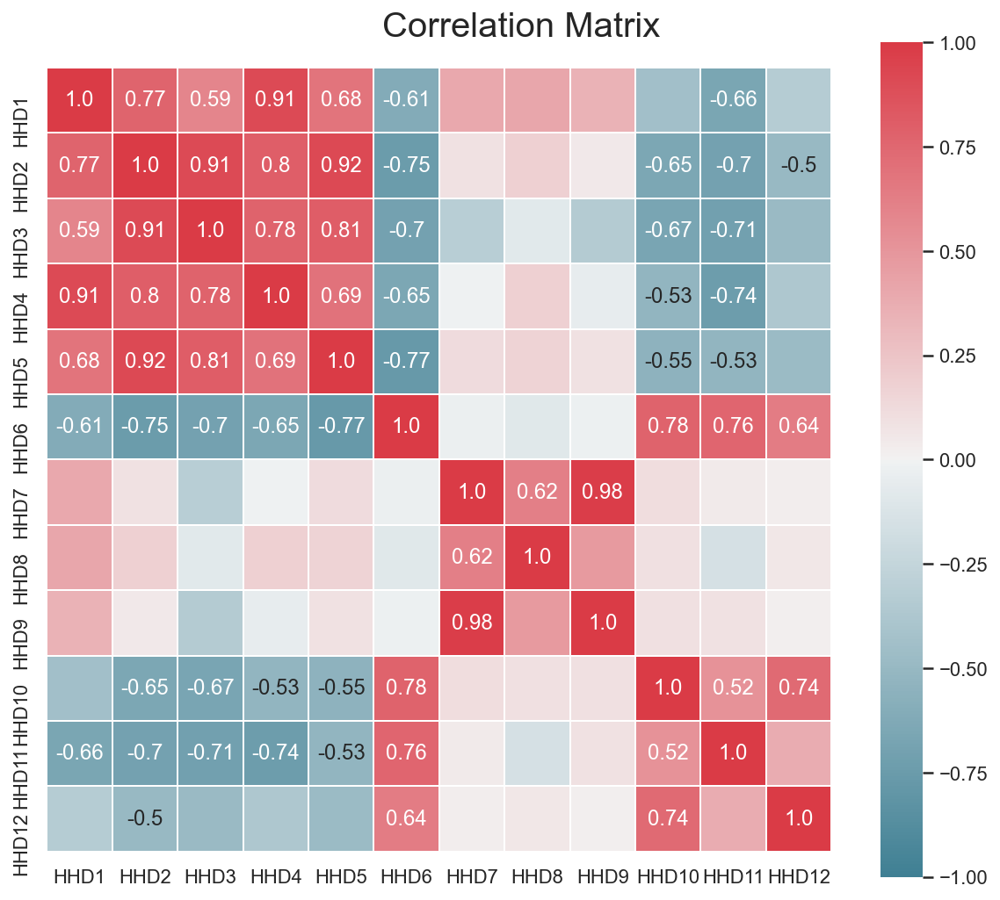

In [40]:
# Prepare figure
fig = plt.figure(figsize=(10, 8))

# Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.
corr = np.round(df.loc[:,"HHD1":"HHD12"].corr(method="pearson"), decimals=2)

# Build annotation matrix (values above |0.5| will appear annotated in the plot)
mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) # Try to understand what this np.where() does

# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

# Layout
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()

In [41]:
data=data.drop(columns=["HHD1", "HHD3", "HHD4", "HHD5", "HHD6", "HHD8", "HHD9", "HHD10", "HHD11"])

In [42]:
data=data.drop(columns=["ETHC1", "ETHC2", "ETHC3", "ETHC4", "ETHC5", "ETHC6"])

# Information not relevant given the rest of the variables already kept

In [43]:
data=data.drop(columns=["HVP1", "HVP2", "HVP3", "HVP4", "HVP5", "HVP6"])

# Information not relevant given the rest of the variables already kept 

In [44]:
data=data.drop(columns=["HUR1", "HUR2"])

# Variables not relevant for our study

In [45]:
df[["RHP1", "RHP2", "RHP3", "RHP4"]].corr(method="pearson")

,RHP1,RHP2,RHP3,RHP4
RHP1,1.000000,0.971449,0.558067,-0.087959
RHP2,0.971449,1.000000,0.588341,-0.090164
RHP3,0.558067,0.588341,1.000000,0.571152
RHP4,-0.087959,-0.090164,0.571152,1.000000


In [46]:
data=data.drop(columns=["RHP2", "RHP3", "RHP4"])

# Decided to only keep 'Median Number of Rooms per Housing Unit' based on the correlations above and the 
# overall relevance/utility for the study

In [47]:
data=data.drop(columns=["HUPA1", "HUPA2", "HUPA4", "HUPA5", "HUPA6",'HUPA7'])

# Information not relevant given the rest of the variables already kept

In [48]:
data=data.drop(columns=["RP1", "RP2", "RP3", "RP4"])

# Information not relevant given the rest of the variables already kept and the decisions made

In [49]:
data=data.drop(columns=["MSA", "ADI", "DMA"])

#variable considered to be irrelevant for our study

In [50]:
data=data.drop(columns=["IC2", "IC3", "IC4", "IC6", "IC7", "IC8", "IC9", "IC10", "IC11", "IC12", "IC13"
                       , "IC14", "IC15", "IC16", "IC17", "IC18", "IC19", "IC20", "IC21", "IC22", "IC23"])

# Information to specific and not relevant given the rest of the variables already kept

In [51]:
data=data.drop(columns=['HHAS3'])

#variable considered to be irrelevant for our study

In [52]:
data=data.drop(columns=['MC1','MC2','MC3'])

#variable considered to be irrelevant for our study

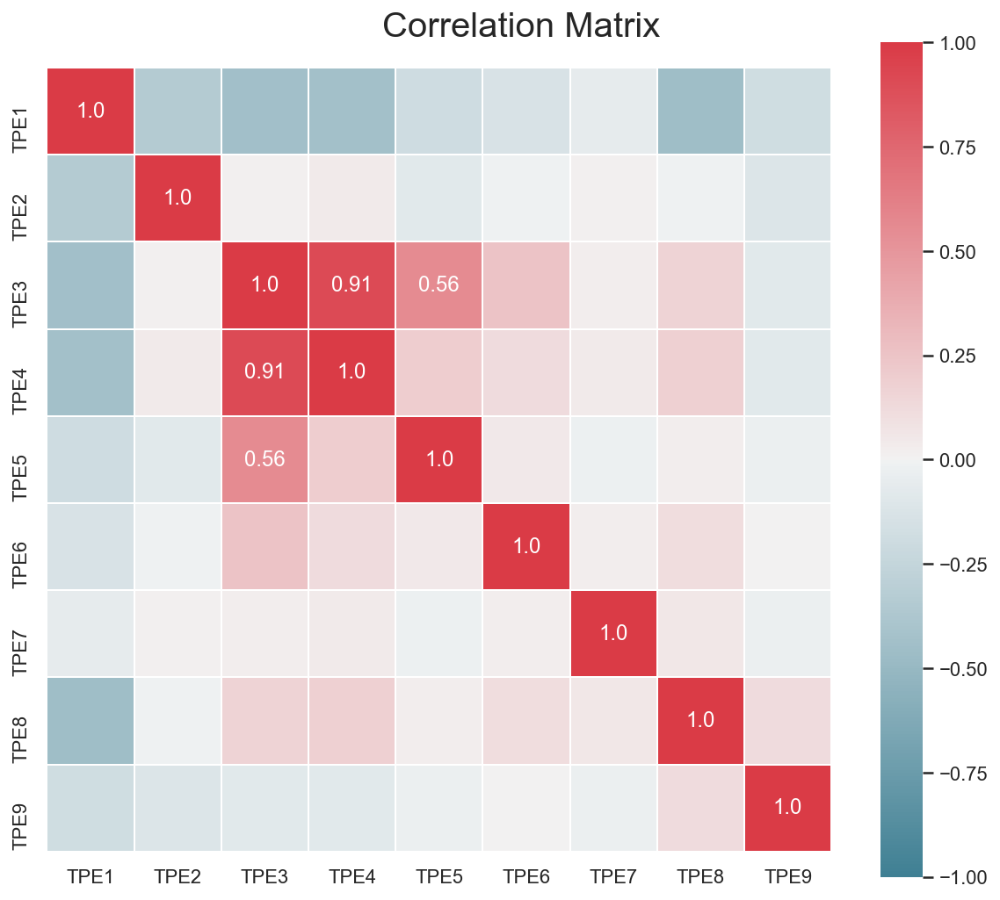

In [53]:
# Prepare figure
fig = plt.figure(figsize=(10, 8))

# Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.
corr = np.round(df.loc[:,"TPE1":"TPE9"].corr(method="pearson"), decimals=2)

# Build annotation matrix (values above |0.5| will appear annotated in the plot)
mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) # Try to understand what this np.where() does

# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

# Layout
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()

In [54]:
data=data.drop(columns=['TPE4','TPE5','TPE8'])

# Variables highly correlated with Public Transportation ('TPE4','TPE5') & variable not relevant given the rest of the variables already kept

In [55]:
data=data.drop(columns=['PEC2'])

# Between PEC1 and PEC2 this is considered less usefull and less relevant for the study

In [56]:
data=data.drop(columns=['TPE11','TPE12','TPE13'])

# We only kept the variable considered to be most apropriate and relevant for the study

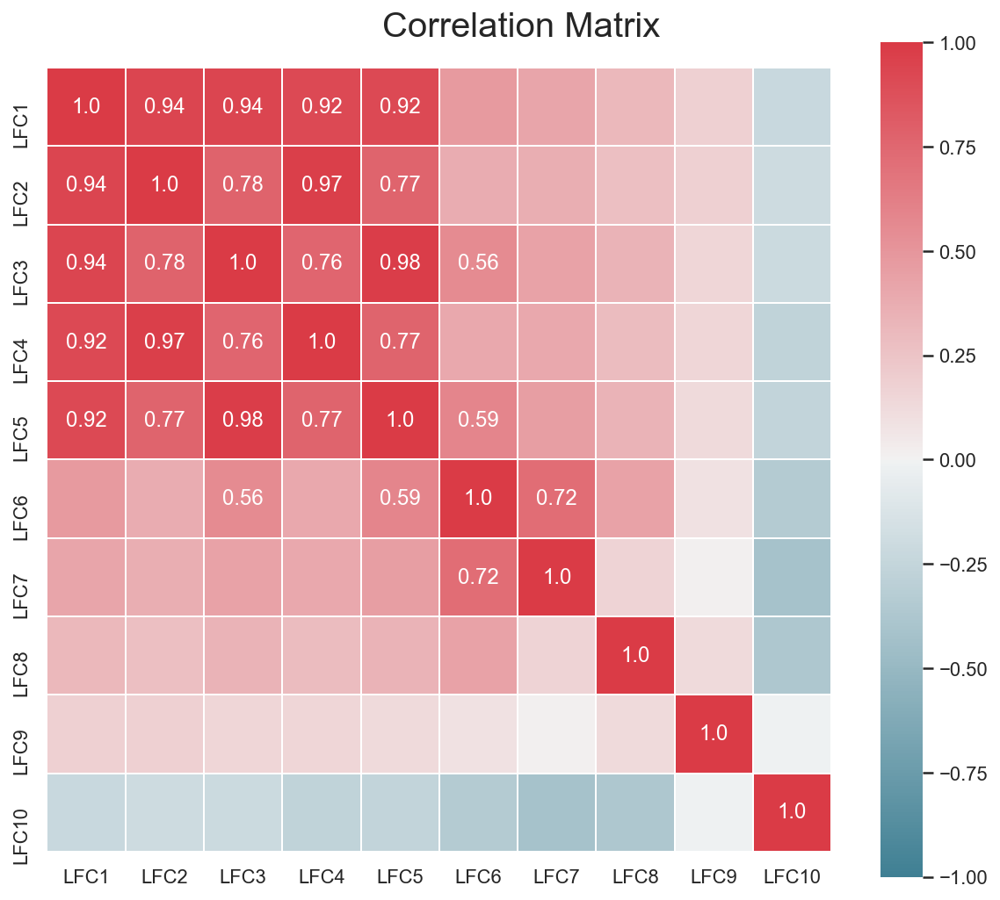

In [57]:
fig = plt.figure(figsize=(10, 8))

corr = np.round(df.loc[:,"LFC1":"LFC10"].corr(method="pearson"), decimals=2)

mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,""))

sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()

In [58]:
data=data.drop(columns=['LFC1','LFC6'])

# WE INTEND TO DROP 'LFC2':'LFC5', HOWEVER A RATION USING THEM WILL BE HELD BEFORE THAT

In [59]:
data=data.drop(columns=['OEDC7'])

# Variable with smaller relevance & a really high number of values equal to Zero (68.2% as 
# seen on PF analysis) with a small amount of distinct values for percentages

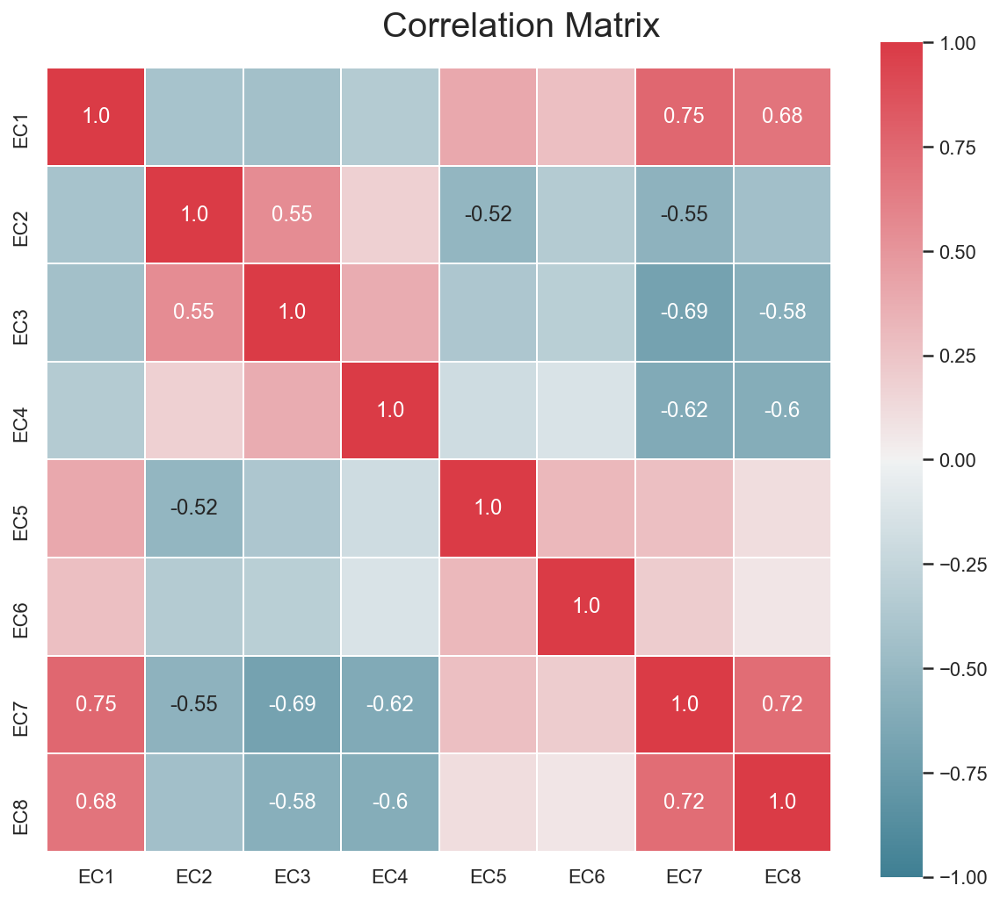

In [60]:
fig = plt.figure(figsize=(10, 8))
corr = np.round(df.loc[:,"EC1":"EC8"].corr(method="pearson") , decimals=2)

mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) 

sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()

In [61]:
data=data.drop(columns=['EC1'])

# Values of this variable make really little sense!

In [62]:
data=data.drop(columns=['EC3','EC5'])

# Variables we don't see fitting (no need for 'some' degree )

In [63]:
data=data.drop(columns=['EC8'])

In [64]:
data=data.drop(columns=['SEC3','SEC4','SEC5'])

# In this section we only intend to know the percentage of students in private & public school,
# and not exactly the degree of schooling of these students

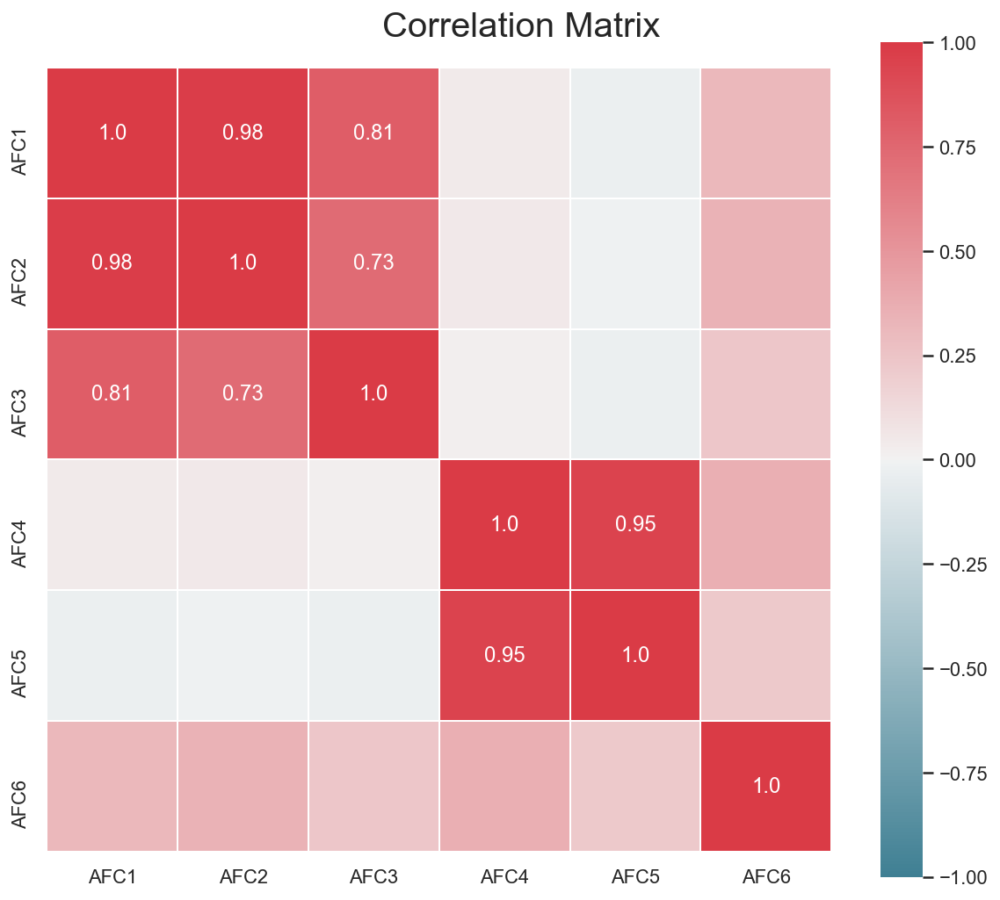

In [65]:
fig = plt.figure(figsize=(10, 8))

corr = np.round(df.loc[:,"AFC1":"AFC6"].corr(method="pearson") , decimals=2)

mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) 

sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()

In [66]:
data=data.drop(columns=['AFC2','AFC3','AFC4'])

In [67]:
data=data.drop(columns=['LSC2','LSC3','LSC4'])

# Only found relevent to know the percentage of Only english speakers

In [68]:
df[["VOC1", "VOC2", "VOC3"]].corr(method="pearson")

,VOC1,VOC2,VOC3
VOC1,1.000000,0.700286,0.457159
VOC2,0.700286,1.000000,0.803992
VOC3,0.457159,0.803992,1.000000


In [69]:
data=data.drop(columns=['VOC1','VOC3'])

In [70]:
data=data.drop(columns=["HC2", "HC3", "HC4", "HC5", "HC6", "HC7", "HC8", "HC9", "HC10", "HC11", "HC12", "HC13"
                       , "HC14", "HC15", "HC16"])

# Really poor description of the variable (HC2) 
# Information to specific and not relevant given the rest for the study

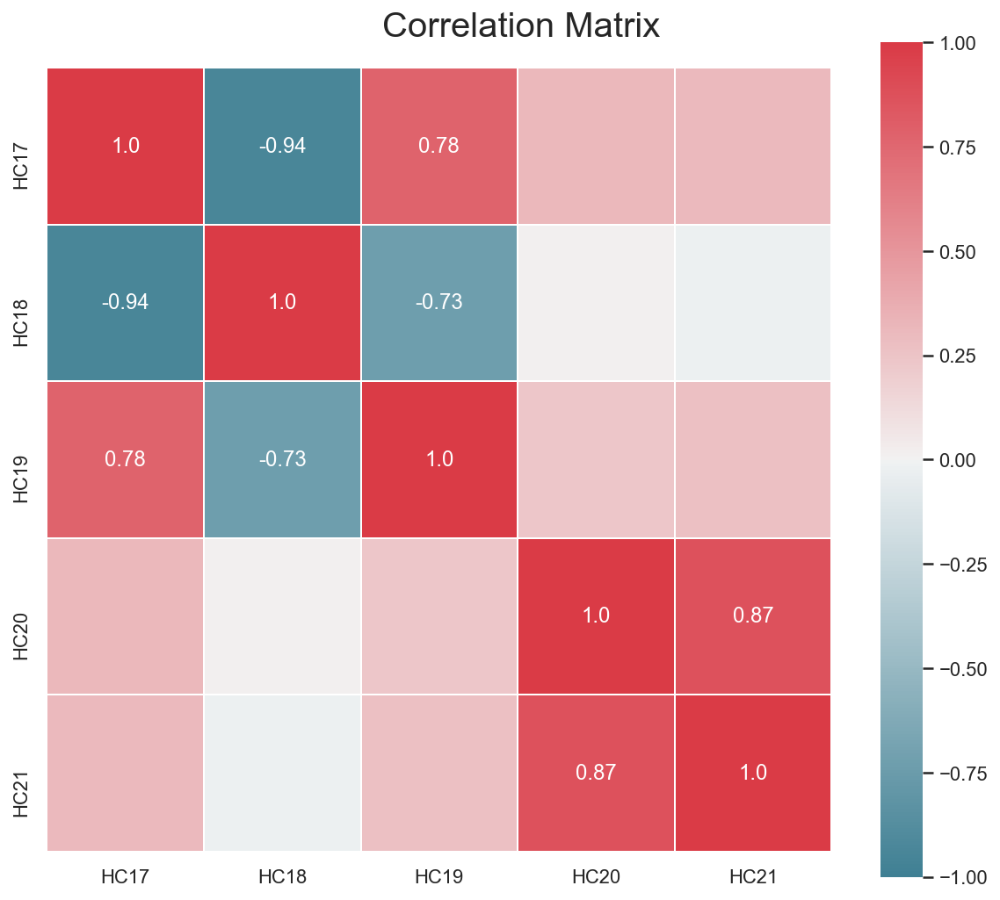

In [71]:
fig = plt.figure(figsize=(10, 8))

corr = np.round(df.loc[:,"HC17":"HC21"].corr(method="pearson") , decimals=2)

mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) 

sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()

In [72]:
data=data.drop(columns=['HC18','HC19','HC20'])

In [73]:
data=data.drop(columns=['MHUC1','MHUC2'])

# Values are EXTREAMELY missfitting and low for the meaning of the variables 

In [74]:
data=data.drop(columns=['AC1','AC2'])

# Information not relevant given the rest of the variables already kept

In [75]:
data=data.drop(columns=['CARDPROM'])

# We identified the time period of 'lifetime' to be subjective and not cohesive among
# all records
#vamos deixar numprom pq estamos a pensar usar para um racio

In [76]:
# Check if the two variables with the Date of the first gift to PVA are equal
data['ODATEDW']!=data['FISTDATE']

0         True
1         True
2        False
3         True
4         True
         ...  
95407     True
95408     True
95409     True
95410     True
95411     True
Length: 95412, dtype: bool

In [77]:
data=data.drop(columns=['ODATEDW'])

In [78]:
data=data.drop(columns=['NEXTDATE']) #repeated information, we already have TIMELAG

In [79]:
data=data.drop(columns=['MAXADATE'])

# With a PF analysis we were able to see that the range of dates od this variables only
# covers a small interval from August 2016 to February 2017. Such values were not considered
# to be wide enough to provide us the information wanted (places every donor in a 
# similar scenario regarding his most recent promotions)

In [80]:
data=data.drop(columns=['MDMAUD'])

# In the end of the dataset there exist three variables representing the RFA of the donors
# separatly (RFA_2R, RFA_2F, RFA_2A)

In [81]:
data=data.drop(columns=['GEOCODE2'])

#variable considered to be irrelevant for our study

In [82]:
data.shape

(95412, 286)

### Fixing variables' values

In [83]:
# Transforming empty values into 0
for col in range(len(data[['RECINHSE','RECP3','CHILD03','CHILD07','CHILD12','CHILD18','MAJOR','COLLECT1','VETERANS','BIBLE','CATLG','PETS','CDPLAY',
    'STEREO','PCOWNERS','PHOTO','CRAFTS','FISHER','GARDENIN','WALKER', "PEPSTRFL"]].columns)):
    data[data[['RECINHSE','RECP3','CHILD03','CHILD07','CHILD12','CHILD18','MAJOR','COLLECT1','VETERANS','BIBLE','CATLG','PETS','CDPLAY',
    'STEREO','PCOWNERS','PHOTO','CRAFTS','FISHER','GARDENIN','WALKER', "PEPSTRFL"]].columns[col]].replace(' ',0, inplace=True)

In [84]:
# Transforming X values into 1
for col in range(len(data[['RECINHSE','RECP3','MAJOR', "PEPSTRFL"]].columns)):
    data[data[['RECINHSE','RECP3','MAJOR', "PEPSTRFL"]].columns[col]].replace('X',1, inplace=True)

In [85]:
# Transforming gender not-empty values into 1
for col in range(len(data[['CHILD03','CHILD07','CHILD12','CHILD18']].columns)):
    data[data[['CHILD03','CHILD07','CHILD12','CHILD18']].columns[col]].replace(['F','M','B'],1, inplace=True)

In [86]:
# Transforming Y values into 1
for col in range(len(data[['COLLECT1','VETERANS','BIBLE','CATLG','PETS','CDPLAY','STEREO','PCOWNERS','PHOTO','CRAFTS','FISHER','GARDENIN','WALKER']].columns)):
    data[data[['COLLECT1','VETERANS','BIBLE','CATLG','PETS','CDPLAY','STEREO','PCOWNERS','PHOTO','CRAFTS','FISHER','GARDENIN','WALKER']].columns[col]].replace('Y',1, inplace=True)

In [87]:
# Transforming empty values into nulls when necessary
for col in range(len(data[['DOMAIN','HOMEOWNR','GENDER']].columns)):
    data[data[['DOMAIN','HOMEOWNR','GENDER']].columns[col]].replace(' ',np.NaN, inplace=True)

In [88]:
pd.set_option('display.max_columns', 300)
data.head(15)

,STATE,DOB,RECINHSE,RECP3,DOMAIN,HOMEOWNR,CHILD03,CHILD07,CHILD12,CHILD18,NUMCHLD,INCOME,GENDER,HIT,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,SOLP3,SOLIH,MAJOR,COLLECT1,VETERANS,BIBLE,CATLG,PETS,CDPLAY,STEREO,PCOWNERS,PHOTO,CRAFTS,FISHER,GARDENIN,WALKER,PEPSTRFL,POP901,POP90C1,POP90C2,POP90C3,POP90C5,ETH1,ETH2,ETH3,ETH4,ETH5,ETH6,ETH7,ETH8,ETH9,ETH10,ETH11,ETH12,ETH13,ETH14,ETH15,ETH16,AGE904,AGE907,AGEC1,AGEC2,AGEC3,AGEC4,AGEC5,AGEC6,AGEC7,HHAGE3,HHN3,MARR1,MARR2,MARR3,MARR4,DW7,HV1,HU3,HHD2,HHD7,HHD12,RHP1,HUPA3,IC1,IC5,HHAS1,HHAS2,HHAS4,TPE1,TPE2,TPE3,TPE6,TPE7,TPE9,PEC1,TPE10,LFC2,LFC3,LFC4,LFC5,LFC7,LFC8,LFC9,LFC10,OCC1,OCC2,OCC3,OCC4,OCC5,OCC6,OCC7,OCC8,OCC9,OCC10,OCC11,OCC12,OCC13,EIC1,EIC2,EIC3,EIC4,EIC5,EIC6,EIC7,EIC8,EIC9,EIC10,EIC11,EIC12,EIC13,EIC14,EIC15,EIC16,OEDC1,OEDC2,OEDC3,OEDC4,OEDC5,OEDC6,EC2,EC4,EC6,EC7,SEC1,SEC2,AFC1,AFC5,AFC6,VC1,VC2,VC3,VC4,ANC1,ANC2,ANC3,ANC4,ANC5,ANC6,ANC7,ANC8,ANC9,ANC10,ANC11,ANC12,ANC13,ANC14,ANC15,POBC1,POBC2,LSC1,VOC2,HC1,HC17,HC21,ADATE_2,ADATE_3,ADATE_4,ADATE_5,ADATE_6,ADATE_7,ADATE_8,ADATE_9,ADATE_10,ADATE_11,ADATE_12,ADATE_13,ADATE_14,ADATE_15,ADATE_16,ADATE_17,ADATE_18,ADATE_19,ADATE_20,ADATE_21,ADATE_22,ADATE_23,ADATE_24,RFA_2,RFA_3,RFA_4,RFA_5,RFA_6,RFA_7,RFA_8,RFA_9,RFA_10,RFA_11,RFA_12,RFA_13,RFA_14,RFA_15,RFA_16,RFA_17,RFA_18,RFA_19,RFA_20,RFA_21,RFA_22,RFA_23,RFA_24,NUMPROM,CARDPM12,NUMPRM12,RDATE_3,RDATE_4,RDATE_5,RDATE_6,RDATE_7,RDATE_8,RDATE_9,RDATE_10,RDATE_11,RDATE_12,RDATE_13,RDATE_14,RDATE_15,RDATE_16,RDATE_17,RDATE_18,RDATE_19,RDATE_20,RDATE_21,RDATE_22,RDATE_23,RDATE_24,RAMNT_3,RAMNT_4,RAMNT_5,RAMNT_6,RAMNT_7,RAMNT_8,RAMNT_9,RAMNT_10,RAMNT_11,RAMNT_12,RAMNT_13,RAMNT_14,RAMNT_15,RAMNT_16,RAMNT_17,RAMNT_18,RAMNT_19,RAMNT_20,RAMNT_21,RAMNT_22,RAMNT_23,RAMNT_24,RAMNTALL,NGIFTALL,CARDGIFT,MINRAMNT,MINRDATE,MAXRAMNT,MAXRDATE,LASTGIFT,LASTDATE,FISTDATE,TIMELAG,AVGGIFT,CONTROLN,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A
0,IL,1957-12-01,0,0,T2,NaN,0,0,0,0,NaN,NaN,F,0,0,39,34,18,10,2,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,992,0,35,65,53,92,1,0,0,11,0,0,0,0,0,0,0,11,0,0,0,40,25,11,14,18,17,13,11,15,23,49,61,7,12,19,7,479,96,80,6,3,58,0,307,12883,28,4,1,88,8,0,0,0,4,1,14,64,50,64,44,53,99,0,0,9,3,8,13,9,0,3,9,3,15,19,5,4,3,0,3,41,1,0,7,13,6,5,0,4,9,4,1,3,10,2,1,7,78,2,16,39,8,4,5,20,0,39,0,34,23,18,16,1,4,0,23,0,0,5,1,0,0,0,0,0,2,0,3,74,88,77,13,33,99,2017-06-01,2016-06-01,2016-04-01,2016-04-01,2016-03-01,2016-02-01,2016-01-01,2015-11-01,2015-10-01,2015-10-01,2015-08-01,2015-07-01,2015-06-01,2015-04-01,2015-03-01,2015-02-01,2015-01-01,2014-11-01,2014-11-01,2014-10-01,2014-09-01,2014-07-01,2014-06-01,L4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,74,6,14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2015-12-01,NaN,NaN,NaN,2015-07-01,2015-05-01,2015-05-01,2015-03-01,NaN,NaN,NaN,NaN,NaN,2014-08-01,2014-06-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,10.0,11.0,11.0,11.0,NaN,NaN,NaN,NaN,NaN,11.0,9.0,240.0,31,14,5.0,2012-08-01,12.0,2014-02-01,10.0,2015-12-01,2009-11-01,4.0,7.741935,95515,0,L,4,E,X,X,X
1,CA,1972-02-01,0,0,S1,H,0,0,0,1,1.0,6.0,M,16,0,15,55,11,6,2,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3611,99,0,0,50,67,0,0,31,6,4,2,6,4,14,0,0,2,0,1,4,32,32,13,14,33,23,10,4,2,5,75,69,4,3,24,0,5468,97,94,4,2,76,0,1088,36175,6,2,3,80,14,0,0,0,6,0,24,83,58,81,57,57,99,99,0,22,24,4,21,13,2,1,6,0,4,1,0,3,1,0,6,13,1,2,8,18,11,4,3,4,10,7,11,1,6,2,1,16,69,5,5,12,7,30,14,24,0,15,0,55,10,11,0,0,2,0,3,1,1,2,3,1,1,0,3,0,0,0,42,39,50,92,5,99,99,2017-06-01,2016-06-01,2016-04-01,2016-04-01,2016-03-01,2016-02-01,2016-01-01,2015-11-01,2015-10-01,2015-10-01,2015-09-01,NaN,NaN,NaN,2015-03-01,NaN,NaN,2014-11-01,2014-11-01,2014-10-01,2014-09-01,NaN,2014-06-01,L2G,A2G,A2G,A2G,A2G,A1E,A1E,A1E,A1E,A1E,A1E,,,,L1E,,,N1E,N1E,N1E,N1E,,F1E,32,6,13,NaN,NaN,NaN,NaN,NaN,NaN,2015-12-01,NaN,NaN,NaN,NaN,NaN,NaN,2015-04-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,25.0,NaN,NaN,NaN,NaN,NaN,NaN,12.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,47.0,3,1,10.0,2013-10-

#### Check kept variables

In [89]:
# profile = ProfileReport(
#     data, minimal=True,
#     title='PVA Donors data_clean',
#     correlations={
#         "pearson": {"calculate": True},
#         "spearman": {"calculate": False},
#         "kendall": {"calculate": False},
#         "phi_k": {"calculate": False},
#         "cramers": {"calculate": False},},)

# profile.to_file(output_file='PVA Donors Clean_data.html')

## Missing Values<a class="anchor"><a id='Missing'></a></b><br>

In [90]:
pd.set_option('display.max_rows', 300)
data.isna().sum()

STATE           0
DOB         23883
RECINHSE        0
RECP3           0
DOMAIN       2316
HOMEOWNR    22228
CHILD03         0
CHILD07         0
CHILD12         0
CHILD18         0
NUMCHLD     83026
INCOME      21286
GENDER       2957
HIT             0
MALEMILI        0
MALEVET         0
VIETVETS        0
WWIIVETS        0
LOCALGOV        0
STATEGOV        0
FEDGOV          0
SOLP3           0
SOLIH           0
MAJOR           0
COLLECT1        0
VETERANS        0
BIBLE           0
CATLG           0
PETS            0
CDPLAY          0
STEREO          0
PCOWNERS        0
PHOTO           0
CRAFTS          0
FISHER          0
GARDENIN        0
WALKER          0
PEPSTRFL        0
POP901          0
POP90C1         0
POP90C2         0
POP90C3         0
POP90C5         0
ETH1            0
ETH2            0
ETH3            0
ETH4            0
ETH5            0
ETH6            0
ETH7            0
ETH8            0
ETH9            0
ETH10           0
ETH11           0
ETH12           0
ETH13     

In [91]:
data_clean=data.copy()

In [92]:
# Fill in all RAMNT missing values with 0, since they represent donors who did not donate for a certain promotion -> equal to donating 0
for i in data_clean.loc[:,"RAMNT_3":"RAMNT_24"].columns:
    data_clean[i]=data_clean[i].fillna(0)

In [93]:
# Check that all the donors who have TIMELAG as null only donated once (FISTDATE equal to LASTDATE)
len(data_clean[(data_clean['TIMELAG'].isnull()) & (data_clean['FISTDATE']==data_clean['LASTDATE'])])==len(data_clean[data_clean['TIMELAG'].isnull()])

True

In [94]:
# Impute nulls in timelag with 0 since these represent people who only donated once
data_clean['TIMELAG'].fillna(0, inplace=True)

In [95]:
# Transforming null values in NUMCHLD into 0
data_clean['NUMCHLD'].fillna(0, inplace=True)

In [96]:
# Delete rows with nulls in FISTDATE, since these 2 donors don't have a record of first donation

data_clean.loc[:,'MINRAMNT':'AVGGIFT'][data_clean['FISTDATE'].isnull()]
print(len(data[data_clean['FISTDATE'].isnull()]), "observations were eliminated")
data_clean=data_clean[~data_clean['FISTDATE'].isnull()]
data_clean.reset_index(inplace=True)

2 observations were eliminated


In [97]:
data_clean['AGE']=datetime.now().year-pd.to_datetime(data_clean['DOB']).dt.year

In [98]:
data_clean[['DOB','AGE']]

,DOB,AGE
0,1957-12-01,64.0
1,1972-02-01,49.0
2,NaN,NaN
3,1948-01-01,73.0
4,1940-01-01,81.0
...,...,...
95405,NaN,NaN
95406,1970-01-01,51.0
95407,1958-01-01,63.0
95408,1960-05-01,61.0


In [99]:
data_clean.drop(columns=['DOB','index'],inplace=True) #no longer needed, we have Age now

For the numerical variables with nulls:

In [100]:
one=data_clean[data_clean["AGE"].notnull()]
no_missing=one[data_clean["INCOME"].notnull()]

In [101]:
# Check for correlations with the variables with missings to use the highest ones as a reference for imputing
corr_imp=no_missing.corr()
corr_age=corr_imp.loc[:,'AGE']

In [102]:
# These are the ones more correlated with AGE
corr_age[((corr_age>0.2)|(corr_age<-0.2))]

NUMCHLD   -0.265511
AGEC6      0.200325
HHAGE3     0.206273
NUMPROM    0.217692
AGE        1.000000
Name: AGE, dtype: float64

In [103]:
# Fill in the missing values in AGE
imp_vars=data_clean[['NUMCHLD','HIT','AVGGIFT','AGEC6','HHAGE3','NGIFTALL','AGE']]
imputer = KNNImputer(n_neighbors=100,weights="distance")
X_filled_knn = imputer.fit_transform(imp_vars)
data_clean['AGE']=np.round(X_filled_knn[:,6])

In [104]:
# These are the ones more correlated with INCOME
corr_income=corr_imp.loc[:,'INCOME']
corr_income[((corr_income>0.2)|(corr_income<-0.2))]

INCOME    1.000000
AGEC3     0.250750
AGEC4     0.249759
MARR3    -0.227782
HV1       0.322798
RHP1      0.297998
IC1       0.422085
IC5       0.354441
HHAS1    -0.203806
HHAS2    -0.221550
HHAS4    -0.275206
LFC4      0.211318
OCC1      0.280072
OCC2      0.334661
OCC8     -0.266766
OCC11    -0.207796
OCC13    -0.204751
EIC9      0.209772
EC2      -0.259218
EC4      -0.264191
EC7       0.353833
VOC2      0.284073
Name: INCOME, dtype: float64

In [105]:
# Fill in the missing values in INCOME
imp_vars=data_clean[['INCOME','AGEC3','AGEC4','MARR3','HV1','RHP1','IC1','IC5','HHAS1','HHAS2', 'HHAS4','LFC4','OCC1','OCC2','OCC8','OCC11','OCC13','EIC9','EC2','EC4','EC7','VOC2']]
imputer = KNNImputer(n_neighbors=100, weights="distance")
X_filled_knn = imputer.fit_transform(imp_vars)
data_clean['INCOME']=np.round(X_filled_knn[:,0],2)

For the categorical variables with nulls:

In [106]:
df.TCODE[df['GENDER']==" "].value_counts()

0        1892
2         553
1         280
28        137
3          36
980        15
28028      14
4          13
1002        3
116         3
45          2
14          2
134         1
72          1
13          1
22          1
18          1
12          1
23          1
Name: TCODE, dtype: int64

In [107]:
# Mr. had distinct values for gender, therefore it would not make sense to consider using TCODE to fill the gender missing
df['GENDER'][df.TCODE==2].value_counts() 

F    12570
M     3412
       553
U      467
J        4
Name: GENDER, dtype: int64

In [108]:
# Transforming null values in NUMCHLD into 0
data_clean['GENDER'].fillna('U', inplace=True)

In [109]:
# Transforming null values in NUMCHLD into 0
data_clean['HOMEOWNR'].fillna('U', inplace=True)

In [110]:
data_clean["DOMAIN_1"]=np.nan
data_clean["DOMAIN_2"]=np.nan

data_clean["DOMAIN_1"][data_clean["DOMAIN"].notnull()]=data_clean.DOMAIN.astype(str).str[0]
data_clean["DOMAIN_2"][data_clean["DOMAIN"].notnull()]=data_clean.DOMAIN.astype(str).str[1]

In [111]:
data_clean[["DOMAIN","DOMAIN_1","DOMAIN_2"]]

,DOMAIN,DOMAIN_1,DOMAIN_2
0,T2,T,2
1,S1,S,1
2,R2,R,2
3,R2,R,2
4,S2,S,2
...,...,...,...
95405,C2,C,2
95406,C1,C,1
95407,C3,C,3
95408,C1,C,1


In [112]:
data_clean.groupby("DOMAIN_1")["POP90C1","POP90C2","POP90C3"].mean()

,POP90C1,POP90C2,POP90C3
DOMAIN_1,,,
C,81.917615,8.331522,7.824309
R,4.368589,17.812876,76.854566
S,92.842136,1.328453,4.061713
T,29.327598,36.087059,33.310954
U,95.140391,0.925037,1.449942


In [113]:
data_clean["DOMAIN_1"][data_clean["DOMAIN_1"].isnull()]

34       NaN
46       NaN
226      NaN
311      NaN
395      NaN
        ... 
95210    NaN
95256    NaN
95318    NaN
95319    NaN
95341    NaN
Name: DOMAIN_1, Length: 2316, dtype: object

In [114]:
type(data_clean["DOMAIN_1"][34])

float

In [115]:
for i in range(len(data_clean.DOMAIN_1)):
    #if (data_clean["DOMAIN_1"][i] is np.nan):
    if (type(data_clean["DOMAIN_1"][i])==float):
        
        if ((data_clean.POP90C1[i]>data_clean.POP90C2[i]) & (data_clean.POP90C1[i]>data_clean.POP90C3[i])): #the higher value is POP90C1
            data_clean["DOMAIN_1"][i]="U"

        elif ((data_clean.POP90C2[i]>data_clean.POP90C1[i]) & (data_clean.POP90C2[i]>data_clean.POP90C3[i])):  #the higher value is POP90C2
            data_clean["DOMAIN_1"][i]="T"

        elif ((data_clean.POP90C3[i]>data_clean.POP90C1[i]) & (data_clean.POP90C3[i]>=data_clean.POP90C2[i])):  #the higher value is POP90C3
            data_clean["DOMAIN_1"][i]="R"

In [116]:
data_clean[["DOMAIN_1", "POP90C1","POP90C2","POP90C3"]][data_clean["DOMAIN_1"].isnull()]
#Incoherent, nao tem percentagem em nenhum tipo de zona, eliminar linhas

,DOMAIN_1,POP90C1,POP90C2,POP90C3
1137,NaN,0,0,0
4645,NaN,0,0,0
9065,NaN,0,0,0
10819,NaN,0,0,0
13305,NaN,0,0,0
14022,NaN,0,0,0
14910,NaN,0,0,0
15062,NaN,0,0,0
18421,NaN,0,0,0
18673,NaN,0,0,0


In [117]:
data_clean.groupby(["DOMAIN_1", "DOMAIN_2"])["DOMAIN_2"].count()

DOMAIN_1  DOMAIN_2
C         1            6145
          2            8263
          3            5280
R         1            1358
          2           13622
          3            4809
S         1           11503
          2            8530
          3            1891
T         1            4982
          2           12369
          3            2176
U         1            4510
          2            3254
          3            2598
          4            1804
Name: DOMAIN_2, dtype: int64

In [118]:
data_clean["DOMAIN_2"][(data_clean["DOMAIN_2"].isnull()) & (data_clean["DOMAIN_1"]=="R")]=data_clean["DOMAIN_2"][data_clean["DOMAIN_1"]=="R"].mode()[0]
data_clean["DOMAIN_2"][(data_clean["DOMAIN_2"].isnull()) & (data_clean["DOMAIN_1"]=="T")]=data_clean["DOMAIN_2"][data_clean["DOMAIN_1"]=="T"].mode()[0]
data_clean["DOMAIN_2"][(data_clean["DOMAIN_2"].isnull()) & (data_clean["DOMAIN_1"]=="U")]=data_clean["DOMAIN_2"][data_clean["DOMAIN_1"]=="U"].mode()[0]

In [119]:
data_clean.groupby(["DOMAIN_1", "DOMAIN_2"])["DOMAIN_2"].count()

DOMAIN_1  DOMAIN_2
C         1            6145
          2            8263
          3            5280
R         1            1358
          2           14227
          3            4809
S         1           11503
          2            8530
          3            1891
T         1            4982
          2           12761
          3            2176
U         1            5782
          2            3254
          3            2598
          4            1804
Name: DOMAIN_2, dtype: int64

In [120]:
data_clean.drop(columns={"DOMAIN","POP90C1","POP90C2", "POP90C3"}, inplace=True) #Drop columns we no longer need

## Feature Engineering<a class="anchor"><a id='Eng'></a></b><br>

In [564]:
data_new=data_clean.copy()
data_new.reset_index(drop=True, inplace=True)

In [565]:
# Creating a binary variable that shows if the donors have children (of up to 12 yo)
data_new['Childhome']=np.where((data_new.CHILD03==0)&(data_new.CHILD07==0)&(data_new.CHILD12==0),0,1)

In [566]:
# Creating a binary variable that shows if the donors have teenagers (13 to 18 yo)
data_new['Teenhome']=np.where(data_new.CHILD18==0,0,1)

In [567]:
# drop originals
data_new.drop(columns=["CHILD03", "CHILD18", "CHILD07", "CHILD12"], inplace=True)

In [568]:
# Replacing the values for all variables ADATE and RDATE so they take the value 1 when there is a date of a mailing and 0 is there is none

for i in data_new.loc[:,"ADATE_2":"ADATE_24"].columns:
    data_new[i]=data_new[i].notnull().astype(int)

for i in data_new.loc[:,"RDATE_3":"RDATE_24"].columns:
    data_new[i]=data_new[i].notnull().astype(int)

In [569]:
# The idea is, for each type of mailing promotion, get the total amount of mailings received, and the proportion of mailings 
# received and gifts given

# For mailings with labels only
data_new['Num_LL']=(data_new['ADATE_6']+data_new['ADATE_10']+data_new['ADATE_16']+data_new['ADATE_20']) # number promotions type LL mailed
data_new['den_LL_aux']=data_new['Num_LL'].map(lambda x: 1 if x==0 else x) # this will be used as the denominator so if no promotion was mailed, set it to 1, so the division can be made
data_new["Promo_LL"]=(data_new['RDATE_6']+data_new['RDATE_10']+data_new['RDATE_16']+data_new['RDATE_20'])/data_new['den_LL_aux'] # n times gift was received/ number times promotion was mailed

# For mailings that are calendars with stickers without labels
data_new['Num_CC']=(data_new['ADATE_9']+data_new['ADATE_19'])            
data_new['den_CC_aux']=data_new['Num_CC'].map(lambda x: 1 if x==0 else x)             
data_new["Promo_CC"]=(data_new['RDATE_9']+data_new['RDATE_19'])/data_new['den_CC_aux']

# For mailings that are blank cards that fold into thirds with labels
data_new['Num_FS']=(data_new['ADATE_13']+data_new['ADATE_23'])            
data_new['den_FS_aux']=data_new['Num_FS'].map(lambda x: 1 if x==0 else x)              
data_new["Promo_FS"]=(data_new['RDATE_13']+data_new['RDATE_23'])/data_new['den_FS_aux']

# For mailings that are blank cards with labels
data_new['Num_NK']=data_new['ADATE_2']+data_new['ADATE_3']+data_new['ADATE_5']+data_new['ADATE_14']+data_new['ADATE_24']             
data_new['den_NK_aux']=data_new['Num_NK'].map(lambda x: 1 if x==0 else x)           
data_new["Promo_NK"]=(data_new['RDATE_3']+data_new['RDATE_5']+data_new['RDATE_14']+data_new['RDATE_24'])/data_new['den_NK_aux']

# For mailings with "thank you" printed on the outside with labels
data_new['Num_TK']=data_new['ADATE_4']+data_new['ADATE_15']
data_new['den_TK_aux']=data_new['Num_TK'].map(lambda x: 1 if x==0 else x)               
data_new["Promo_TK"]=(data_new['RDATE_4']+data_new['RDATE_15'])/data_new['den_TK_aux']

# For mailings that are general greeting cards (assortment of birthday, sympathy, blank, & get well) with labels
data_new['Num_GK']=data_new['ADATE_8']+data_new['ADATE_18']
data_new['den_GK_aux']=data_new['Num_GK'].map(lambda x: 1 if x==0 else x)                
data_new["Promo_GK"]=(data_new['RDATE_8']+data_new['RDATE_18'])/data_new['den_GK_aux']

# For mailings that are Christmas cards with labels
data_new['Num_XK']=data_new['ADATE_12']+data_new['ADATE_22']
data_new['den_XK_aux']=data_new['Num_XK'].map(lambda x: 1 if x==0 else x)            
data_new["Promo_XK"]=(data_new['RDATE_12']+data_new['RDATE_22'])/data_new['den_XK_aux']

# For mailings with labels and a notepad
data_new['Num_G1']=data_new['ADATE_7']+data_new['ADATE_11']+data_new['ADATE_17']+data_new['ADATE_21']
data_new['den_G1_aux']=data_new['Num_G1'].map(lambda x: 1 if x==0 else x)             
data_new["Promo_G1"]=(data_new['RDATE_7']+data_new['RDATE_11']+data_new['RDATE_17']+data_new['RDATE_21'])/data_new['den_G1_aux']

In [570]:
# Similarly as above, get the amount donated for each kind of promotion for which a donation was given

# For mailings with labels only
data_new["Amnt_Promo_LL"]=(data_new['RAMNT_6']+data_new['RAMNT_10']+data_new['RAMNT_16']+data_new['RAMNT_20'])/data_new['den_LL_aux'] # n times gift was received/ number times promotion was mailed

# For mailings that are calendars with stickers without labels         
data_new["Amnt_Promo_CC"]=(data_new['RAMNT_9']+data_new['RAMNT_19'])/data_new['den_CC_aux']

# For mailings that are blank cards that fold into thirds with labels
data_new["Amnt_Promo_FS"]=(data_new['RAMNT_13']+data_new['RAMNT_23'])/data_new['den_FS_aux']

# For mailings that are blank cards with labels     
data_new["Amnt_Promo_NK"]=(data_new['RAMNT_3']+data_new['RAMNT_5']+data_new['RAMNT_14']+data_new['RAMNT_24'])/data_new['den_NK_aux']

# For mailings with "thank you" printed on the outside with labels
data_new["Amnt_Promo_TK"]=(data_new['RAMNT_4']+data_new['RAMNT_15'])/data_new['den_TK_aux']

# For mailings that are general greeting cards (assortment of birthday, sympathy, blank, & get well) with labels
data_new["Amnt_Promo_GK"]=(data_new['RAMNT_8']+data_new['RAMNT_18'])/data_new['den_GK_aux']

# For mailings that are Christmas cards with labels
data_new["Amnt_Promo_XK"]=(data_new['RAMNT_12']+data_new['RAMNT_22'])/data_new['den_XK_aux']

# For mailings with labels and a notepad
data_new["Amnt_Promo_G1"]=(data_new['RAMNT_7']+data_new['RAMNT_11']+data_new['RAMNT_17']+data_new['RAMNT_21'])/data_new['den_G1_aux']

In [571]:
data_new['Inactive_time']=(pd.to_datetime(data['ADATE_2'])-pd.to_datetime(data_new['LASTDATE'])).dt.days    # tem de ser data['ADATE_2'] pois data_new já só tem binária
data_new['Donation_activity']=(pd.to_datetime(data_new['LASTDATE'])-pd.to_datetime(data_new['FISTDATE'])).dt.days
data_new['Response Rate']=data_new['NGIFTALL']/data_new["NUMPROM"]
data_new.drop(columns=["NUMPROM"], inplace=True)

In [572]:
data_new.head()

,STATE,RECINHSE,RECP3,HOMEOWNR,NUMCHLD,INCOME,GENDER,HIT,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,SOLP3,SOLIH,MAJOR,COLLECT1,VETERANS,BIBLE,CATLG,PETS,CDPLAY,STEREO,PCOWNERS,PHOTO,CRAFTS,FISHER,GARDENIN,WALKER,PEPSTRFL,POP901,POP90C5,ETH1,ETH2,ETH3,ETH4,ETH5,ETH6,ETH7,ETH8,ETH9,ETH10,ETH11,ETH12,ETH13,ETH14,ETH15,ETH16,AGE904,AGE907,AGEC1,AGEC2,AGEC3,AGEC4,AGEC5,AGEC6,AGEC7,HHAGE3,HHN3,MARR1,MARR2,MARR3,MARR4,DW7,HV1,HU3,HHD2,HHD7,HHD12,RHP1,HUPA3,IC1,IC5,HHAS1,HHAS2,HHAS4,TPE1,TPE2,TPE3,TPE6,TPE7,TPE9,PEC1,TPE10,LFC2,LFC3,LFC4,LFC5,LFC7,LFC8,LFC9,LFC10,OCC1,OCC2,OCC3,OCC4,OCC5,OCC6,OCC7,OCC8,OCC9,OCC10,OCC11,OCC12,OCC13,EIC1,EIC2,EIC3,EIC4,EIC5,EIC6,EIC7,EIC8,EIC9,EIC10,EIC11,EIC12,EIC13,EIC14,EIC15,EIC16,OEDC1,OEDC2,OEDC3,OEDC4,OEDC5,OEDC6,EC2,EC4,EC6,EC7,SEC1,SEC2,AFC1,AFC5,AFC6,VC1,VC2,VC3,VC4,ANC1,ANC2,ANC3,ANC4,ANC5,ANC6,ANC7,ANC8,...,ADATE_4,ADATE_5,ADATE_6,ADATE_7,ADATE_8,ADATE_9,ADATE_10,ADATE_11,ADATE_12,ADATE_13,ADATE_14,ADATE_15,ADATE_16,ADATE_17,ADATE_18,ADATE_19,ADATE_20,ADATE_21,ADATE_22,ADATE_23,ADATE_24,RFA_2,RFA_3,RFA_4,RFA_5,RFA_6,RFA_7,RFA_8,RFA_9,RFA_10,RFA_11,RFA_12,RFA_13,RFA_14,RFA_15,RFA_16,RFA_17,RFA_18,RFA_19,RFA_20,RFA_21,RFA_22,RFA_23,RFA_24,CARDPM12,NUMPRM12,RDATE_3,RDATE_4,RDATE_5,RDATE_6,RDATE_7,RDATE_8,RDATE_9,RDATE_10,RDATE_11,RDATE_12,RDATE_13,RDATE_14,RDATE_15,RDATE_16,RDATE_17,RDATE_18,RDATE_19,RDATE_20,RDATE_21,RDATE_22,RDATE_23,RDATE_24,RAMNT_3,RAMNT_4,RAMNT_5,RAMNT_6,RAMNT_7,RAMNT_8,RAMNT_9,RAMNT_10,RAMNT_11,RAMNT_12,RAMNT_13,RAMNT_14,RAMNT_15,RAMNT_16,RAMNT_17,RAMNT_18,RAMNT_19,RAMNT_20,RAMNT_21,RAMNT_22,RAMNT_23,RAMNT_24,RAMNTALL,NGIFTALL,CARDGIFT,MINRAMNT,MINRDATE,MAXRAMNT,MAXRDATE,LASTGIFT,LASTDATE,FISTDATE,TIMELAG,AVGGIFT,CONTROLN,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,AGE,DOMAIN_1,DOMAIN_2,Childhome,Teenhome,Num_LL,den_LL_aux,Promo_LL,Num_CC,den_CC_aux,Promo_CC,Num_FS,den_FS_aux,Promo_FS,Num_NK,den_NK_aux,Promo_NK,Num_TK,den_TK_aux,Promo_TK,Num_GK,den_GK_aux,Promo_GK,Num_XK,den_XK_aux,Promo_XK,Num_G1,den_G1_aux,Promo_G1,Amnt_Promo_LL,Amnt_Promo_CC,Amnt_Promo_FS,Amnt_Promo_NK,Amnt_Promo_TK,Amnt_Promo_GK,Amnt_Promo_XK,Amnt_Promo_G1,Inactive_time,Donation_activity,Response Rate
0,IL,0,0,U,0.0,3.25,F,0,0,39,34,18,10,2,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,992,53,92,1,0,0,11,0,0,0,0,0,0,0,11,0,0,0,40,25,11,14,18,17,13,11,15,23,49,61,7,12,19,7,479,96,80,6,3,58,0,307,12883,28,4,1,88,8,0,0,0,4,1,14,64,50,64,44,53,99,0,0,9,3,8,13,9,0,3,9,3,15,19,5,4,3,0,3,41,1,0,7,13,6,5,0,4,9,4,1,3,10,2,1,7,78,2,16,39,8,4,5,20,0,39,0,34,23,18,16,1,4,0,23,0,0,5,1,...,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,L4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,S4E,6,14,0,0,0,0,0,0,0,1,0,0,0,1,1,1,1,0,0,0,0,0,1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.0,0.0,0.0,0.0,10.0,11.0,11.0,11.0,0.0,0.0,0.0,0.0,0.0,11.0,9.0,240.0,31,14,5.0,2012-08-01,12.0,2014-02-01,10.0,2015-12-01,2009-11-01,4.0,7.741935,95515,0,L,4,E,X,X,X,64.0,T,2,0,0,4,4,0.500000,2,2,0.0,2,2,0.5,5,5,0.40,2,2,0.5,2,2,0.0,2,2,0.0,4,4,0.25,5.250000,0.0,5.5,3.8,5.5,0.0,0.0,2.75,548.0,2221,0.418919
1,CA,0,0,H,1.0,6.00,M,16,0,15,55,11,6,2,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3611,50,67,0,0,31,6,4,2,6,4,14,0,0,2,0,1,4,32,32,13,14,33,23,10,4,2,5,75,69,4,3,24,0,5468,97,94,4,2,76,0,1088,36175,6,2,3,80,14,0,0,0,6,0,24,83,58,81,57,57,99,99,0,22,24,4,21,13,2,1,6,0,4,1,0,3,1,0,6,13,1,2,8,18,11,4,3,4,10,7,11,1,6,2,1,16,69,5,5,12,7,30,14,24,0,15,0,55,10,11,0,0,2,0,3,1,1,2,3,...,1,1,1,1,1,1,1,1,1,0,0,0,1,0,0,1,1,1,1,0,1,L2G,A2G,A2G,A2G,A2G,A1E,A1E,A1E,A1E,A1E,A1E,,,,L1E,,,N1E,N1E,N1E,N1E,,F1E,6,13,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,25.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,47.0,3,1,10.0,2013-10-01,25.0,2015-12-01,25.0,2015-12-01,2013-10-01,18.0,15.666667,148535,0,L,2,G,X,X,X,49.0,S,1,0,1,4,4,0.250000,2,2,0.5,0,1,0.0,4,4,0.00,1,1,0.0,1,1,0.0,2,2,0.0,3,3,0.00,3.000000,12.5,0.0,0.0,0.0,0.0,0.0,0.00,548.0,791,0.093750
2,NC,0,0,U,0.0,3.00,M,2,0,20,29,33,6,8,

In [573]:
# Remove original columns that were used in the above calculations
data_new=data_new.drop(columns=["ADATE_2","ADATE_3","ADATE_4","ADATE_5","ADATE_6","ADATE_7","ADATE_8","ADATE_9","ADATE_10","ADATE_11",
                         "ADATE_12","ADATE_13","ADATE_14","ADATE_15","ADATE_16","ADATE_17","ADATE_18","ADATE_19","ADATE_20",
                         "ADATE_21","ADATE_22","ADATE_23","ADATE_24","RDATE_3","RDATE_4","RDATE_5","RDATE_6","RDATE_7","RDATE_8",
                         "RDATE_9","RDATE_10","RDATE_11","RDATE_12","RDATE_13","RDATE_14","RDATE_15","RDATE_16","RDATE_17",
                         "RDATE_18","RDATE_19","RDATE_20","RDATE_21","RDATE_22","RDATE_23","RDATE_24","den_LL_aux","den_CC_aux",
                        "den_FS_aux","den_NK_aux","den_TK_aux","den_GK_aux","den_XK_aux","den_G1_aux","RAMNT_3","RAMNT_4","RAMNT_5",
                        "RAMNT_6","RAMNT_7","RAMNT_8","RAMNT_9","RAMNT_10","RAMNT_11","RAMNT_12","RAMNT_13","RAMNT_14","RAMNT_15",
                        "RAMNT_16","RAMNT_17","RAMNT_18","RAMNT_19","RAMNT_20","RAMNT_21","RAMNT_22","RAMNT_23","RAMNT_24"])

In [574]:
# Remove RFA variables, since they will not be used in any transformations -> keep only RFA_2 separated (already in the dataset)
data_new.drop(columns=data_new.loc[:,'RFA_2':'RFA_24'], inplace=True)

In [575]:
# Visualize resulting data
data_new.loc[:,'Num_LL':'Promo_G1']

,Num_LL,Promo_LL,Num_CC,Promo_CC,Num_FS,Promo_FS,Num_NK,Promo_NK,Num_TK,Promo_TK,Num_GK,Promo_GK,Num_XK,Promo_XK,Num_G1,Promo_G1
0,4,0.500000,2,0.0,2,0.5,5,0.40,2,0.5,2,0.0,2,0.0,4,0.25
1,4,0.250000,2,0.5,0,0.0,4,0.00,1,0.0,1,0.0,2,0.0,3,0.00
2,2,0.500000,2,0.0,2,0.5,5,0.40,2,0.0,2,0.5,2,1.0,2,0.00
3,3,0.666667,2,0.0,1,0.0,4,0.25,2,0.0,2,0.0,2,0.5,4,0.75
4,4,0.000000,2,0.0,2,0.0,5,0.20,1,0.0,2,0.5,2,0.0,4,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95405,1,0.000000,0,0.0,0,0.0,2,0.00,1,0.0,1,0.0,0,0.0,1,1.00
95406,0,0.000000,0,0.0,0,0.0,1,0.00,0,0.0,1,0.0,0,0.0,1,1.00
95407,3,0.000000,1,0.0,1,0.0,4,0.00,2,0.0,2,1.0,2,1.0,2,0.00
95408,4,0.500000,2,0.0,2,0.5,5,0.00,2,1.0,2,0.5,2,0.5,4,0.50


In [576]:
# Visualize data about percentage of people in schools on the neighborhood
data_new[["SEC1", "SEC2"]]

,SEC1,SEC2
0,5,20
1,14,24
2,1,23
3,0,19
4,2,26
...,...,...
95405,3,26
95406,9,35
95407,6,32
95408,6,29


In [577]:
# Get the number of students, from the number of people and percentage of ppl in each type of school

data_new["n_students"]=(data_new['SEC1']+data_new['SEC2'])*data_new["POP901"]/100 #number of students in the total population

# Get the percentage of students in private schools, per neighborhood

data_new['E_Priv']=data_new["POP901"]*(data_new['SEC1']/100) #number people in private schools
data_new['E_Priv']=round((data_new['E_Priv']/data_new["n_students"])*100,2) #percentage of students in private schools per neighborhood
# Get the percentage of students in private schools, per neighborhood

data_new['E_Pub']=data_new["POP901"]*(data_new['SEC2']/100) #number people in public schools
data_new['E_Pub']=round((data_new['E_Pub']/data_new["n_students"])*100,2) #percentage of students in public schools per neighborhood

data_new['E_Priv'].fillna(0, inplace=True) #0/0 = null
data_new['E_Pub'].fillna(0, inplace=True) #0/0 = null

In [578]:
# Checking end result
data_new[['E_Pub','E_Priv']].head()

,E_Pub,E_Priv
0,80.00,20.00
1,63.16,36.84
2,95.83,4.17
3,100.00,0.00
4,92.86,7.14


In [579]:
# Remove original columns that were used in the previous calculations
data_new.drop(columns=['SEC1','SEC2'], inplace=True)

In [580]:
# Get one single variable that contains the codes of the type of Ancestry more common on the neighborhood of each donor

teste=data_new.loc[:,'ANC1':'ANC15'] 

extra = pd.DataFrame(teste.columns.values[np.argsort(-teste.values, axis=1)[:, :3]],index=teste.index,
                  columns = ['1st Max','2nd Max','3rd Max']).reset_index()

data_new['1st ANC']=extra['1st Max']

In [581]:
# Get three variables that summarize the three ethnicities more common on the neighborhood of each donor 
# (1st variable containing the most common, 3rd containing th third most common)

teste=data_new.loc[:,'ETH1':'ETH16'] 

extra = pd.DataFrame(teste.columns.values[np.argsort(-teste.values, axis=1)[:, :3]], index=teste.index,
                  columns = ['1st Max','2nd Max','3rd Max']).reset_index()

data_new['1st ETH']=extra['1st Max']
data_new['2nd ETH']=extra['2nd Max']
data_new['3rd ETH']=extra['3rd Max']

In [582]:
# Get three variables that summarize the three roles (job related) more common on the neighborhood of each donor 
# (1st variable containing the most common, 3rd containing th third most common)

teste=data_new.loc[:,'OCC1':'OCC13']

extra = pd.DataFrame(teste.columns.values[np.argsort(-teste.values, axis=1)[:, :3]], index=teste.index,
                  columns = ['1st Max','2nd Max','3rd Max']).reset_index()

data_new['1st Role']=extra['1st Max']
data_new['2nd Role']=extra['2nd Max']
data_new['3rd Role']=extra['3rd Max']

In [583]:
# Get three variables that summarize the three employment sectors more common on the neighborhood of each donor 
# (1st variable containing the most common, 3rd containing th third most common)

teste=data_new.loc[:,'EIC1':'EIC16']

extra = pd.DataFrame(teste.columns.values[np.argsort(-teste.values, axis=1)[:, :3]], index=teste.index,
                  columns = ['1st Max','2nd Max','3rd Max']).reset_index()

data_new['1st Sect']=extra['1st Max']
data_new['2nd Sect']=extra['2nd Max']
data_new['3rd Sect']=extra['3rd Max']

In [584]:
# Removing all the original columns that were used to build the summaries above

data_new.drop(columns=data_new.loc[:,'ETH3':'ETH16'], inplace=True)  # we decided to keep the percentage of White and Black Eth
data_new.drop(columns=data_new.loc[:,"OCC1":'OCC13'], inplace=True) 
data_new.drop(columns=data_new.loc[:,"EIC1":"EIC16"], inplace=True) 
data_new.drop(columns=data_new.loc[:,"ANC1":"ANC15"], inplace=True) 

In [585]:
# Create smaller classes for the percentage of adults on the neighborhood of each donor ([24-45[,[45-65[,65+)

data_new["Younger adults"]=data_new.AGEC2+data_new.AGEC3
data_new["Adults"]=data_new.AGEC4+data_new.AGEC5
data_new["Elders"]=data_new.AGEC6+data_new.AGEC7

# Removing the original columns included in these



In [586]:
# Get a single variable that specifies donors who specifically do not solicit to be mailed P3 or in house programs
data_new['RefusePromo']=np.where(((data_new['SOLP3']=='00')|(data_new['SOLIH']=='00')),1,0)

In [587]:
# Get a single variable that specifies donors who have given to PVA's P3 or in house programs (have records)
data_new['ProgramDonor']=np.where(((data_new['RECP3']==1)|(data_new['RECINHSE']==1)),1,0)

In [588]:
data_new['HIT'].value_counts() #metade são 0's, querem fazer alguma coisa com isto? Tínhamos falado de classes ou binária, mas aí perdemos esta numérica

0      55672
1       8200
2       5621
3       3376
4       2820
5       2295
6       2108
7       1681
8       1525
9       1306
10      1194
11       993
12       956
13       784
14       669
15       662
16       559
17       493
18       426
19       418
20       387
21       336
22       320
23       274
24       253
25       200
27       172
26       167
29       146
30       134
28       133
31       113
33        90
32        86
35        77
34        73
37        72
240       70
38        64
36        62
39        44
41        36
42        34
40        31
43        31
45        27
44        22
47        19
48        18
51        16
49        16
46        16
50        14
53        11
56         8
52         8
55         8
58         8
61         7
59         6
65         5
60         5
57         5
241        4
54         4
66         4
64         3
63         3
62         3
75         2
67         1
69         1
73         1
84         1
79         1
Name: HIT, dtype: int64

In [589]:
# Joining interests that represent gadgets
data_new['Gadgets']=np.where((data_new['CDPLAY']==0)&(data_new['STEREO']==0)&(data_new['PHOTO']==0),0,1)

In [590]:
# Joining interests that represent activities/hobbies
data_new['Hobbies']=np.where((data_new['FISHER']==0)&(data_new['GARDENIN']==0)&(data_new['WALKER']==0)&(data_new['CRAFTS']==0)&(data_new['COLLECT1']==0),0,1)

In [591]:
# Creating a variable based on the donors' state to see if they leave in a republican 'dominated' state
data_new['Republicans']=np.where((data_new['STATE']=='CA')|(data_new['STATE']=='CO')|(data_new['STATE']=='CT')|(data_new['STATE']=='DE')|(data_new['STATE']=='DC')|(data_new['STATE']=='HI')|(data_new['STATE']=='IL')|(data_new['STATE']=='ME')|(data_new['STATE']=='MD')|(data_new['STATE']=='MA')|(data_new['STATE']=='MN')|(data_new['STATE']=='NV')|(data_new['STATE']=='NH')|(data_new['STATE']=='NJ')|(data_new['STATE']=='NM')|(data_new['STATE']=='NY')|(data_new['STATE']=='OR')|(data_new['STATE']=='RI')|(data_new['STATE']=='VT')|(data_new['STATE']=='VA')|(data_new['STATE']=='WA'),0,1)

In [592]:
data_new.shape

(95410, 179)

In [593]:
data_new

,STATE,RECINHSE,RECP3,HOMEOWNR,NUMCHLD,INCOME,GENDER,HIT,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,SOLP3,SOLIH,MAJOR,COLLECT1,VETERANS,BIBLE,CATLG,PETS,CDPLAY,STEREO,PCOWNERS,PHOTO,CRAFTS,FISHER,GARDENIN,WALKER,PEPSTRFL,POP901,POP90C5,ETH1,ETH2,AGE904,AGE907,AGEC1,AGEC2,AGEC3,AGEC4,AGEC5,AGEC6,AGEC7,HHAGE3,HHN3,MARR1,MARR2,MARR3,MARR4,DW7,HV1,HU3,HHD2,HHD7,HHD12,RHP1,HUPA3,IC1,IC5,HHAS1,HHAS2,HHAS4,TPE1,TPE2,TPE3,TPE6,TPE7,TPE9,PEC1,TPE10,LFC2,LFC3,LFC4,LFC5,LFC7,LFC8,LFC9,LFC10,OEDC1,OEDC2,OEDC3,OEDC4,OEDC5,OEDC6,EC2,EC4,EC6,EC7,AFC1,AFC5,AFC6,VC1,VC2,VC3,VC4,POBC1,POBC2,LSC1,VOC2,HC1,HC17,HC21,CARDPM12,NUMPRM12,RAMNTALL,NGIFTALL,CARDGIFT,MINRAMNT,MINRDATE,MAXRAMNT,MAXRDATE,LASTGIFT,LASTDATE,FISTDATE,TIMELAG,AVGGIFT,CONTROLN,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,AGE,DOMAIN_1,DOMAIN_2,Childhome,Teenhome,Num_LL,Promo_LL,Num_CC,Promo_CC,Num_FS,Promo_FS,Num_NK,Promo_NK,Num_TK,Promo_TK,Num_GK,Promo_GK,Num_XK,Promo_XK,Num_G1,Promo_G1,Amnt_Promo_LL,Amnt_Promo_CC,Amnt_Promo_FS,Amnt_Promo_NK,Amnt_Promo_TK,Amnt_Promo_GK,Amnt_Promo_XK,Amnt_Promo_G1,Inactive_time,Donation_activity,Response Rate,n_students,E_Priv,E_Pub,1st ANC,1st ETH,2nd ETH,3rd ETH,1st Role,2nd Role,3rd Role,1st Sect,2nd Sect,3rd Sect,Younger adults,Adults,Elders,RefusePromo,ProgramDonor,Gadgets,Hobbies,Republicans
0,IL,0,0,U,0.0,3.25,F,0,0,39,34,18,10,2,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,992,53,92,1,40,25,11,14,18,17,13,11,15,23,49,61,7,12,19,7,479,96,80,6,3,58,0,307,12883,28,4,1,88,8,0,0,0,4,1,14,64,50,64,44,53,99,0,0,10,2,1,7,78,2,16,39,8,4,0,39,0,34,23,18,16,3,74,88,77,13,33,99,6,14,240.0,31,14,5.0,2012-08-01,12.0,2014-02-01,10.0,2015-12-01,2009-11-01,4.0,7.741935,95515,0,L,4,E,X,X,X,64.0,T,2,0,0,4,0.500000,2,0.0,2,0.5,5,0.40,2,0.5,2,0.0,2,0.0,4,0.25,5.250000,0.0,5.5,3.8,5.5,0.0,0.0,2.75,548.0,2221,0.418919,248.00,20.00,80.00,ANC4,ETH1,ETH5,ETH13,OCC11,OCC10,OCC4,EIC4,EIC8,EIC13,32,30,26,0,0,0,0,0
1,CA,0,0,H,1.0,6.00,M,16,0,15,55,11,6,2,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3611,50,67,0,32,32,13,14,33,23,10,4,2,5,75,69,4,3,24,0,5468,97,94,4,2,76,0,1088,36175,6,2,3,80,14,0,0,0,6,0,24,83,58,81,57,57,99,99,0,6,2,1,16,69,5,5,12,7,30,0,15,0,55,10,11,0,42,39,50,92,5,99,99,6,13,47.0,3,1,10.0,2013-10-01,25.0,2015-12-01,25.0,2015-12-01,2013-10-01,18.0,15.666667,148535,0,L,2,G,X,X,X,49.0,S,1,0,1,4,0.250000,2,0.5,0,0.0,4,0.00,1,0.0,1,0.0,2,0.0,3,0.00,3.000000,12.5,0.0,0.0,0.0,0.0,0.0,0.00,548.0,791,0.093750,1372.18,36.84,63.16,ANC4,ETH1,ETH4,ETH10,OCC2,OCC1,OCC4,EIC8,EIC4,EIC9,47,33,6,0,0,0,0,0
2,NC,0,0,U,0.0,3.00,M,2,0,20,29,33,6,8,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,7001,51,96,2,37,23,13,20,19,16,13,10,8,23,44,63,9,9,19,3,497,93,76,7,3,49,24,251,11576,28,8,11,74,22,0,0,0,2,1,19,73,59,70,56,62,82,99,4,6,7,1,8,74,3,22,28,6,5,0,21,0,28,23,32,8,2,84,96,65,9,22,92,6,14,202.0,27,14,2.0,2011-11-01,16.0,2012-07-01,5.0,2015-12-01,2010-01-01,12.0,7.481481,15078,1,L,4,E,X,X,X,67.0,R,2,0,0,2,0.500000,2,0.0,2,0.5,5,0.40,2,0.0,2,0.5,2,1.0,2,0.00,4.500000,0.0,3.5,3.0,0.0,4.0,9.5,0.00,548.0,2160,0.428571,1680.24,4.17,95.83,ANC2,ETH1,ETH2,ETH5,OCC11,OCC10,OCC5,EIC4,EIC8,EIC3,39,29,18,0,0,0,0,1
3,CA,0,0,U,0.0,1.00,F,2,0,23,14,31,3,0,3,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,640,46,61,0,34,25,15,25,17,17,12,7,7,23,50,63,9,6,23,2,1000,93,73,6,4,55,9,386,15130,22,14,20,58,36,0,0,0,0,0,13,81,53,68,45,31,0,99,23,3,0,3,6,87,0,28,14,10,3,0,23,0,14,40,31,16,29,67,56,43,4,23,89,6,14,109.0,16,7,2.0,2007-11-01,11.0,2014-11-01,10.0,2015-12-01,2007-02-01,9.0,6.812500,172556,1,L,4,E,X,X,X,73.0,R,2,0,0,3,0.666667,2,0.0,1,0.0,4,0.25,2,0.0,2,0.0,2,0.5,4,0.75,4.333333,0.0,0.0,2.5,0.0,0.0,5.0,8.00,548.0,3225,0.242424,121.60,0.00,100.00,ANC4,ETH1,ETH5,ETH13,OCC9,OCC1,OCC8,EIC1,EIC8,EIC3,42,29,14,0,0,0,0,0
4,FL,1,1,H,1.0,3.00,F,60,1,28,9,53,26,3,2,,12,0,0,0,1,1,0,0,1,0,0,1,0,1,1,0,2520,54,2,98,36,27,14,21,13,15,20,12,5,27,57,42,17,9,33,0,576,97,82,20,1,52,0,240,9836,35,8,14,73,22,1,0,0,1,2,24,73,51,65,49,31,81,99,10,26,3,2,7,49,12,16,30,3,12,1,28,4,9,16,53,20,1,65,99,45,25,99,96,10,25,254.0,

## Outliers<a class="anchor"><a id='Outliers'></a></b><br>

#### Boxplot analysis

In [151]:
data_out=data_new.copy()
data_out.reset_index(drop=True, inplace=True)

In [152]:
vv=data_out.loc[:,:'PEPSTRFL'] #vars antes do Neighborhood
VV=data_out.loc[:,'CARDPM12':]   #vars depois do Neighborhood
outliers=pd.concat([vv, VV], axis=1)

In [153]:
outliers

,STATE,RECINHSE,RECP3,HOMEOWNR,NUMCHLD,INCOME,GENDER,HIT,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,SOLP3,SOLIH,MAJOR,COLLECT1,VETERANS,BIBLE,CATLG,PETS,CDPLAY,STEREO,PCOWNERS,PHOTO,CRAFTS,FISHER,GARDENIN,WALKER,PEPSTRFL,CARDPM12,NUMPRM12,RAMNTALL,NGIFTALL,CARDGIFT,MINRAMNT,MINRDATE,MAXRAMNT,MAXRDATE,LASTGIFT,LASTDATE,FISTDATE,TIMELAG,AVGGIFT,CONTROLN,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,AGE,DOMAIN_1,DOMAIN_2,Childhome,Teenhome,Num_LL,Promo_LL,Num_CC,Promo_CC,Num_FS,Promo_FS,Num_NK,Promo_NK,Num_TK,Promo_TK,Num_GK,Promo_GK,Num_XK,Promo_XK,Num_G1,Promo_G1,Amnt_Promo_LL,Amnt_Promo_CC,Amnt_Promo_FS,Amnt_Promo_NK,Amnt_Promo_TK,Amnt_Promo_GK,Amnt_Promo_XK,Amnt_Promo_G1,Inactive_time,Donation_activity,Response Rate,n_students,E_Priv,E_Pub,1st ANC,1st ETH,2nd ETH,3rd ETH,1st Role,2nd Role,3rd Role,1st Sect,2nd Sect,3rd Sect,Younger adults,Adults,Elders,RefusePromo,ProgramDonor,Gadgets,Hobbies,Republicans
0,IL,0,0,U,0.0,3.25,F,0,0,39,34,18,10,2,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,6,14,240.0,31,14,5.0,2012-08-01,12.0,2014-02-01,10.0,2015-12-01,2009-11-01,4.0,7.741935,95515,0,L,4,E,X,X,X,64.0,T,2,0,0,4,0.500000,2,0.0,2,0.5,5,0.40,2,0.5,2,0.0,2,0.0,4,0.25,5.250000,0.0,5.5,3.8,5.5,0.0,0.0,2.75,548.0,2221,0.418919,248.00,20.00,80.00,ANC4,ETH1,ETH5,ETH13,OCC11,OCC10,OCC4,EIC4,EIC8,EIC13,32,30,26,0,0,0,0,0
1,CA,0,0,H,1.0,6.00,M,16,0,15,55,11,6,2,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6,13,47.0,3,1,10.0,2013-10-01,25.0,2015-12-01,25.0,2015-12-01,2013-10-01,18.0,15.666667,148535,0,L,2,G,X,X,X,49.0,S,1,0,1,4,0.250000,2,0.5,0,0.0,4,0.00,1,0.0,1,0.0,2,0.0,3,0.00,3.000000,12.5,0.0,0.0,0.0,0.0,0.0,0.00,548.0,791,0.093750,1372.18,36.84,63.16,ANC4,ETH1,ETH4,ETH10,OCC2,OCC1,OCC4,EIC8,EIC4,EIC9,47,33,6,0,0,0,0,0
2,NC,0,0,U,0.0,3.00,M,2,0,20,29,33,6,8,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,6,14,202.0,27,14,2.0,2011-11-01,16.0,2012-07-01,5.0,2015-12-01,2010-01-01,12.0,7.481481,15078,1,L,4,E,X,X,X,67.0,R,2,0,0,2,0.500000,2,0.0,2,0.5,5,0.40,2,0.0,2,0.5,2,1.0,2,0.00,4.500000,0.0,3.5,3.0,0.0,4.0,9.5,0.00,548.0,2160,0.428571,1680.24,4.17,95.83,ANC2,ETH1,ETH2,ETH5,OCC11,OCC10,OCC5,EIC4,EIC8,EIC3,39,29,18,0,0,0,0,1
3,CA,0,0,U,0.0,1.00,F,2,0,23,14,31,3,0,3,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,6,14,109.0,16,7,2.0,2007-11-01,11.0,2014-11-01,10.0,2015-12-01,2007-02-01,9.0,6.812500,172556,1,L,4,E,X,X,X,73.0,R,2,0,0,3,0.666667,2,0.0,1,0.0,4,0.25,2,0.0,2,0.0,2,0.5,4,0.75,4.333333,0.0,0.0,2.5,0.0,0.0,5.0,8.00,548.0,3225,0.242424,121.60,0.00,100.00,ANC4,ETH1,ETH5,ETH13,OCC9,OCC1,OCC8,EIC1,EIC8,EIC3,42,29,14,0,0,0,0,0
4,FL,1,1,H,1.0,3.00,F,60,1,28,9,53,26,3,2,,12,0,0,0,1,1,0,0,1,0,0,1,0,1,1,0,10,25,254.0,37,8,3.0,2013-10-01,15.0,2016-01-01,15.0,2016-01-01,1999-03-01,14.0,6.864865,7112,1,L,2,F,X,X,X,81.0,S,2,0,0,4,0.000000,2,0.0,2,0.0,5,0.20,1,0.0,2,0.5,2,0.0,4,0.00,0.000000,0.0,0.0,2.0,0.0,7.5,0.0,0.00,517.0,6150,0.327434,705.60,7.14,92.86,ANC1,ETH2,ETH1,ETH5,OCC8,OCC1,OCC5,EIC14,EIC13,EIC8,34,35,17,0,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95405,AK,0,0,U,0.0,4.55,M,0,14,36,47,11,7,8,13,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,5,12,25.0,1,0,25.0,2016-02-01,25.0,2016-02-01,25.0,2016-02-01,2016-02-01,0.0,25.000000,184568,0,L,1,G,X,X,X,47.0,C,2,0,0,1,0.000000,0,0.0,0,0.0,2,0.00,1,0.0,1,0.0,0,0.0,1,1.00,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,25.00,486.0,0,0.071429,7940.20,10.34,89.66,ANC4,ETH1,ETH2,ETH3,OCC5,OCC2,OCC1,EIC8,EIC16,EIC13,56,23,4,0,0,0,0,1
95406,TX,0,0,H,1.0,7.00,M,1,0,31,43,19,4,1,0,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,8,20.0,1,0,20.0,2016-03-01,20.0,2016-03-01,20.0,2016-03-01,2016-03-01,0.0,20.000000,122706,1,L,1,F,X,X,X,51.0,C,1,0,1,0,0.000000,0,0.0,0,0.0,1,0.00,0,0

In [154]:
numeric=outliers[["NUMCHLD",'INCOME','HIT','MALEMILI','MALEVET','VIETVETS','WWIIVETS','LOCALGOV','STATEGOV','FEDGOV',
                  'CARDPM12','NUMPRM12','RAMNTALL','NGIFTALL','CARDGIFT','MINRAMNT','MAXRAMNT','LASTGIFT','TIMELAG', "AVGGIFT",'AGE']]  

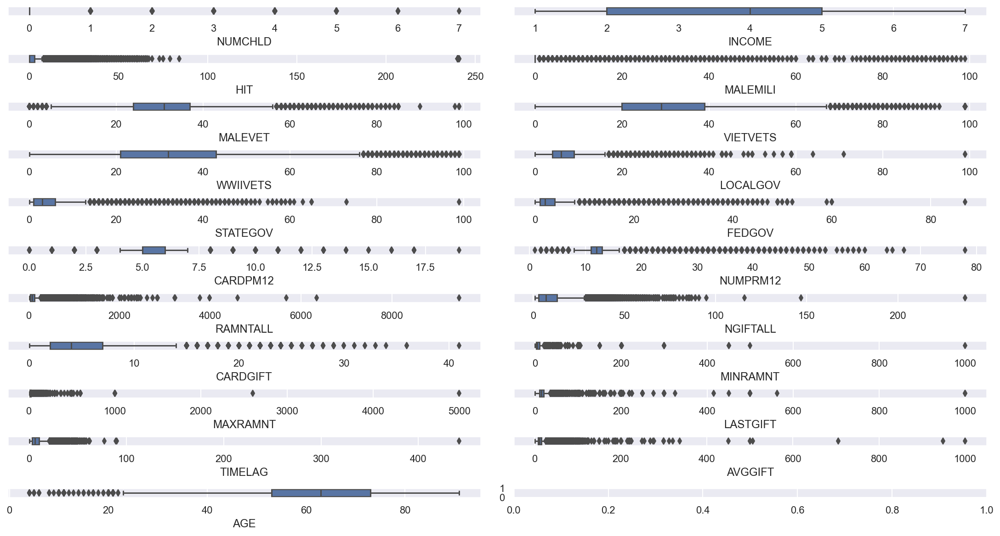

In [155]:
names = list(numeric.columns)
f, axes = plt.subplots(11, 2, figsize=(15,8), constrained_layout=True)  
y = 0;
for name in names:
    i, j = divmod(y, 2)
    sns.boxplot(x=data_out[name], ax=axes[i, j])
    y = y + 1

#plt.tight_layout()
plt.show()

In [156]:
print(len(data_out.HIT[data_out.HIT>100]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.HIT<100]

74 observations were eliminated


In [157]:
print(len(data_out.LOCALGOV[data_out.LOCALGOV>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.LOCALGOV<80]

2 observations were eliminated


In [158]:
print(len(data_out.STATEGOV[data_out.STATEGOV>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.STATEGOV<80]

1 observations were eliminated


In [159]:
print(len(data_out.FEDGOV[data_out.FEDGOV>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.FEDGOV<80]

1 observations were eliminated


In [160]:
print(len(data_out.RAMNTALL[data_out.RAMNTALL>5000]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.RAMNTALL<5000]

3 observations were eliminated


In [161]:
print(len(data_out.NGIFTALL[data_out.NGIFTALL>100]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.NGIFTALL<100]

2 observations were eliminated


In [162]:
print(len(data_out.CARDGIFT[data_out.CARDGIFT>40]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.CARDGIFT<40]

1 observations were eliminated


In [163]:
print(len(data_out.MINRAMNT[data_out.MINRAMNT>250]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.MINRAMNT<250]

8 observations were eliminated


In [164]:
print(len(data_out.MAXRAMNT[data_out.MAXRAMNT>900]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.MAXRAMNT<900]

4 observations were eliminated


In [165]:
print(len(data_out.LASTGIFT[data_out.LASTGIFT>400]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.LASTGIFT<400]

8 observations were eliminated


In [166]:
print(len(data_out.TIMELAG[data_out.TIMELAG>100]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.TIMELAG<100]

1 observations were eliminated


In [167]:
print(len(data_out.AVGGIFT[data_out.AVGGIFT>600]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.AVGGIFT<600]

0 observations were eliminated


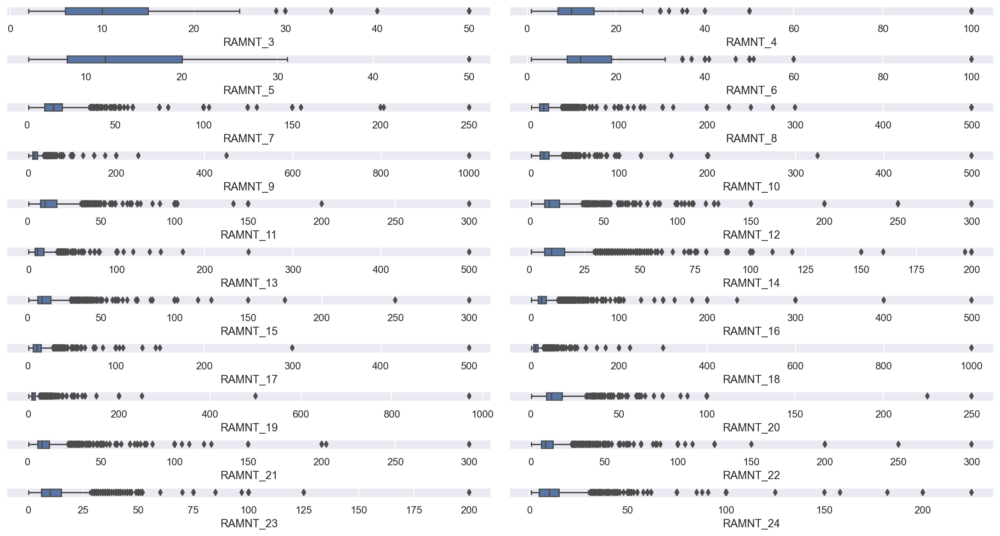

In [168]:
ramnt=data.loc[:,"RAMNT_3":"RAMNT_24"]
names = list(ramnt.columns)
f, axes = plt.subplots(11, 2, figsize=(15,8), constrained_layout=True)  
y = 0;
for name in names:
    i, j = divmod(y, 2)
    sns.boxplot(x=data[name], ax=axes[i, j])
    y = y + 1

#plt.tight_layout()
plt.show()

Since the scale of values does not differ much, we did not considered the points that are far from most observations to be outliers. Instead, we believe that a donnor is free to give more money to the promotions if he desires, without a limit. 

In [169]:
NBHD=data_out.loc[:,'POP901':'HC21'] #vars do Neighborhood
NBHD=NBHD.drop(columns=['ETH1', 'ETH2', 'HHAGE3', 'HV1', 'HHAS1',"HHN3",'LFC2', 'LFC3', 'LFC4', 'LFC5', 'LFC7', 'VC1', 'VC3',
                        'POBC2', 'VOC2', 'HC1'])

In [170]:
NBHD1=NBHD.loc[:,:'POP90C5']
NBHD2=NBHD.loc[:,'AGE904':'LFC10']
NBHD3=NBHD.loc[:,'OEDC1':'VC4']
NBHD4=NBHD.loc[:,'POBC1':'HC21']

In [171]:
neigh=pd.concat([NBHD1, NBHD2,NBHD3,NBHD4], axis=1)

In [172]:
neigh

,POP901,POP90C5,AGE904,AGE907,AGEC1,AGEC2,AGEC3,AGEC4,AGEC5,AGEC6,AGEC7,MARR1,MARR2,MARR3,MARR4,DW7,HU3,HHD2,HHD7,HHD12,RHP1,HUPA3,IC1,IC5,HHAS2,HHAS4,TPE1,TPE2,TPE3,TPE6,TPE7,TPE9,PEC1,TPE10,LFC8,LFC9,LFC10,OEDC1,OEDC2,OEDC3,OEDC4,OEDC5,OEDC6,EC2,EC4,EC6,EC7,AFC1,AFC5,AFC6,VC2,VC4,POBC1,LSC1,HC17,HC21
0,992,53,40,25,11,14,18,17,13,11,15,61,7,12,19,7,96,80,6,3,58,0,307,12883,4,1,88,8,0,0,0,4,1,14,99,0,0,10,2,1,7,78,2,16,39,8,4,0,39,0,23,16,3,88,33,99
1,3611,50,32,32,13,14,33,23,10,4,2,69,4,3,24,0,97,94,4,2,76,0,1088,36175,2,3,80,14,0,0,0,6,0,24,99,99,0,6,2,1,16,69,5,5,12,7,30,0,15,0,10,0,42,50,99,99
2,7001,51,37,23,13,20,19,16,13,10,8,63,9,9,19,3,93,76,7,3,49,24,251,11576,8,11,74,22,0,0,0,2,1,19,82,99,4,6,7,1,8,74,3,22,28,6,5,0,21,0,23,8,2,96,22,92
3,640,46,34,25,15,25,17,17,12,7,7,63,9,6,23,2,93,73,6,4,55,9,386,15130,14,20,58,36,0,0,0,0,0,13,0,99,23,3,0,3,6,87,0,28,14,10,3,0,23,0,40,16,29,56,23,89
4,2520,54,36,27,14,21,13,15,20,12,5,42,17,9,33,0,97,82,20,1,52,0,240,9836,8,14,73,22,1,0,0,1,2,24,81,99,10,26,3,2,7,49,12,16,30,3,12,1,28,4,16,20,1,99,99,96
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95405,27380,50,29,30,16,31,25,15,8,3,1,58,15,3,24,0,89,72,12,8,52,13,433,18807,6,6,76,15,2,0,0,2,1,18,61,94,7,7,8,13,6,59,7,2,28,8,15,8,35,5,15,25,4,92,93,98
95406,1254,49,28,39,9,19,43,17,7,4,2,73,4,2,20,0,97,89,2,1,82,10,806,26538,5,7,80,4,4,0,0,5,3,25,99,0,0,4,1,0,4,78,12,1,12,7,36,0,31,8,5,15,2,94,69,97
95407,552,47,30,32,13,34,21,9,9,9,4,45,19,5,31,0,95,64,16,9,51,0,263,12178,13,26,83,17,0,0,0,0,0,17,62,0,25,7,23,0,0,52,18,5,51,7,11,0,18,0,0,20,6,92,99,99
95408,1746,53,36,25,12,21,21,18,12,7,9,56,9,8,27,5,99,85,8,6,65,0,552,15948,2,3,80,11,0,0,1,6,0,18,99,99,0,9,1,1,7,72,8,7,20,12,15,0,28,1,18,8,14,83,99,99


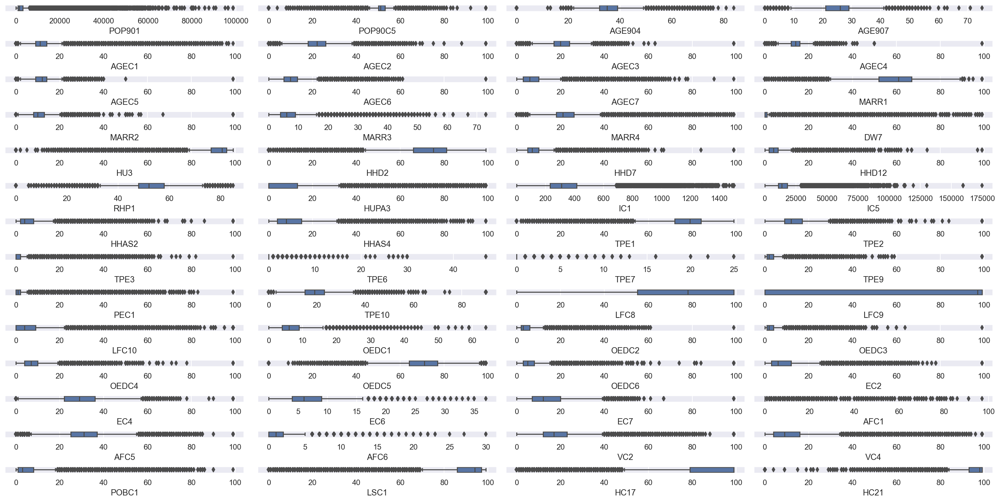

In [173]:
names = list(neigh.columns)
f, axes = plt.subplots(14, 4, figsize=(20,10), constrained_layout=True)  
y = 0;
for name in names:
    i, j = divmod(y, 4)
    sns.boxplot(x=neigh[name], ax=axes[i, j])
    y = y + 1

#plt.tight_layout()
plt.show()

In [174]:
print(len(data_out.AGE904[data_out.AGE904==0]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.AGE904!=0]

798 observations were eliminated


In [175]:
print(len(data_out.AGEC3[data_out.AGEC3>70]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.AGEC3<70]

3 observations were eliminated


In [176]:
print(len(data_out.AGEC4[data_out.AGEC4>60]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.AGEC4<60]

2 observations were eliminated


In [177]:
print(len(data_out.AGEC5[data_out.AGEC5>60]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.AGEC5<60]

2 observations were eliminated


In [178]:
print(len(data_out.AGEC6[data_out.AGEC6>70]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.AGEC6<70]

2 observations were eliminated


In [179]:
print(len(data_out.AGEC7[data_out.AGEC7>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.AGEC7<80]

2 observations were eliminated


In [180]:
print(len(data_out.MARR2[data_out.MARR2>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.MARR2<80]

0 observations were eliminated


In [181]:
print(len(data_out.HHD7[data_out.HHD7>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.HHD7<80]

3 observations were eliminated


In [182]:
print(len(data_out.HHD12[data_out.HHD12>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.HHD12<80]

3 observations were eliminated


In [183]:
print(len(data_out.IC5[data_out.IC5>150000]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.IC5<150000]

4 observations were eliminated


In [184]:
print(len(data_out.HHAS2[data_out.HHAS2>90]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.HHAS2<90]

5 observations were eliminated


In [185]:
print(len(data_out.TPE2[data_out.TPE2>90]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.TPE2<90]

5 observations were eliminated


In [186]:
print(len(data_out.TPE3[data_out.TPE3>90]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.TPE3<90]

1 observations were eliminated


In [187]:
print(len(data_out.TPE6[data_out.TPE6>40]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.TPE6<40]

2 observations were eliminated


In [188]:
print(len(data_out.TPE9[data_out.TPE9>90]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.TPE9<90]

9 observations were eliminated


In [189]:
print(len(data_out.PEC1[data_out.PEC1>90]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.PEC1<90]

1 observations were eliminated


In [190]:
print(len(data_out.TPE10[data_out.TPE10>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.TPE10<80]

72 observations were eliminated


In [191]:
print(len(data_out.OEDC2[data_out.OEDC2>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.OEDC2<80]

1 observations were eliminated


In [192]:
print(len(data_out.OEDC3[data_out.OEDC3>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.OEDC3<80]

1 observations were eliminated


In [193]:
print(len(data_out.OEDC4[data_out.OEDC4>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.OEDC4<80]

2 observations were eliminated


In [194]:
print(len(data_out.OEDC6[data_out.OEDC6>90]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.OEDC6<90]

3 observations were eliminated


In [195]:
print(len(data_out.EC2[data_out.EC2>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.EC2<80]

2 observations were eliminated


In [196]:
print(len(data_out.EC7[data_out.EC7>80]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[data_out.EC7<80]

4 observations were eliminated


#### Countplots Analysis

In [199]:
categorical_out=data_out[["GENDER", "SOLP3", "SOLIH", "DOMAIN_1", "DOMAIN_2", "RFA_2F", "RFA_2A", "MDMAUD_R", "MDMAUD_F", "MDMAUD_A"]]
categorical_out.head(5)

,GENDER,SOLP3,SOLIH,DOMAIN_1,DOMAIN_2,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A
0,F,,,T,2,4,E,X,X,X
1,M,,,S,1,2,G,X,X,X
2,M,,,R,2,4,E,X,X,X
3,F,,,R,2,4,E,X,X,X
4,F,,12,S,2,2,F,X,X,X


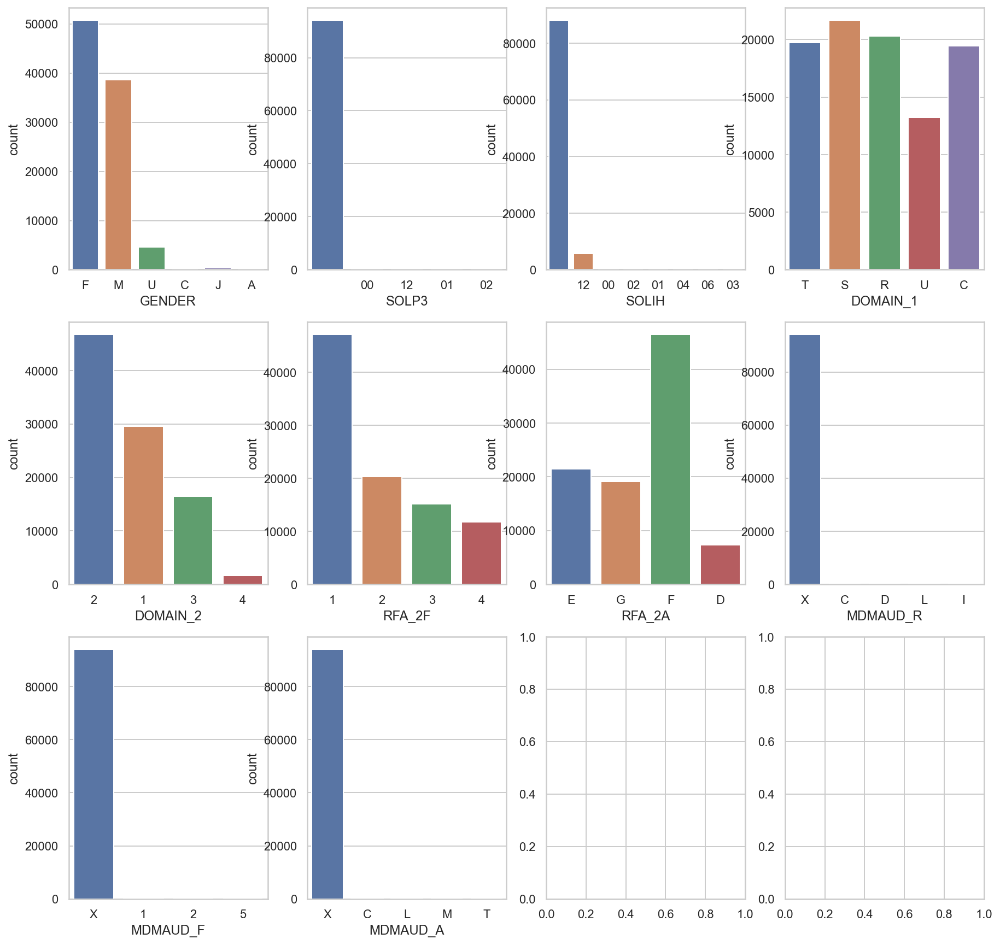

In [200]:
# Funciona
sns.set_style("whitegrid")
fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(15,15))

ax1=sns.countplot(categorical_out["GENDER"], ax=axes[0,0])
ax2=sns.countplot(categorical_out["SOLP3"], ax=axes[0,1])
ax3=sns.countplot(categorical_out["SOLIH"], ax=axes[0,2])
ax4=sns.countplot(categorical_out["DOMAIN_1"], ax=axes[0,3])
ax5=sns.countplot(categorical_out["DOMAIN_2"], ax=axes[1,0])
ax6=sns.countplot(categorical_out["RFA_2F"], ax=axes[1,1])
ax7=sns.countplot(categorical_out["RFA_2A"], ax=axes[1,2])
ax8=sns.countplot(categorical_out["MDMAUD_R"], ax=axes[1,3])
ax9=sns.countplot(categorical_out["MDMAUD_F"], ax=axes[2,0])
ax10=sns.countplot(categorical_out["MDMAUD_A"], ax=axes[2,1])

In [201]:
print(len(data_out.GENDER[(data_out.GENDER=="C")|(data_out.GENDER=="A")]), "observations were eliminated") #see how many observations are in the distant point 
#drop them
data_out=data_out[(data_out.GENDER!="C")&(data_out.GENDER!="A")]

4 observations were eliminated


In [202]:
print("The percentage of observations removed is: ", round((1-(len(data_out)/len(data)))*100, 2))

The percentage of observations removed is:  1.09


In [594]:
out_first=data_new[~data_new['CONTROLN'].isin(data_out['CONTROLN'])] #outliers manually 

In [204]:
data_new.drop(columns=data_new.loc[:,"AGEC2":"AGEC7"], inplace=True)

In [205]:
data_new.drop(columns=['SOLP3','SOLIH','RECP3','RECINHSE'], inplace=True)

#### DBSCAN

In [206]:
#data_out_2=data_clean.copy()

In [207]:
#numeric_2=outliers[["NUMCHLD",'INCOME','HIT','MALEMILI','MALEVET','VIETVETS','WWIIVETS','LOCALGOV','STATEGOV','FEDGOV',
#                  'CARDPM12','NUMPRM12','RAMNTALL','NGIFTALL','CARDGIFT','MINRAMNT','MAXRAMNT','LASTGIFT','TIMELAG', "AVGGIFT",'AGE']]  

In [208]:
#NBHD=data_out_2.loc[:,'POP901':'HC21'] #vars do Neighborhood
#NBHD=NBHD.drop(columns=['ETH1', 'ETH2', 'HHAGE3', 'HV1', 'HHAS1',"HHN3",'LFC2', 'LFC3', 'LFC4', 'LFC5', 'LFC7', 'VC1', 'VC3',
#                    'POBC2', 'VOC2', 'HC1'])
#NBHD1=NBHD.loc[:,:'POP90C5']
#NBHD2=NBHD.loc[:,'AGE904':'LFC10']
#NBHD3=NBHD.loc[:,'OEDC1':'VC4']
#NBHD4=NBHD.loc[:,'POBC1':'HC21']

In [209]:
#neigh_2=pd.concat([NBHD1, NBHD2,NBHD3,NBHD4], axis=1)

In [210]:
#get only numeric variables to apply the method
#numeric_2=pd.concat([neigh_2, numeric_2], axis=1)

In [211]:
# Perform DBSCAN clustering 
#from sklearn.cluster import MeanShift, DBSCAN, estimate_bandwidth

#dbscan = DBSCAN(eps=1200, min_samples=20, n_jobs=4)
#eps é o epsilon que é o radious
#dbscan_labels = dbscan.fit_predict(numeric_2)
#dbscan_n_clusters = len(np.unique(dbscan_labels)) 
#print("Number of estimated clusters : %d" % dbscan_n_clusters)

In [212]:
# Concatenating the labels to df
#df_concat = pd.concat([numeric_2, pd.Series(dbscan_labels, index=numeric_2.index, name="dbscan_labels")], axis=1)
#df_concat.head()

In [213]:
#outliers=df_concat.loc[df_concat['dbscan_labels'] == -1]

In [214]:
#outliers

In [215]:
#print("Percentage outliers:", round(len(outliers)/len(numeric_2)*100, 2), "%")

In [216]:
#comum=[]
#not_outliers=list(data_out.index) #mantidos
#for i in outliers.index: #outliers dbscan 
#    if i not in not_outliers:
#        comum.append(i) 

In [217]:
#len(comum)

In [218]:
#len(outliers)
#uma opcao seria apagar estes e os outros também pq continuava a ser menos de 3%

In [219]:
#outra tentativa que funciona só para ver quantos dá 
#outlier_detection = DBSCAN(min_samples = 20, eps = 1200)
#clusters = outlier_detection.fit_predict(numeric_2)
#list(clusters).count(-1)

#### Check kept and new variables

In [220]:
#  profile = ProfileReport(
#      data_new, minimal=True,
#      title='PVA Donors New Data',
#      correlations={
#          "pearson": {"calculate": True},
#          "spearman": {"calculate": False},
#          "kendall": {"calculate": False},
#          "phi_k": {"calculate": False},
#          "cramers": {"calculate": False},},)

#  profile.to_file(output_file='PVA Donors New Data.html')

### Checking correlations -> dimensionality reduction

In [221]:
data_new=data_out.copy()

In [222]:
numeric=data_new[["NUMCHLD",'INCOME','HIT','MALEMILI','MALEVET','VIETVETS','WWIIVETS','LOCALGOV','STATEGOV','FEDGOV',
                  'CARDPM12','NUMPRM12','RAMNTALL','NGIFTALL','CARDGIFT','MINRAMNT','MAXRAMNT','LASTGIFT','TIMELAG', "AVGGIFT",'AGE']]  

#Create a dataset with all the numeric variables to see the correlations
created_numeric=data_new.loc[:,"DOMAIN_2":"E_Pub"] #numerics created 
neigh_numeric=data_new.loc[:,"POP901":"HC21"] #numerics from the neighborhood
others=data_new[["Younger adults"]] #another numeric created

to_concat = [numeric, neigh_numeric, others, created_numeric]  
all_numeric = pd.concat(to_concat, axis=1) #108 variaveis

In [223]:
all_numeric.drop(columns=["Childhome", "Teenhome", "DOMAIN_2"], inplace=True) #non numeric that were included

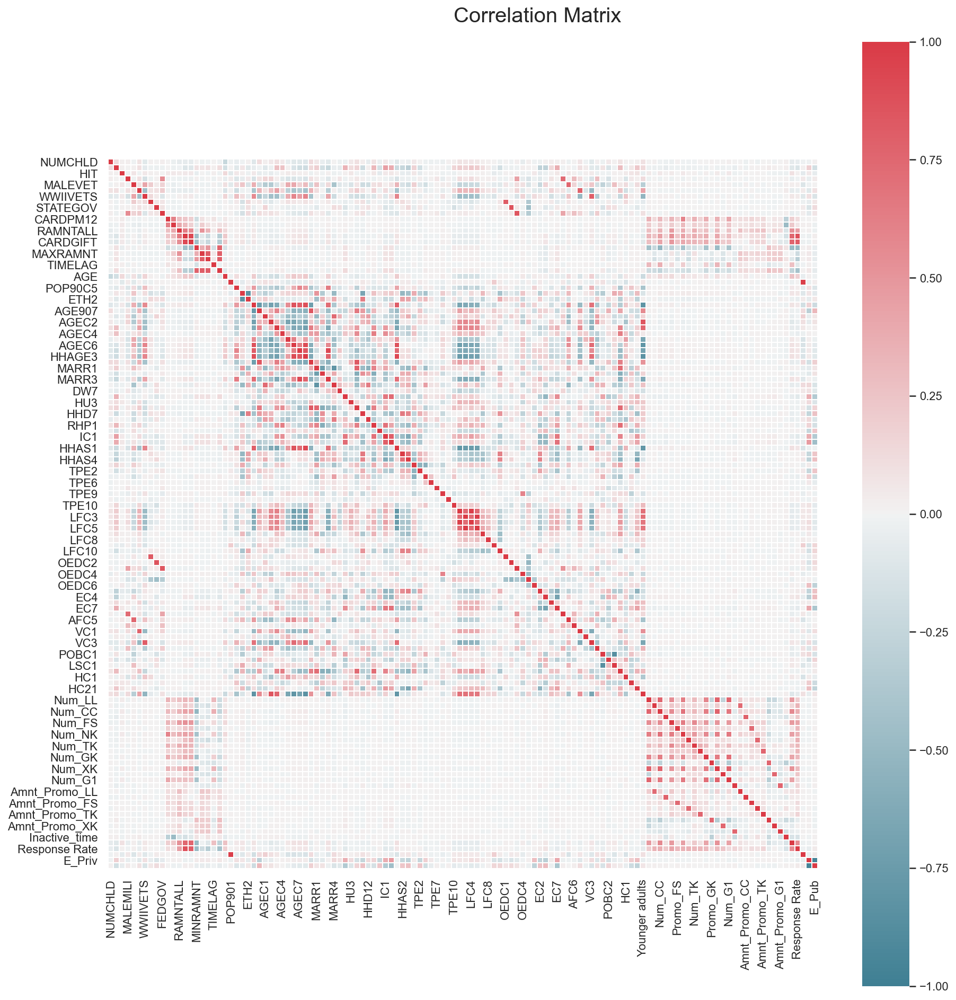

In [224]:
#all correlations

fig = plt.figure(figsize=(15, 15))

corr = np.round(all_numeric.corr(method="pearson") , decimals=2)

mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) 

sns.heatmap(data=corr, annot=False, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()

#### High correlations

In [225]:
#see numeric variables that are correlated with absolute value equal or bigger than 0.75
c = all_numeric.corr().abs()

s = c.unstack()
so = s.sort_values(kind="quicksort")
so=so[(so>=0.75)&(so!=1)]

print (so)

HHAS1              LFC4                 0.751835
LFC4               HHAS1                0.751835
Promo_XK           Amnt_Promo_XK        0.752123
Amnt_Promo_XK      Promo_XK             0.752123
LFC3               HHAS1                0.753112
HHAS1              LFC3                 0.753112
HHAGE3             LFC2                 0.753128
LFC2               HHAGE3               0.753128
Promo_TK           Amnt_Promo_TK        0.755420
Amnt_Promo_TK      Promo_TK             0.755420
Num_LL             Num_CC               0.756730
Num_CC             Num_LL               0.756730
Donation_activity  CARDGIFT             0.757670
CARDGIFT           Donation_activity    0.757670
Promo_GK           Amnt_Promo_GK        0.757792
Amnt_Promo_GK      Promo_GK             0.757792
HHD2               MARR1                0.759223
MARR1              HHD2                 0.759223
Num_LL             Num_G1               0.759736
Num_G1             Num_LL               0.759736
Amnt_Promo_G1      P

1. Manter LFC5
LFC3: Percent Females in Labor Force
LFC5: Percent Adult Females Employed

2. Manter POP901
POP901: total pop
n_students: number students 

3. Manter LFC4
LFC2: Percent Adult Males in Labor Force
LFC4: Percent Adult Males Employed 

4. Complementares, manter E_Pub 
E_Priv 
E_Pub literalmente 

5. Manter HHAS1
HHAS1: Percent Households on Social Security
HHAGE3: Percent Households Headed by an Elderly Person Age 65+

6. Manter NGIFTALL
NGIFTALL: Number of lifetime gifts to date
CARDGIFT: Number of lifetime gifts to card promotions to date

7. HHAGE3 já eliminado acima, manter AGE904
AGE904: Average Age of Population
HHAGE3

8. Manter STATEGOV
STATEGOV: % Employed by State Gov
OEDC2: Percent Employed by State Government

9. Manter POBC1
LSC1: Percent English Only Speaking
POBC1: Percent Foreign Born

10. Manter FEDGOV 
OEDC3: Percent Employed by Federal Government           
FEDGOV: % Employed by Fed Gov 

11. Manter só HHN3
AGE907: Percent Population Under Age 18
HHN3: Percent 3 or More Person Households

12. HHAGE3 já eliminado acima, manter Younger adults 
HHAGE3:Percent Households Headed by an Elderly Person Age 65+      
Younger adults

13. Manter ETH1
ETH2:Percent Black
ETH1:Percent White

14. Manter LOCALGOV
LOCALGOV: % Employed by Local Gov     
OEDC1: Percent Employed by Local Government

15. Manter AGE904
AGE904: Average Age of Population   
Younger adults

16. Manter HHD2 
HHN3: Percent 3 or More Person Households  
HHD2: Percent household w/ family

17. Manter LASTGIFT 
LASTGIFT       
MAXRAMNT 

18. Manter MARR1
MARR1: Percent Married           
MARR4: Percent Never Married

19. Manter AVGGIFT 
AVGGIFT:  Average dollar amount of gifts to date       
LASTGIFT: Dollar amount of most recent gift

20. Manter AGE904
HHAS1: Percent Households on Social Security           
AGE904: Average Age of Population

21. MAXRAMNT já eliminado acima, manter AVGGIFT
MAXRAMNT: Dollar amount of largest gift to date
AVGGIFT: Average dollar amount of gifts to date 

22. Manter WWIIVETS
VC3: Percent WW2 Veterans Age 16+
WWIIVETS: % WWII Vets


- CORRELAÇÃO ABAIXO 0.80 -


23. Manter IC5 
IC1: Median Household Income in hundreds            
IC5: Per Capita Income

24. 
Younger adults: apagada em 15.
HHAS1: apagada em 20.

25. CORR NEG
HHAS1: apagada em 20.  (percent Households on Social Security)   
LFC2: apagada em 3.  (Percent Adult Males in Labor Force) 

26. Manter MARR3
MARR3: Percent Widowed
HHAGE3: apagado em 5. (Percent Households Headed by an Elderly Person Age 65+)

27. Manter VIETVETS
VIETVETS: % WWII Vets
VC1: Percent Vietnam Veterans Age 16+

28. Manter Num_G1
Num_XK: For mailings that are Christmas cards with labels       
Num_G1: For mailings with labels and a notepad

29. Manter Num_CC
Num_CC: For mailings that are calendars with stickers without labels
Num_XK: apagado em 28.

30. Manter Amnt_Promo_CC
Amnt_Promo_CC  : preço medio p promocao cc
Promo_CC: proporcao de vezes a q doou p cc

31. Manter AVGGIFT
MINRAMNT        
AVGGIFT

32. Manter Num_LL
Num_XK: apagado em 28.
Num_LL: For mailings with labels only

33. Manter AGE904
AGE904: Average Age of Population        
AGE907: apagado em 11.

34. Manter Amnt_Promo_G1 
Promo_G1        
Amnt_Promo_G1

35. Manter Num_LL
Num_LL: For mailings with labels only          
Num_G1: For mailings with labels and a notepad

36. Manter HHD2
MARR1: Percent Married
HHD2: Percent Households w/ Families

37. Manter Amnt_Promo_GK
Promo_GK        
Amnt_Promo_GK

38. Manter Num_LL
Num_CC:For mailings that are calendars with stickers without labels
Num_LL:For mailings with labels only

39. Manter Amnt_Promo_TK
Amnt_Promo_TK   
Promo_TK

40. 
LFC2: apagado em 3.  (Percent Adult Males in Labor Force)
HHAGE3: apagado em 5. (Percent Households Headed by an Elderly Person Age 65+)

41. 
LFC3: apagado em 1.          
HHAS1: apagada em 20.

42. Manter Amnt_Promo_XK
Amnt_Promo_XK   
Promo_XK

43. Manter LFC4
LFC4: Percent Adult Males Employed        
HHAS1: apagada em 20.

In [226]:
# Drop variables very correlated and with less relevance for our goal
data_new=data_new.drop(columns=['LFC3', 'n_students', 'LFC2', 'E_Priv', 'HHAGE3', 'CARDGIFT', 'OEDC2', 'LSC1', 'OEDC3','AGE907',
                               'ETH2', 'OEDC1', 'Younger adults', 'HHN3', 'MAXRAMNT', 'MARR4', 'LASTGIFT', 'HHAS1',
                               'VC3', 'IC1', 'VC1', 'Num_XK', 'Promo_CC', 'MINRAMNT', 'Promo_G1', 'Num_G1', 'MARR1',
                               'Promo_GK', 'Num_CC', 'Promo_TK', 'Promo_XK'])

In [227]:
data_new.shape

(94374, 148)

In [228]:
all_numeric=all_numeric.drop(columns=['LFC3', 'n_students', 'LFC2', 'E_Priv', 'HHAGE3', 'CARDGIFT', 'OEDC2', 'LSC1', 'OEDC3','AGE907',
                               'ETH2', 'OEDC1', 'Younger adults', 'HHN3', 'MAXRAMNT', 'MARR4', 'LASTGIFT', 'HHAS1',
                               'VC3', 'IC1', 'VC1', 'Num_XK', 'Promo_CC', 'MINRAMNT', 'Promo_G1', 'Num_G1', 'MARR1',
                               'Promo_GK', 'Num_CC', 'Promo_TK', 'Promo_XK'])

In [229]:
all_numeric

,NUMCHLD,INCOME,HIT,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,CARDPM12,NUMPRM12,RAMNTALL,NGIFTALL,TIMELAG,AVGGIFT,AGE,POP901,POP90C5,ETH1,AGE904,AGEC1,AGEC2,AGEC3,AGEC4,AGEC5,AGEC6,AGEC7,MARR2,MARR3,DW7,HV1,HU3,HHD2,HHD7,HHD12,RHP1,HUPA3,IC5,HHAS2,HHAS4,TPE1,TPE2,TPE3,TPE6,TPE7,TPE9,PEC1,TPE10,LFC4,LFC5,LFC7,LFC8,LFC9,LFC10,OEDC4,OEDC5,OEDC6,EC2,EC4,EC6,EC7,AFC1,AFC5,AFC6,VC2,VC4,POBC1,POBC2,VOC2,HC1,HC17,HC21,Num_LL,Promo_LL,Num_FS,Promo_FS,Num_NK,Promo_NK,Num_TK,Num_GK,Amnt_Promo_LL,Amnt_Promo_CC,Amnt_Promo_FS,Amnt_Promo_NK,Amnt_Promo_TK,Amnt_Promo_GK,Amnt_Promo_XK,Amnt_Promo_G1,Inactive_time,Donation_activity,Response Rate,E_Pub
0,0.0,3.25,0,0,39,34,18,10,2,1,6,14,240.0,31,4.0,7.741935,64.0,992,53,92,40,11,14,18,17,13,11,15,7,12,7,479,96,80,6,3,58,0,12883,4,1,88,8,0,0,0,4,1,14,64,44,53,99,0,0,7,78,2,16,39,8,4,0,39,0,23,16,3,74,77,13,33,99,4,0.500000,2,0.5,5,0.40,2,2,5.250000,0.0,5.5,3.8,5.5,0.0,0.0,2.75,548.0,2221,0.418919,80.00
1,1.0,6.00,16,0,15,55,11,6,2,1,6,13,47.0,3,18.0,15.666667,49.0,3611,50,67,32,13,14,33,23,10,4,2,4,3,0,5468,97,94,4,2,76,0,36175,2,3,80,14,0,0,0,6,0,24,81,57,57,99,99,0,16,69,5,5,12,7,30,0,15,0,10,0,42,39,92,5,99,99,4,0.250000,0,0.0,4,0.00,1,1,3.000000,12.5,0.0,0.0,0.0,0.0,0.0,0.00,548.0,791,0.093750,63.16
2,0.0,3.00,2,0,20,29,33,6,8,1,6,14,202.0,27,12.0,7.481481,67.0,7001,51,96,37,13,20,19,16,13,10,8,9,9,3,497,93,76,7,3,49,24,11576,8,11,74,22,0,0,0,2,1,19,70,56,62,82,99,4,8,74,3,22,28,6,5,0,21,0,23,8,2,84,65,9,22,92,2,0.500000,2,0.5,5,0.40,2,2,4.500000,0.0,3.5,3.0,0.0,4.0,9.5,0.00,548.0,2160,0.428571,95.83
3,0.0,1.00,2,0,23,14,31,3,0,3,6,14,109.0,16,9.0,6.812500,73.0,640,46,61,34,15,25,17,17,12,7,7,9,6,2,1000,93,73,6,4,55,9,15130,14,20,58,36,0,0,0,0,0,13,68,45,31,0,99,23,6,87,0,28,14,10,3,0,23,0,40,16,29,67,43,4,23,89,3,0.666667,1,0.0,4,0.25,2,2,4.333333,0.0,0.0,2.5,0.0,0.0,5.0,8.00,548.0,3225,0.242424,100.00
4,1.0,3.00,60,1,28,9,53,26,3,2,10,25,254.0,37,14.0,6.864865,81.0,2520,54,2,36,14,21,13,15,20,12,5,17,9,0,576,97,82,20,1,52,0,9836,8,14,73,22,1,0,0,1,2,24,65,49,31,81,99,10,7,49,12,16,30,3,12,1,28,4,16,20,1,65,45,25,99,96,4,0.000000,2,0.0,5,0.20,1,2,0.000000,0.0,0.0,2.0,0.0,7.5,0.0,0.00,517.0,6150,0.327434,92.86
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95405,0.0,4.55,0,14,36,47,11,7,8,13,5,12,25.0,1,0.0,25.000000,47.0,27380,50,78,29,16,31,25,15,8,3,1,15,3,0,988,89,72,12,8,52,13,18807,6,6,76,15,2,0,0,2,1,18,83,69,57,61,94,7,6,59,7,2,28,8,15,8,35,5,15,25,4,26,60,3,93,98,1,0.000000,0,0.0,2,0.00,1,1,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,25.00,486.0,0,0.071429,89.66
95406,1.0,7.00,1,0,31,43,19,4,1,0,3,8,20.0,1,0.0,20.000000,51.0,1254,49,91,28,9,19,43,17,7,4,2,4,2,0,1679,97,89,2,1,82,10,26538,5,7,80,4,4,0,0,5,3,25,87,52,43,99,0,0,4,78,12,1,12,7,36,0,31,8,5,15,2,51,84,4,69,97,0,0.000000,0,0.0,1,0.00,0,1,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,20.00,457.0,0,0.100000,79.55
95407,0.0,2.83,0,0,18,46,20,7,23,0,7,17,58.0,7,3.0,8.285714,63.0,552,47,82,30,13,34,21,9,9,9,4,19,5,0,376,95,64,16,9,51,0,12178,13,26,83,17,0,0,0,0,0,17,70,69,24,62,0,25,0,52,18,5,51,7,11,0,18,0,0,20,6,82,42,6,99,99,3,0.000000,1,0.0,4,0.00,2,2,0.000000,0.0,0.0,0.0,0.0,10.0,7.5,0.00,243.0,731,0.212121,84.21
95408,0.0,7.00,0,0,28,35,20,9,1,1,9,31,498.0,41,4.0,12.146341,61.0,1746,53,92,36,12,21,21,18,12,7,9,9,8,5,2421,99,85,8,6,65,0,15948,2,3,80,11,0,0,1,6,0,18,85,57,54,99,99,0,7,72,8,7,20,12,15,0,28,1,18,8,14,50,85,9,99,99,4,0.500000,2,0.5,5,0.00,2,2,9.000000,0.0,10.0,0.0,16.5,7.5,10.0,8.25,151.0,3684,0.322835,82.86


#### Low correlations

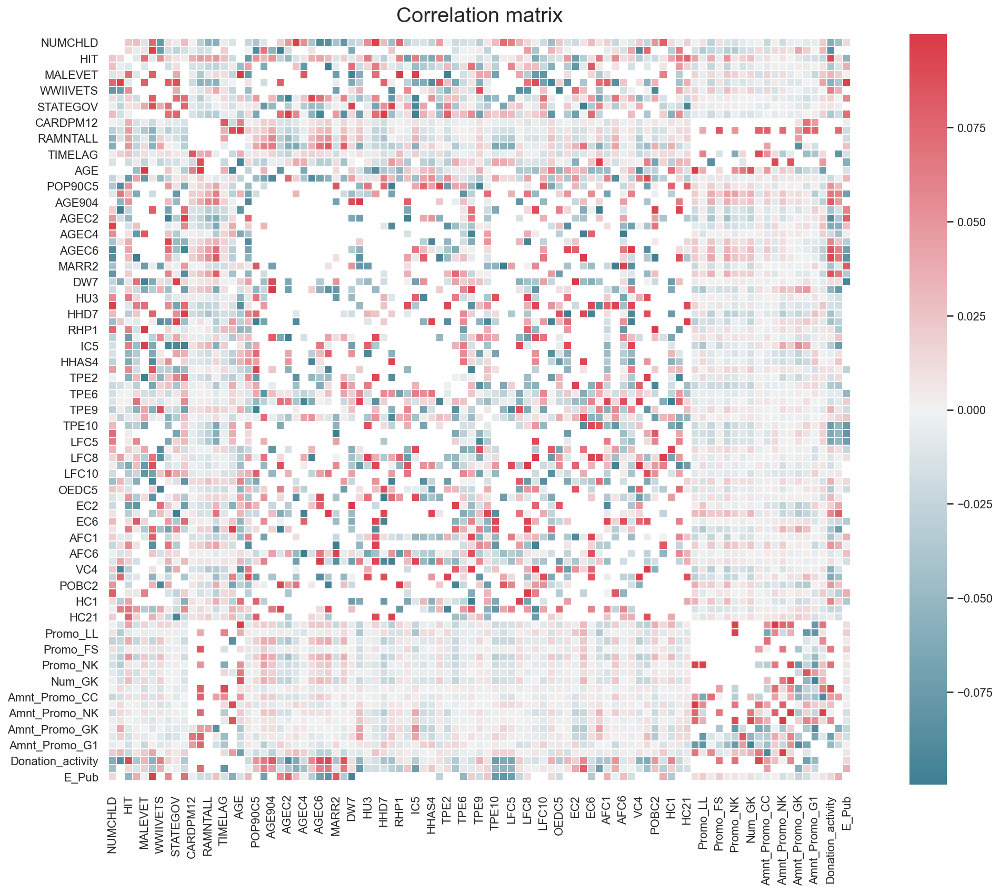

In [230]:
sns.set(style="white")

# Compute the correlation matrix
corr = all_numeric.corr() #Getting correlation of numerical variables

# Set up the matplotlib figure
fig, ax = plt.subplots(figsize=(20, 12))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True) #Make a diverging palette between two HUSL colors. Return a matplotlib colormap object.

# Draw the heatmap with the mask and correct aspect ratio
#show only corr bigger than 0.7 in absolute value
sns.heatmap(corr[(corr<=.1)&(corr>=-.1)], cmap=cmap, center=0, square=True, linewidths=.5, ax=ax)

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Correlation matrix", fontsize=20)
plt.yticks(rotation=0)
plt.xticks(rotation=90)
# Fixing the bug of partially cut-off bottom and top cells
b, t = plt.ylim() # discover the values for bottom and top
b += 0.5 # Add 0.5 to the bottom
t -= 0.5 # Subtract 0.5 from the top
plt.ylim(b, t) # update the ylim(bottom, top) values

plt.show()

OUT OF 89 VARS:   5/88= var correlated with (at max) 5% of the remaining variables

.1)  'NUMCHLD' - only correlated to 3/88 variables 

- .3)  'HIT' - only correlated to 1/88 variables

- .15) 'TIMELAG' - only correlated to 5/88 variables

.18) 'POP901' - only correlated to 3/88 variables

- .39) 'TPE6' - only correlated to 5/88 variables 

- .40) 'TPE7' - only correlated to 5/88 variables  

- .42) 'PEC1' - only correlated to 2/88 variables

- .48) 'LFC9' - only correlated to 4/88 variables

- .80) 'Amnt_Promo_CC' - only correlated to 5/88 variables

- .85) 'Amnt_Promo_XK', - only correlated to 3/88 variables

- .86) 'Amnt_Promo_G1', - only correlated to 2/88 variables


In [231]:
data_new.drop(columns=["HIT",'TIMELAG','TPE6','TPE7','PEC1','LFC9',
                       'Amnt_Promo_CC', 'Amnt_Promo_XK','Amnt_Promo_G1'], inplace=True)

In [232]:
data_new.shape

(94374, 139)

In [233]:
data_new.head(3)

,STATE,RECINHSE,RECP3,HOMEOWNR,NUMCHLD,INCOME,GENDER,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,SOLP3,SOLIH,MAJOR,COLLECT1,VETERANS,BIBLE,CATLG,PETS,CDPLAY,STEREO,PCOWNERS,PHOTO,CRAFTS,FISHER,GARDENIN,WALKER,PEPSTRFL,POP901,POP90C5,ETH1,AGE904,AGEC1,AGEC2,AGEC3,AGEC4,AGEC5,AGEC6,AGEC7,MARR2,MARR3,DW7,HV1,HU3,HHD2,HHD7,HHD12,RHP1,HUPA3,IC5,HHAS2,HHAS4,TPE1,TPE2,TPE3,TPE9,TPE10,LFC4,LFC5,LFC7,LFC8,LFC10,OEDC4,OEDC5,OEDC6,EC2,EC4,EC6,EC7,AFC1,AFC5,AFC6,VC2,VC4,POBC1,POBC2,VOC2,HC1,HC17,HC21,CARDPM12,NUMPRM12,RAMNTALL,NGIFTALL,MINRDATE,MAXRDATE,LASTDATE,FISTDATE,AVGGIFT,CONTROLN,HPHONE_D,RFA_2R,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,AGE,DOMAIN_1,DOMAIN_2,Childhome,Teenhome,Num_LL,Promo_LL,Num_FS,Promo_FS,Num_NK,Promo_NK,Num_TK,Num_GK,Amnt_Promo_LL,Amnt_Promo_FS,Amnt_Promo_NK,Amnt_Promo_TK,Amnt_Promo_GK,Inactive_time,Donation_activity,Response Rate,E_Pub,1st ANC,1st ETH,2nd ETH,3rd ETH,1st Role,2nd Role,3rd Role,1st Sect,2nd Sect,3rd Sect,Adults,Elders,RefusePromo,ProgramDonor,Gadgets,Hobbies,Republicans
0,IL,0,0,U,0.0,3.25,F,0,39,34,18,10,2,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,992,53,92,40,11,14,18,17,13,11,15,7,12,7,479,96,80,6,3,58,0,12883,4,1,88,8,0,4,14,64,44,53,99,0,7,78,2,16,39,8,4,0,39,0,23,16,3,74,77,13,33,99,6,14,240.0,31,2012-08-01,2014-02-01,2015-12-01,2009-11-01,7.741935,95515,0,L,4,E,X,X,X,64.0,T,2,0,0,4,0.50,2,0.5,5,0.4,2,2,5.25,5.5,3.8,5.5,0.0,548.0,2221,0.418919,80.00,ANC4,ETH1,ETH5,ETH13,OCC11,OCC10,OCC4,EIC4,EIC8,EIC13,30,26,0,0,0,0,0
1,CA,0,0,H,1.0,6.00,M,0,15,55,11,6,2,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3611,50,67,32,13,14,33,23,10,4,2,4,3,0,5468,97,94,4,2,76,0,36175,2,3,80,14,0,6,24,81,57,57,99,0,16,69,5,5,12,7,30,0,15,0,10,0,42,39,92,5,99,99,6,13,47.0,3,2013-10-01,2015-12-01,2015-12-01,2013-10-01,15.666667,148535,0,L,2,G,X,X,X,49.0,S,1,0,1,4,0.25,0,0.0,4,0.0,1,1,3.00,0.0,0.0,0.0,0.0,548.0,791,0.093750,63.16,ANC4,ETH1,ETH4,ETH10,OCC2,OCC1,OCC4,EIC8,EIC4,EIC9,33,6,0,0,0,0,0
2,NC,0,0,U,0.0,3.00,M,0,20,29,33,6,8,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,7001,51,96,37,13,20,19,16,13,10,8,9,9,3,497,93,76,7,3,49,24,11576,8,11,74,22,0,2,19,70,56,62,82,4,8,74,3,22,28,6,5,0,21,0,23,8,2,84,65,9,22,92,6,14,202.0,27,2011-11-01,2012-07-01,2015-12-01,2010-01-01,7.481481,15078,1,L,4,E,X,X,X,67.0,R,2,0,0,2,0.50,2,0.5,5,0.4,2,2,4.50,3.5,3.0,0.0,4.0,548.0,2160,0.428571,95.83,ANC2,ETH1,ETH2,ETH5,OCC11,OCC10,OCC5,EIC4,EIC8,EIC3,29,18,0,0,0,0,1


## Coherence check<a class="anchor"><a id='Coherence'></a></b><br>

In [234]:
data_new["Inactive_time"][(data_new["Inactive_time"]<390)|(data_new["Inactive_time"]>730)]

5        731.0
6        792.0
9        792.0
13       182.0
14       731.0
         ...  
95390    731.0
95392    762.0
95407    243.0
95408    151.0
95409    182.0
Name: Inactive_time, Length: 15532, dtype: float64

In [235]:
#binary to see if the donor is a lapsed donor or not
data_new["Lapsed Donor"]=np.where((data_new["Inactive_time"]<390)|(data_new["Inactive_time"]>730),0, 1)

data_new.drop(columns=['RFA_2R'], inplace=True) # drop this variable, which is incorrect since not all donors are lapsed

In [236]:
# Since the age is based on the current year and the last record of donations is 2017, we consider that donors have to be at least 16 y.o (2021-2017=4 --> 16+4)
len(data_new[data_new['AGE']<20])

435

In [237]:
data_new=data_new[data_new['AGE']>=20] # no donor with less than 16 years old
data_new.reset_index(drop=True, inplace=True)

In [238]:
# Neighbourhoods with no assigned urbanicity level
data_new[data_new['DOMAIN_1'].isnull()] # Já não existem! Foram eliminados com os outliers???
data_new['DOMAIN_1'].value_counts() # A soma de todas as classes que existem faz o total de linhas

S    21610
R    20243
T    19663
C    19304
U    13119
Name: DOMAIN_1, dtype: int64

In [239]:
# Check if the total amount given divided by the total amount of donations is the same as the average amount donated
data_new[['RAMNTALL','NGIFTALL','AVGGIFT']][round((data_new['RAMNTALL']/data_new['NGIFTALL']),0)!=round(data_new['AVGGIFT'],0)]

,RAMNTALL,NGIFTALL,AVGGIFT


In [240]:
data_new.CONTROLN.nunique()==len(data_new) # confirming that each donor has a unique identification number --> no duplicates

True

## Principal Components Analysis<a class="anchor"><a id='PCA'></a></b><br>

In [242]:
data_new

,STATE,RECINHSE,RECP3,HOMEOWNR,NUMCHLD,INCOME,GENDER,MALEMILI,MALEVET,VIETVETS,WWIIVETS,LOCALGOV,STATEGOV,FEDGOV,SOLP3,SOLIH,MAJOR,COLLECT1,VETERANS,BIBLE,CATLG,PETS,CDPLAY,STEREO,PCOWNERS,PHOTO,CRAFTS,FISHER,GARDENIN,WALKER,PEPSTRFL,POP901,POP90C5,ETH1,AGE904,AGEC1,AGEC2,AGEC3,AGEC4,AGEC5,AGEC6,AGEC7,MARR2,MARR3,DW7,HV1,HU3,HHD2,HHD7,HHD12,RHP1,HUPA3,IC5,HHAS2,HHAS4,TPE1,TPE2,TPE3,TPE9,TPE10,LFC4,LFC5,LFC7,LFC8,LFC10,OEDC4,OEDC5,OEDC6,EC2,EC4,EC6,EC7,AFC1,AFC5,AFC6,VC2,VC4,POBC1,POBC2,VOC2,HC1,HC17,HC21,CARDPM12,NUMPRM12,RAMNTALL,NGIFTALL,MINRDATE,MAXRDATE,LASTDATE,FISTDATE,AVGGIFT,CONTROLN,HPHONE_D,RFA_2F,RFA_2A,MDMAUD_R,MDMAUD_F,MDMAUD_A,AGE,DOMAIN_1,DOMAIN_2,Childhome,Teenhome,Num_LL,Promo_LL,Num_FS,Promo_FS,Num_NK,Promo_NK,Num_TK,Num_GK,Amnt_Promo_LL,Amnt_Promo_FS,Amnt_Promo_NK,Amnt_Promo_TK,Amnt_Promo_GK,Inactive_time,Donation_activity,Response Rate,E_Pub,1st ANC,1st ETH,2nd ETH,3rd ETH,1st Role,2nd Role,3rd Role,1st Sect,2nd Sect,3rd Sect,Adults,Elders,RefusePromo,ProgramDonor,Gadgets,Hobbies,Republicans,Lapsed Donor
0,IL,0,0,U,0.0,3.25,F,0,39,34,18,10,2,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,992,53,92,40,11,14,18,17,13,11,15,7,12,7,479,96,80,6,3,58,0,12883,4,1,88,8,0,4,14,64,44,53,99,0,7,78,2,16,39,8,4,0,39,0,23,16,3,74,77,13,33,99,6,14,240.0,31,2012-08-01,2014-02-01,2015-12-01,2009-11-01,7.741935,95515,0,4,E,X,X,X,64.0,T,2,0,0,4,0.500000,2,0.5,5,0.40,2,2,5.250000,5.5,3.8,5.5,0.0,548.0,2221,0.418919,80.00,ANC4,ETH1,ETH5,ETH13,OCC11,OCC10,OCC4,EIC4,EIC8,EIC13,30,26,0,0,0,0,0,1
1,CA,0,0,H,1.0,6.00,M,0,15,55,11,6,2,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3611,50,67,32,13,14,33,23,10,4,2,4,3,0,5468,97,94,4,2,76,0,36175,2,3,80,14,0,6,24,81,57,57,99,0,16,69,5,5,12,7,30,0,15,0,10,0,42,39,92,5,99,99,6,13,47.0,3,2013-10-01,2015-12-01,2015-12-01,2013-10-01,15.666667,148535,0,2,G,X,X,X,49.0,S,1,0,1,4,0.250000,0,0.0,4,0.00,1,1,3.000000,0.0,0.0,0.0,0.0,548.0,791,0.093750,63.16,ANC4,ETH1,ETH4,ETH10,OCC2,OCC1,OCC4,EIC8,EIC4,EIC9,33,6,0,0,0,0,0,1
2,NC,0,0,U,0.0,3.00,M,0,20,29,33,6,8,1,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,7001,51,96,37,13,20,19,16,13,10,8,9,9,3,497,93,76,7,3,49,24,11576,8,11,74,22,0,2,19,70,56,62,82,4,8,74,3,22,28,6,5,0,21,0,23,8,2,84,65,9,22,92,6,14,202.0,27,2011-11-01,2012-07-01,2015-12-01,2010-01-01,7.481481,15078,1,4,E,X,X,X,67.0,R,2,0,0,2,0.500000,2,0.5,5,0.40,2,2,4.500000,3.5,3.0,0.0,4.0,548.0,2160,0.428571,95.83,ANC2,ETH1,ETH2,ETH5,OCC11,OCC10,OCC5,EIC4,EIC8,EIC3,29,18,0,0,0,0,1,1
3,CA,0,0,U,0.0,1.00,F,0,23,14,31,3,0,3,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,640,46,61,34,15,25,17,17,12,7,7,9,6,2,1000,93,73,6,4,55,9,15130,14,20,58,36,0,0,13,68,45,31,0,23,6,87,0,28,14,10,3,0,23,0,40,16,29,67,43,4,23,89,6,14,109.0,16,2007-11-01,2014-11-01,2015-12-01,2007-02-01,6.812500,172556,1,4,E,X,X,X,73.0,R,2,0,0,3,0.666667,1,0.0,4,0.25,2,2,4.333333,0.0,2.5,0.0,0.0,548.0,3225,0.242424,100.00,ANC4,ETH1,ETH5,ETH13,OCC9,OCC1,OCC8,EIC1,EIC8,EIC3,29,14,0,0,0,0,0,1
4,FL,1,1,H,1.0,3.00,F,1,28,9,53,26,3,2,,12,0,0,0,1,1,0,0,1,0,0,1,0,1,1,0,2520,54,2,36,14,21,13,15,20,12,5,17,9,0,576,97,82,20,1,52,0,9836,8,14,73,22,1,1,24,65,49,31,81,10,7,49,12,16,30,3,12,1,28,4,16,20,1,65,45,25,99,96,10,25,254.0,37,2013-10-01,2016-01-01,2016-01-01,1999-03-01,6.864865,7112,1,2,F,X,X,X,81.0,S,2,0,0,4,0.000000,2,0.0,5,0.20,1,2,0.000000,0.0,2.0,0.0,7.5,517.0,6150,0.327434,92.86,ANC1,ETH2,ETH1,ETH5,OCC8,OCC1,OCC5,EIC14,EIC13,EIC8,35,17,0,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93934,AK,0,0,U,0.0,4.55,M,14,36,47,11,7,8,13,,,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,27380,50,

In [243]:
# Separate clean dataframe into several subcategories

Personal_view = data_new[['NUMCHLD','INCOME','AGE', 'AVGGIFT', 'NGIFTALL', 'Response Rate', 
                          'Inactive_time', 'Donation_activity']]
#'STATE', 'HOMEOWNR','GENDER','MAJOR', 'DOMAIN_1','DOMAIN_2','Childhome','Teenhome','Lapsed Donor',
#'COLLECT1','VETERANS','BIBLE','CATLG','PETS','CDPLAY','STEREO','PCOWNERS','PHOTO','CRAFTS','FISHER','GARDENIN',
#'WALKER','RefusePromo','ProgramDonor'

Military_view = data_new[['MALEMILI','MALEVET','VIETVETS','WWIIVETS','AFC6','VC2','VC4']]
#'VETERANS'

Neigh_view = data_new[['AGE904','POP90C5','LFC4','LFC5','POP901','ETH1','POBC1','MARR3', 'LFC7']]

Keep:
- NUMCHLD: nº of children
- INCOME: household income
- AGE 
- AVGGIFT: Average dollar amount of gifts to date
- Inactive_time: total days of innactivity
- Donation_activity: total days between first and last activity
    

---------------------------------------------
Keep:
- MALEMILI: % Males active in the Military
- MALEVET: % Males Veterans
- VIETVETS: % Vietnam Vets
- WWIIVETS: % WWII Vets
- AFC6: Percent Female Veterans Age 16+
- VC2: Percent Korean Veterans Age 16+
- VC4: Percent Veterans Serving After May 1995 Only

----------------------------------------------

Keep :<br>
- AGE904: Average Age of Population<br>
- POP90C5: Percent Female <br>     
- LFC4: Percent Adult Males Employed<br>
- LFC5: Percent Adult Females Employed<br>
- POP901: number population <br>
- ETH1: white<br>
- POBC1: Foreign born<br>
- MARR3: Percent Widowed<br>
- LFC7: Percent 2 Parent Earner Families<br>

1º Economic levels of the neighbourhood<br>
    
2º Social levels of the neighbourhood<br>

3º Family levels of the neighbourhood<br>

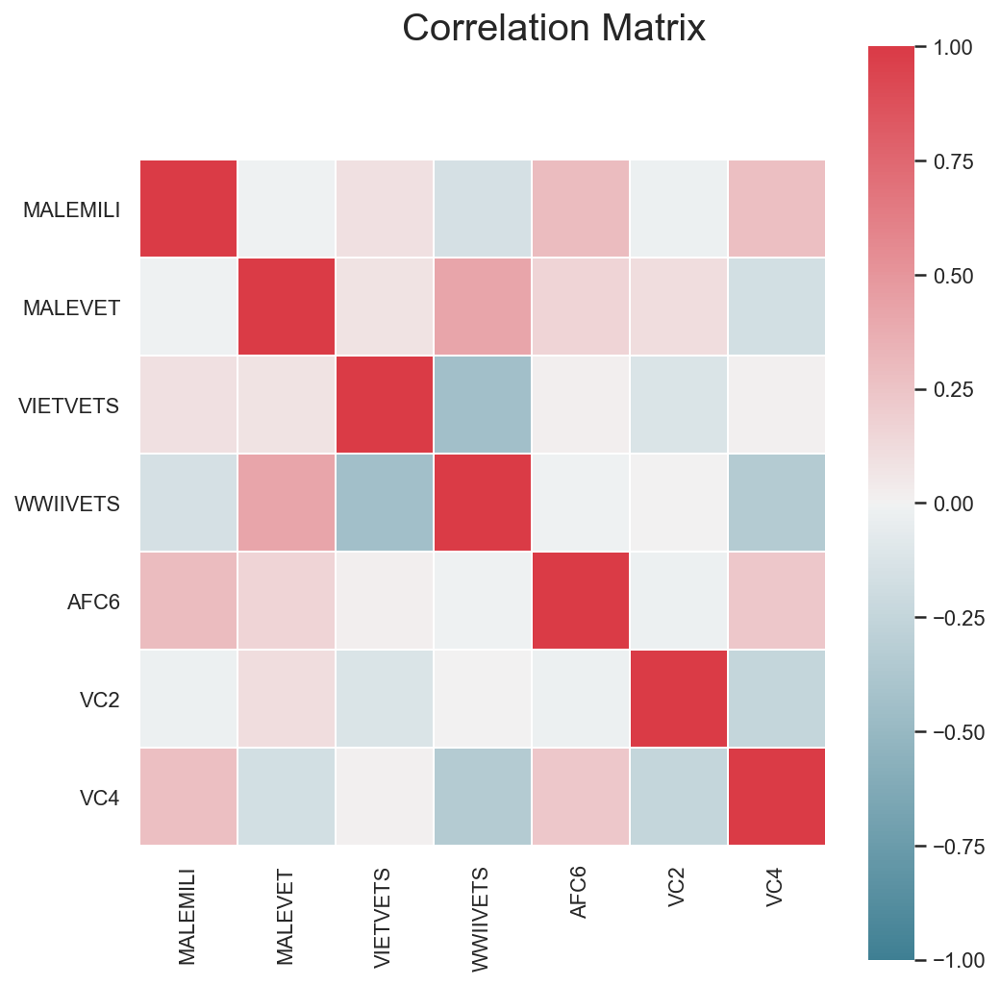

In [244]:
fig = plt.figure(figsize=(8, 8))

corr = np.round(Military_view.corr(method="pearson") , decimals=2)

mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) 

sns.heatmap(data=corr, annot=False, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()

In [245]:
social_indic=data_new[['HV1','HHAS2','HHAS4','HC21', 'IC5']]

In [246]:
#Standardize
x = social_indic.values #returns a numpy array

min_max_scaler = prep.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
stand_social_indic= pd.DataFrame(x_scaled, columns=social_indic.columns, index=social_indic.index)

In [247]:
stand_social_indic.head()

,HV1,HHAS2,HHAS4,HC21,IC5
0,0.079833,0.046512,0.010101,1.000000,0.085028
1,0.911333,0.023256,0.030303,1.000000,0.266538
2,0.082833,0.093023,0.111111,0.929293,0.074842
3,0.166667,0.162791,0.202020,0.898990,0.102538
4,0.096000,0.093023,0.141414,0.969697,0.061283


In [248]:
from sklearn.decomposition import PCA
#data_pca = data_new.copy()# Use PCA to reduce dimensionality of data

pca = PCA()
pca_feat = pca.fit_transform(stand_social_indic)


In [249]:
# In PCA we decompose the covariance matrix of the data 
# (what does this matrix corresponds when we input standardized variables?)
cov_matrix = stand_social_indic.cov()

In [250]:
# Composing back the covariance matrix
pd.DataFrame(pca.components_.T @ np.diag(pca.explained_variance_) @ pca.components_, 
             index=cov_matrix.index, 
             columns=cov_matrix.columns)

,HV1,HHAS2,HHAS4,HC21,IC5
HV1,0.024532,-0.002534,-0.005075,0.003005,0.007444
HHAS2,-0.002534,0.005150,0.005069,-0.002120,-0.001968
HHAS4,-0.005075,0.005069,0.009979,-0.003876,-0.003194
HC21,0.003005,-0.002120,-0.003876,0.003342,0.001553
IC5,0.007444,-0.001968,-0.003194,0.001553,0.004293


In [251]:
# Obtaining the projected observations on the principal components axes (linear combinations)
pd.DataFrame(stand_social_indic.values @ pca.components_.T, 
             index=stand_social_indic.index,
             columns=[f"PC{i}" for i in range(pca.n_components_)])

,PC0,PC1,PC2,PC3,PC4
0,0.257111,-0.221669,-0.473149,0.496664,-0.655804
1,1.017300,0.154896,-0.427125,0.536034,-0.611858
2,0.200909,-0.107224,-0.443309,0.481626,-0.645523
3,0.231132,0.035147,-0.446206,0.465815,-0.665617
4,0.204721,-0.091015,-0.455160,0.525168,-0.669902
...,...,...,...,...,...
93934,0.320056,-0.135184,-0.459079,0.484638,-0.682956
93935,0.433525,-0.079952,-0.429774,0.468308,-0.696409
93936,0.135034,-0.003029,-0.465004,0.544493,-0.755732
93937,0.537144,-0.071667,-0.452211,0.551209,-0.611675


In [252]:
# Output PCA table
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

,Eigenvalue,Difference,Proportion,Cumulative
1,0.030450,0.000000,0.643813,0.643813
2,0.011749,-0.018702,0.248404,0.892218
3,0.002110,-0.009638,0.044618,0.936836
4,0.001523,-0.000588,0.032193,0.969029
5,0.001465,-0.000058,0.030971,1.000000


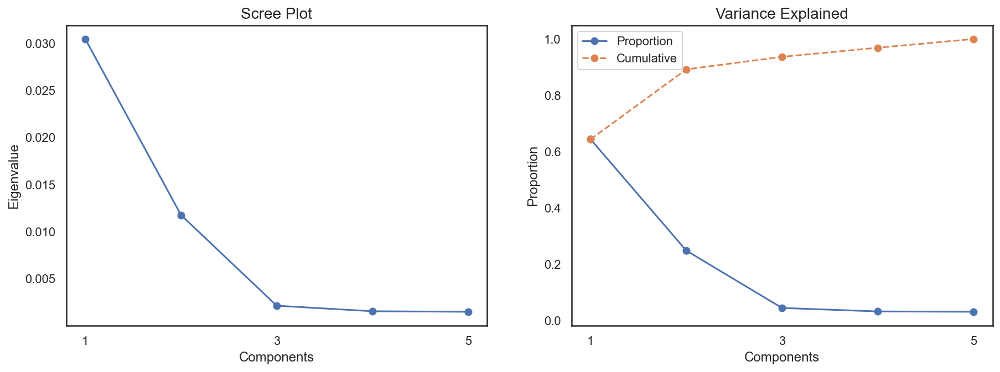

In [253]:
# figure and axes
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

# draw plots
ax1.plot(pca.explained_variance_, marker=".", markersize=12)
ax2.plot(pca.explained_variance_ratio_, marker=".", markersize=12, label="Proportion")
ax2.plot(np.cumsum(pca.explained_variance_ratio_), marker=".", markersize=12, linestyle="--", label="Cumulative")

# customizations
ax2.legend()
ax1.set_title("Scree Plot", fontsize=14)
ax2.set_title("Variance Explained", fontsize=14)
ax1.set_ylabel("Eigenvalue")
ax2.set_ylabel("Proportion")
ax1.set_xlabel("Components")
ax2.set_xlabel("Components")
ax1.set_xticks(range(0, pca.n_components_, 2))
ax1.set_xticklabels(range(1, pca.n_components_ + 1, 2))
ax2.set_xticks(range(0, pca.n_components_, 2))
ax2.set_xticklabels(range(1, pca.n_components_ + 1, 2))

plt.show()

In [254]:
# # Perform PCA again with the number of principal components you want to retain
pca = PCA(n_components=2)
pca_feat = pca.fit_transform(stand_social_indic)
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(pca_feat, index=stand_social_indic.index, columns=pca_feat_names)  # remember index=df_pca.index
pca_df

,PC0,PC1
0,-0.045919,-0.136388
1,0.714269,0.240178
2,-0.102121,-0.021943
3,-0.071898,0.120429
4,-0.098309,-0.005734
...,...,...
93934,0.017025,-0.049903
93935,0.130494,0.005330
93936,-0.167997,0.082252
93937,0.234113,0.013614


In [255]:
#Reassigning df to contain pca variables
stand_social_indic_pca = pd.concat([stand_social_indic, pca_df], axis=1)
stand_social_indic_pca.head()

,HV1,HHAS2,HHAS4,HC21,IC5,PC0,PC1
0,0.079833,0.046512,0.010101,1.000000,0.085028,-0.045919,-0.136388
1,0.911333,0.023256,0.030303,1.000000,0.266538,0.714269,0.240178
2,0.082833,0.093023,0.111111,0.929293,0.074842,-0.102121,-0.021943
3,0.166667,0.162791,0.202020,0.898990,0.102538,-0.071898,0.120429
4,0.096000,0.093023,0.141414,0.969697,0.061283,-0.098309,-0.005734


In [256]:
def _color_red_or_green(val):
    if val < -0.45:
         color = 'background-color: red'
    elif val > 0.45:
         color = 'background-color: green'
    else:
         color = ''
    return color

# # Interpreting each Principal Component
#loadings = stand_Neigh_view_pca.corr()


loadings = stand_social_indic_pca.corr().loc[stand_social_indic.columns, pca_feat_names]
loadings.style.applymap(_color_red_or_green)

,PC0,PC1
HV1,0.946830,0.314970
HHAS2,-0.466371,0.703037
HHAS4,-0.592995,0.763041
HC21,0.529451,-0.533000
IC5,0.820669,-0.047966


HV1: Median Home Value in hundreds<br>
HHAS2: Percent Households on Public Assistance<br>
HHAS4: Percent Persons Below Poverty Level<br>
HC21: Percent Housing Units w/ Telephones<br>
IC5: Per Capita Income 

- PC0: Richer neighbourhoods and more developed

- PC1: Poorer neighbourhoods and slightly less developed

In [257]:
SOCIAL_indic=data_new[['POP901','ETH1','AGE904','IC5','EC4','EC7','POBC1']]

In [258]:
from sklearn import preprocessing
#Standardize
x = SOCIAL_indic.values #returns a numpy array

min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
STAND_SOCIAL_indic= pd.DataFrame(x_scaled, columns=SOCIAL_indic.columns, index=SOCIAL_indic.index)

In [259]:
from sklearn.decomposition import PCA
#data_pca = data_new.copy()# Use PCA to reduce dimensionality of data

pca = PCA()
pca_feat = pca.fit_transform(STAND_SOCIAL_indic)


In [260]:
# In PCA we decompose the covariance matrix of the data 
# (what does this matrix corresponds when we input standardized variables?)
cov_matrix = STAND_SOCIAL_indic.cov()

# Composing back the covariance matrix
pd.DataFrame(pca.components_.T @ np.diag(pca.explained_variance_) @ pca.components_, 
             index=cov_matrix.index, 
             columns=cov_matrix.columns)

,POP901,ETH1,AGE904,IC5,EC4,EC7,POBC1
POP901,0.003409,-0.000783,-0.000565,-0.000168,-0.000125,-0.000121,0.000520
ETH1,-0.000783,0.039093,0.005110,0.002804,0.003163,0.004537,-0.006358
AGE904,-0.000565,0.005110,0.011223,0.001767,0.000295,0.000239,-0.000424
IC5,-0.000168,0.002804,0.001767,0.004293,-0.003350,0.006484,0.000776
EC4,-0.000125,0.003163,0.000295,-0.003350,0.009993,-0.009989,-0.003260
EC7,-0.000121,0.004537,0.000239,0.006484,-0.009989,0.020777,0.001520
POBC1,0.000520,-0.006358,-0.000424,0.000776,-0.003260,0.001520,0.009540


In [261]:
# Obtaining the projected observations on the principal components axes (linear combinations)
pd.DataFrame(STAND_SOCIAL_indic.values @ pca.components_.T, 
             index=STAND_SOCIAL_indic.index,
             columns=[f"PC{i}" for i in range(pca.n_components_)])

,PC0,PC1,PC2,PC3,PC4,PC5,PC6
0,-0.968964,-0.254610,0.253883,0.149474,0.039174,0.283274,-0.021390
1,-0.724295,0.350308,0.231826,0.395009,0.030895,0.356337,0.031604
2,-0.996822,-0.195138,0.197896,0.172098,0.093919,0.185507,-0.025605
3,-0.600190,-0.037268,0.268107,0.344985,0.002365,0.152075,0.006583
4,-0.121603,-0.003748,0.270885,-0.111595,0.061525,0.344948,-0.049286
...,...,...,...,...,...,...,...
93934,-0.830598,-0.032414,0.077852,0.155603,0.294145,0.278404,0.009616
93935,-1.024023,0.288570,0.029081,0.087930,0.036402,0.273709,-0.036506
93936,-0.866480,-0.214507,0.099535,0.153782,0.028594,0.448892,-0.034017
93937,-0.965972,0.001383,0.205831,0.240446,0.033204,0.217439,-0.045184


In [262]:
# Output PCA table
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

,Eigenvalue,Difference,Proportion,Cumulative
1,0.042586,0.000000,0.433101,0.433101
2,0.029106,-0.013480,0.296013,0.729114
3,0.010759,-0.018348,0.109414,0.838528
4,0.007684,-0.003074,0.078149,0.916677
5,0.003327,-0.004357,0.033838,0.950515
6,0.003114,-0.000213,0.031670,0.982185
7,0.001752,-0.001362,0.017815,1.000000


In [263]:
# # Perform PCA again with the number of principal components you want to retain
pca = PCA(n_components=3)
pca_feat = pca.fit_transform(STAND_SOCIAL_indic)
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(pca_feat, index=STAND_SOCIAL_indic.index, columns=pca_feat_names)  # remember index=df_pca.index

#Reassigning df to contain pca variables
STAND_SOCIAL_indic_pca = pd.concat([STAND_SOCIAL_indic, pca_df], axis=1)

In [264]:
def _color_red_or_green(val):
    if val < -0.45:
         color = 'background-color: red'
    elif val > 0.45:
         color = 'background-color: green'
    else:
         color = ''
    return color

# # Interpreting each Principal Component
#loadings = stand_Neigh_view_pca.corr()


loadings = STAND_SOCIAL_indic_pca.corr().loc[STAND_SOCIAL_indic.columns, pca_feat_names]
loadings.style.applymap(_color_red_or_green)

,PC0,PC1,PC2
POP901,0.087443,0.016039,-0.080204
ETH1,-0.984452,-0.114151,-0.057560
AGE904,-0.319901,-0.023627,0.927859
IC5,-0.325661,0.686327,0.208504
EC4,-0.081015,-0.872317,-0.031254
EC7,-0.284399,0.925625,-0.089259
POBC1,0.372437,0.349032,0.247276


POP901: Number of Persons<br>
ETH1: Percent White <br>
IC5: Per Capita Income <br>
EC4: Percent Adults 25+ Completed High School or Equivalency<br>
EC7: Percent Adults 25+ w/ Bachelors Degree<br>
POBC1: Percent Foreign Born<br>


- PC0: Neighbourhoods with many white people (not used)

- PC1: Neighbourhoods with more educated population and higher salaries

- PC2: Neighbourhoods  with older people (not used)

In [265]:
FAMILY_indic=data_new[['MARR2','MARR3','HHD2','HHD7','HHD12','LFC7','LFC8','LFC10']]

In [266]:
from sklearn import preprocessing
#Standardize
x = FAMILY_indic.values #returns a numpy array

min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
STAND_FAMILY_indic= pd.DataFrame(x_scaled, columns=FAMILY_indic.columns, index=FAMILY_indic.index)

In [267]:
from sklearn.decomposition import PCA
#data_pca = data_new.copy()# Use PCA to reduce dimensionality of data

pca = PCA()
pca_feat = pca.fit_transform(STAND_FAMILY_indic)

In [268]:
# In PCA we decompose the covariance matrix of the data 
# (what does this matrix corresponds when we input standardized variables?)
cov_matrix = STAND_FAMILY_indic.cov()

# Composing back the covariance matrix
pd.DataFrame(pca.components_.T @ np.diag(pca.explained_variance_) @ pca.components_, 
             index=cov_matrix.index, 
             columns=cov_matrix.columns)

,MARR2,MARR3,HHD2,HHD7,HHD12,LFC7,LFC8,LFC10
MARR2,0.007253,0.000913,-0.006995,0.003500,0.001940,-0.005257,0.000032,0.002611
MARR3,0.000913,0.004369,-0.004422,-0.000059,-0.000435,-0.002138,-0.002239,0.001005
HHD2,-0.006995,-0.004422,0.018819,0.000258,-0.004617,0.005864,0.001464,-0.001858
HHD7,0.003500,-0.000059,0.000258,0.006085,0.000090,-0.004812,-0.000880,0.003731
HHD12,0.001940,-0.000435,-0.004617,0.000090,0.002992,-0.001131,0.000662,0.000238
LFC7,-0.005257,-0.002138,0.005864,-0.004812,-0.001131,0.028346,0.005900,-0.007268
LFC8,0.000032,-0.002239,0.001464,-0.000880,0.000662,0.005900,0.092512,-0.011187
LFC10,0.002611,0.001005,-0.001858,0.003731,0.000238,-0.007268,-0.011187,0.008711


In [269]:
# Obtaining the projected observations on the principal components axes (linear combinations)
pd.DataFrame(STAND_FAMILY_indic.values @ pca.components_.T, 
             index=STAND_FAMILY_indic.index,
             columns=[f"PC{i}" for i in range(pca.n_components_)])

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7
0,-1.059497,-0.542971,-0.362388,0.429566,0.139594,-0.153296,-0.114293,0.453728
1,-1.073791,-0.674744,-0.482294,0.431530,0.078387,-0.084638,-0.135850,0.431597
2,-0.894005,-0.600804,-0.286867,0.506063,0.117510,-0.131185,-0.133693,0.424998
3,-0.019694,-0.428342,-0.407593,0.438778,0.086034,-0.038120,-0.161455,0.408826
4,-0.837007,-0.297050,-0.501971,0.608737,0.056540,-0.242296,-0.140839,0.431549
...,...,...,...,...,...,...,...,...
93934,-0.673872,-0.522005,-0.264254,0.600949,-0.011112,-0.123838,-0.138551,0.429906
93935,-1.057721,-0.552333,-0.511437,0.353832,0.063037,-0.071404,-0.154845,0.401438
93936,-0.616289,-0.149122,-0.377522,0.619077,0.035198,-0.067759,-0.163746,0.433004
93937,-1.062878,-0.558066,-0.394755,0.483679,0.070855,-0.141015,-0.116233,0.478888


In [270]:
# Output PCA table
pd.DataFrame(
    {"Eigenvalue": pca.explained_variance_,
     "Difference": np.insert(np.diff(pca.explained_variance_), 0, 0),
     "Proportion": pca.explained_variance_ratio_,
     "Cumulative": np.cumsum(pca.explained_variance_ratio_)},
    index=range(1, pca.n_components_ + 1)
)

,Eigenvalue,Difference,Proportion,Cumulative
1,0.094891,0.000000,0.561190,0.561190
2,0.036406,-0.058484,0.215310,0.776500
3,0.018972,-0.017434,0.112204,0.888704
4,0.008508,-0.010464,0.050316,0.939020
5,0.004689,-0.003819,0.027733,0.966753
6,0.003417,-0.001272,0.020207,0.986960
7,0.001500,-0.001917,0.008871,0.995831
8,0.000705,-0.000795,0.004169,1.000000


In [271]:
# # Perform PCA again with the number of principal components you want to retain
pca = PCA(n_components=3)
pca_feat = pca.fit_transform(STAND_FAMILY_indic)
pca_feat_names = [f"PC{i}" for i in range(pca.n_components_)]
pca_df = pd.DataFrame(pca_feat, index=STAND_FAMILY_indic.index, columns=pca_feat_names)  # remember index=df_pca.index

#Reassigning df to contain pca variables
STAND_FAMILY_indic_pca = pd.concat([STAND_FAMILY_indic, pca_df], axis=1)

In [272]:
STAND_FAMILY_indic_pca

,MARR2,MARR3,HHD2,HHD7,HHD12,LFC7,LFC8,LFC10,PC0,PC1,PC2
0,0.137255,0.164384,0.808081,0.089552,0.040541,0.535354,1.000000,0.000000,-0.295934,-0.060777,-0.050481
1,0.078431,0.041096,0.949495,0.059701,0.027027,0.575758,1.000000,0.000000,-0.310229,-0.192550,-0.170387
2,0.176471,0.123288,0.767677,0.104478,0.040541,0.626263,0.828283,0.040404,-0.130443,-0.118609,0.025040
3,0.176471,0.082192,0.737374,0.089552,0.054054,0.313131,0.000000,0.232323,0.743869,0.053853,-0.095686
4,0.333333,0.123288,0.828283,0.298507,0.013514,0.313131,0.818182,0.101010,-0.073444,0.185144,-0.190063
...,...,...,...,...,...,...,...,...,...,...,...
93934,0.294118,0.041096,0.727273,0.179104,0.108108,0.575758,0.616162,0.070707,0.089691,-0.039810,0.047653
93935,0.078431,0.027397,0.898990,0.029851,0.013514,0.434343,1.000000,0.000000,-0.294158,-0.070139,-0.199530
93936,0.372549,0.068493,0.646465,0.238806,0.121622,0.242424,0.626263,0.252525,0.147274,0.333073,-0.065615
93937,0.176471,0.109589,0.858586,0.119403,0.081081,0.545455,1.000000,0.000000,-0.299315,-0.075871,-0.082848


In [273]:
def _color_red_or_green(val):
    if val < -0.45:
         color = 'background-color: red'
    elif val > 0.45:
         color = 'background-color: green'
    else:
         color = ''
    return color

# # Interpreting each Principal Component
#loadings = stand_Neigh_view_pca.corr()


loadings = STAND_FAMILY_indic_pca.corr().loc[STAND_FAMILY_indic.columns, pca_feat_names]
loadings.style.applymap(_color_red_or_green)

,PC0,PC1,PC2
MARR2,0.051019,0.664790,0.331510
MARR3,0.140788,0.334360,0.349001
HHD2,-0.075158,-0.613067,-0.776457
HHD7,0.086566,0.431391,-0.316578
HHD12,-0.019828,0.375145,0.514808
LFC7,-0.199253,-0.869162,0.396257
LFC8,-0.995425,0.090252,-0.020234
LFC10,0.459458,0.469321,-0.215756


MARR2: Percent Separated or Divorced<br>
MARR3: Percent Widowed<br>
HHD2: Percent Households w/ Families<br>
HHD7: Percent Single Parent Households<br>
HHD12: Percent Households w/ Non-Family Living Arrangements<br>
LFC7: Percent 2 Parent Earner Families<br>
LFC8: Percent Single Mother w/ Child in Labor Force<br>
LFC10: Percent Families w/ Child w/ no Workers

- PC0: Very few Single Mother w/ Child in Labor Force & some Families w/ Child w/ no Workers (not used)
    
- PC1: Few 2 Parent Earner Families & Households w/ Families but many Separated or Divorced & some Families w/ Child w/ no Workers (not used)
    
- PC2: Neighbourhoods with few families and non-family living arrangements

In [275]:
Neigh_view["Rich_Development"]=stand_social_indic_pca["PC0"]
Neigh_view["Poor_Undevelopment"]=stand_social_indic_pca["PC1"]
Neigh_view["High_Educ_and_Salary"]=STAND_SOCIAL_indic_pca["PC1"]
Neigh_view["Non_Family"]=STAND_FAMILY_indic_pca["PC2"]

# Segmentation<a class="anchor"><a id='Segmentation'></a></b><br>
[<font color='#E8800A'>1. K-means</font>](#km) <br>
[<font color='#E8800A'>2. K-means + Hierarchical Clustering</font>](#kmhc)<br>
[<font color='#E8800A'>3. SOM</font>](#som)<br> 
[<font color='#E8800A'>4. SOM + Hierarchical Clustering</font>](#somhc)<br>
[<font color='#E8800A'>5. DBscan</font>](#dbscan)<br>
[<font color='#E8800A'>6. K-prototypes</font>](#kproto) <br>
[<font color='#E8800A'>Joining each view's solution</font>](#final) <br>
[<font color='#E8800A'>Reincluding outliers</font>](#out_inc) <br>


  [Back to introduction](#PVA)

## 1. K-means</font> <a class="anchor" id="km"></a>
[<font color='#E8800A'>1.1. Military View</font>](#milkm) <br>
[<font color='#E8800A'>1.2. Personal View</font>](#perkm)<br>
[<font color='#E8800A'>1.3. Neighbourhood View</font>](#neighkm)<br>

  [Back to Segmentation](#Segmentation)

In [276]:
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.cluster import KMeans
import matplotlib.cm as cm
from sklearn.metrics import davies_bouldin_score 
from sklearn import metrics

### 1.1. Military View</font> <a class="anchor" id="milkm"></a>


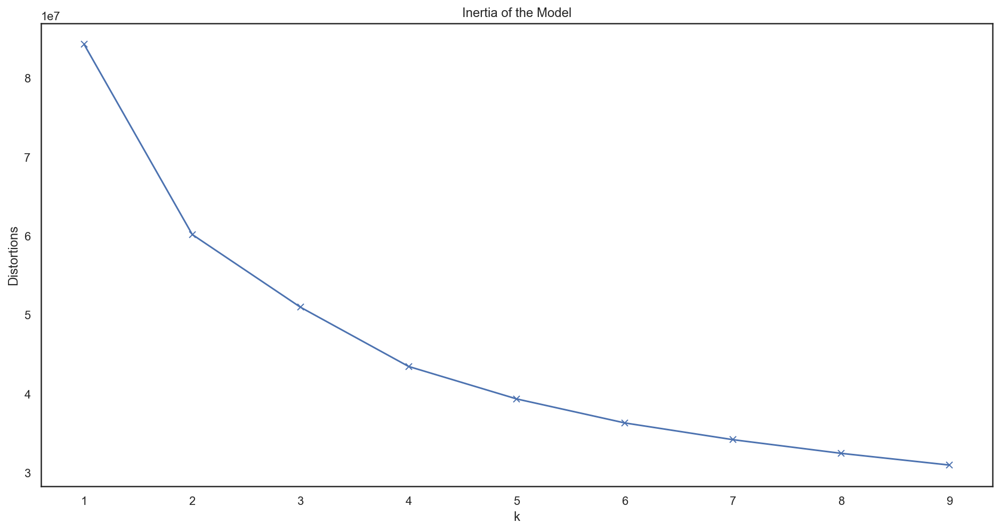

In [277]:
distortions = []
for k in range(1, 10):
    kmeanModel = KMeans(n_clusters=k).fit(Military_view)
    distortions.append(kmeanModel.inertia_)

plt.figure(figsize=(16,8))
plt.plot(range(1, 10), distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortions')
plt.title('Inertia of the Model')
plt.show()

The best solution according to this seems to be between 2 and 4 clusters

For n_clusters = 2, the average silhouette_score is : 0.25518269258306975
For n_clusters = 3, the average silhouette_score is : 0.27360606644223995
For n_clusters = 4, the average silhouette_score is : 0.22690223878262136
For n_clusters = 5, the average silhouette_score is : 0.23487410221798427
For n_clusters = 6, the average silhouette_score is : 0.18780159763072007


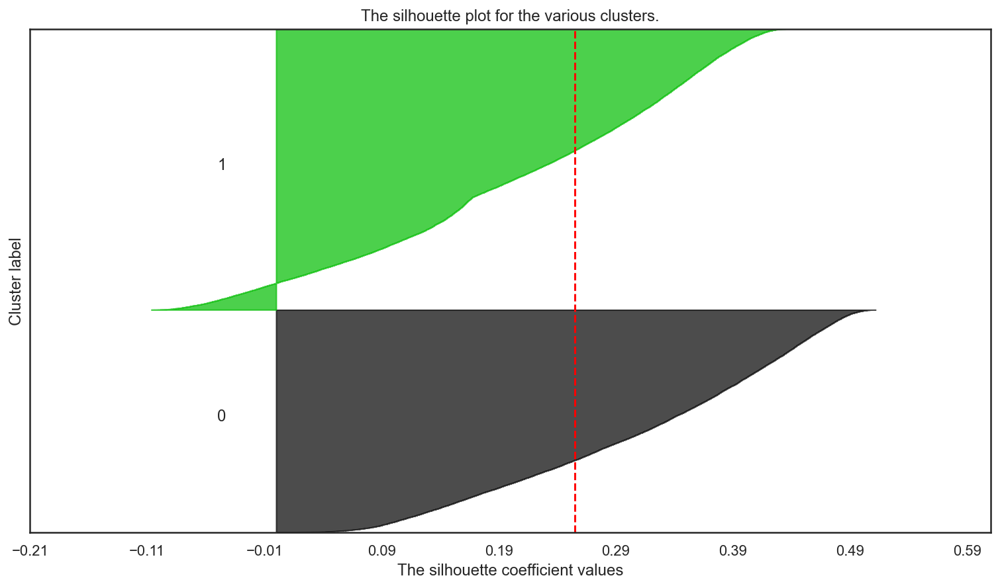

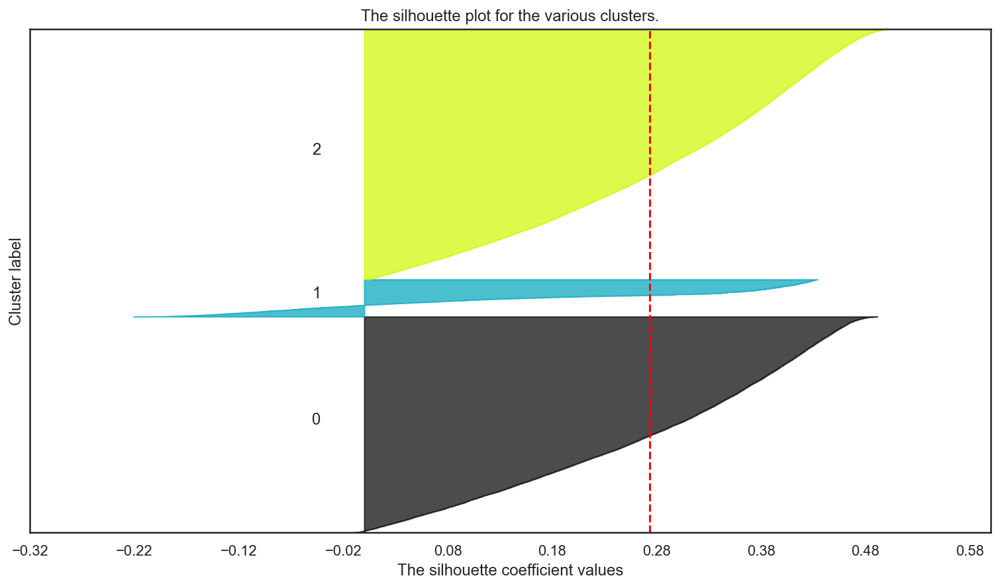

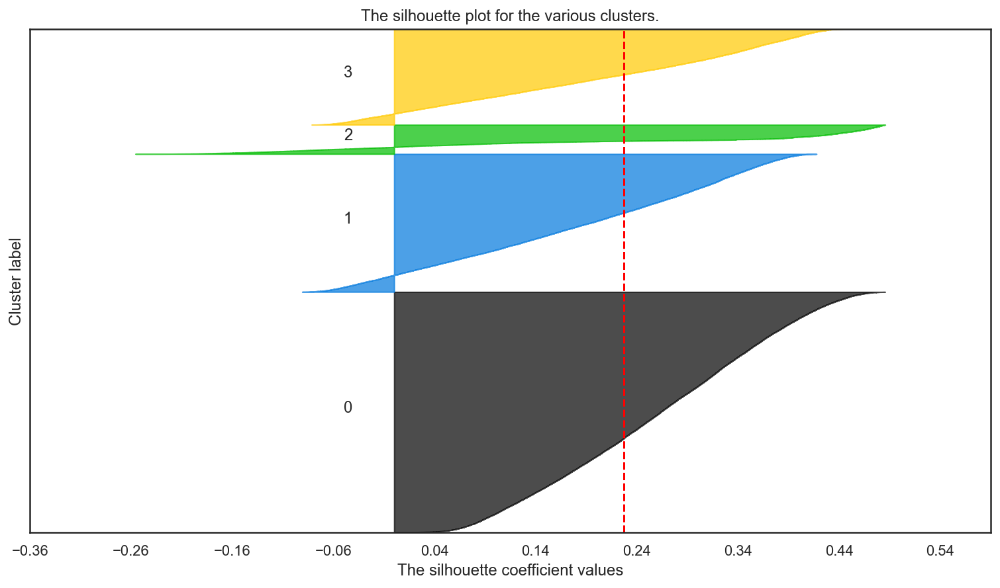

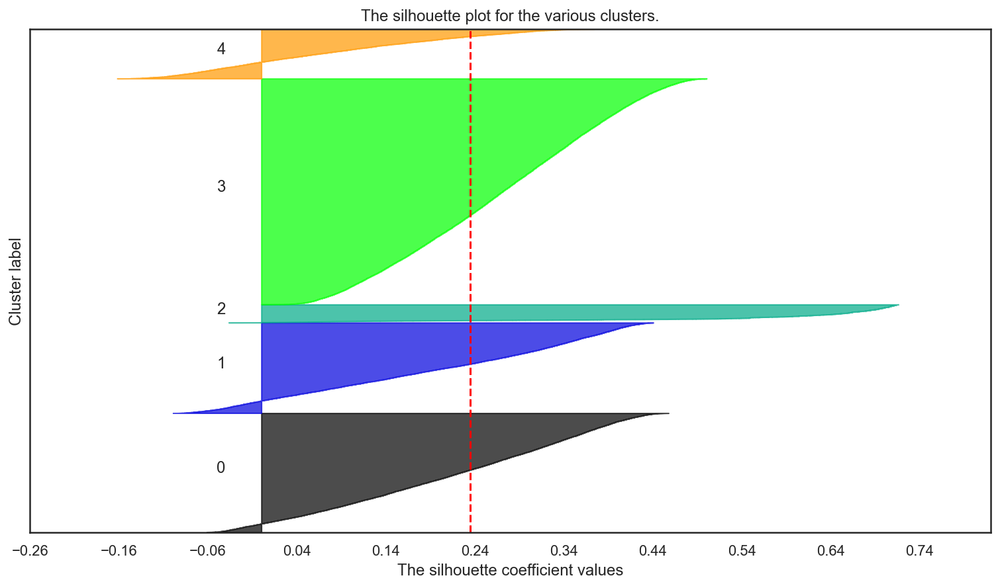

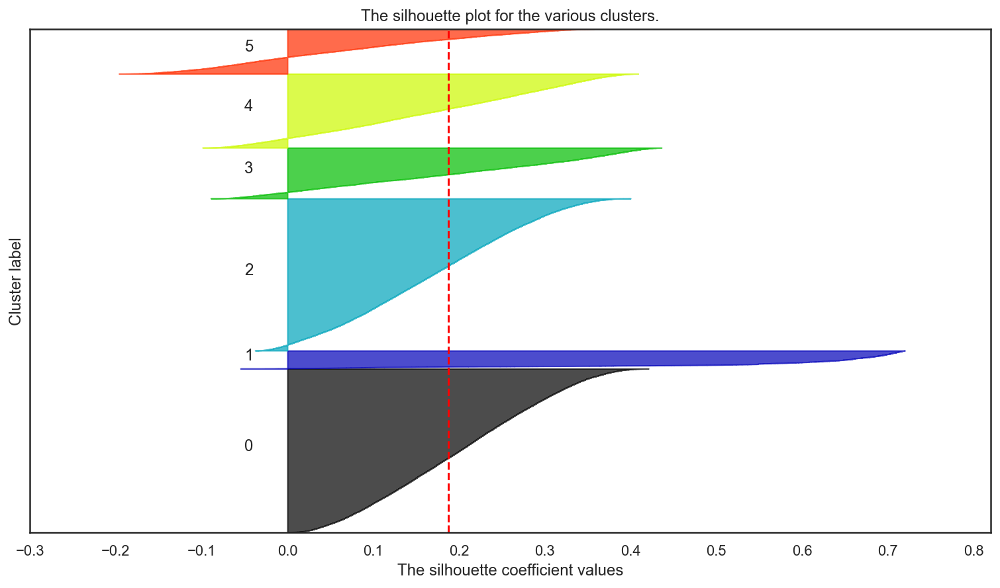

In [278]:
range_clusters = range(1, 7)
# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(Military_view)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(Military_view, cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(Military_view, cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title("The silhouette plot for the various clusters.")
    plt.xlabel("The silhouette coefficient values")
    plt.ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    
    # The (nclus+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    plt.ylim([0, len(Military_view) + (nclus + 1) * 10])

    plt.yticks([])  # Clear the yaxis labels / ticks
    plt.xticks(np.arange(xmin, xmax, 0.1))

Using the silhouette plot the best solution is or 2 or 3 clusters, although in both solutions there is misrepresentations in one cluster (to the left)

In [279]:
kmclust = KMeans(n_clusters=2, init='k-means++',n_init=15, random_state=1)
km_labels2 = kmclust.fit_predict(Military_view)

# Caracterização de clusters
cluster_concat = pd.concat((Military_view, pd.Series(km_labels2, name='labels')), axis=1)
cluster_concat.groupby('labels').mean()

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4
labels,,,,,,,
0,0.369485,34.468085,21.343389,47.681164,1.235729,18.938748,7.841763
1,1.588543,27.485602,36.569987,20.946832,1.336988,17.419391,14.254186


In [280]:
kmclust = KMeans(n_clusters=3, init='k-means++',n_init=15, random_state=1)
km_labels3 = kmclust.fit_predict(Military_view)

# Caracterização de clusters
cluster_concat = pd.concat((Military_view, pd.Series(km_labels3, name='labels')), axis=1)
cluster_concat.groupby('labels').mean()

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4
labels,,,,,,,
0,0.353425,34.397271,20.959982,47.966469,1.232849,18.914198,7.816241
1,3.148255,11.319729,10.728007,9.958177,1.602394,16.855350,25.133545
2,1.338058,30.132512,40.317683,23.055801,1.297372,17.565348,12.489321


This analysis allowed us to conclude that 3 clusters is probably the best solution considering that it creates a new class with new information, while the other 2 remain similiar.<br>

Cluster 0: Neighborhood with smallest percentage of males active in the military and veterans after 1995, and with highest percentage of male veterans, especially in World War II. Therefore, it is characterized as nighborhoods with small percentage of people currently active in the military, but with more people who were in the military long ago (in WWII). <br>

Cluster 1: Neighborhoods with more males active in the military and more veterans after 1995, but less male veterans, and veterans in general, especially the ones in World War II. Therefore, it is a cluster composed of younger people in the military, not so much veterans. <br>

Cluster 2: Has both males active in the military and male veterans, but it's mostly associated to veterans of the Vietnam war. These are neighborhoods with people in the military a while ago (until 1975 at most), but more recently than WWII.

In [281]:
# Number of observations in each cluster
pd.Series(km_labels3).value_counts()

2    46773
0    40232
1     6934
dtype: int64

In [282]:
print("BD index for this solution: ",davies_bouldin_score(Military_view, km_labels3))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Military_view, km_labels3))
print("Silhouette score for this solution: ",metrics.silhouette_score(Military_view, km_labels3, metric='euclidean'))

BD index for this solution:  1.2759146163636608
Calinski-Harabasz score for this solution:  30691.65149423212
Silhouette score for this solution:  0.27360606644223995


### 1.2. Personal View</font> <a class="anchor" id="perkm"></a>

In [283]:
# Normalizing the data with min max
min_max_scaler = prep.MinMaxScaler()
Personal_view_norm = pd.DataFrame(min_max_scaler.fit_transform(Personal_view), index=Personal_view.index, columns=Personal_view.columns)

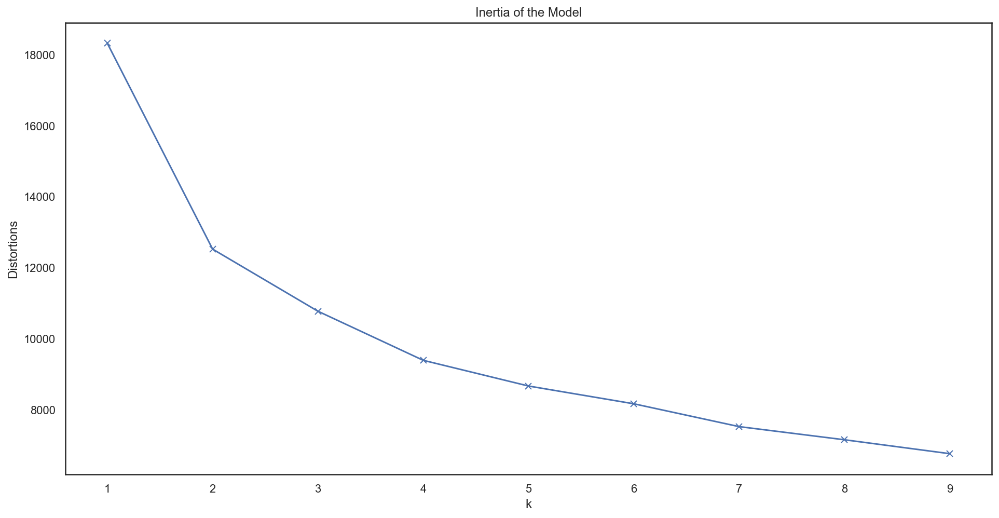

In [284]:
distortions = []
for k in range(1, 10):
    kmeanModel = KMeans(n_clusters=k).fit(Personal_view_norm)
    distortions.append(kmeanModel.inertia_)

plt.figure(figsize=(16,8))
plt.plot(range(1, 10), distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortions')
plt.title('Inertia of the Model')
plt.show()

For n_clusters = 2, the average silhouette_score is : 0.2767830081203114
For n_clusters = 3, the average silhouette_score is : 0.2117210093461059
For n_clusters = 4, the average silhouette_score is : 0.20561305202123611
For n_clusters = 5, the average silhouette_score is : 0.2136097298836572
For n_clusters = 6, the average silhouette_score is : 0.19369194628786743


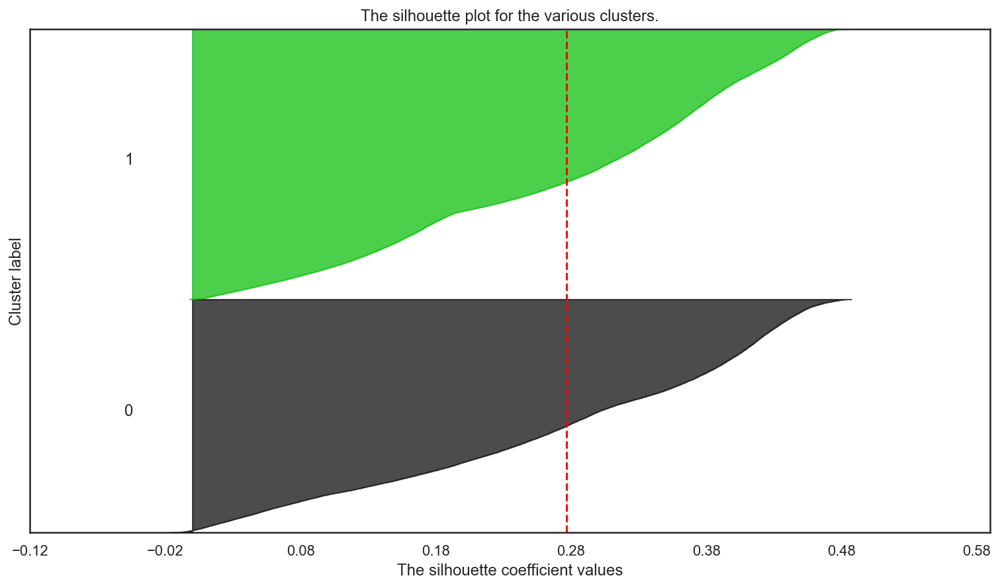

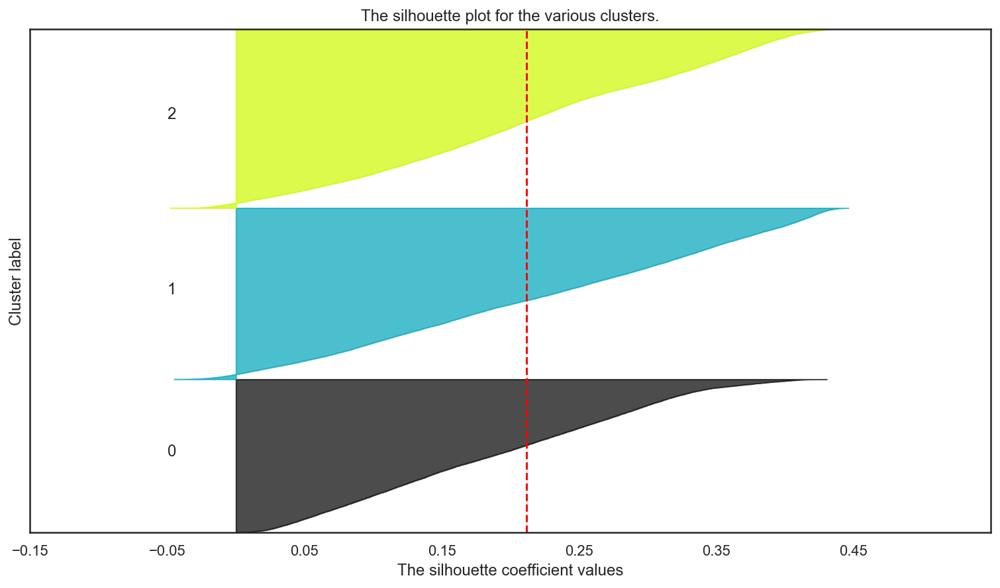

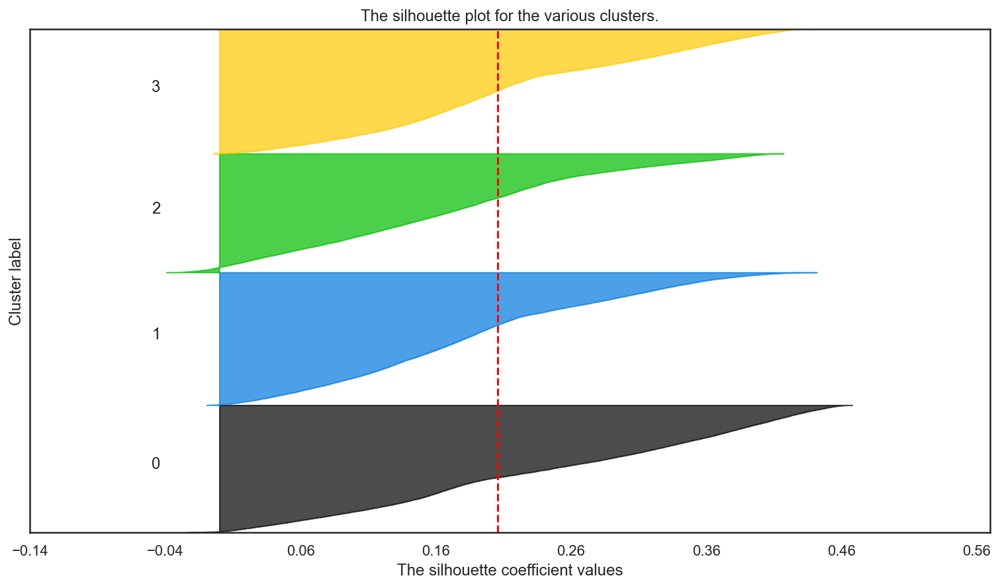

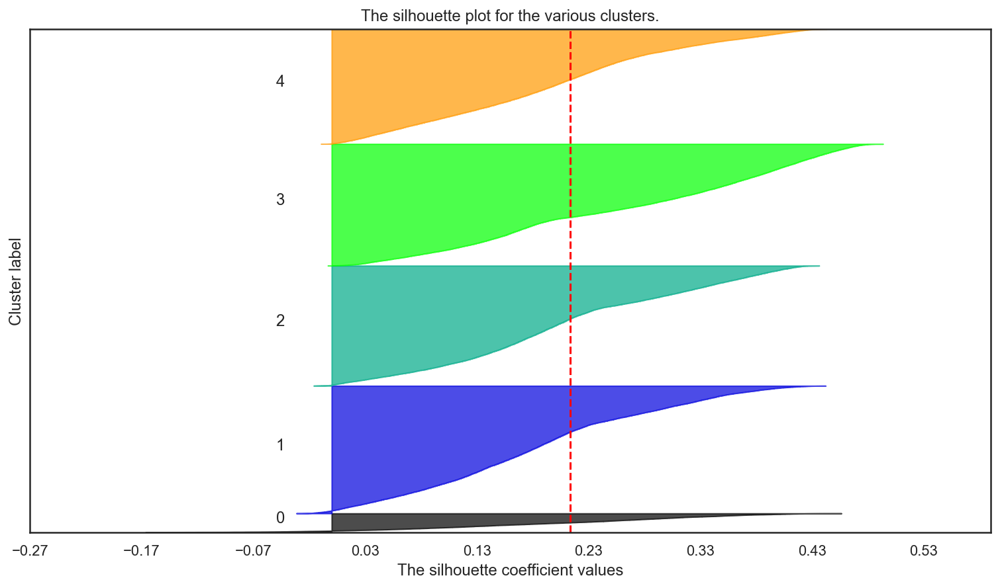

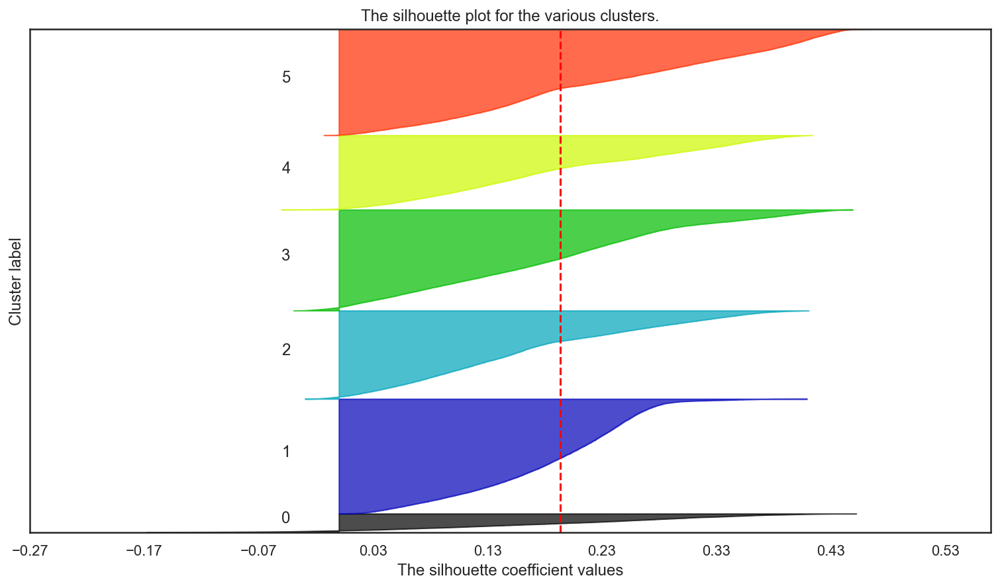

In [285]:
range_clusters = range(1, 7)
# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(Personal_view_norm)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(Personal_view_norm, cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(Personal_view_norm, cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title("The silhouette plot for the various clusters.")
    plt.xlabel("The silhouette coefficient values")
    plt.ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    
    # The (nclus+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    plt.ylim([0, len(Personal_view_norm) + (nclus + 1) * 10])

    plt.yticks([])  # Clear the yaxis labels / ticks
    plt.xticks(np.arange(xmin, xmax, 0.1))

Both solutions with 2 and 3 clusters seem good

In [286]:
kmclust = KMeans(n_clusters=2, init='k-means++',n_init=15, random_state=1)
km_labels2 = kmclust.fit_predict(Personal_view_norm)

# Caracterizing clusters formed --> using the dataset with the original scales to evaluate better
cluster_concat2 = pd.concat((Personal_view, pd.Series(km_labels2, name='labels')), axis=1)
cluster_concat2.groupby('labels').mean()

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity
labels,,,,,,,,
0,0.112788,2.338543,66.890249,12.211882,11.078650,0.196137,551.292862,1702.135654
1,0.274788,5.230585,59.064457,14.167356,8.284794,0.165073,565.474340,1360.295990


Cluster 0: Lower income, older, slightly smaller amounts donated per gift, have been donating for longer and donated more times<br>
Cluster 1: Opposite ---> Higher income, younger (58 y.o), donated less times, but more money on average per donation<br>

In [287]:
# Number of observations in each cluster
pd.Series(km_labels2).value_counts()

1    50468
0    43471
dtype: int64

In [288]:
print("BD index for this solution: ",davies_bouldin_score(Personal_view_norm, km_labels2))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Personal_view_norm, km_labels2))
print("Silhouette score for this solution: ",metrics.silhouette_score(Personal_view_norm, km_labels2, metric='euclidean'))

BD index for this solution:  1.3773177133464543
Calinski-Harabasz score for this solution:  43517.2617873688
Silhouette score for this solution:  0.2767830081203114


In [289]:
kmclust = KMeans(n_clusters=3, init='k-means++',n_init=15, random_state=1)
km_labels3 = kmclust.fit_predict(Personal_view_norm)

cluster_concat3 = pd.concat((Personal_view, pd.Series(km_labels3, name='labels')), axis=1)
cluster_concat3.groupby('labels').mean()

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity
labels,,,,,,,,
0,0.311116,3.470438,50.515104,14.330100,6.299832,0.149778,580.344512,983.733389
1,0.067251,2.320699,73.670097,11.390211,12.991273,0.213988,540.209353,2006.533250
2,0.231598,5.755117,62.570484,14.141479,9.111178,0.171743,558.502288,1508.218616


Cluster 0: average income, around 50 years old, are the ones that donates less times and with lower response rate, but have one of the highest average amounts donated. Also the ones that have been donating for a shorter time<br>

Cluster 1: lower income, the oldest ones (around 73 years old), with the lowest amounts amouts donated and the highest number of donations, with the highest response rate and that have been donating for longer --> frequent donors, but with less amounts given<br>

Cluster 2: highest income, around 60 years old, donate high amounts (but not the highest) and have made around 9 donations (not the most)<br>

In [290]:
# Number of observations in each cluster
pd.Series(km_labels3).value_counts()

2    33433
1    31970
0    28536
dtype: int64

In [291]:
print("BD index for this solution: ",davies_bouldin_score(Personal_view_norm, km_labels3))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Personal_view_norm, km_labels3))
print("Silhouette score for this solution: ",metrics.silhouette_score(Personal_view_norm, km_labels3, metric='euclidean'))

BD index for this solution:  1.5146678557334596
Calinski-Harabasz score for this solution:  32926.64253649183
Silhouette score for this solution:  0.2117210093461059


In [292]:
kmclust = KMeans(n_clusters=4, init='k-means++',n_init=15, random_state=1)
km_labels4 = kmclust.fit_predict(Personal_view_norm)

cluster_concat4 = pd.concat((Personal_view, pd.Series(km_labels4, name='labels')), axis=1)
cluster_concat4.groupby('labels').mean()

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity
labels,,,,,,,,
0,0.063578,1.909922,74.187740,11.223956,13.054218,0.214712,540.820144,2014.145537
1,0.268074,3.090693,51.505833,14.280322,6.277964,0.150444,579.023776,974.809631
2,0.083115,4.882304,73.722302,12.241929,12.979221,0.210648,533.881682,2079.820067
3,0.377370,5.823051,52.338034,15.230384,6.302524,0.144623,579.813551,1056.686815


Prefered solution is with 2 clusters.

### 1.3. Neigh View</font> <a class="anchor" id="neighkm"></a>

In [296]:
# Normalizing the data with min max
min_max_scaler = prep.MinMaxScaler()
Neigh_view_norm= pd.DataFrame(min_max_scaler.fit_transform(Neigh_view), index=Neigh_view.index, columns=Neigh_view.columns)

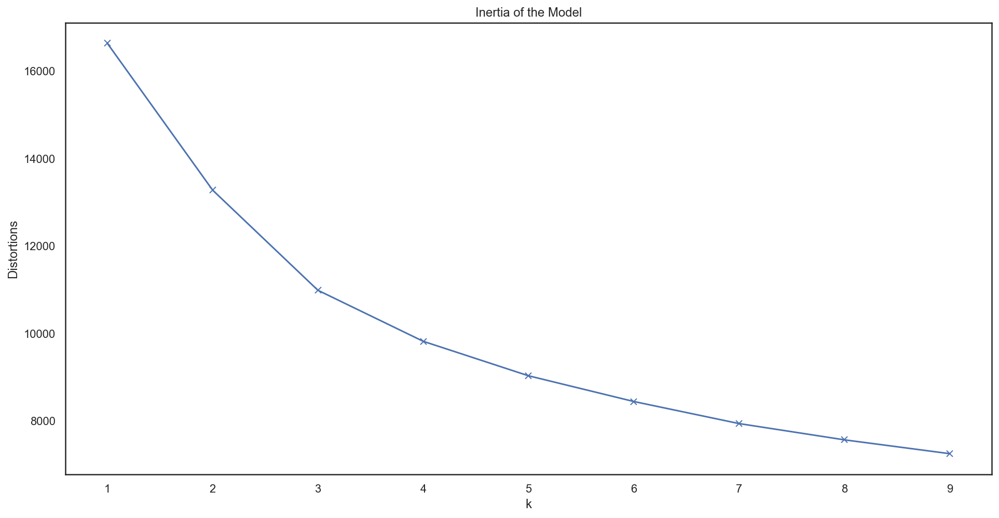

In [297]:
distortions = []
for k in range(1, 10):
    kmeanModel = KMeans(n_clusters=k).fit(Neigh_view_norm)
    distortions.append(kmeanModel.inertia_)

plt.figure(figsize=(16,8))
plt.plot(range(1, 10), distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortions')
plt.title('Inertia of the Model')
plt.show()

For n_clusters = 2, the average silhouette_score is : 0.34927631148374494
For n_clusters = 3, the average silhouette_score is : 0.19558453643113105
For n_clusters = 4, the average silhouette_score is : 0.17275256874510406
For n_clusters = 5, the average silhouette_score is : 0.16318388884142931
For n_clusters = 6, the average silhouette_score is : 0.14960518522525365


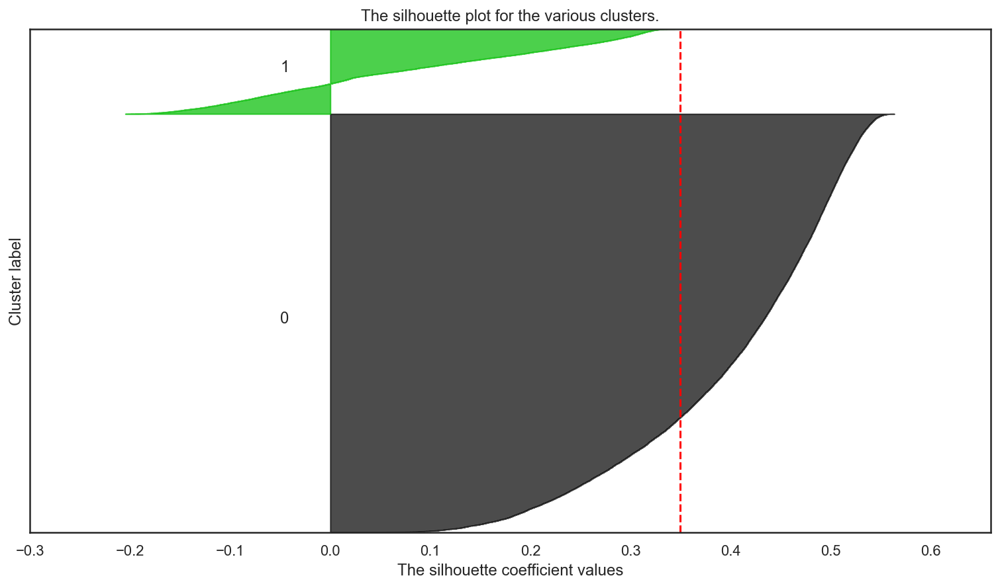

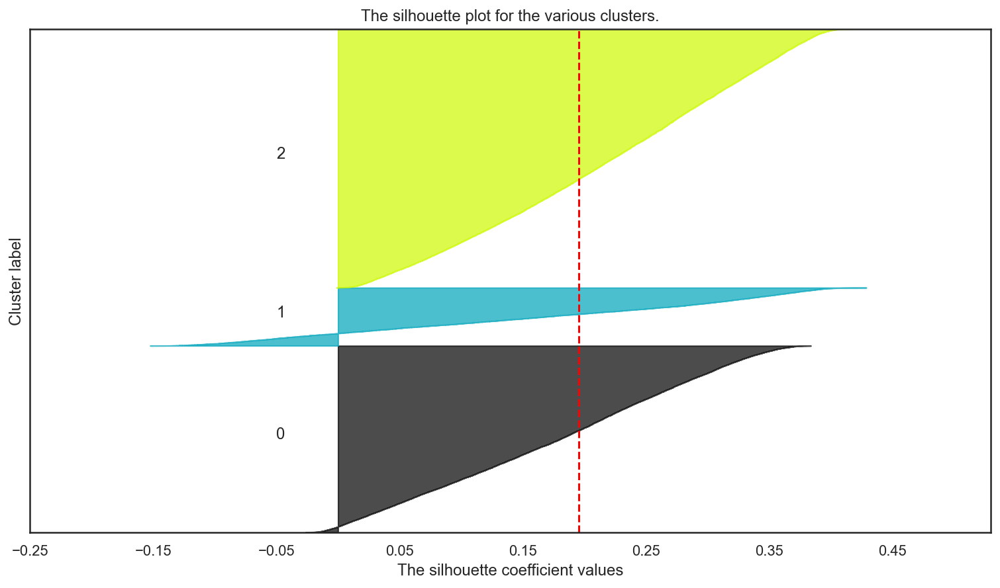

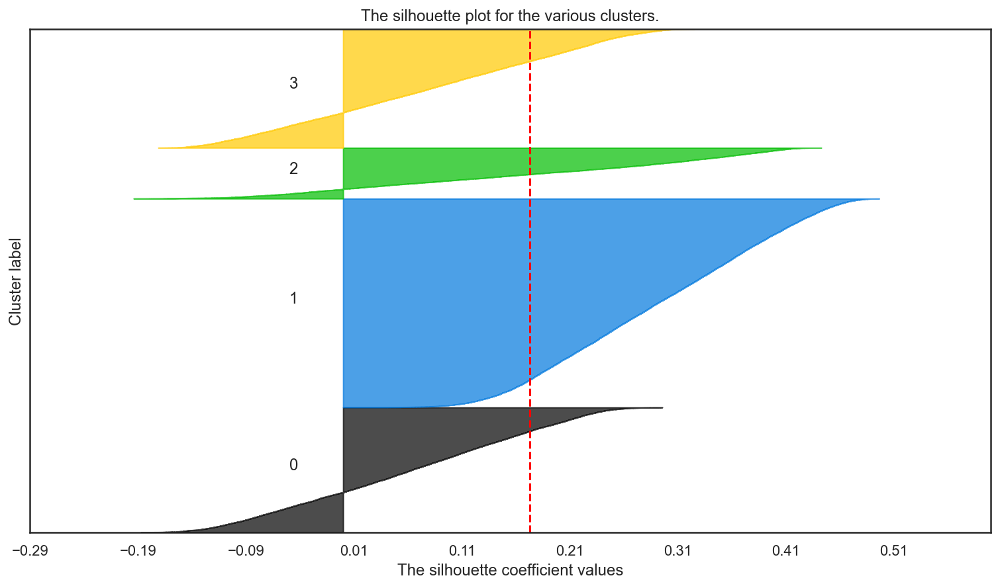

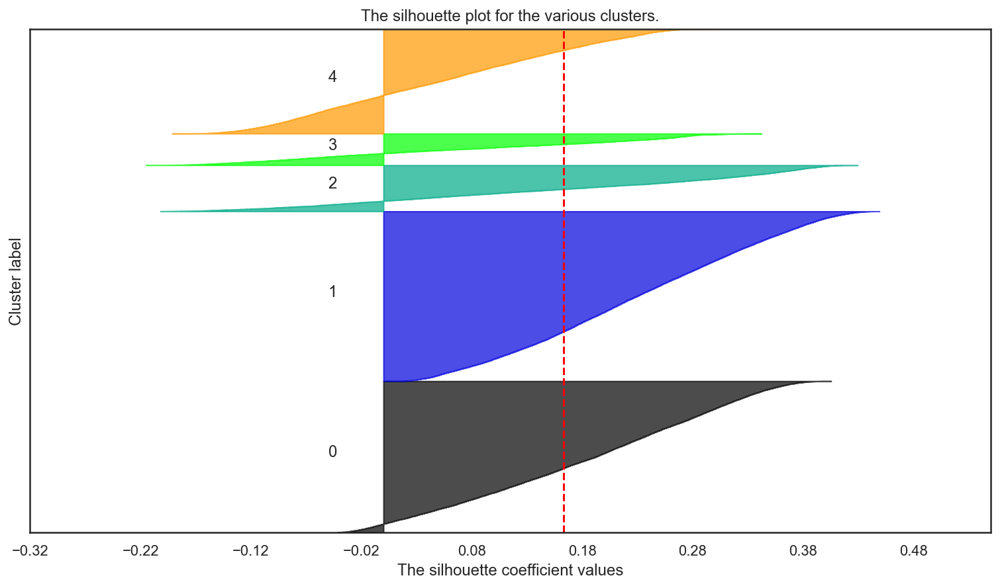

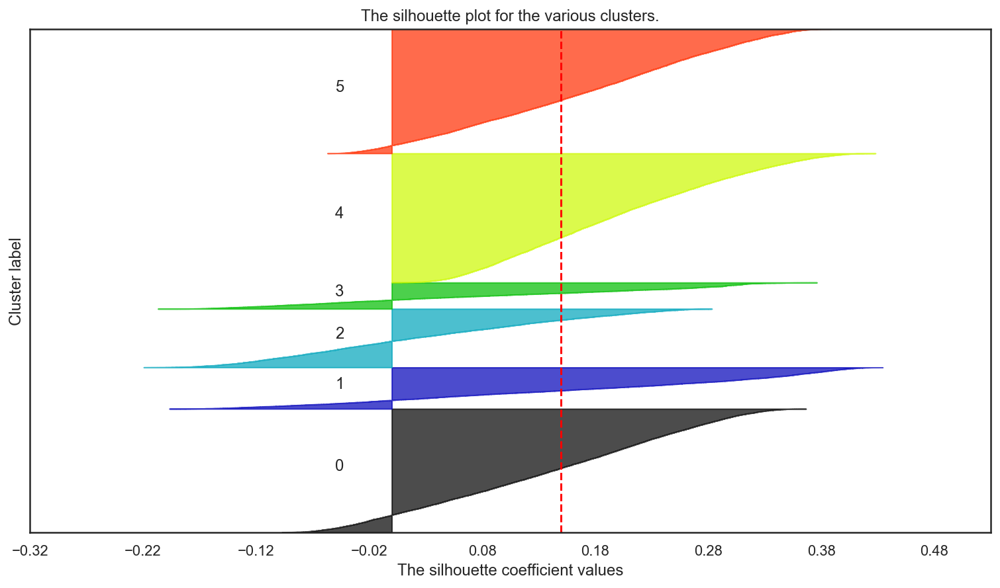

In [298]:
range_clusters = range(1, 7)
# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(Neigh_view_norm)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(Neigh_view_norm, cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(Neigh_view_norm, cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title("The silhouette plot for the various clusters.")
    plt.xlabel("The silhouette coefficient values")
    plt.ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    
    # The (nclus+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    plt.ylim([0, len(Neigh_view_norm) + (nclus + 1) * 10])

    plt.yticks([])  # Clear the yaxis labels / ticks
    plt.xticks(np.arange(xmin, xmax, 0.1))

According to the silhouette graph, we can see that none of the solution is very good. However, from all, the best one is with 3 clusters, where there are less misclassified observations (to the left) and only one cluster with a small average silhoutte coeficient

In [299]:
kmclust = KMeans(n_clusters=3, init='k-means++',n_init=15, random_state=1)
km_labels3 = kmclust.fit_predict(Neigh_view_norm)

# Caracterização de clusters
cluster_concat = pd.concat((Neigh_view, pd.Series(km_labels3, name='labels')), axis=1)
cluster_concat.groupby('labels').mean()

,AGE904,POP90C5,LFC4,LFC5,POP901,ETH1,POBC1,MARR3,LFC7,Rich_Development,Poor_Undevelopment,High_Educ_and_Salary,Non_Family
labels,,,,,,,,,,,,,
0,39.904210,52.189539,61.228539,43.623768,3119.461589,92.422762,4.146889,10.344762,43.848685,-0.068322,0.004875,-0.096903,0.001598
1,32.865651,51.444598,63.818006,49.465743,4120.032779,40.746168,15.828809,8.012004,34.464451,-0.087894,0.147130,0.024206,-0.085382
2,34.282258,50.794470,78.636089,61.470340,3223.997433,90.698949,6.463240,5.287080,56.510659,0.068907,-0.036492,0.064362,0.017989


Cluster 0: slightly older population, although the difference is minimal, slightly higher percentage of women, less men and women employed, slightly less people in the neighbourhood, less foreign born citizens ans more widows. More poor underdeveloped and with non family living arrangements(?)<br>

Cluster 1: More populated neighbourhood, with more than half of the population not white and a higher percentage of foreign born people and smaller percentage of families where both parents earn money. More poor and undeveloped neighbourhood(?)<br>

Cluster 2: More men and women employed, less percentage of widows, more families where both parents earn money. More rich and developed neighbourhood, with higher education and non family living arrangements (?)<br>

In [300]:
# Number of observations in each cluster
pd.Series(km_labels3).value_counts()

2    48314
0    34795
1    10830
dtype: int64

In [301]:
print("BD index for this solution: ",davies_bouldin_score(Neigh_view_norm, km_labels3))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Neigh_view_norm, km_labels3))

BD index for this solution:  1.5759870186648286
Calinski-Harabasz score for this solution:  24155.22602574529


Since the PCA provide bad values that are too difficult to interpret and give meaning to our clusters, we decided to drop them and add the variables that were the most meaningful for characterizing the components we used. POP90C5 was also dropped here since it proved to not be relevant at all, by not varying among the different clusters (always around 50% of the population are females). Similarly, POP901 was removed as well for the same reason, although less obvious.

In [302]:
Neigh_view.drop(columns=['Rich_Development', 'Poor_Undevelopment',
       'High_Educ_and_Salary', 'Non_Family', 'POP901', 'POP90C5'], inplace=True)


Neigh_view['Poverty']=data_new["HHAS4"]
Neigh_view['IC5']=data_new["IC5"]
Neigh_view['Highschool']=data_new["EC4"]
Neigh_view['Bachelors']=data_new["EC7"]
Neigh_view['Families']=data_new["HHD2"]

# Normalizing the data with min max
min_max_scaler = prep.MinMaxScaler()
Neigh_view_norm= pd.DataFrame(min_max_scaler.fit_transform(Neigh_view), index=Neigh_view.index, columns=Neigh_view.columns)

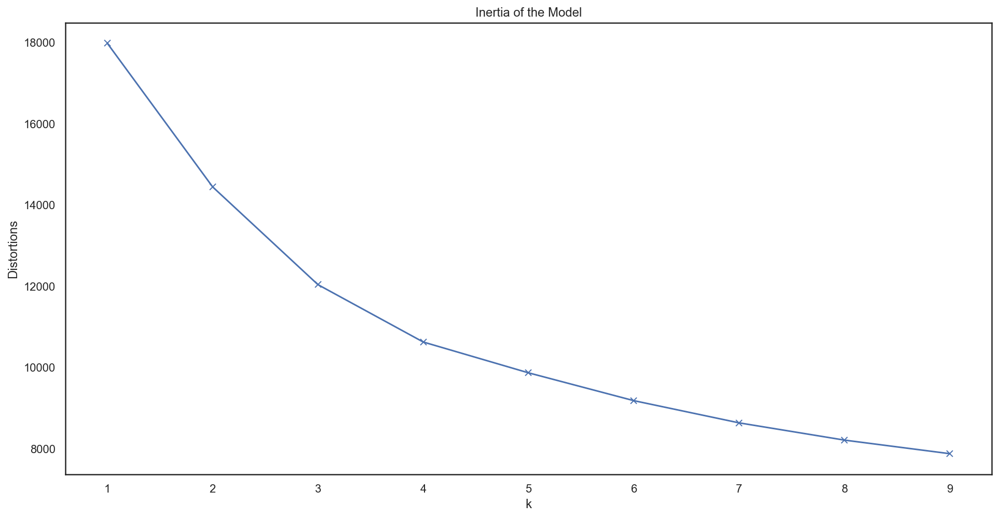

In [303]:
distortions = []
for k in range(1, 10):
    kmeanModel = KMeans(n_clusters=k).fit(Neigh_view_norm)
    distortions.append(kmeanModel.inertia_)

plt.figure(figsize=(16,8))
plt.plot(range(1, 10), distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortions')
plt.title('Inertia of the Model')
plt.show()

For n_clusters = 2, the average silhouette_score is : 0.25099116367690644
For n_clusters = 3, the average silhouette_score is : 0.1924362924817668
For n_clusters = 4, the average silhouette_score is : 0.17903051865090064
For n_clusters = 5, the average silhouette_score is : 0.15416801218872336
For n_clusters = 6, the average silhouette_score is : 0.15747240412943267


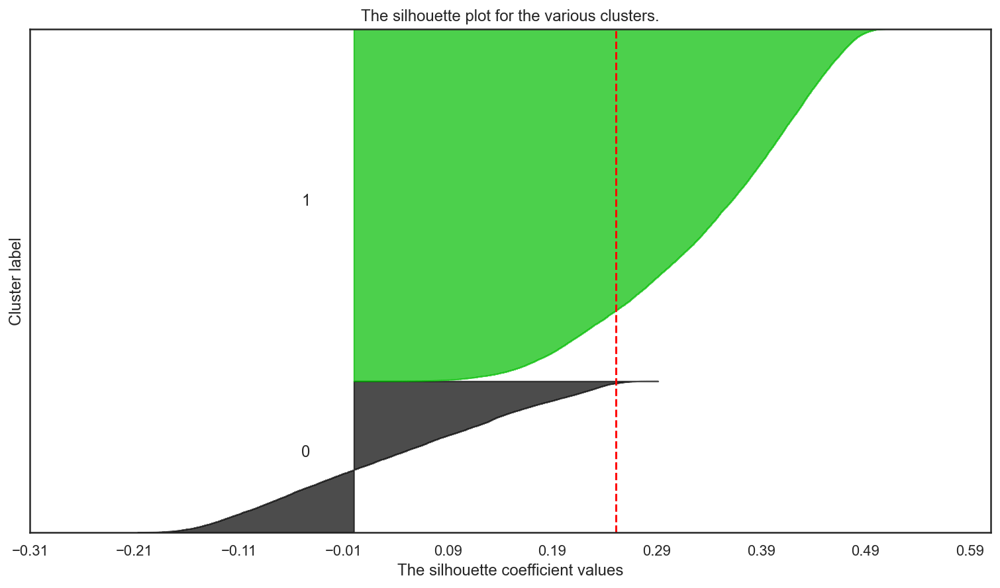

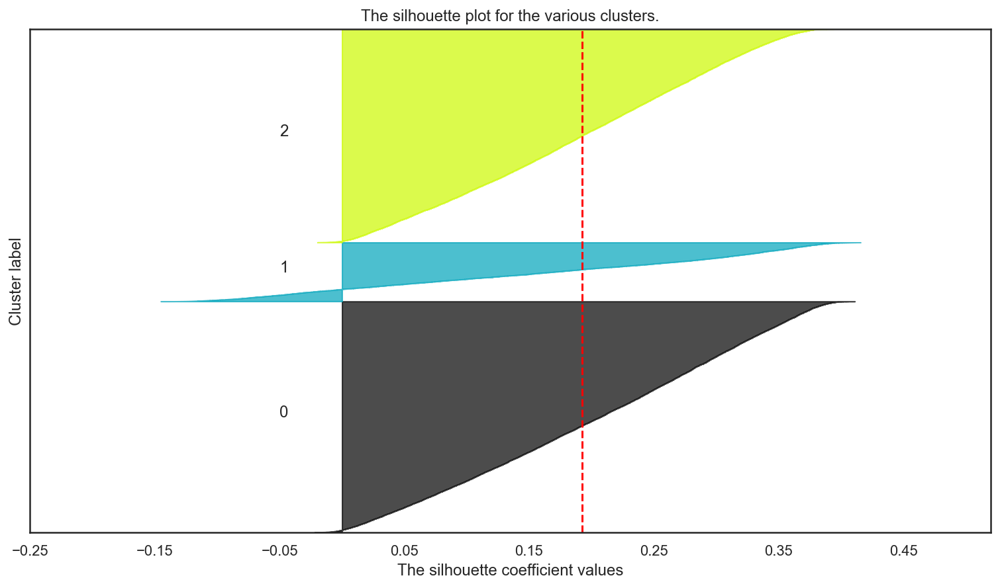

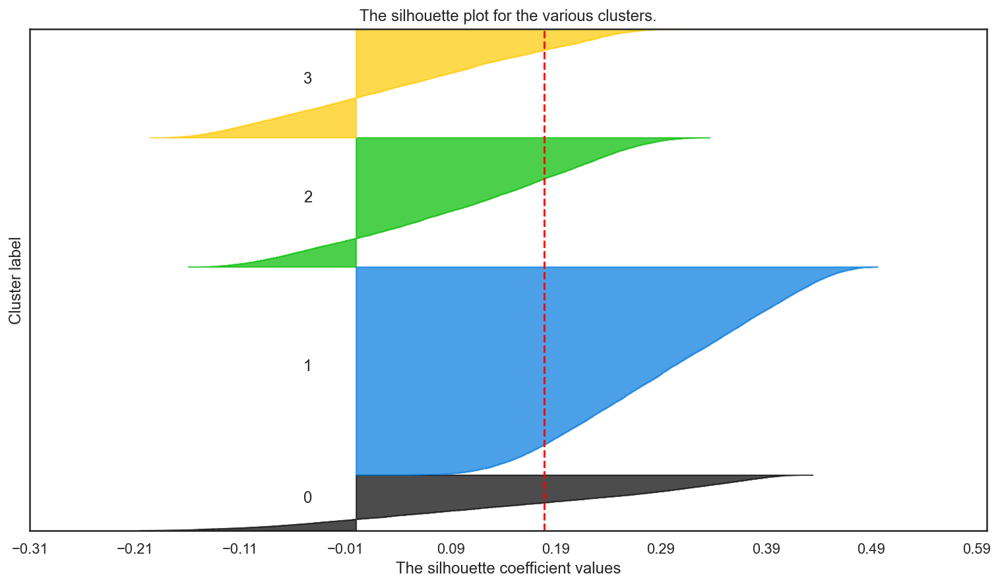

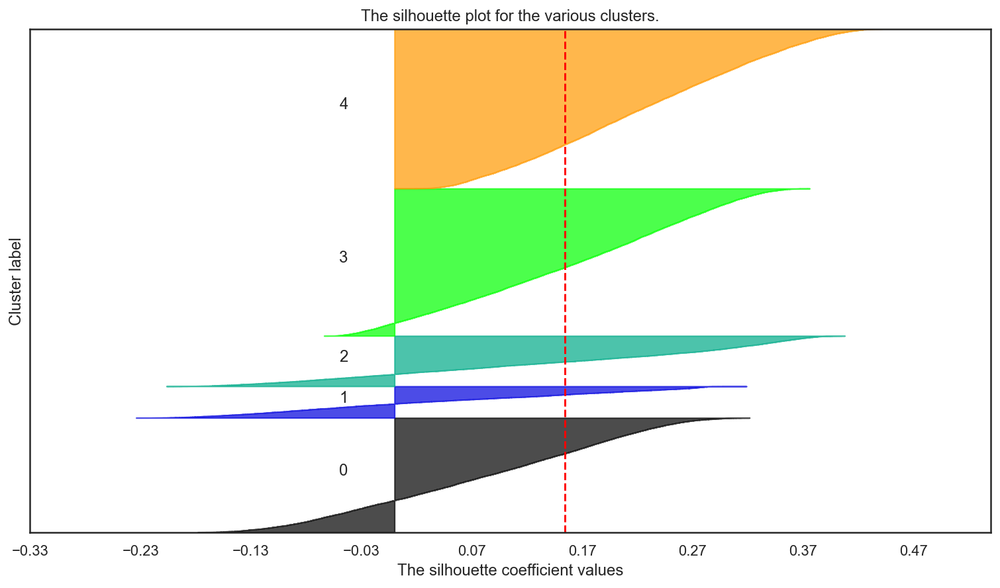

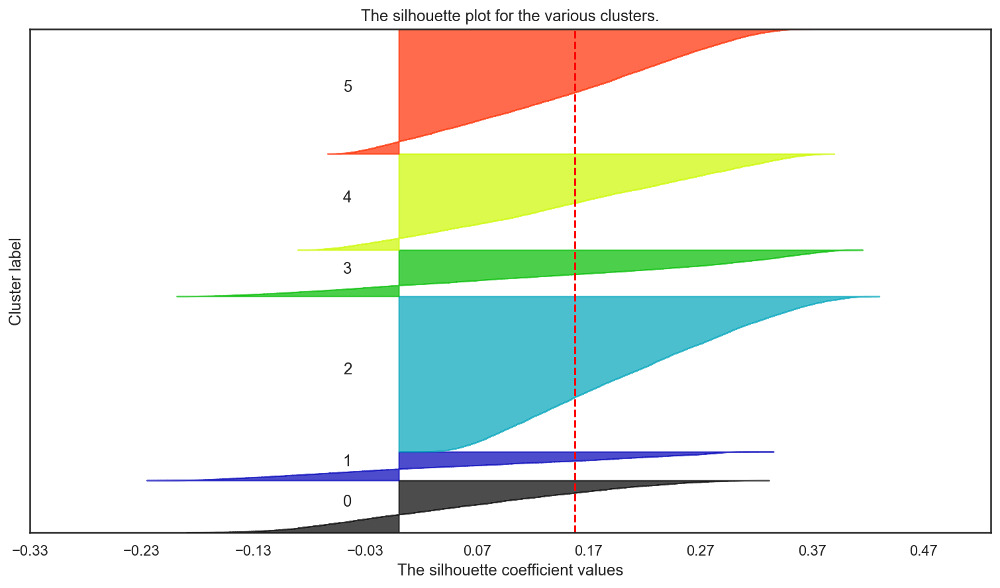

In [304]:
range_clusters = range(1, 7)
# Storing average silhouette metric
avg_silhouette = []
for nclus in range_clusters:
    # Skip nclus == 1
    if nclus == 1:
        continue
    
    # Create a figure
    fig = plt.figure(figsize=(13, 7))

    # Initialize the KMeans object with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
    cluster_labels = kmclust.fit_predict(Neigh_view_norm)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed clusters
    silhouette_avg = silhouette_score(Neigh_view_norm, cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(Neigh_view_norm, cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title("The silhouette plot for the various clusters.")
    plt.xlabel("The silhouette coefficient values")
    plt.ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    
    # The (nclus+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    plt.ylim([0, len(Neigh_view_norm) + (nclus + 1) * 10])

    plt.yticks([])  # Clear the yaxis labels / ticks
    plt.xticks(np.arange(xmin, xmax, 0.1))

According to the silhouette graph, we can see that none of the solution is very good. However, from all, the best one is with 3 clusters, where there are less misclassified observations (to the left) and only one cluster with a small average silhoutte coeficient

In [305]:
kmclust = KMeans(n_clusters=3, init='k-means++',n_init=15, random_state=1)
km_labels3 = kmclust.fit_predict(Neigh_view_norm)

# Caracterização de clusters
cluster_concat = pd.concat((Neigh_view, pd.Series(km_labels3, name='labels')), axis=1)
cluster_concat.groupby('labels').mean()

,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families
labels,,,,,,,,,,,,
0,34.255699,79.229584,61.925298,90.578764,6.694136,5.030317,56.419657,5.413065,19720.102419,25.005687,20.364339,74.885533
1,32.868684,63.584606,49.232097,41.376954,15.530262,8.090513,34.319793,23.648855,10413.593602,26.357688,8.806252,70.936114
2,39.224252,62.927039,45.515543,92.377650,4.233058,9.946358,45.691347,13.125273,13181.858168,34.016634,9.006398,69.581077


Cluster 0: More people employed (men and women), majority white, few foreign born, smaller percentage of widows, more than half composed of two parent earner families, very small percentage below poverty level, higher income per capita, more educated (with bachelors), mostly composed of families

Cluster 1: Less than half are white, more foreign born, less 2 parent earner families, bigger percentage below poverty level, lower income per capita, less educated people

Cluster 2: majority white, slightly older, smallest percentage of foreign born, less people employed, higher percentage of people with high school completed only

In [306]:
# Number of observations in each cluster
pd.Series(km_labels3).value_counts()

0    43078
2    39857
1    11004
dtype: int64

In [307]:
print("BD index for this solution: ",davies_bouldin_score(Neigh_view_norm, km_labels3))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Neigh_view_norm, km_labels3))
print("Silhouette score for this solution: ",metrics.silhouette_score(Military_view, km_labels3, metric='euclidean'))

BD index for this solution:  1.608937142710588
Calinski-Harabasz score for this solution:  23183.875462997763
Silhouette score for this solution:  0.017167256396271858


## 2. K-means + Hierarchical Clustering</font> <a class="anchor" id="kmhc"></a>
[<font color='#E8800A'>2.1. Military View</font>](#milkmhc) <br>
[<font color='#E8800A'>2.2. Personal View</font>](#perkmhc)<br>
[<font color='#E8800A'>2.3. Neighbourhood View</font>](#neigkmhc)<br>

  [Back to Segmentation](#Segmentation)

In [308]:
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage, set_link_color_palette

def get_r2_hc(df, link_method, max_nclus, min_nclus=1, dist="euclidean"):
    def get_ss(df):
        ss = np.sum(df.var() * (df.count() - 1))
        return ss  # return sum of sum of squares of each df variable
    
    sst = get_ss(df)  # get total sum of squares
    
    r2 = []  # where we will store the R2 metrics for each cluster solution
    
    for i in range(min_nclus, max_nclus+1):  # iterate over desired ncluster range
        cluster = AgglomerativeClustering(n_clusters=i, affinity=dist, linkage=link_method)
        hclabels = cluster.fit_predict(df) #get cluster labels
        df_concat = pd.concat((df, pd.Series(hclabels, name='labels')), axis=1)  # concat df with labels
        ssw_labels = df_concat.groupby(by='labels').apply(get_ss)  # compute ssw for each cluster labels
        ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
        r2.append(ssb / sst)  # save the R2 of the given cluster solution
        
    return np.array(r2)

### 2.1. Military View</font> <a class="anchor" id="milkmhc"></a>

In [309]:
kmclustMil = KMeans(n_clusters=100, init='k-means++',n_init=15, random_state=1)
kmMil_labels = kmclustMil.fit_predict(Military_view)
cenMil = kmclustMil.cluster_centers_

In [310]:
# Performing kmeans and appending the cluster labels to a new dataframe that keeps the cluster labels
kmMil_clusters = Military_view.copy()
kmMil_clusters["kmeans_Mil_labels"] = kmMil_labels

In [311]:
kmMil_clusters = kmMil_clusters.groupby("kmeans_Mil_labels").mean()
kmMil_clusters

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4
kmeans_Mil_labels,,,,,,,
0,4.006944,40.852431,64.376736,10.019097,2.133681,16.781250,11.843750
1,0.347778,27.660000,22.984444,35.861111,0.804444,6.350000,4.454444
2,0.640971,31.720613,41.178450,21.212095,1.264055,14.177172,13.506814
3,0.427754,37.422031,10.779685,57.101574,1.592275,11.035765,18.383405
4,0.000000,0.428571,0.112887,0.170829,1.240759,25.723277,5.361638
5,0.721947,39.503300,36.952970,28.347360,1.173267,30.456271,4.970297
6,0.590595,16.946058,29.282158,21.127248,1.261411,9.903181,30.717842
7,0.216012,31.058912,13.220544,56.359517,0.899547,19.729607,4.061934
8,84.064103,8.576923,20.166667,2.961538,3.205128,20.628205,17.307692


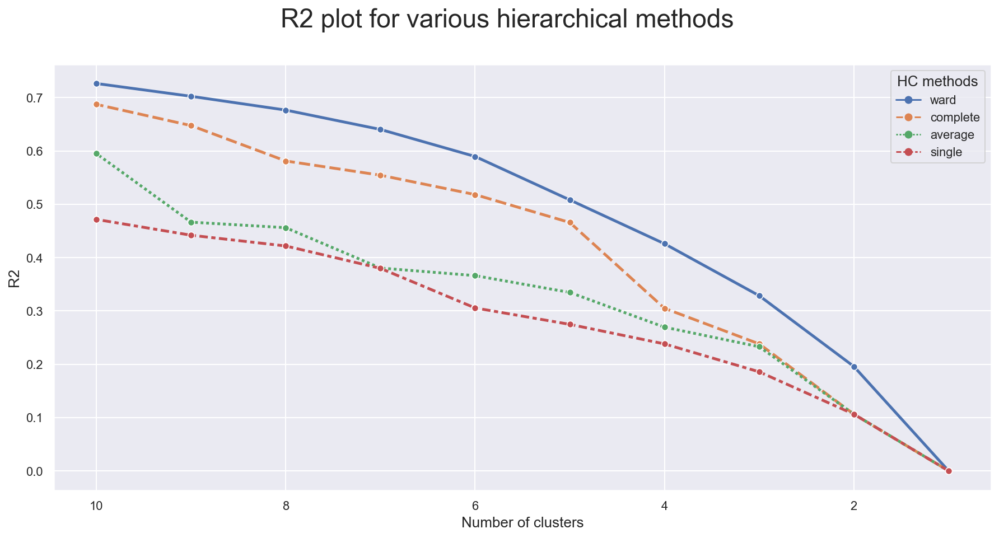

In [312]:
hier_methods = ["ward", "complete", "average", "single"]
# Function defined above to obtain the R2 statistic

r2_hier_methods = pd.DataFrame(data=np.concatenate([np.expand_dims(get_r2_hc(df=kmMil_clusters, link_method=i, max_nclus=10), 1) for i in hier_methods], axis=1),
                             index=range(1,10+1), columns=hier_methods)

sns.set()
# Plot data
fig = plt.figure(figsize=(15,7))
sns.lineplot(data=r2_hier_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
fig.suptitle("R2 plot for various hierarchical methods", fontsize=23)
plt.gca().invert_xaxis()
plt.legend(title="HC methods", title_fontsize=13)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2", fontsize=13)

plt.show()

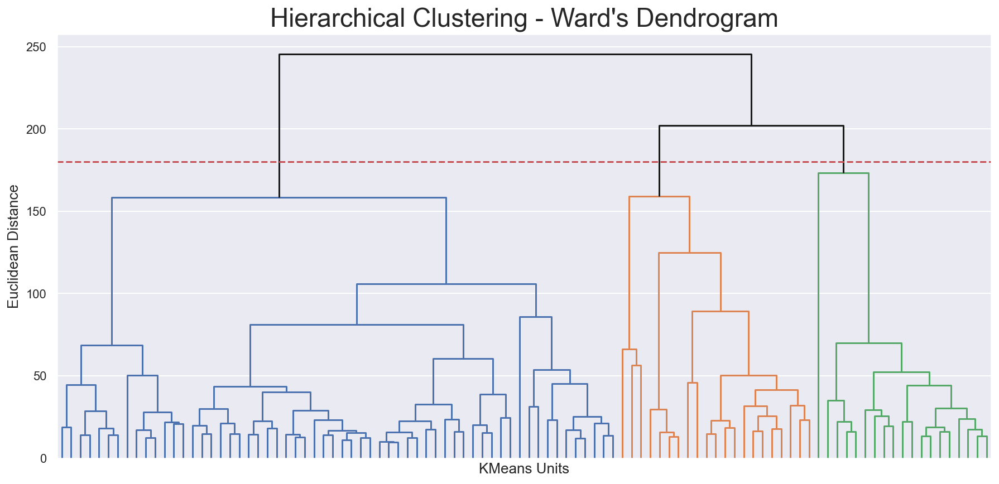

In [313]:
# Hierarchical clustering assessment using scipy
Z = linkage(kmMil_clusters, method="ward")

sns.set()
fig = plt.figure(figsize=(15,7))

# Dendrogram
set_link_color_palette(list(sns.color_palette().as_hex()))
dendrogram(Z, color_threshold=180, orientation='top', no_labels=True, above_threshold_color='k')

plt.hlines(180, 0, 1000, colors="r", linestyles="dashed")
plt.title('Hierarchical Clustering - Ward\'s Dendrogram', fontsize=23)
plt.xlabel('KMeans Units', fontsize=13)
plt.ylabel('Euclidean Distance', fontsize=13)
plt.show()

3 final clusters

In [314]:
kmhc_clust = AgglomerativeClustering(linkage='ward', affinity='euclidean', n_clusters=3)
hcMil_labels = kmhc_clust.fit_predict(kmMil_clusters)

In [315]:
# Getting all the observations associated to their respective k-means centroid with k=100
kmhc_Mil=pd.concat((Military_view, pd.Series(kmMil_labels)), axis=1)
kmhc_Mil.rename(columns={0:'KM_label'},inplace=True)

In [316]:
# Joining the label gotten from the hierarchical clustering on top of k-means, associated to each k-means label
kmhc_Mil_final = kmhc_Mil.merge(pd.concat((kmMil_clusters, pd.Series(hcMil_labels)), axis=1).iloc[:,7], left_on='KM_label',right_index=True, how='left')
kmhc_Mil_final.rename(columns={0:'HC_label'},inplace=True)

In [317]:
# Characterizing the final clusters
kmhc_Mil_final.drop(columns='KM_label').groupby('HC_label').mean()

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4
HC_label,,,,,,,
0,2.048893,29.914607,51.380729,17.851413,1.332720,17.695267,9.664283
1,0.428798,32.680598,26.143709,39.428887,1.183099,19.016147,8.953977
2,3.339284,19.407832,24.199242,13.338863,1.861558,13.328084,27.593432


Cluster 0: More veteran from Viet, in between the other clusters, not too visible but less veteran women

Cluster 1: More veteran men except on the Viet, but a lot more on WWII, less active military men, less recent veterans (1995)

Cluster 2: More men in active military service, less veterans specially on the WWII, more recent veterans in general

note: Veteran women (AFC6) does not vary

In [318]:
# Number of observations in each cluster
kmhc_Mil_final.HC_label.value_counts()

1    67379
0    14685
2    11875
Name: HC_label, dtype: int64

In [319]:
print("BD index for this solution: ",davies_bouldin_score(Military_view, kmhc_Mil_final.HC_label))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Military_view, kmhc_Mil_final.HC_label))
print("Silhouette score for this solution: ",metrics.silhouette_score(Military_view, kmhc_Mil_final.HC_label, metric='euclidean'))

BD index for this solution:  1.4781826037659078
Calinski-Harabasz score for this solution:  19401.69894938358
Silhouette score for this solution:  0.22804455720524205


### 2.2. Personal View</font> <a class="anchor" id="perkmhc"></a>

In [320]:
kmclustPer = KMeans(n_clusters=100, init='k-means++',n_init=15, random_state=1)
kmPer_labels = kmclustPer.fit_predict(Personal_view_norm)
cenPer = kmclustPer.cluster_centers_

In [321]:
# Performing kmeans and appending the cluster labels to a new dataframe that keeps the cluster labels
kmPer_clusters = Personal_view.copy()
kmPer_clusters["kmeans_Per_labels"] = kmPer_labels

In [322]:
kmPer_clusters = kmPer_clusters.groupby("kmeans_Per_labels").mean()
kmPer_clusters

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity
kmeans_Per_labels,,,,,,,,
0,0.053503,3.472726,72.687898,7.396716,36.671338,0.480224,547.481529,3059.830573
1,0.106877,5.120864,56.569703,17.264055,3.552974,0.104053,753.642193,573.563197
2,0.076095,2.012237,65.558032,11.295187,10.270561,0.198234,531.038432,1753.143736
3,0.040962,5.010196,79.329475,12.414770,9.723954,0.182210,538.193232,1776.790739
4,0.056047,4.998466,66.213127,10.501784,15.927729,0.232248,522.193953,3002.363569
5,0.174749,4.991547,48.779264,12.644810,11.209866,0.184734,526.015886,2376.076087
6,0.189189,3.996508,46.872169,15.118195,3.807159,0.127019,523.734843,549.006574
7,0.070370,3.903681,58.243704,16.201362,3.320000,0.113438,620.863704,433.580000
8,0.216012,6.992440,53.322508,16.305168,3.736405,0.121731,529.253021,578.929003


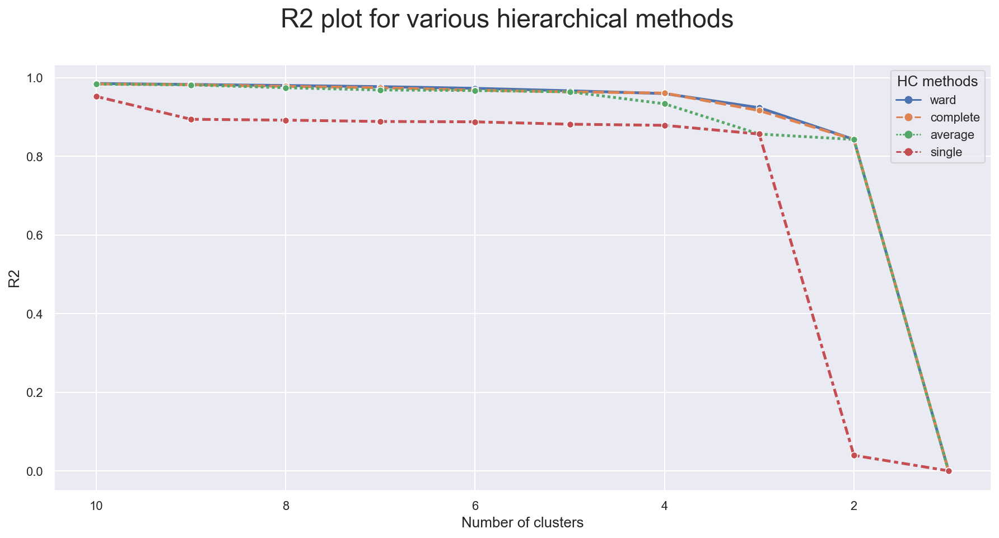

In [323]:
hier_methods = ["ward", "complete", "average", "single"]
# Function defined above to obtain the R2 statistic

r2_hier_methods = pd.DataFrame(data=np.concatenate([np.expand_dims(get_r2_hc(df=kmPer_clusters, link_method=i, max_nclus=10), 1) for i in hier_methods], axis=1),
                             index=range(1,10+1), columns=hier_methods)

sns.set()
# Plot data
fig = plt.figure(figsize=(15,7))
sns.lineplot(data=r2_hier_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
fig.suptitle("R2 plot for various hierarchical methods", fontsize=23)
plt.gca().invert_xaxis()
plt.legend(title="HC methods", title_fontsize=13)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2", fontsize=13)

plt.show()

All linkage methods are very similar, but as Ward's usually performs better, we'll use it

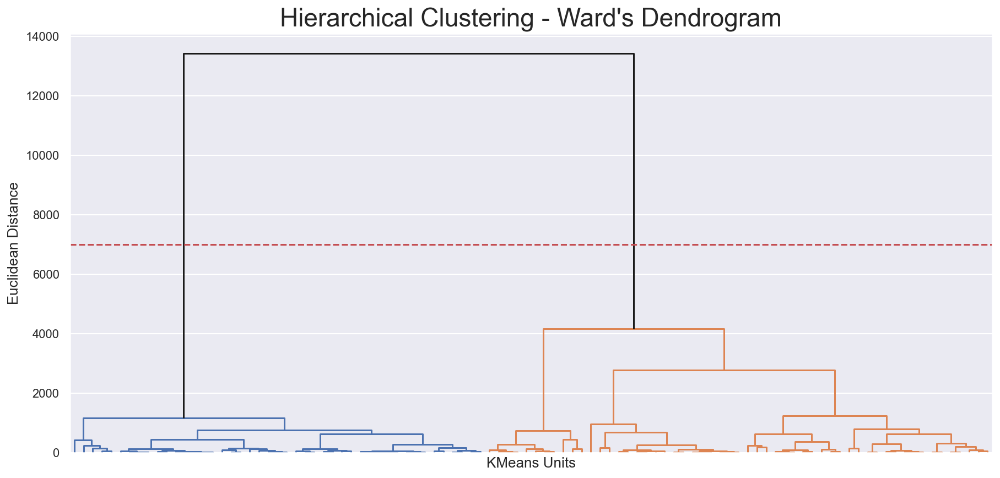

In [324]:
# Hierarchical clustering assessment using scipy
Z = linkage(kmPer_clusters, method="ward")

sns.set()
fig = plt.figure(figsize=(15,7))

# Dendrogram
set_link_color_palette(list(sns.color_palette().as_hex()))
dendrogram(Z, color_threshold=7000, orientation='top', no_labels=True, above_threshold_color='k')

plt.hlines(7000, 0, 1000, colors="r", linestyles="dashed")
plt.title('Hierarchical Clustering - Ward\'s Dendrogram', fontsize=23)
plt.xlabel('KMeans Units', fontsize=13)
plt.ylabel('Euclidean Distance', fontsize=13)
plt.show()

2 final clusters

In [325]:
kmhc_clust = AgglomerativeClustering(linkage='ward', affinity='euclidean', n_clusters=2)
hcPer_labels = kmhc_clust.fit_predict(kmPer_clusters)

In [326]:
# Getting all the observations associated to their respective k-means centroid with k=100
kmhc_Per=pd.concat((Personal_view, pd.Series(kmPer_labels)), axis=1)
kmhc_Per.rename(columns={0:'KM_label'},inplace=True)

In [327]:
# Joining the label gotten from the hierarchical clustering on top of k-means, associated to each k-means label
kmhc_Per_final = kmhc_Per.merge(pd.concat((kmPer_clusters, pd.Series(hcPer_labels)), axis=1).iloc[:,8], left_on='KM_label',right_index=True, how='left')
kmhc_Per_final.rename(columns={0:'HC_label'},inplace=True)

In [328]:
# Characterizing the final clusters
kmhc_Per_final.drop(columns='KM_label').groupby('HC_label').mean()

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity
HC_label,,,,,,,,
0,0.140790,3.750136,67.181741,11.261499,15.090701,0.230307,538.968166,2463.394471
1,0.259628,4.036272,58.131003,15.289677,3.992221,0.127921,579.117331,561.162377


Cluster 0: Older, less amounts donated per gift, donated more times, with a higher response rate and have been donating for longer

Cluster 1: Younger (around 58 y.o),higher income, donated more amounts, but less times. Lower response rate and have been donating for a shorter time<br>

In [329]:
# Number of observations in each cluster
kmhc_Per_final.HC_label.value_counts()

0    47276
1    46663
Name: HC_label, dtype: int64

In [330]:
print("BD index for this solution: ",davies_bouldin_score(Personal_view_norm, kmhc_Per_final.HC_label))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Personal_view_norm, kmhc_Per_final.HC_label))
print("Silhouette score for this solution: ",metrics.silhouette_score(Personal_view_norm, kmhc_Per_final.HC_label, metric='euclidean'))

BD index for this solution:  2.583127996113058
Calinski-Harabasz score for this solution:  12174.322685734875
Silhouette score for this solution:  0.12348451802911084


### 2.3. Neigh View</font> <a class="anchor" id="neigkmhc"></a>

In [331]:
kmclustNeigh = KMeans(n_clusters=100, init='k-means++',n_init=15, random_state=1)
kmNeigh_labels = kmclustNeigh.fit_predict(Neigh_view_norm)
cenNeigh = kmclustNeigh.cluster_centers_

In [332]:
# Performing kmeans and appending the cluster labels to a new dataframe that keeps the cluster labels
kmNeigh_clusters = Neigh_view.copy()
kmNeigh_clusters["kmeans_Neigh_labels"] = kmNeigh_labels

In [333]:
kmNeigh_clusters = kmNeigh_clusters.groupby("kmeans_Neigh_labels").mean()
kmNeigh_clusters

,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families
kmeans_Neigh_labels,,,,,,,,,,,,
0,33.018987,84.948312,69.277426,90.637131,6.981013,3.582278,55.224684,4.166667,24429.760549,13.818565,34.234177,65.912447
1,32.242891,73.632701,52.793246,81.116706,5.524289,6.010071,44.116114,13.900474,11405.777251,33.585900,7.121445,78.062796
2,30.900474,39.063981,32.836493,6.978673,2.251185,10.919431,10.118483,53.639810,5296.080569,25.954976,3.395735,71.151659
3,39.558933,67.219733,48.254933,97.630933,1.410133,11.837867,61.509333,11.275733,11624.549333,40.078400,7.504000,68.683200
4,31.220299,81.774556,63.238541,94.652011,2.746492,4.101964,52.256782,5.779701,13722.865762,38.103368,9.059869,82.501403
5,72.042553,16.744681,9.152482,98.457447,10.120567,33.131206,0.056738,6.617021,19856.028369,30.134752,13.085106,42.563830
6,32.424176,79.639560,65.147253,49.989011,30.468132,3.989011,61.375824,4.221978,20471.004396,17.123077,26.028571,82.520879
7,31.976038,55.303514,40.817891,32.039936,4.694888,9.977636,25.956869,38.253994,7232.875399,27.071885,5.615016,72.623003
8,48.661808,53.161808,36.725948,95.823615,6.437318,10.865889,53.034985,5.055394,25816.683673,23.059767,22.747813,70.577259


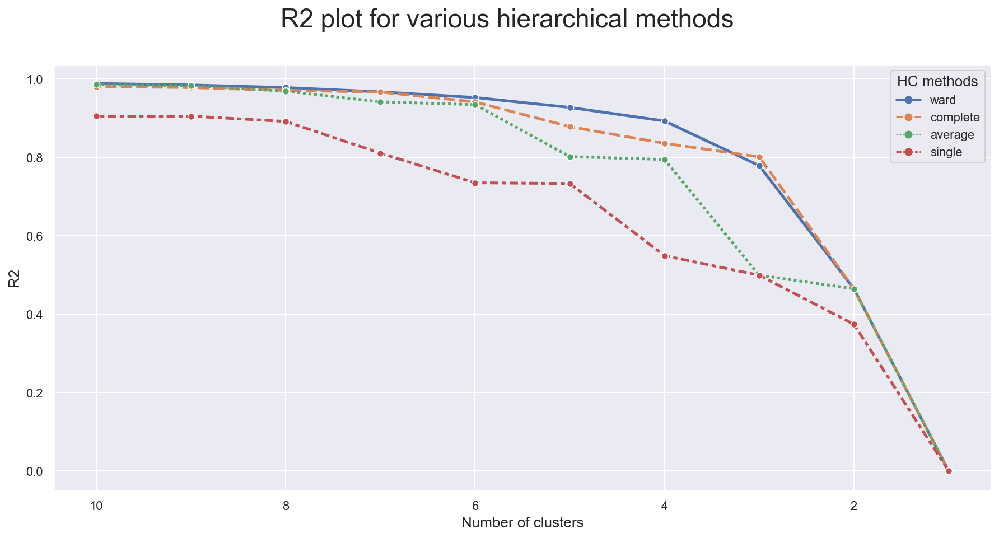

In [334]:
hier_methods = ["ward", "complete", "average", "single"]
# Function defined above to obtain the R2 statistic

r2_hier_methods = pd.DataFrame(data=np.concatenate([np.expand_dims(get_r2_hc(df=kmNeigh_clusters, link_method=i, max_nclus=10), 1) for i in hier_methods], axis=1),
                             index=range(1,10+1), columns=hier_methods)

sns.set()
# Plot data
fig = plt.figure(figsize=(15,7))
sns.lineplot(data=r2_hier_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
fig.suptitle("R2 plot for various hierarchical methods", fontsize=23)
plt.gca().invert_xaxis()
plt.legend(title="HC methods", title_fontsize=13)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2", fontsize=13)

plt.show()

Although similar, Ward seems to perform better

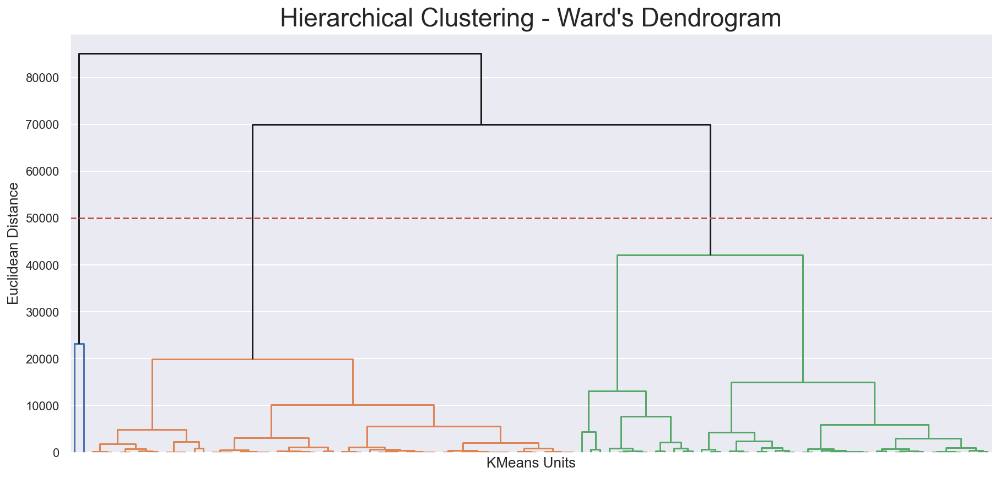

In [335]:
# Hierarchical clustering assessment using scipy
Z = linkage(kmNeigh_clusters, method="ward")

sns.set()
fig = plt.figure(figsize=(15,7))

# Dendrogram
set_link_color_palette(list(sns.color_palette().as_hex()))
dendrogram(Z, color_threshold=50000, orientation='top', no_labels=True, above_threshold_color='k')

plt.hlines(50000, 0, 1000, colors="r", linestyles="dashed")
plt.title('Hierarchical Clustering - Ward\'s Dendrogram', fontsize=23)
plt.xlabel('KMeans Units', fontsize=13)
plt.ylabel('Euclidean Distance', fontsize=13)
plt.show()

3 final clusters

In [336]:
kmhc_clust = AgglomerativeClustering(linkage='ward', affinity='euclidean', n_clusters=3)
hcNeigh_labels = kmhc_clust.fit_predict(kmNeigh_clusters)

In [337]:
# Getting all the observations associated to their respective k-means centroid with k=100
kmhc_Neigh=pd.concat((Neigh_view, pd.Series(kmNeigh_labels)), axis=1)
kmhc_Neigh.rename(columns={0:'KM_label'},inplace=True)

In [338]:
# Joining the label gotten from the hierarchical clustering on top of k-means, associated to each k-means label
kmhc_Neigh_final = kmhc_Neigh.merge(pd.concat((kmNeigh_clusters, pd.Series(hcNeigh_labels)), axis=1).iloc[:,12], left_on='KM_label',right_index=True, how='left')
kmhc_Neigh_final.rename(columns={0:'HC_label'},inplace=True)

In [339]:
# Characterizing the final clusters
kmhc_Neigh_final.drop(columns='KM_label').groupby('HC_label').mean()

,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families
HC_label,,,,,,,,,,,,
0,37.279838,74.554844,57.572325,90.242246,7.649228,6.738958,53.744220,5.437996,20636.778320,23.018619,21.983026,71.413711
1,44.813699,67.772603,39.732877,94.610959,11.034247,7.461644,33.724658,3.872603,61835.249315,12.354795,31.849315,73.778082
2,35.289946,67.516030,50.646286,82.021237,5.915777,8.016506,46.202295,14.880288,11709.821308,33.608879,8.213417,72.709085


Cluster 0: More men and women employed, majority white, more than half of the neighbourhood has two parent earner families, similar percentage of high school completed and bachelors<br>

Cluster 1: Slightly higher average age (42y.o), high percentage of men employed, but not even half of the women are employed, highest percentage of whites and of foreign borns, less 2 parent earner families, highest income, lowest poverty level and higher education (lowest percentage of high school completed only, and highest of bachelors)

Cluster 1: Average age is 35 y.o, slightly less men employed, slightly less white, but still the majority, less foreign borns, higher percentage of below poverty level, less income and much less bachelors, but more high school.<br>

In [340]:
# Number of observations in each cluster
kmhc_Neigh_final.HC_label.value_counts()

2    53679
0    39530
1      730
Name: HC_label, dtype: int64

In [341]:
print("BD index for this solution: ",davies_bouldin_score(Neigh_view_norm, kmhc_Neigh_final.HC_label))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Neigh_view_norm, kmhc_Neigh_final.HC_label))
print("Silhouette score for this solution: ",metrics.silhouette_score(Neigh_view_norm, kmhc_Neigh_final.HC_label, metric='euclidean'))

BD index for this solution:  2.097963630923953
Calinski-Harabasz score for this solution:  6965.247717032164
Silhouette score for this solution:  0.12397905944742209


In [342]:
# Characterizing the final clusters
kmhc_Neigh_final.drop(columns='KM_label').groupby('HC_label').mean()

,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families
HC_label,,,,,,,,,,,,
0,37.279838,74.554844,57.572325,90.242246,7.649228,6.738958,53.744220,5.437996,20636.778320,23.018619,21.983026,71.413711
1,44.813699,67.772603,39.732877,94.610959,11.034247,7.461644,33.724658,3.872603,61835.249315,12.354795,31.849315,73.778082
2,35.289946,67.516030,50.646286,82.021237,5.915777,8.016506,46.202295,14.880288,11709.821308,33.608879,8.213417,72.709085


## 3. SOM </font> <a class="anchor" id="som"></a>
[<font color='#E8800A'>3.1. Military View</font>](#milsom) <br>
[<font color='#E8800A'>3.2. Personal View</font>](#persom)<br>
[<font color='#E8800A'>3.3. Neighbourhood View</font>](#neigsom)<br>

  [Back to Segmentation](#Segmentation)

In [346]:
import joblib
import random
from sompy.visualization.plot_tools import plot_hex_map
import logging
import sompy
from sompy.visualization.mapview import View2D
from sompy.visualization.mapview import View2DPacked
from sompy.visualization.bmuhits import BmuHitsView
from sompy.visualization.hitmap import HitMapView

In [347]:
# https://github.com/joaopfonseca/SOMPY/blob/master/sompy/sompy.py

### 3.1. Military view</font> <a class="anchor" id="milsom"></a>

In [348]:
np.random.seed(1)

som_Mil = sompy.SOMFactory().build(data = Military_view.values,
                  mapsize = (10,10),
                  normalization = 'var',
                  initialization = 'random',
                  component_names = Military_view.columns, # TESTAAAAAAAAAAR
                  lattice='hexa',
                  training = 'seq')

som_Mil.train(n_job = -1,
            verbose = 'info',
            train_rough_len = 30,
            train_finetune_len = 100)

 Training...
 random_initialization took: 0.002000 seconds
 Rough training...
 radius_ini: 4.000000 , radius_final: 1.000000, trainlen: 30

 epoch: 1 ---> elapsed time:  0.470000, quantization error: 6.679823

 epoch: 2 ---> elapsed time:  0.448000, quantization error: 2.166563

 epoch: 3 ---> elapsed time:  0.438000, quantization error: 2.140572

 epoch: 4 ---> elapsed time:  0.418000, quantization error: 2.129265

 epoch: 5 ---> elapsed time:  0.407000, quantization error: 2.119607

 epoch: 6 ---> elapsed time:  0.413000, quantization error: 2.109744

 epoch: 7 ---> elapsed time:  0.398000, quantization error: 2.098790

 epoch: 8 ---> elapsed time:  0.393000, quantization error: 2.086848

 epoch: 9 ---> elapsed time:  0.406000, quantization error: 2.073700

 epoch: 10 ---> elapsed time:  0.399000, quantization error: 2.059753

 epoch: 11 ---> elapsed time:  0.361000, quantization error: 2.046356

 epoch: 12 ---> elapsed time:  0.376000, quantization error: 2.033025

 epoch: 13 ---> e

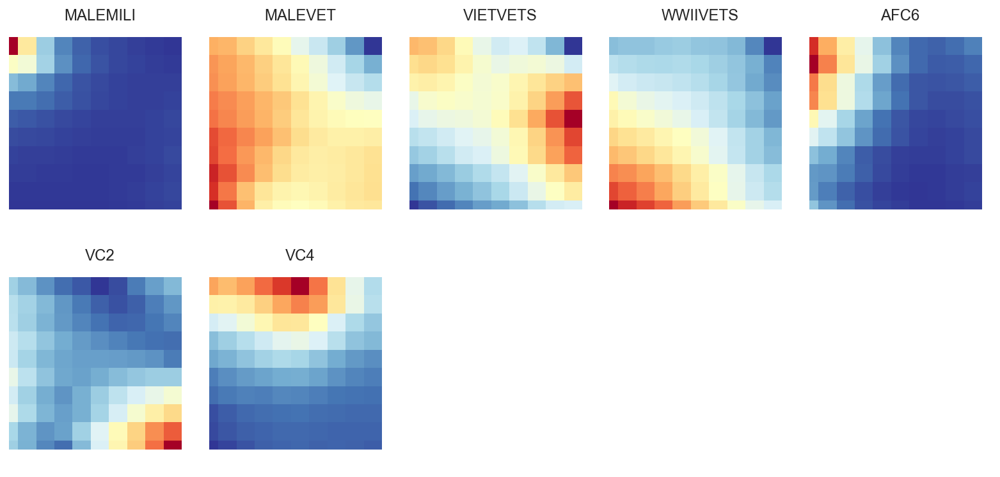

In [349]:
view2D = View2DPacked(50,50,"", text_size=8)
view2D.show(som_Mil, col_sz=5, what = 'codebook')
plt.show()

MALEMILI seem to have outlier on the bottom right, but at the same time presents a local correlation with AFC6 on the same region.<br>
MALEVET  seems not very well defined, but with higher values on the top right, like WWIIVETS  (local corr), while also revealing higher values on the top left (like VC2) and also on the bottom right (like AFC6) -> so we might say it's locally correlated with these 3<br>
VC4 doesn't show any local correltions with the other variables, but reveals higher values on the bottom region

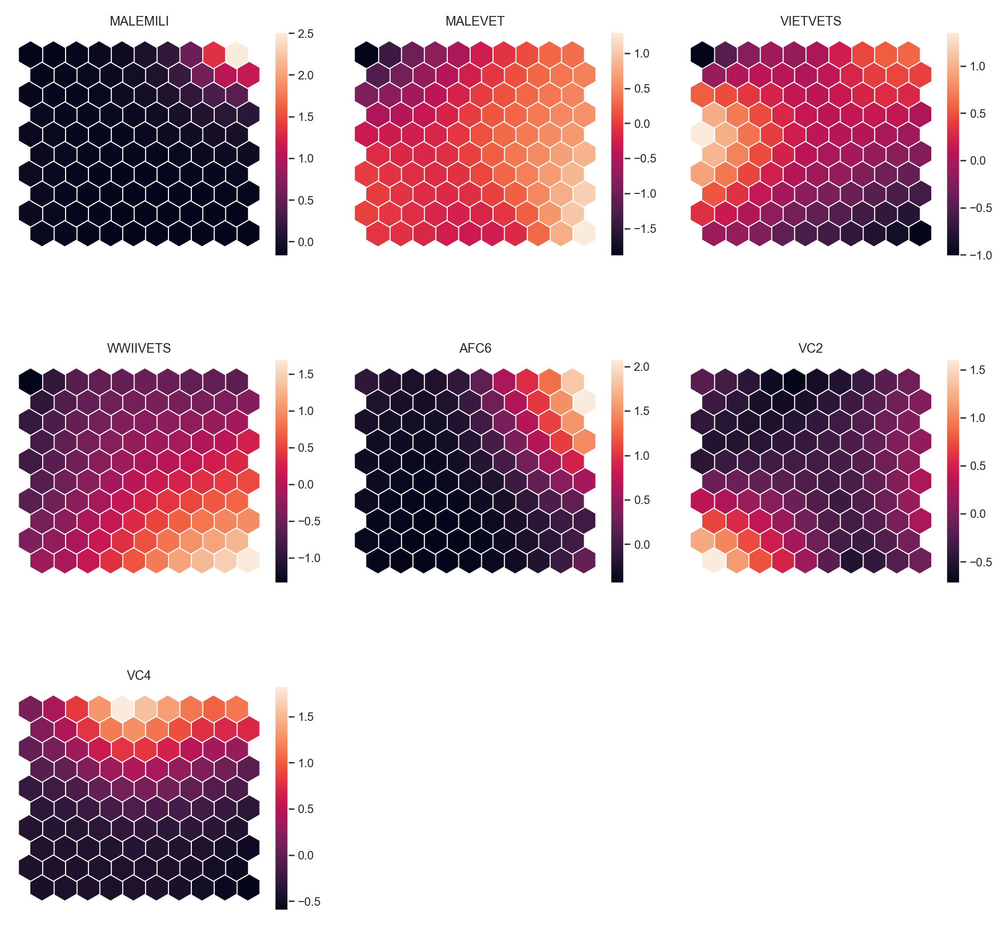

In [350]:
view2D = View2D(50,50,"", text_size=8)
view2D.show(som_Mil, col_sz=3, what = 'codebook')
plt.show()

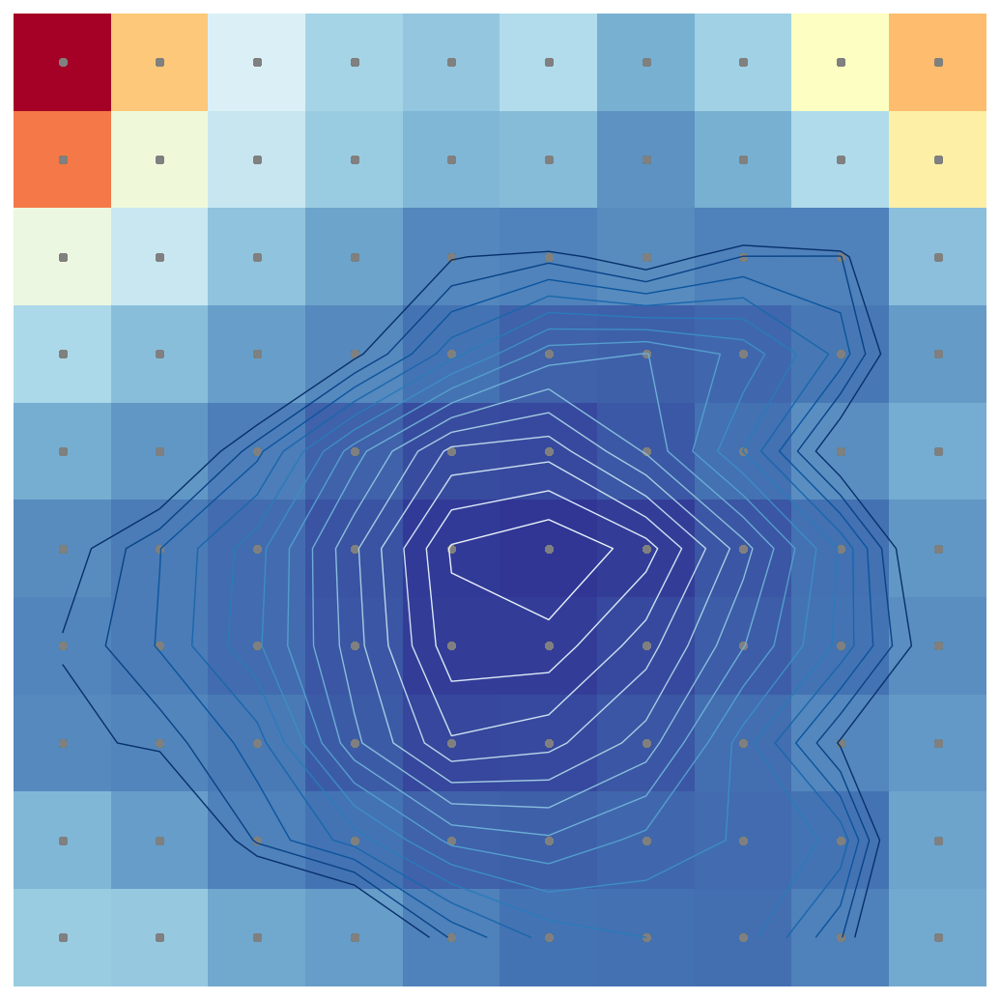

array([[0.92918273, 0.68454231, 0.50604934, 0.4350257 , 0.41470793,
        0.45201896, 0.37921308, 0.43157917, 0.5779746 , 0.69875781],
       [0.77587994, 0.54810156, 0.47858054, 0.42351743, 0.38975428,
        0.39695768, 0.34029901, 0.37850884, 0.4494149 , 0.61505398],
       [0.53842441, 0.48269989, 0.4092635 , 0.36157983, 0.32727314,
        0.32234605, 0.33363202, 0.31948529, 0.3188574 , 0.4025694 ],
       [0.44537271, 0.40126171, 0.35695435, 0.32889835, 0.30233674,
        0.28317989, 0.27975087, 0.28875892, 0.30900854, 0.3510989 ],
       [0.37572482, 0.34537385, 0.31519606, 0.28313939, 0.25806723,
        0.25587826, 0.27419635, 0.30007959, 0.33541983, 0.37275759],
       [0.33193857, 0.31337251, 0.29585885, 0.26805211, 0.23939584,
        0.23353137, 0.24357987, 0.27040557, 0.30081221, 0.34560371],
       [0.32561708, 0.31249419, 0.29449943, 0.26955078, 0.24247345,
        0.24259019, 0.25701406, 0.27958603, 0.30186634, 0.33551806],
       [0.32994002, 0.32373753, 0.3098275

In [351]:
# U-matrix
u = sompy.umatrix.UMatrixView(50, 50, 'umatrix', show_axis=True, text_size=8, show_text=True)

UMAT = u.show(
    som_Mil, 
    distance2=1, 
    row_normalized=False, 
    show_data=True, 
    contooor=True, # Visualize isomorphic curves
    blob=False
)

UMAT[1]

Possibly three clusters, but not very well defined. On the bottom right side possibly outliers.

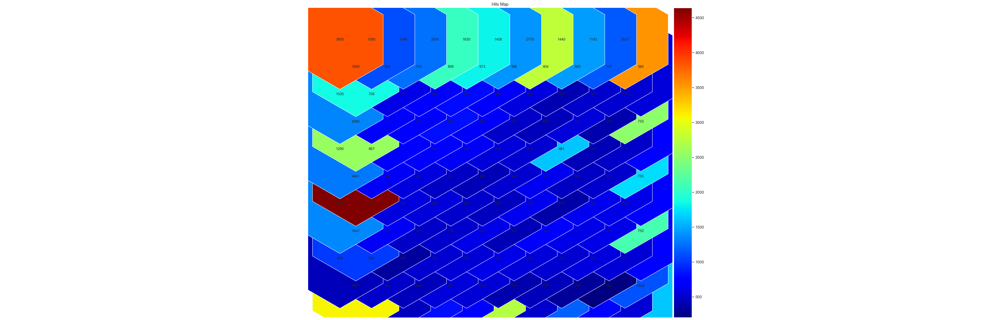

In [352]:
vhts = BmuHitsView(50,50,"Hits Map",text_size=7)
vhts.show(som_Mil, anotate=True, onlyzeros=False, labelsize=10, logaritmic=False)

In [353]:
som_Mil.get_node_vectors()

array([[13.75278063, 34.28025571, 38.85117628, 22.04120235,  4.32368892,
        17.54176191, 23.5081861 ],
       [ 7.87524568, 33.74861784, 38.21733724, 22.69569279,  3.45748777,
        16.35224666, 22.39666407],
       [ 3.94131242, 31.88996601, 36.56248973, 22.58014065,  2.87198394,
        14.65835552, 23.58378473],
       [ 1.98315751, 29.91294124, 32.98871259, 23.44855917,  2.31288917,
        13.26543578, 25.82813231],
       [ 1.1707982 , 27.55022063, 29.87809899, 23.92804953,  1.60801887,
        12.39706429, 27.92232965],
       [ 0.76844369, 24.31786378, 27.98402081, 22.79313601,  1.11580264,
        11.17121961, 30.9527491 ],
       [ 0.57574235, 22.1706977 , 28.79411455, 22.58969666,  0.92117461,
        12.02789114, 25.44181649],
       [ 0.42813476, 19.23075638, 26.87759959, 21.27846318,  0.87005182,
        13.71137912, 20.31715697],
       [ 0.31635475, 15.04373786, 22.63446852, 16.27512228,  0.95357484,
        15.1664489 , 16.07547145],
       [ 0.19418247,  9.1984

### 3.1.1. Applying k-means on top of SOM

In [354]:
som_Mil.get_node_vectors().shape 

(100, 7)

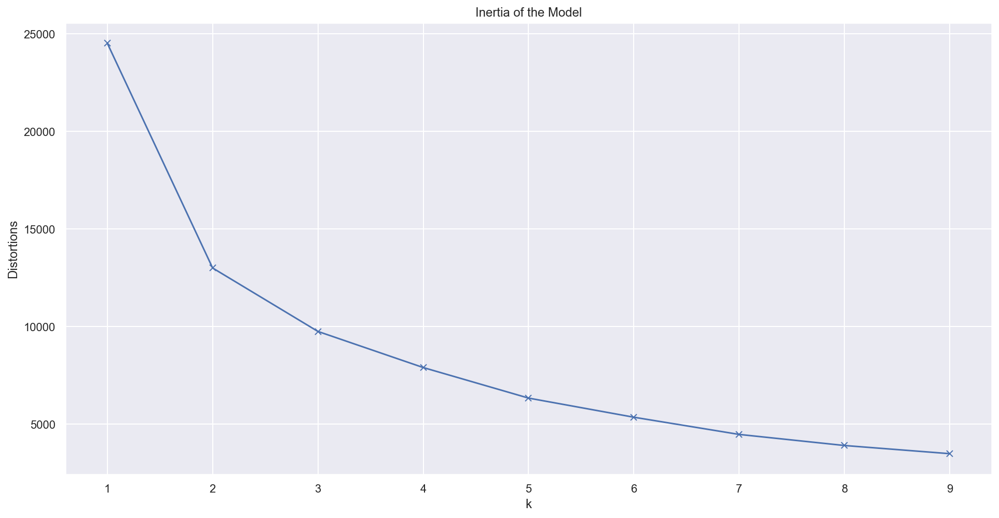

In [355]:
distortions = []
for k in range(1, 10):
    kmeanModel = KMeans(n_clusters=k).fit(som_Mil.get_node_vectors())
    distortions.append(kmeanModel.inertia_)

plt.figure(figsize=(16,8))
plt.plot(range(1, 10), distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortions')
plt.title('Inertia of the Model')
plt.show()

From the scree plot it could be any number of k, from 2 to 5 (but seems more like 2)

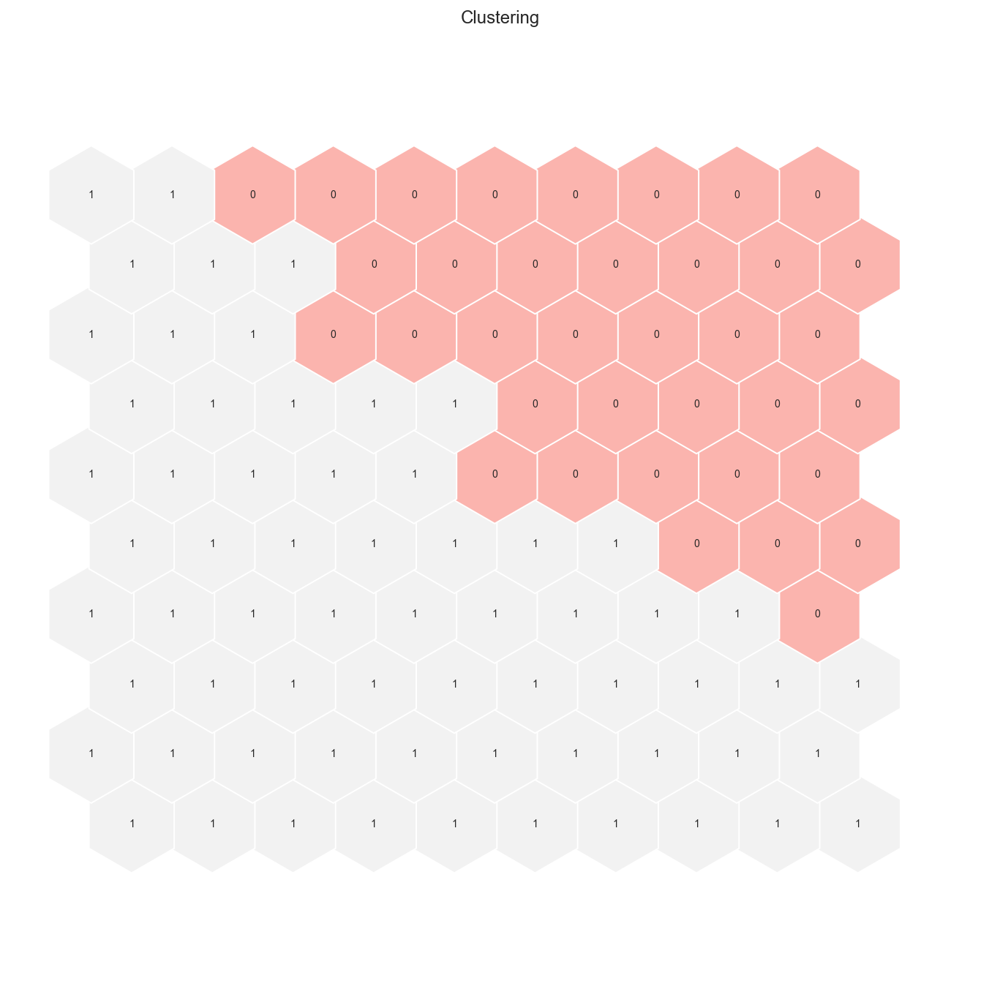

In [356]:
# K-means with k=2
kmeans = KMeans(n_clusters=2, init='k-means++', n_init=15, random_state=1)
kmsomMil_labels2 = som_Mil.cluster(kmeans)

hits  = HitMapView(12, 12,"Clustering", text_size=10)
hits.show(som_Mil, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

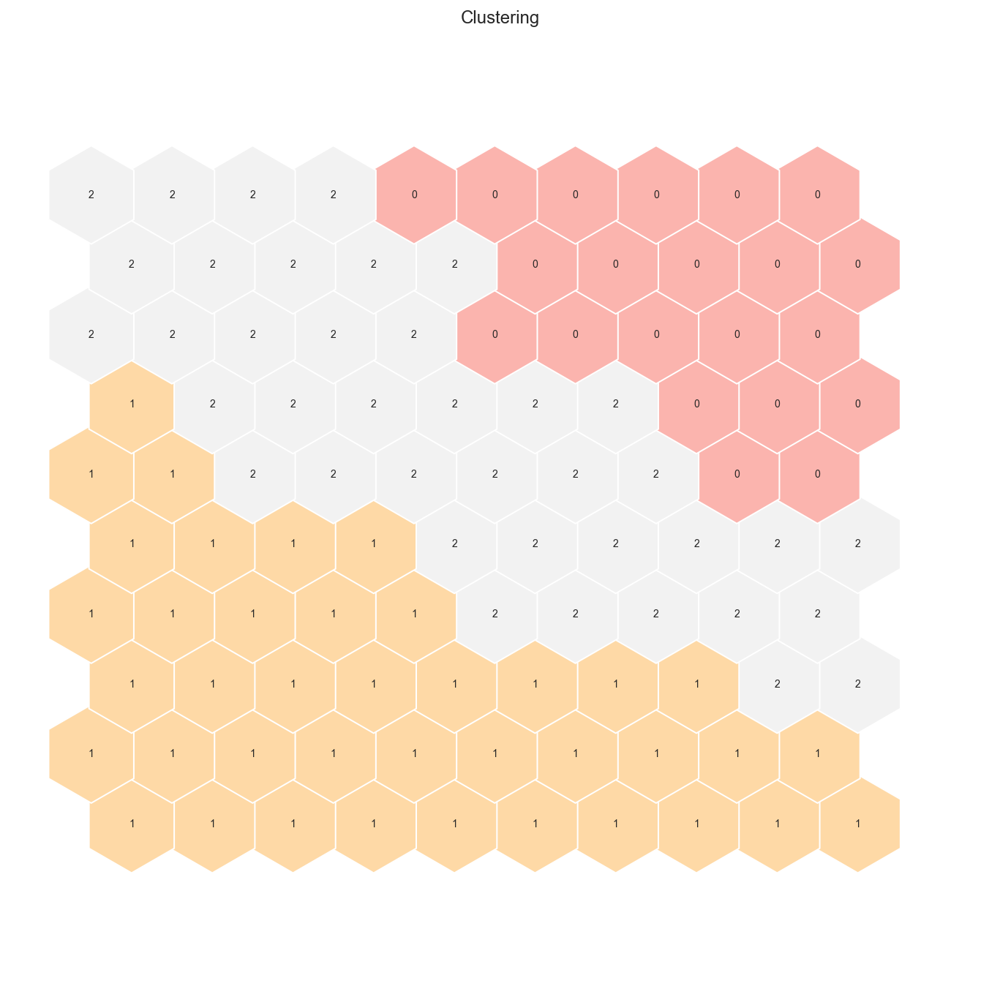

In [357]:
# K-means with k=3
kmeans = KMeans(n_clusters=3, init='k-means++', n_init=15, random_state=1)
kmsomMil_labels3 = som_Mil.cluster(kmeans)

hits  = HitMapView(12, 12,"Clustering", text_size=10)
hits.show(som_Mil, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

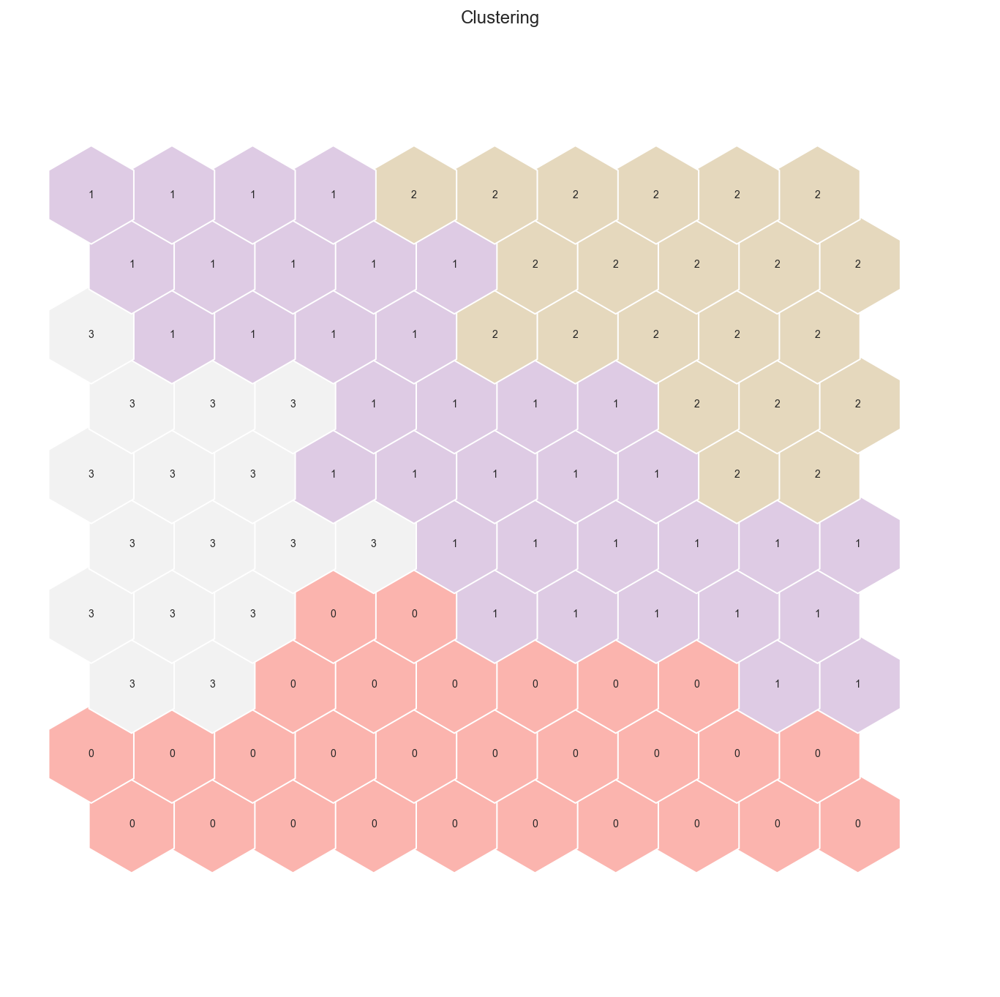

In [358]:
# K-means with k=4
kmeans = KMeans(n_clusters=4, init='k-means++', n_init=15, random_state=1)
kmsomMil_labels4 = som_Mil.cluster(kmeans)

hits  = HitMapView(12, 12,"Clustering", text_size=10)
hits.show(som_Mil, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

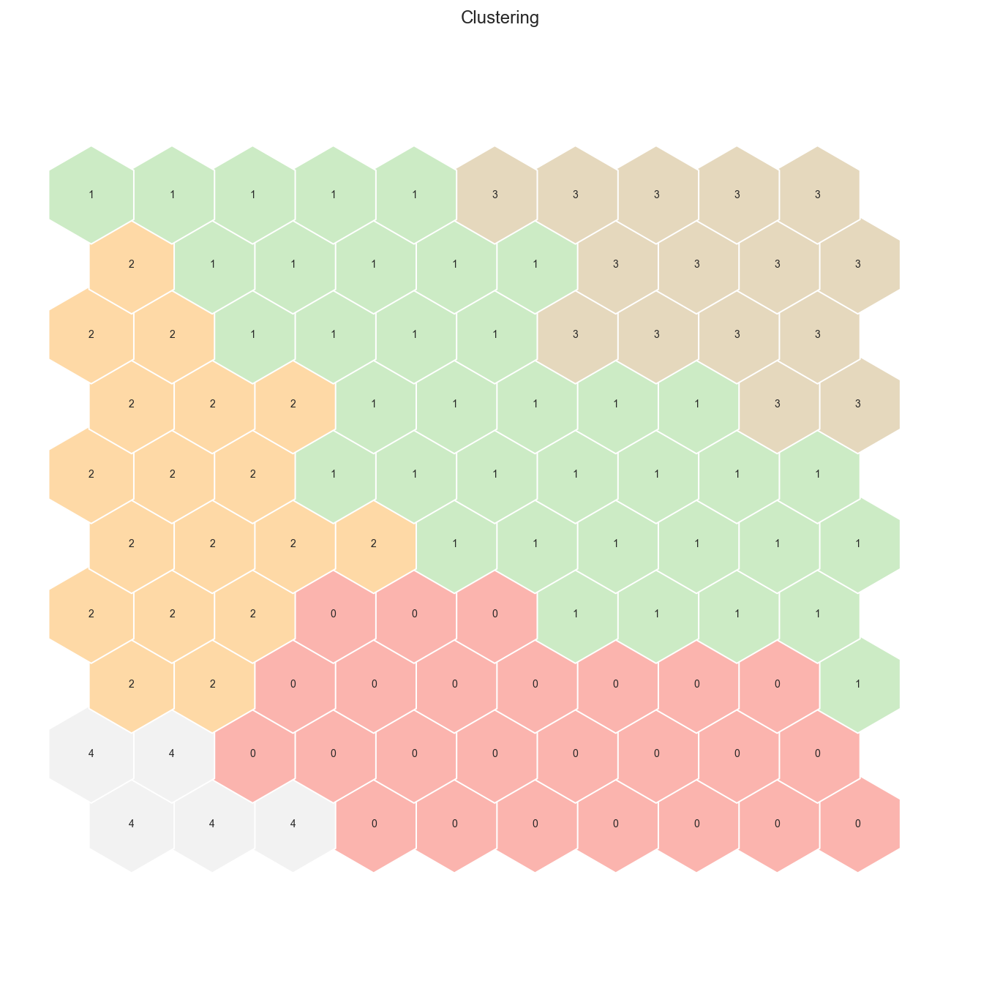

In [359]:
# K-means with k=5
kmeans = KMeans(n_clusters=5, init='k-means++', n_init=15, random_state=1)
kmsomMil_labels5 = som_Mil.cluster(kmeans)

hits  = HitMapView(12, 12,"Clustering", text_size=10)
hits.show(som_Mil, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

In [360]:
# Get the units input representation and their label from k-means
# Necessary to run lastly the solution (k=?) preferred, since those are the labels to be used here (kmsomMil_labels)
nodesMil = som_Mil.get_node_vectors()

Mil_kmsom = pd.DataFrame(nodesMil, columns=Military_view.columns)
Mil_kmsom['km_label'] = kmsomMil_labels2
Mil_kmsom

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4,km_label
0,13.752781,34.280256,38.851176,22.041202,4.323689,17.541762,23.508186,1
1,7.875246,33.748618,38.217337,22.695693,3.457488,16.352247,22.396664,1
2,3.941312,31.889966,36.562490,22.580141,2.871984,14.658356,23.583785,1
3,1.983158,29.912941,32.988713,23.448559,2.312889,13.265436,25.828132,1
4,1.170798,27.550221,29.878099,23.928050,1.608019,12.397064,27.922330,1
5,0.768444,24.317864,27.984021,22.793136,1.115803,11.171220,30.952749,1
6,0.575742,22.170698,28.794115,22.589697,0.921175,12.027891,25.441816,1
7,0.428135,19.230756,26.877600,21.278463,0.870052,13.711379,20.317157,1
8,0.316355,15.043738,22.634469,16.275122,0.953575,15.166449,16.075471,1
9,0.194182,9.198458,14.713580,9.127098,1.090023,16.284362,13.171580,1


In [361]:
# Obtaining SOM's BMUs labels
Mil_bmus_map = som_Mil.find_bmu(Military_view)[0]  # get bmus for each observation in df

Mil_bmus = pd.DataFrame(np.concatenate((Military_view, np.expand_dims(Mil_bmus_map,1)), axis=1),index=Military_view.index, columns=np.append(Military_view.columns,"BMU"))

In [362]:
# Get cluster labels for each observation
Mil_kmsom_final = Mil_bmus.merge(Mil_kmsom['km_label'], 'left', left_on="BMU", right_index=True)
Mil_kmsom_final

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4,BMU,km_label
0,0.0,39.0,34.0,18.0,0.0,23.0,16.0,70.0,0
1,0.0,15.0,55.0,11.0,0.0,10.0,0.0,49.0,1
2,0.0,20.0,29.0,33.0,0.0,23.0,8.0,90.0,0
3,0.0,23.0,14.0,31.0,0.0,40.0,16.0,90.0,0
4,1.0,28.0,9.0,53.0,4.0,16.0,20.0,90.0,0
...,...,...,...,...,...,...,...,...,...
93934,14.0,36.0,47.0,11.0,5.0,15.0,25.0,0.0,1
93935,0.0,31.0,43.0,19.0,8.0,5.0,15.0,10.0,1
93936,0.0,18.0,46.0,20.0,0.0,0.0,20.0,0.0,1
93937,0.0,28.0,35.0,20.0,1.0,18.0,8.0,70.0,0


In [363]:
# Characterizing the final clusters
Mil_kmsom_final.drop(columns='BMU').groupby('km_label').mean()

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4
km_label,,,,,,,
0,0.368678,33.311541,25.490794,41.259602,1.169984,18.401334,8.704494
1,2.444805,24.958381,38.753495,15.351802,1.542576,17.454504,16.983294


Cluster  0: less men active in the military, more veterans, wspecially in WWII<br>
Cluster 1: more men in active service and more recent veterans (less in WWII and more in Vietnam)

In [364]:
# Number of observations in each cluster
Mil_kmsom_final.km_label.value_counts()

0    63112
1    30827
Name: km_label, dtype: int64

In [365]:
print("BD index for this solution: ",davies_bouldin_score(Military_view, Mil_kmsom_final.km_label))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Military_view, Mil_kmsom_final.km_label))
print("Silhouette score for this solution: ",metrics.silhouette_score(Military_view, Mil_kmsom_final.km_label, metric='euclidean'))

BD index for this solution:  1.52637248690129
Calinski-Harabasz score for this solution:  30233.411441965098
Silhouette score for this solution:  0.2714183593054553


### 3.2. Personal view </font> <a class="anchor" id="persom"></a>

In [366]:
np.random.seed(1)

som_Per = sompy.SOMFactory().build(data = Personal_view_norm.values,    # The normalized dataset created before (in 1.2.)
                  mapsize = (10,10),
                  normalization = 'var',
                  initialization = 'random',
                  component_names = Personal_view.columns,
                  lattice='hexa',
                  training = 'seq')

som_Per.train(n_job = -1,
            verbose = 'info',
            train_rough_len = 30,
            train_finetune_len = 100)

 Training...
 random_initialization took: 0.002000 seconds
 Rough training...
 radius_ini: 4.000000 , radius_final: 1.000000, trainlen: 30

 epoch: 1 ---> elapsed time:  0.406000, quantization error: 5.580827

 epoch: 2 ---> elapsed time:  0.379000, quantization error: 2.529471

 epoch: 3 ---> elapsed time:  0.432000, quantization error: 2.464234

 epoch: 4 ---> elapsed time:  0.377000, quantization error: 2.436896

 epoch: 5 ---> elapsed time:  0.366000, quantization error: 2.425030

 epoch: 6 ---> elapsed time:  0.374000, quantization error: 2.410357

 epoch: 7 ---> elapsed time:  0.372000, quantization error: 2.397362

 epoch: 8 ---> elapsed time:  0.371000, quantization error: 2.381928

 epoch: 9 ---> elapsed time:  0.366000, quantization error: 2.360026

 epoch: 10 ---> elapsed time:  0.368000, quantization error: 2.336524

 epoch: 11 ---> elapsed time:  0.360000, quantization error: 2.315604

 epoch: 12 ---> elapsed time:  0.360000, quantization error: 2.295147

 epoch: 13 ---> e

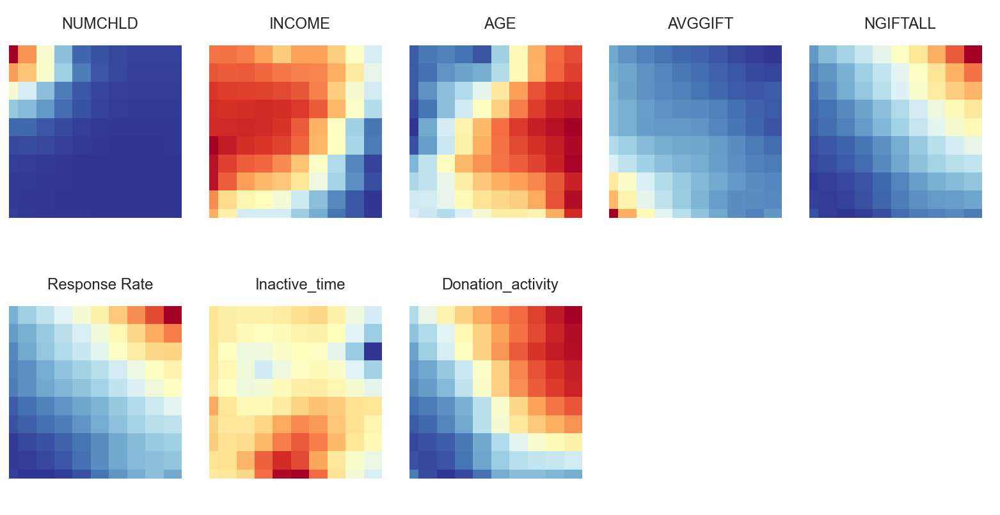

In [367]:
view2D = View2DPacked(50,50,"", text_size=8)
view2D.show(som_Per, col_sz=5, what = 'codebook')
plt.show()

Higher values of NUMCHLD on the top left corner<br>
NGIFTALL has higher values on the top right<br>
Higher values of AGGIFT on the bottom left (maybe outliers)<br>
Response Rate has higher values on the right side<br>
Inactive time has lower values only on the top right side, and higher values on the bottom<br>
Higher values of donation activity on the right side, which also occurs in AGE, although it doesn't look like local correlation

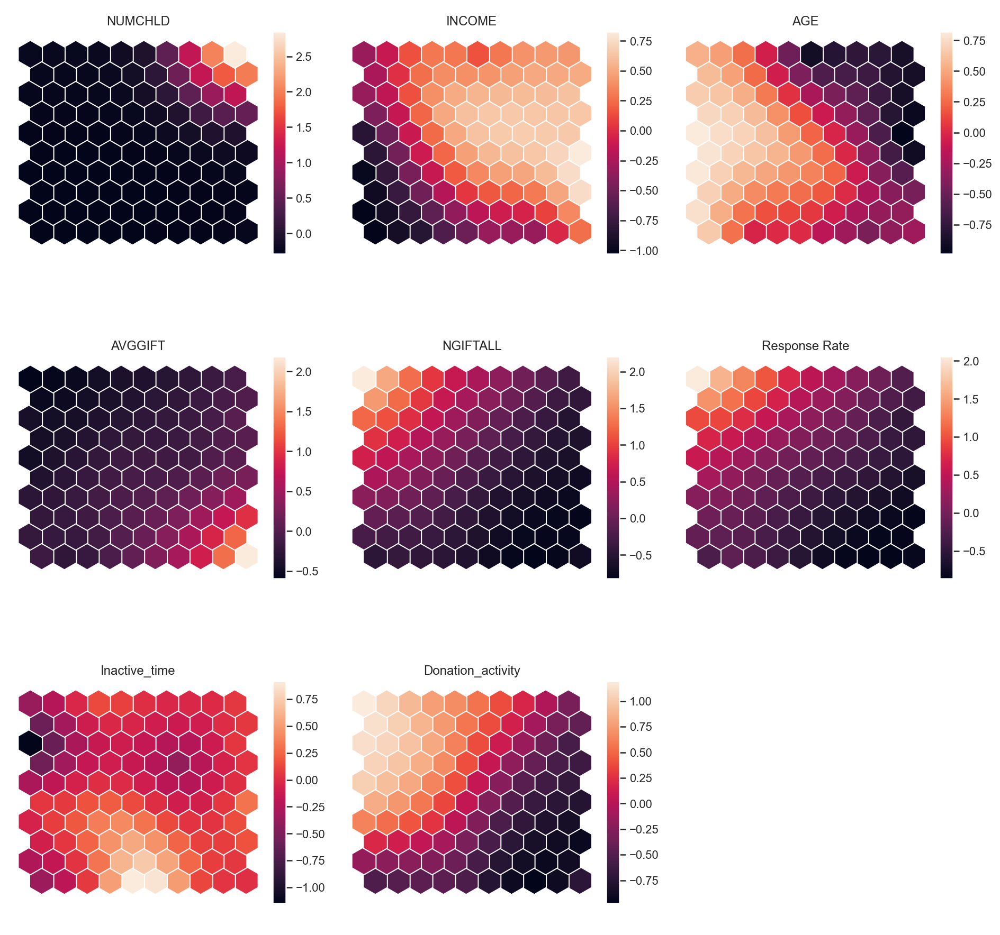

In [368]:
view2D = View2D(50,50,"", text_size=8)
view2D.show(som_Per, col_sz=3, what = 'codebook')
plt.show()

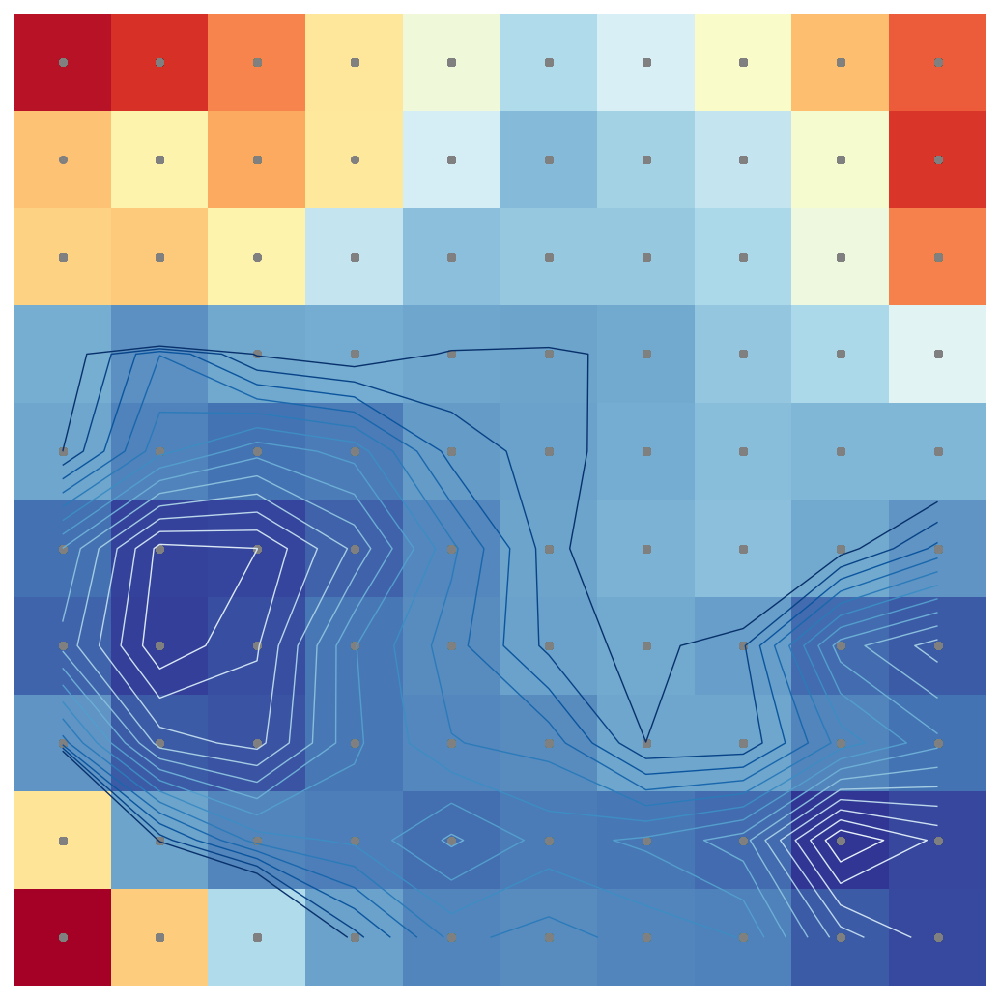

array([[0.60036414, 0.58118186, 0.54024039, 0.48146092, 0.44232391,
        0.39907943, 0.4227943 , 0.45286007, 0.5089182 , 0.55931263],
       [0.50718533, 0.46966648, 0.52201173, 0.47998413, 0.42094781,
        0.37488258, 0.39166216, 0.41092339, 0.44864181, 0.57818241],
       [0.49776161, 0.50275475, 0.46974661, 0.41132642, 0.37901473,
        0.38435038, 0.38471059, 0.39674204, 0.44034765, 0.54101414],
       [0.36616014, 0.3493602 , 0.36249493, 0.36555549, 0.36131905,
        0.36034587, 0.36434817, 0.38295564, 0.39690676, 0.42950574],
       [0.36198872, 0.34208069, 0.33382535, 0.33821495, 0.35530945,
        0.35959817, 0.36558019, 0.37779727, 0.37258792, 0.37245973],
       [0.33219637, 0.30968086, 0.31103036, 0.32478094, 0.34392516,
        0.35984834, 0.36965886, 0.37902735, 0.36433087, 0.35222978],
       [0.3266878 , 0.30772226, 0.31483342, 0.33625813, 0.34728972,
        0.35889414, 0.36397731, 0.35829803, 0.33009921, 0.32185003],
       [0.35114852, 0.32185995, 0.3179612

In [369]:
# U-matrix
u = sompy.umatrix.UMatrixView(50, 50, 'umatrix', show_axis=True, text_size=8, show_text=True)

UMAT = u.show(
    som_Per, 
    distance2=1, 
    row_normalized=False, 
    show_data=True, 
    contooor=True, # Visualize isomorphic curves
    blob=False
)

UMAT[1]

Again, clusters are not very evident, but possibly two clusters (or 3?)<br>
Possibly outliers on the bottom left side

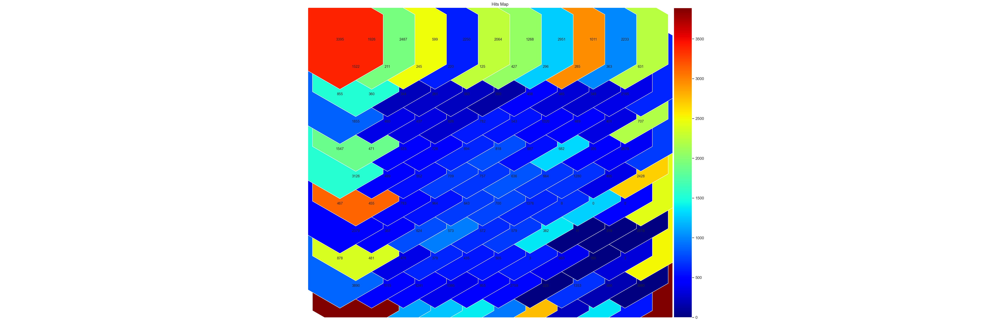

In [370]:
vhts = BmuHitsView(50,50,"Hits Map",text_size=7)
vhts.show(som_Per, anotate=True, onlyzeros=False, labelsize=10, logaritmic=False)

### 3.2.1. Applying k-means on top of SOM

In [371]:
som_Per.get_node_vectors().shape 

(100, 8)

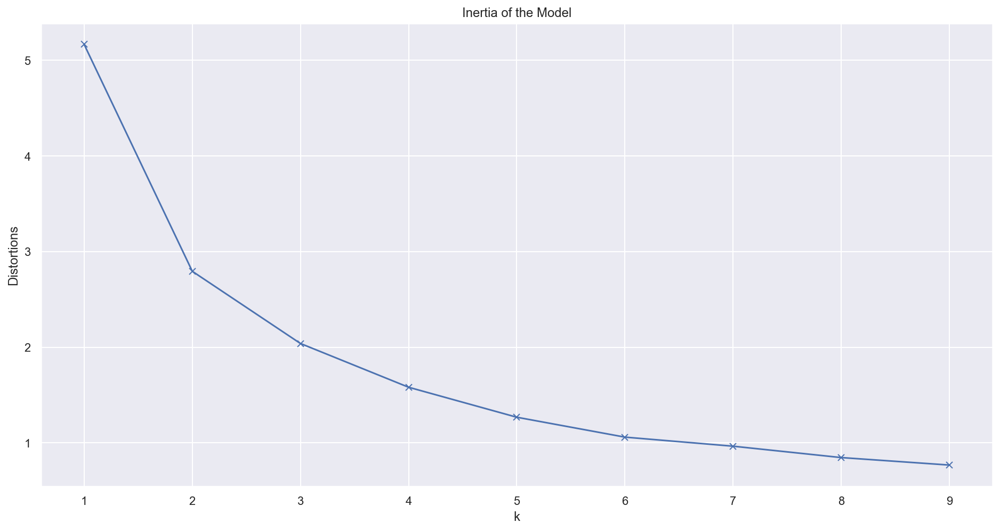

In [372]:
distortions = []
for k in range(1, 10):
    kmeanModel = KMeans(n_clusters=k).fit(som_Per.get_node_vectors())
    distortions.append(kmeanModel.inertia_)

plt.figure(figsize=(16,8))
plt.plot(range(1, 10), distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortions')
plt.title('Inertia of the Model')
plt.show()

From the scree plot it could be any number of k, from 2 to 6 (?)

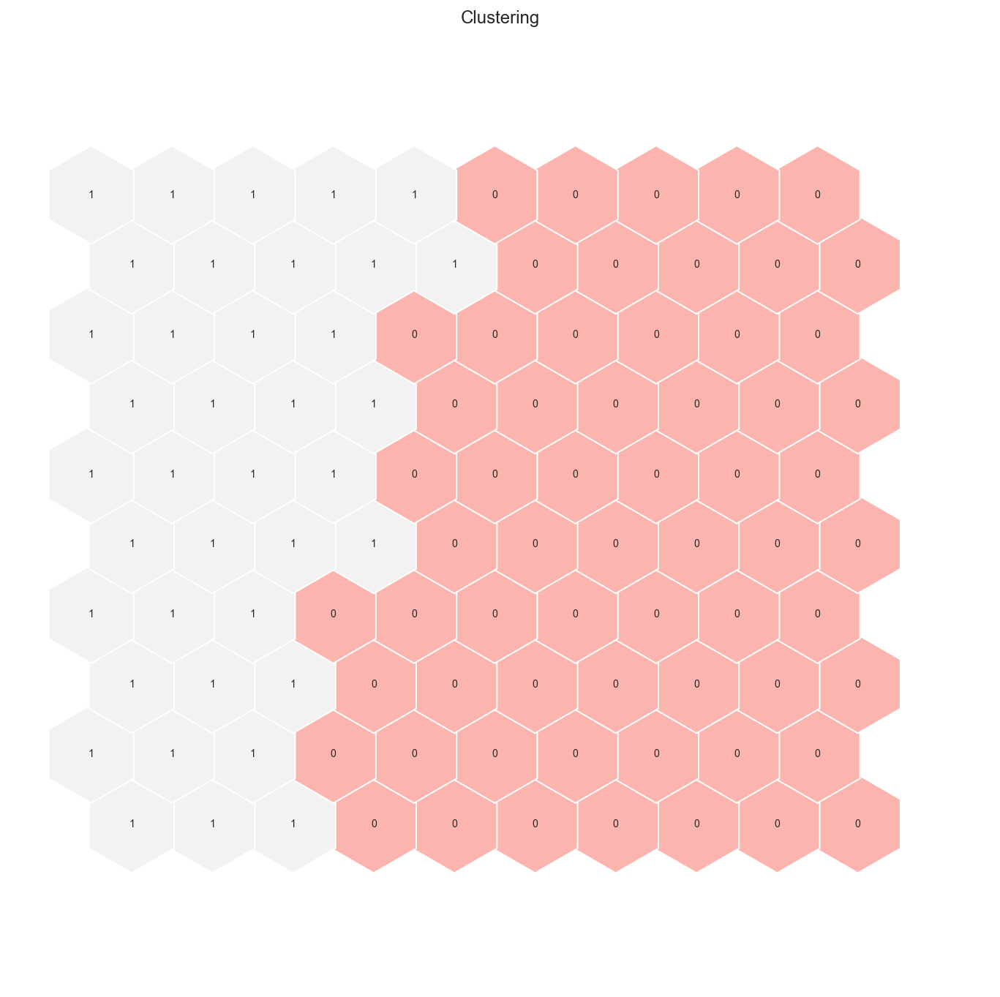

In [373]:
# K-means with k=2
kmeans = KMeans(n_clusters=2, init='k-means++', n_init=20, random_state=1)
kmsomPer_labels2 = som_Per.cluster(kmeans)

hits  = HitMapView(12, 12,"Clustering", text_size=10)
hits.show(som_Per, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

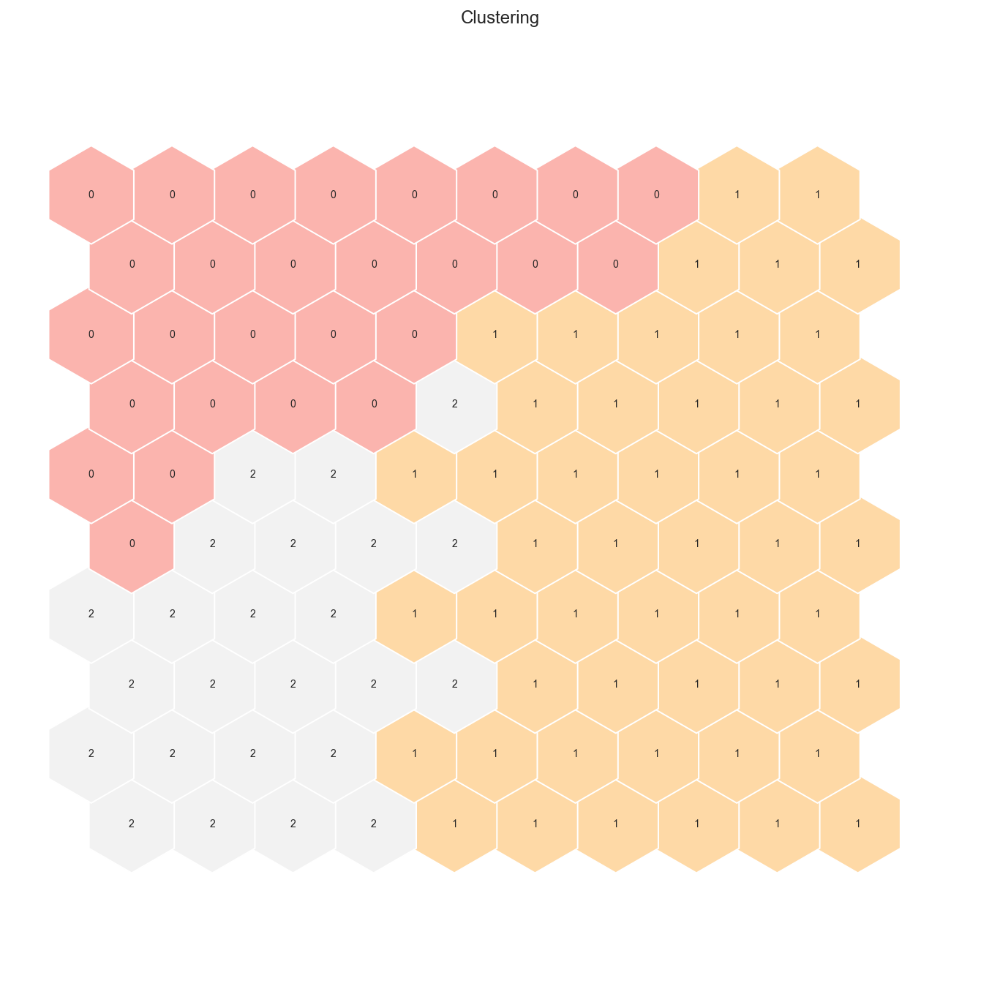

In [374]:
# K-means with k=3
kmeans = KMeans(n_clusters=3, init='k-means++', n_init=20, random_state=1)
kmsomPer_labels3 = som_Per.cluster(kmeans)

hits  = HitMapView(12, 12,"Clustering", text_size=10)
hits.show(som_Per, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

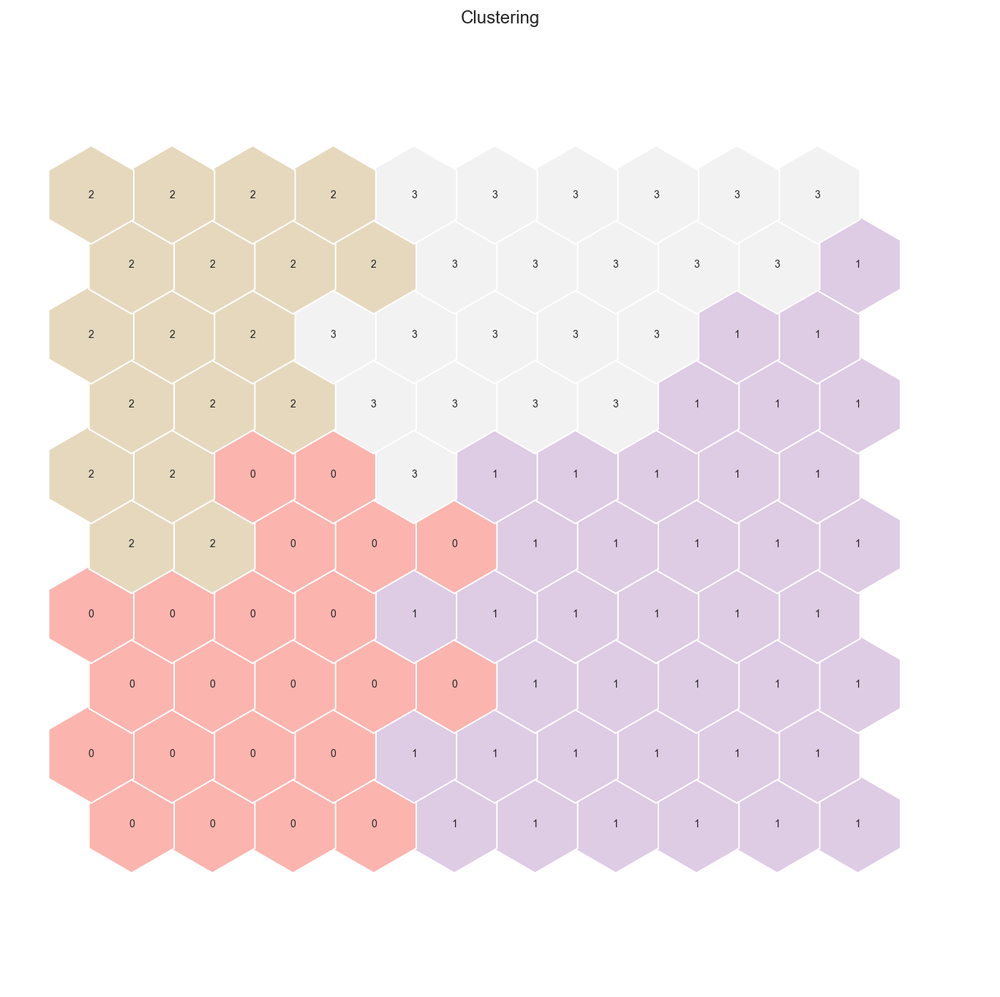

In [375]:
# K-means with k=4
kmeans = KMeans(n_clusters=4, init='k-means++', n_init=20, random_state=1)
kmsomPer_labels4 = som_Per.cluster(kmeans)

hits  = HitMapView(12, 12,"Clustering", text_size=10)
hits.show(som_Per, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

2 clusters

In [376]:
# Get the units input representation and their label from k-means
# Necessary to run lastly the solution (k=?) preferred, since those are the labels to be used here (kmsomMil_labels)
nodesPer = som_Per.get_node_vectors()

Per_kmsom = pd.DataFrame(nodesPer, columns=Personal_view.columns)
Per_kmsom['km_label'] = kmsomPer_labels2

In [377]:
# Obtaining SOM's BMUs labels
Per_bmus_map = som_Per.find_bmu(Personal_view_norm)[0]

Per_bmus = pd.DataFrame(np.concatenate((Personal_view, np.expand_dims(Per_bmus_map,1)), axis=1),index=Personal_view.index, columns=np.append(Personal_view.columns,"BMU"))

In [378]:
# Get cluster labels for each observation
Per_kmsom_final = Per_bmus.merge(Per_kmsom['km_label'], 'left', left_on="BMU", right_index=True)
Per_kmsom_final

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,BMU,km_label
0,0.0,3.25,64.0,7.741935,31.0,0.418919,548.0,2221.0,56.0,1
1,1.0,6.00,49.0,15.666667,3.0,0.093750,548.0,791.0,55.0,0
2,0.0,3.00,67.0,7.481481,27.0,0.428571,548.0,2160.0,56.0,1
3,0.0,1.00,73.0,6.812500,16.0,0.242424,548.0,3225.0,66.0,1
4,1.0,3.00,81.0,6.864865,37.0,0.327434,517.0,6150.0,46.0,1
...,...,...,...,...,...,...,...,...,...,...
93934,0.0,4.55,47.0,25.000000,1.0,0.071429,486.0,0.0,55.0,0
93935,1.0,7.00,51.0,20.000000,1.0,0.100000,457.0,0.0,55.0,0
93936,0.0,2.83,63.0,8.285714,7.0,0.212121,243.0,731.0,56.0,1
93937,0.0,7.00,61.0,12.146341,41.0,0.322835,151.0,3684.0,36.0,0


In [379]:
# Characterizing the final clusters with 2 clusters
Per_kmsom_final.drop(columns='BMU').groupby('km_label').mean()

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity
km_label,,,,,,,,
0,0.284349,4.810532,56.146687,15.498774,5.876869,0.139210,565.580598,905.124237
1,0.121391,3.040248,68.753402,11.187437,13.011513,0.216784,552.723972,2087.599893


Cluster 0: Higher income, younger, higher amounts donated, with a slightly lower response rate and have been donating for less time<br>
Cluster 1: Lower income, older (aroun 68 years old), less amount given on donations, slightly higher response rate and have been donating for longer

In [380]:
# Number of observations in each cluster
Per_kmsom_final.km_label.value_counts()

1    48727
0    45212
Name: km_label, dtype: int64

In [381]:
print("BD index for this solution: ",davies_bouldin_score(Personal_view_norm, Per_kmsom_final.km_label))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Personal_view_norm, Per_kmsom_final.km_label))
print("Silhouette score for this solution: ",metrics.silhouette_score(Personal_view_norm, Per_kmsom_final.km_label, metric='euclidean'))

BD index for this solution:  1.9451635652664743
Calinski-Harabasz score for this solution:  21749.801568688632
Silhouette score for this solution:  0.16756239114636878


### 3.3. Neigh view</font> <a class="anchor" id="neigsom"></a>

In [382]:
np.random.seed(1)

som_Neigh = sompy.SOMFactory().build(data = Neigh_view_norm.values,  # using the normalized dataset
                  mapsize = (10,10),
                  normalization = 'var',
                  initialization = 'random',
                  component_names = Neigh_view.columns,
                  lattice='hexa',
                  training = 'seq')

som_Neigh.train(n_job = -1,
            verbose = 'info',
            train_rough_len = 30,
            train_finetune_len = 100)

 Training...
 random_initialization took: 0.002000 seconds
 Rough training...
 radius_ini: 4.000000 , radius_final: 1.000000, trainlen: 30

 epoch: 1 ---> elapsed time:  0.429000, quantization error: 7.416817

 epoch: 2 ---> elapsed time:  0.407000, quantization error: 3.040689

 epoch: 3 ---> elapsed time:  0.412000, quantization error: 3.000313

 epoch: 4 ---> elapsed time:  0.411000, quantization error: 2.955328

 epoch: 5 ---> elapsed time:  0.402000, quantization error: 2.926302

 epoch: 6 ---> elapsed time:  0.405000, quantization error: 2.906936

 epoch: 7 ---> elapsed time:  0.404000, quantization error: 2.891835

 epoch: 8 ---> elapsed time:  0.403000, quantization error: 2.876463

 epoch: 9 ---> elapsed time:  0.414000, quantization error: 2.860285

 epoch: 10 ---> elapsed time:  0.409000, quantization error: 2.843053

 epoch: 11 ---> elapsed time:  0.405000, quantization error: 2.824682

 epoch: 12 ---> elapsed time:  0.402000, quantization error: 2.805172

 epoch: 13 ---> e

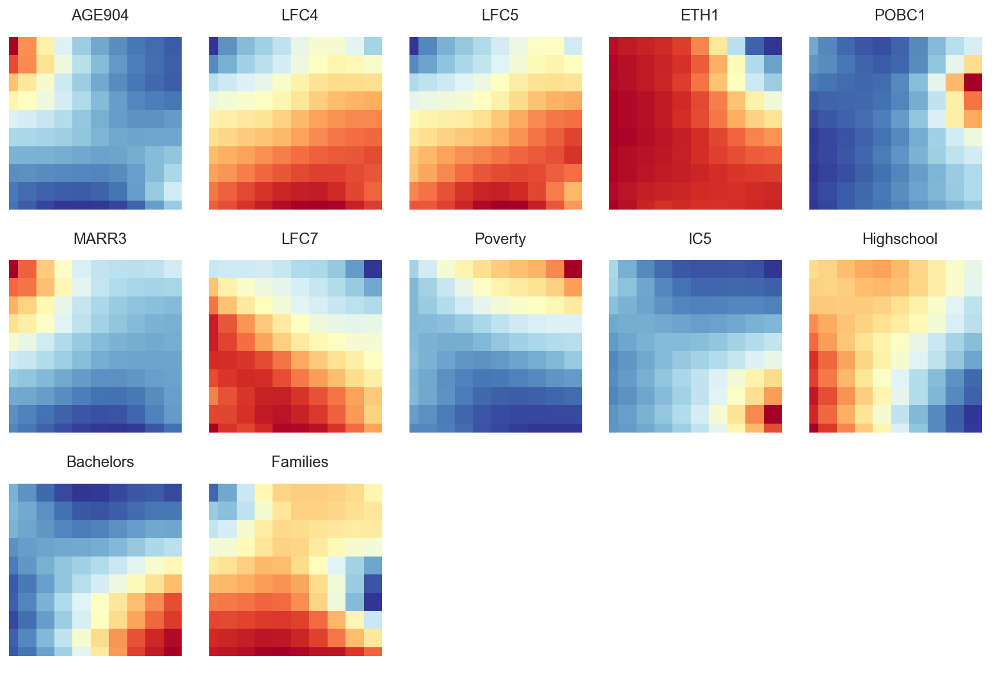

In [383]:
from sompy.visualization.mapview import View2DPacked
view2D = View2DPacked(50,50,"", text_size=8)
view2D.show(som_Neigh, col_sz=5, what = 'codebook')
plt.show()

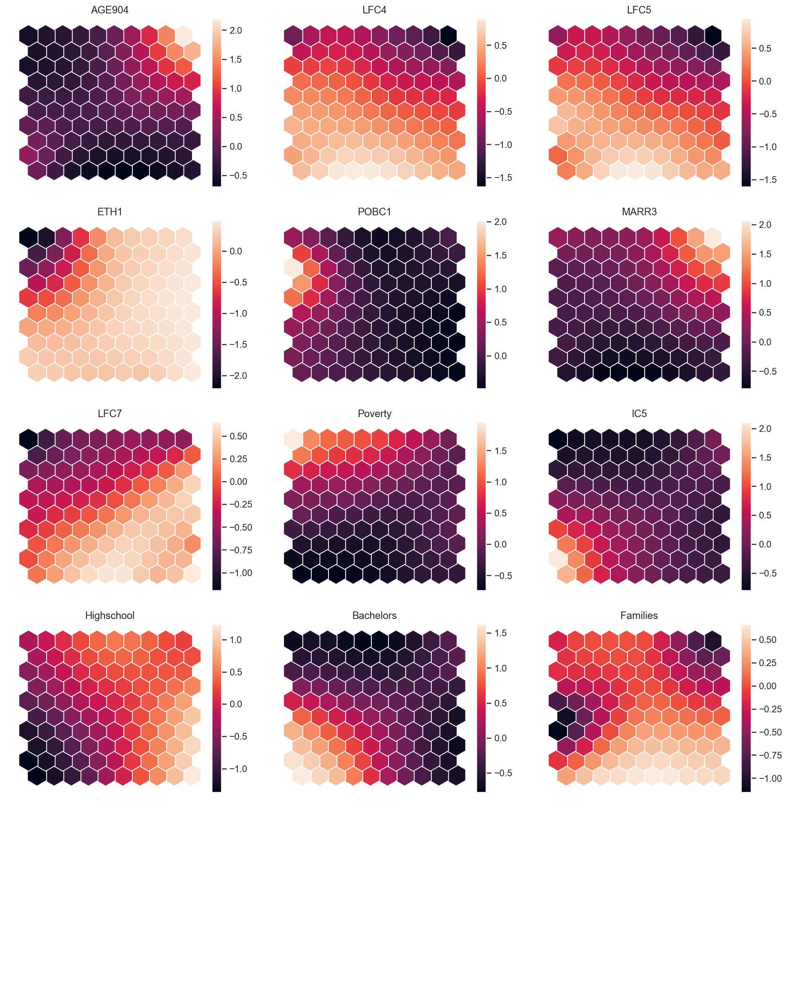

In [384]:
view2D = View2D(50,50,"", text_size=8)
view2D.show(som_Neigh, col_sz=3, what = 'codebook')
plt.show()

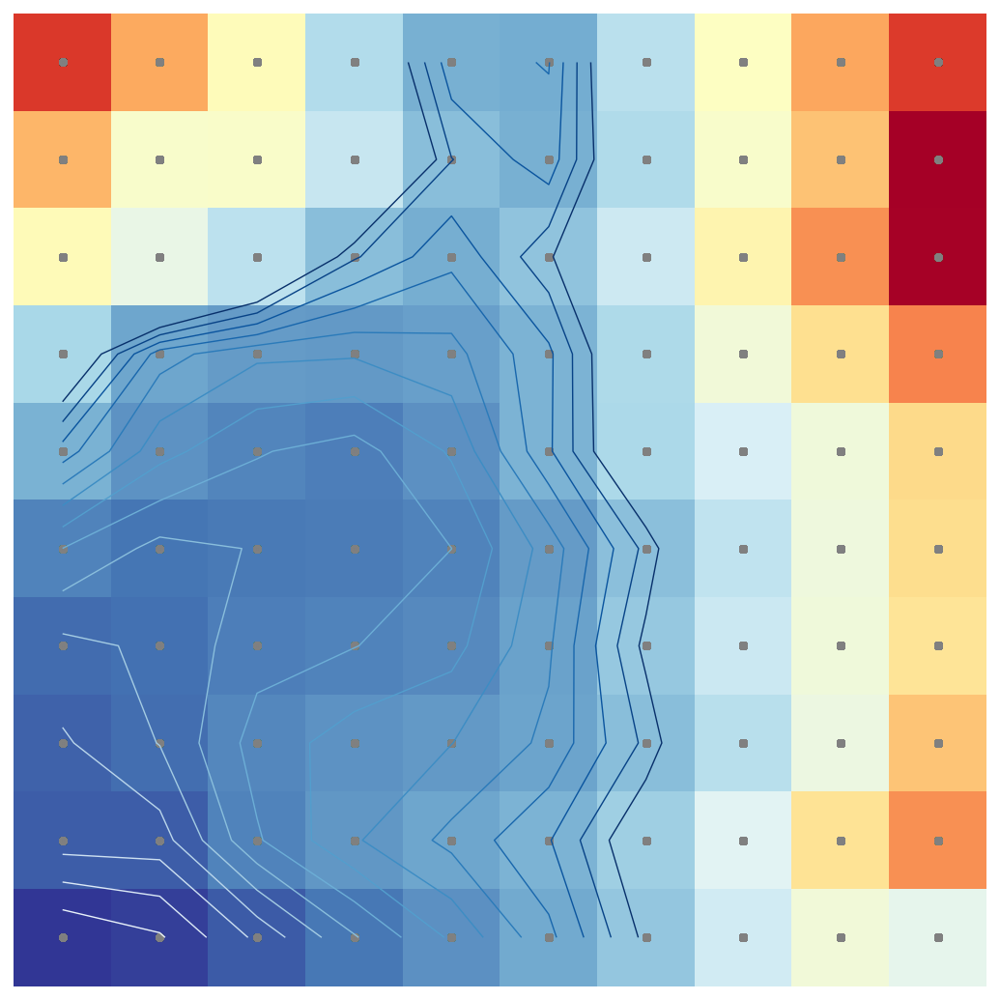

array([[0.74612512, 0.65319393, 0.55040332, 0.44875977, 0.39209386,
        0.38806693, 0.45580155, 0.54276858, 0.65369709, 0.74491716],
       [0.64042023, 0.53451816, 0.53584395, 0.46784179, 0.40807373,
        0.39248749, 0.44587076, 0.53338152, 0.62791153, 0.80688392],
       [0.55122861, 0.50826877, 0.4576102 , 0.40892006, 0.39103412,
        0.41461049, 0.47418947, 0.56150619, 0.6733535 , 0.80458358],
       [0.44006068, 0.38316771, 0.37140259, 0.37047773, 0.37578581,
        0.39603185, 0.44414699, 0.521833  , 0.59770197, 0.68408592],
       [0.3937098 , 0.3632877 , 0.35104674, 0.34627302, 0.36101848,
        0.39655499, 0.44151355, 0.48732142, 0.51978343, 0.60276052],
       [0.35022246, 0.33767989, 0.34125855, 0.34354135, 0.35023834,
        0.37320569, 0.4106171 , 0.46170289, 0.51727296, 0.59858905],
       [0.32842322, 0.33311625, 0.34645867, 0.34995492, 0.35649331,
        0.3774501 , 0.42044039, 0.4714309 , 0.51963991, 0.58835145],
       [0.32022573, 0.33150557, 0.3542886

In [385]:
# U-matrix
u = sompy.umatrix.UMatrixView(50, 50, 'umatrix', show_axis=True, text_size=8, show_text=True)

UMAT = u.show(
    som_Neigh, 
    distance2=1, 
    row_normalized=False, 
    show_data=True, 
    contooor=True, # Visualize isomorphic curves
    blob=False
)

UMAT[1]

Possibly three clusters, and on the bottom left side and top right, outliers.

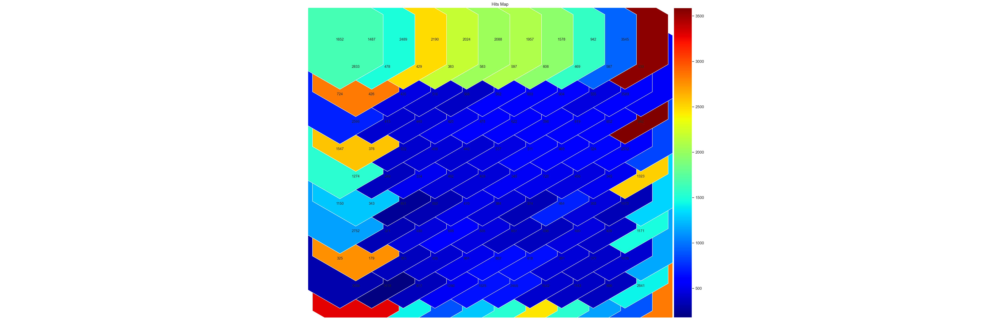

In [386]:
vhts = BmuHitsView(50,50,"Hits Map",text_size=7)
vhts.show(som_Neigh, anotate=True, onlyzeros=False, labelsize=10, logaritmic=False)

### 3.3.1. Applying k-means on top of SOM

In [387]:
som_Neigh.get_node_vectors().shape 

(100, 12)

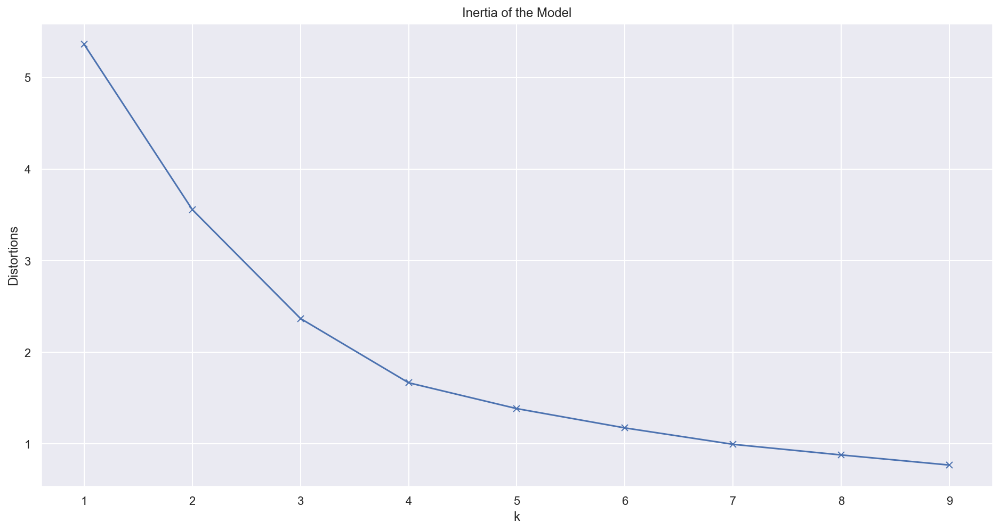

In [388]:
distortions = []
for k in range(1, 10):
    kmeanModel = KMeans(n_clusters=k).fit(som_Neigh.get_node_vectors())
    distortions.append(kmeanModel.inertia_)

plt.figure(figsize=(16,8))
plt.plot(range(1, 10), distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortions')
plt.title('Inertia of the Model')
plt.show()

From the scree plot it seems the optimal number is k=4

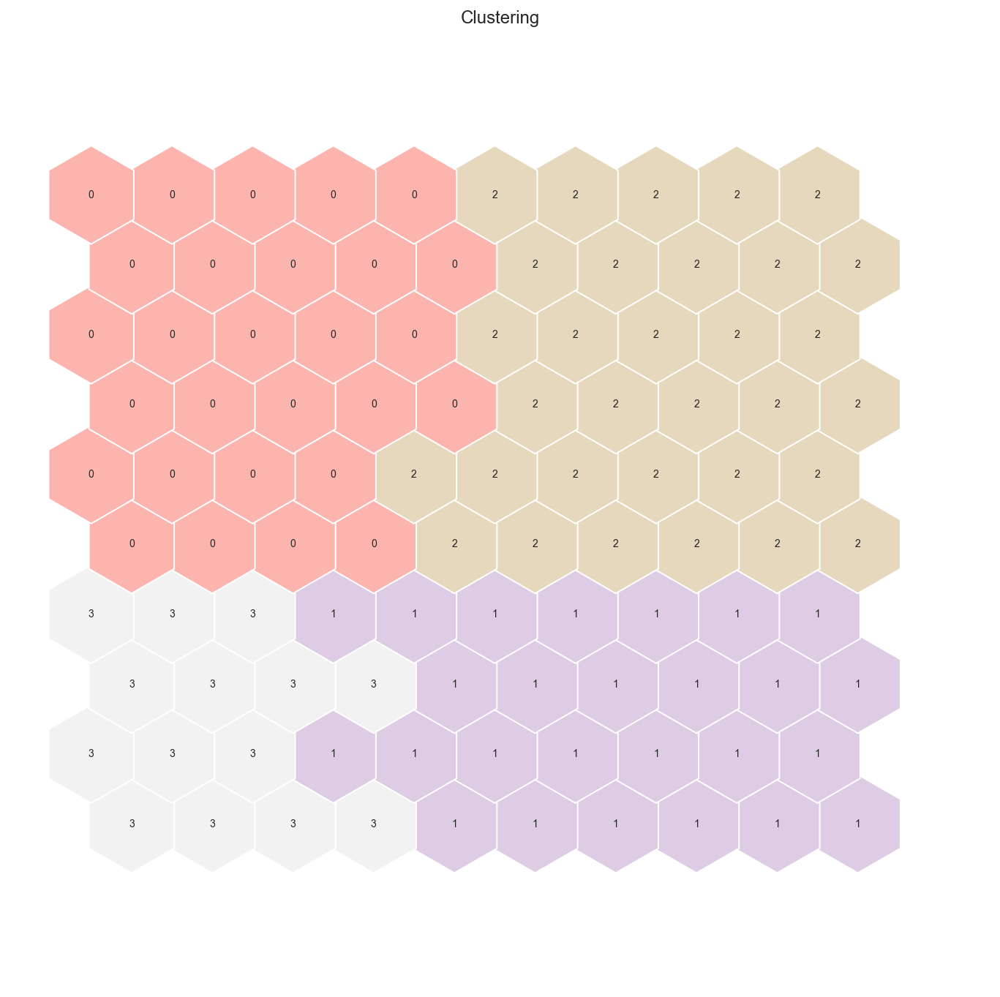

In [389]:
# K-means with k=4
kmeans = KMeans(n_clusters=4, init='k-means++', n_init=20, random_state=1)
kmsomPer_labels4 = som_Neigh.cluster(kmeans)

hits  = HitMapView(12, 12,"Clustering", text_size=10)
hits.show(som_Neigh, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

In [390]:
# Get the units input representation and their label from k-means
# Necessary to run lastly the solution (k=?) preferred, since those are the labels to be used here (kmsomMil_labels)
nodesNeigh = som_Neigh.get_node_vectors()

Neigh_kmsom = pd.DataFrame(nodesNeigh, columns=Neigh_view.columns)
Neigh_kmsom['km_label'] = kmsomPer_labels4

In [391]:
# Obtaining SOM's BMUs labels
Neigh_bmus_map = som_Neigh.find_bmu(Neigh_view_norm)[0]

Neigh_bmus = pd.DataFrame(np.concatenate((Neigh_view, np.expand_dims(Neigh_bmus_map,1)), axis=1),index=Neigh_view.index, columns=np.append(Neigh_view.columns,"BMU"))

In [392]:
# Get cluster labels for each observation
Neigh_kmsom_final = Neigh_bmus.merge(Neigh_kmsom['km_label'], 'left', left_on="BMU", right_index=True)
Neigh_kmsom_final

,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families,BMU,km_label
0,40.0,64.0,44.0,92.0,3.0,12.0,53.0,1.0,12883.0,39.0,4.0,80.0,63.0,2
1,32.0,81.0,57.0,67.0,42.0,3.0,57.0,3.0,36175.0,12.0,30.0,94.0,64.0,2
2,37.0,70.0,56.0,96.0,2.0,9.0,62.0,11.0,11576.0,28.0,5.0,76.0,63.0,2
3,34.0,68.0,45.0,61.0,29.0,6.0,31.0,20.0,15130.0,14.0,3.0,73.0,63.0,2
4,36.0,65.0,49.0,2.0,1.0,9.0,31.0,14.0,9836.0,30.0,12.0,82.0,63.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93934,29.0,83.0,69.0,78.0,4.0,3.0,57.0,6.0,18807.0,28.0,15.0,72.0,74.0,2
93935,28.0,87.0,52.0,91.0,2.0,2.0,43.0,7.0,26538.0,12.0,36.0,89.0,64.0,2
93936,30.0,70.0,69.0,82.0,6.0,5.0,24.0,26.0,12178.0,51.0,11.0,64.0,63.0,2
93937,36.0,85.0,57.0,92.0,14.0,8.0,54.0,3.0,15948.0,20.0,15.0,85.0,63.0,2


In [393]:
# Characterizing the final clusters
Neigh_kmsom_final.drop(columns='BMU').groupby('km_label').mean()

,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families
km_label,,,,,,,,,,,,
0,33.671533,86.673358,69.987226,86.211679,11.589416,3.135036,36.633212,6.348540,34830.567518,8.649635,41.572993,53.235401
1,55.666667,11.000000,9.000000,52.666667,1.888889,41.222222,1.111111,51.777778,7234.333333,31.444444,6.222222,20.444444
2,36.214251,70.390840,53.383408,85.578886,6.655690,7.496782,49.358392,10.843062,15745.452351,29.106703,14.031645,72.288496
3,39.000000,57.000000,51.000000,0.000000,99.000000,10.000000,0.000000,69.000000,4731.000000,0.000000,0.000000,64.000000


Cluster 0: younger population, more men and women employed, many white people, small percentage of widows, highest income per capita, many people with bachelors and half of the neighbourhood is families  <br>
<br>Cluster 1: older population (around 54 years old), less people employed (men and women), less than half of the neighbourhood is white, very few foreign born, highest percentage of widows, few households where both parents earn money, high poverty rate, lower income, only 28% are households with families and higher percentage of people with completed high school than with a bachelors<br>
<br>Cluster 2: High percentage of men and women employed, mostly white neighbourhoods, few foreign borns, highest percentage of households where both parents earn, high income, higher percentage with high school than bachelors, but not many, majority of the households are families <br>
<br>Cluster 3: Neighbourhoods completely characterized by non-white foreign born people with no households where both parents earn money, the highest percentage of povety level (nearly 70% of the households), lowest income and no education (high school completed or bachelors <br>

In [394]:
# Number of observations in each cluster ---> very unequal solution!
Neigh_kmsom_final.km_label.value_counts()

2    93381
0      548
1        9
3        1
Name: km_label, dtype: int64

In [395]:
print("BD index for this solution: ",davies_bouldin_score(Neigh_view_norm, Neigh_kmsom_final.km_label))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Neigh_view_norm, Neigh_kmsom_final.km_label))
print("Silhouette score for this solution: ",metrics.silhouette_score(Neigh_view_norm, Neigh_kmsom_final.km_label, metric='euclidean'))

BD index for this solution:  1.02034180569367
Calinski-Harabasz score for this solution:  369.29444679040665
Silhouette score for this solution:  0.3211975989135052


## 4. SOM + Hierarchical Clustering</font> <a class="anchor" id="somhc"></a>
[<font color='#E8800A'>4.1. Military View</font>](#milsomhc) <br>
[<font color='#E8800A'>4.2. Personal View</font>](#persomhc)<br>
[<font color='#E8800A'>4.3. Neighbourhood View</font>](#neigsomhc)<br>

  [Back to Segmentation](#Segmentation)

### 4.1. Military view</font> <a class="anchor" id="milsomhc"></a>

In [396]:
somMil_clusters=pd.DataFrame(som_Mil.get_node_vectors())

In [397]:
somMil_clusters.rename(columns={0:'MALEMILI',1:'MALEVET',2:'VIETVETS',3:'WWIIVETS',4:'AFC6',5:'VC2',6:'VC4'},inplace=True)

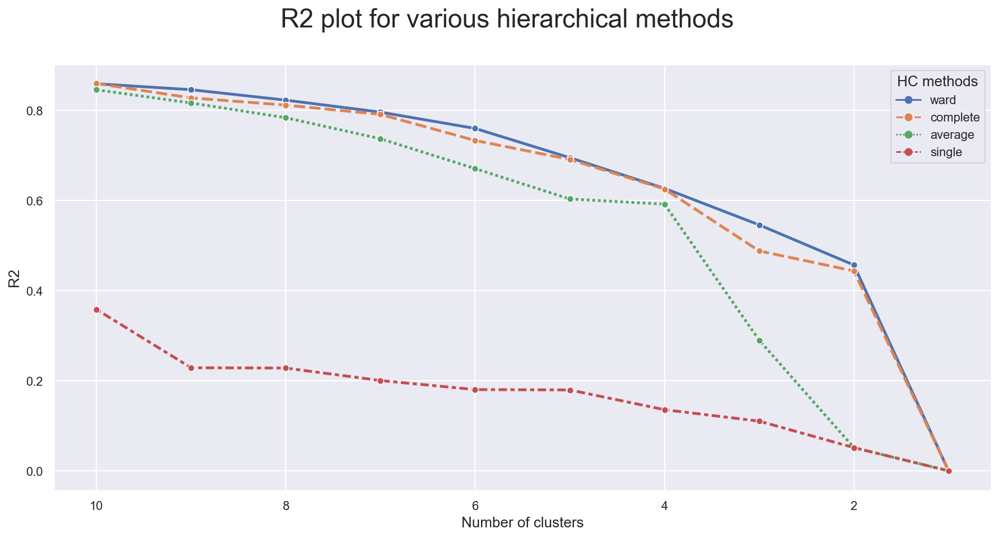

In [398]:
hier_methods = ["ward", "complete", "average", "single"]
# Function defined above to obtain the R2 statistic

r2_hier_methods = pd.DataFrame(data=np.concatenate([np.expand_dims(get_r2_hc(df=somMil_clusters, link_method=i, max_nclus=10), 1) for i in hier_methods], axis=1),
                             index=range(1,10+1), columns=hier_methods)

sns.set()
# Plot data
fig = plt.figure(figsize=(15,7))
sns.lineplot(data=r2_hier_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
fig.suptitle("R2 plot for various hierarchical methods", fontsize=23)
plt.gca().invert_xaxis()
plt.legend(title="HC methods", title_fontsize=13)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2", fontsize=13)

plt.show()

Ward is better

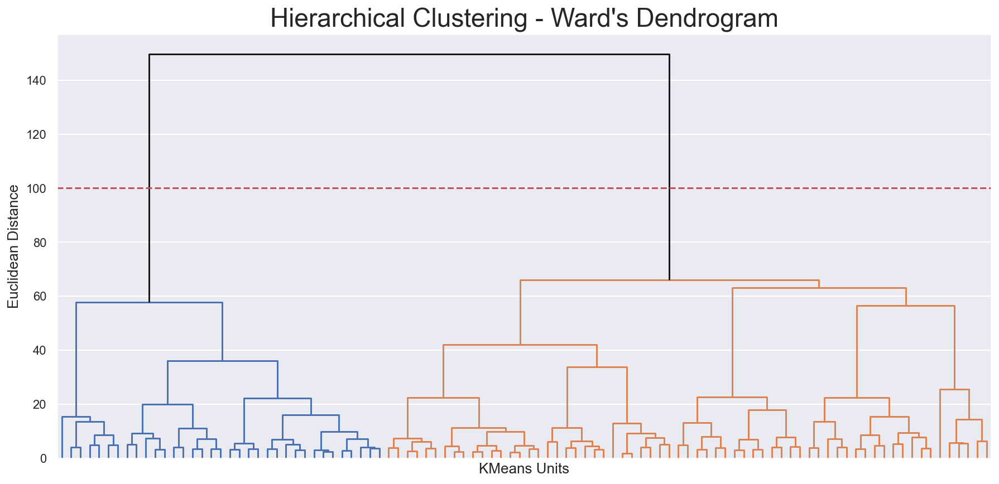

In [399]:
# Hierarchical clustering assessment using scipy
Z = linkage(somMil_clusters, method="ward")

sns.set()
fig = plt.figure(figsize=(15,7))

# Dendrogram
set_link_color_palette(list(sns.color_palette().as_hex()))
dendrogram(Z, color_threshold=100, orientation='top', no_labels=True, above_threshold_color='k')

plt.hlines(100, 0, 1000, colors="r", linestyles="dashed")
plt.title('Hierarchical Clustering - Ward\'s Dendrogram', fontsize=23)
plt.xlabel('KMeans Units', fontsize=13)
plt.ylabel('Euclidean Distance', fontsize=13)
plt.show()

2 clusters

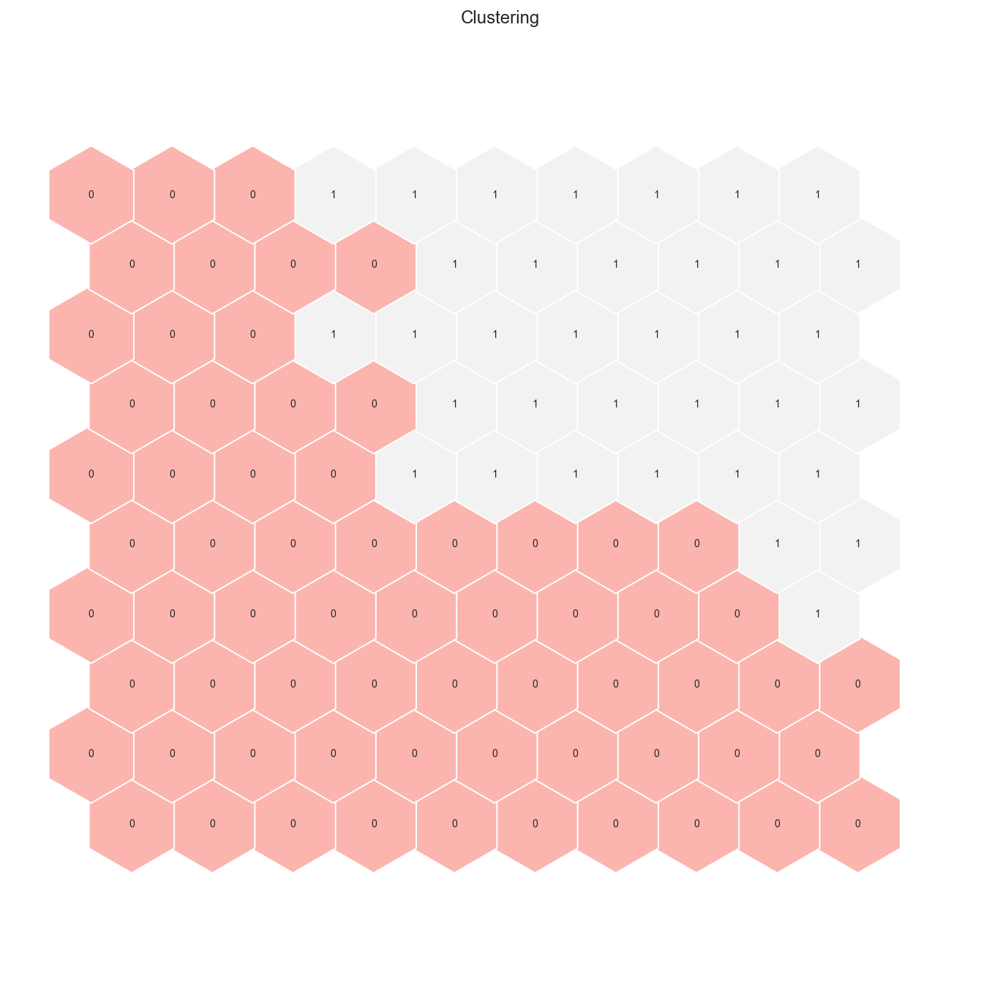

In [400]:
# Same but with 2 clusters
hierclust = AgglomerativeClustering(n_clusters=2, linkage='ward')
somhcMil_labels2 = som_Mil.cluster(hierclust)

hits  = HitMapView(12, 12,"Clustering",text_size=10)
hits.show(som_Mil, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

No misclassifications

In [401]:
# Get the units input representation and their label from HC

nodesMil = som_Mil.get_node_vectors()

Mil_nodes = pd.DataFrame(nodesMil, columns=Military_view.columns)
Mil_nodes['label'] = somhcMil_labels2
Mil_nodes

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4,label
0,13.752781,34.280256,38.851176,22.041202,4.323689,17.541762,23.508186,0
1,7.875246,33.748618,38.217337,22.695693,3.457488,16.352247,22.396664,0
2,3.941312,31.889966,36.562490,22.580141,2.871984,14.658356,23.583785,0
3,1.983158,29.912941,32.988713,23.448559,2.312889,13.265436,25.828132,0
4,1.170798,27.550221,29.878099,23.928050,1.608019,12.397064,27.922330,0
5,0.768444,24.317864,27.984021,22.793136,1.115803,11.171220,30.952749,0
6,0.575742,22.170698,28.794115,22.589697,0.921175,12.027891,25.441816,0
7,0.428135,19.230756,26.877600,21.278463,0.870052,13.711379,20.317157,0
8,0.316355,15.043738,22.634469,16.275122,0.953575,15.166449,16.075471,0
9,0.194182,9.198458,14.713580,9.127098,1.090023,16.284362,13.171580,0


In [402]:
# Obtaining SOM's BMUs labels
Mil_bmus_map = som_Mil.find_bmu(Military_view)[0]  # get bmus for each observation in df

Mil_bmus = pd.DataFrame(np.concatenate((Military_view, np.expand_dims(Mil_bmus_map,1)), axis=1),index=Military_view.index, columns=np.append(Military_view.columns,"BMU")
)
Mil_bmus

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4,BMU
0,0.0,39.0,34.0,18.0,0.0,23.0,16.0,70.0
1,0.0,15.0,55.0,11.0,0.0,10.0,0.0,49.0
2,0.0,20.0,29.0,33.0,0.0,23.0,8.0,90.0
3,0.0,23.0,14.0,31.0,0.0,40.0,16.0,90.0
4,1.0,28.0,9.0,53.0,4.0,16.0,20.0,90.0
...,...,...,...,...,...,...,...,...
93934,14.0,36.0,47.0,11.0,5.0,15.0,25.0,0.0
93935,0.0,31.0,43.0,19.0,8.0,5.0,15.0,10.0
93936,0.0,18.0,46.0,20.0,0.0,0.0,20.0,0.0
93937,0.0,28.0,35.0,20.0,1.0,18.0,8.0,70.0


In [403]:
# Get cluster labels for each observation
Mil_final = Mil_bmus.merge(Mil_nodes['label'], 'left', left_on="BMU", right_index=True)
Mil_final

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4,BMU,label
0,0.0,39.0,34.0,18.0,0.0,23.0,16.0,70.0,1
1,0.0,15.0,55.0,11.0,0.0,10.0,0.0,49.0,0
2,0.0,20.0,29.0,33.0,0.0,23.0,8.0,90.0,1
3,0.0,23.0,14.0,31.0,0.0,40.0,16.0,90.0,1
4,1.0,28.0,9.0,53.0,4.0,16.0,20.0,90.0,1
...,...,...,...,...,...,...,...,...,...
93934,14.0,36.0,47.0,11.0,5.0,15.0,25.0,0.0,0
93935,0.0,31.0,43.0,19.0,8.0,5.0,15.0,10.0,0
93936,0.0,18.0,46.0,20.0,0.0,0.0,20.0,0.0,0
93937,0.0,28.0,35.0,20.0,1.0,18.0,8.0,70.0,1


In [404]:
# Characterizing the final clusters
Mil_final.drop(columns='BMU').groupby('label').mean()

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4
label,,,,,,,
0,2.444805,24.958381,38.753495,15.351802,1.542576,17.454504,16.983294
1,0.368678,33.311541,25.490794,41.259602,1.169984,18.401334,8.704494


Cluster 1: More men in military service, more recent veterans (also more from viet)<br>
Cluster 0: more male veterans, less from viet, more from wwii, less active militars<br>

In [405]:
# Number of observations in each cluster
Mil_final.label.value_counts()

1    63112
0    30827
Name: label, dtype: int64

In [406]:
print("BD index for this solution: ",davies_bouldin_score(Military_view, Mil_final.label))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Military_view, Mil_final.label))
print("Silhouette score for this solution: ",metrics.silhouette_score(Military_view, Mil_final.label, metric='euclidean'))

BD index for this solution:  1.52637248690129
Calinski-Harabasz score for this solution:  30233.411441965098
Silhouette score for this solution:  0.2714183593054553


### 4.2. Personal view</font> <a class="anchor" id="persomhc"></a>

In [407]:
somPer_clusters=pd.DataFrame(som_Per.get_node_vectors())

In [408]:
somPer_clusters.rename(columns={0:'NUMCHLD',1:'INCOME',2:'AGE',3:'AVGGIFT',4:'NUMPRM12',5:'Response Rate',6:'Inactive_time',7:'Donation_activity'},inplace=True)

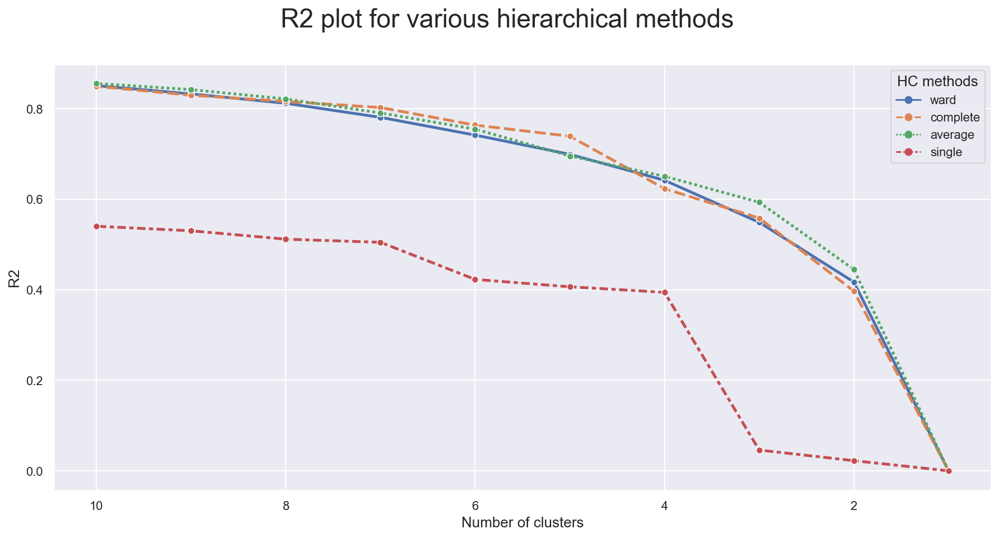

In [409]:
hier_methods = ["ward", "complete", "average", "single"]
# Function defined above to obtain the R2 statistic

r2_hier_methods = pd.DataFrame(data=np.concatenate([np.expand_dims(get_r2_hc(df=somPer_clusters, link_method=i, max_nclus=10), 1) for i in hier_methods], axis=1),
                             index=range(1,10+1), columns=hier_methods)

sns.set()
# Plot data
fig = plt.figure(figsize=(15,7))
sns.lineplot(data=r2_hier_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
fig.suptitle("R2 plot for various hierarchical methods", fontsize=23)
plt.gca().invert_xaxis()
plt.legend(title="HC methods", title_fontsize=13)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2", fontsize=13)

plt.show()

Ward is better

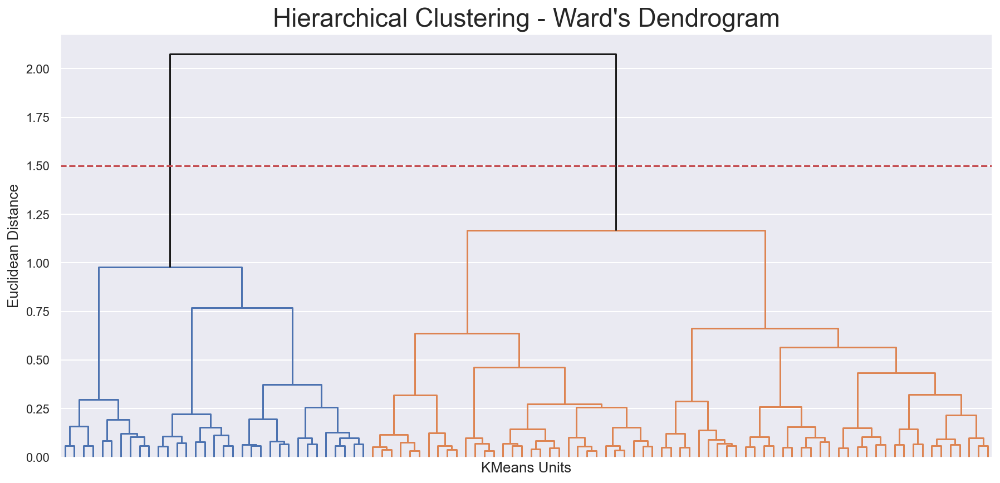

In [410]:
# Hierarchical clustering assessment using scipy
Z = linkage(somPer_clusters, method="ward")

sns.set()
fig = plt.figure(figsize=(15,7))

# Dendrogram
set_link_color_palette(list(sns.color_palette().as_hex()))
dendrogram(Z, color_threshold=1.5, orientation='top', no_labels=True, above_threshold_color='k')

plt.hlines(1.5, 0, 1000, colors="r", linestyles="dashed")
plt.title('Hierarchical Clustering - Ward\'s Dendrogram', fontsize=23)
plt.xlabel('KMeans Units', fontsize=13)
plt.ylabel('Euclidean Distance', fontsize=13)
plt.show()

2 clusters

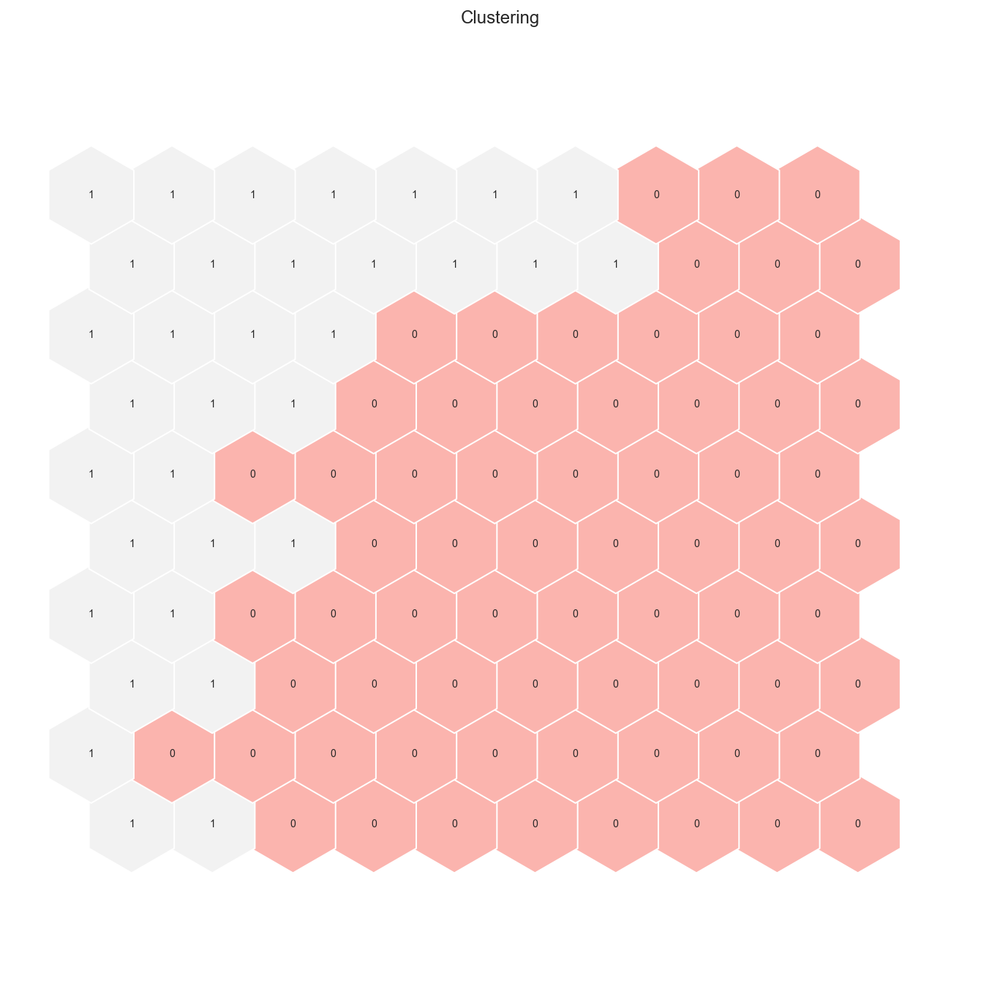

In [411]:
# Perform Hierarchical clustering on top of the 100 units, with 2 clusters
hierclust = AgglomerativeClustering(n_clusters=2, linkage='ward')
somhcPer_labels2= som_Per.cluster(hierclust)

hits  = HitMapView(12, 12,"Clustering",text_size=10)
hits.show(som_Per, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

In [412]:
# Get the units input representation and their label from HC
nodesPer = som_Per.get_node_vectors()

Per_nodes = pd.DataFrame(nodesPer, columns=Personal_view.columns)
Per_nodes['label'] = somhcPer_labels2
Per_nodes

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,label
0,0.269476,0.608350,0.421464,0.035995,0.062153,0.085865,0.634886,0.135495,0
1,0.200837,0.609685,0.439632,0.033077,0.081249,0.099018,0.622724,0.171096,0
2,0.130522,0.600911,0.444435,0.030805,0.096692,0.110094,0.620565,0.202330,0
3,0.068884,0.570287,0.434823,0.029270,0.114511,0.122325,0.618698,0.227864,0
4,0.025612,0.526822,0.415694,0.027858,0.131902,0.134540,0.626814,0.250424,0
5,0.015648,0.570897,0.502654,0.026811,0.151432,0.148656,0.640821,0.267222,0
6,0.011533,0.569918,0.591147,0.025301,0.175696,0.168218,0.646574,0.279181,0
7,0.010131,0.524674,0.657202,0.023735,0.206436,0.187636,0.619864,0.298454,0
8,0.009544,0.447872,0.697583,0.022537,0.243984,0.207569,0.585563,0.320144,1
9,0.009847,0.390327,0.714727,0.021502,0.290650,0.235717,0.561964,0.336155,1


In [413]:
# Obtaining SOM's BMUs labels and concat them to the true values of Personal_view, not the normalized ones

Per_bmus_map = som_Per.find_bmu(Personal_view_norm)[0]  # get bmus for each observation in df

Per_bmus = pd.DataFrame(
    np.concatenate((Personal_view, np.expand_dims(Per_bmus_map,1)), axis=1),
    index=Personal_view.index, columns=np.append(Personal_view.columns,"BMU"))

Per_bmus

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,BMU
0,0.0,3.25,64.0,7.741935,31.0,0.418919,548.0,2221.0,56.0
1,1.0,6.00,49.0,15.666667,3.0,0.093750,548.0,791.0,55.0
2,0.0,3.00,67.0,7.481481,27.0,0.428571,548.0,2160.0,56.0
3,0.0,1.00,73.0,6.812500,16.0,0.242424,548.0,3225.0,66.0
4,1.0,3.00,81.0,6.864865,37.0,0.327434,517.0,6150.0,46.0
...,...,...,...,...,...,...,...,...,...
93934,0.0,4.55,47.0,25.000000,1.0,0.071429,486.0,0.0,55.0
93935,1.0,7.00,51.0,20.000000,1.0,0.100000,457.0,0.0,55.0
93936,0.0,2.83,63.0,8.285714,7.0,0.212121,243.0,731.0,56.0
93937,0.0,7.00,61.0,12.146341,41.0,0.322835,151.0,3684.0,36.0


In [414]:
# Get cluster labels for each observation
Per_final = Per_bmus.merge(Per_nodes['label'], 'left', left_on="BMU", right_index=True)
Per_final

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,BMU,label
0,0.0,3.25,64.0,7.741935,31.0,0.418919,548.0,2221.0,56.0,0
1,1.0,6.00,49.0,15.666667,3.0,0.093750,548.0,791.0,55.0,0
2,0.0,3.00,67.0,7.481481,27.0,0.428571,548.0,2160.0,56.0,0
3,0.0,1.00,73.0,6.812500,16.0,0.242424,548.0,3225.0,66.0,0
4,1.0,3.00,81.0,6.864865,37.0,0.327434,517.0,6150.0,46.0,0
...,...,...,...,...,...,...,...,...,...,...
93934,0.0,4.55,47.0,25.000000,1.0,0.071429,486.0,0.0,55.0,0
93935,1.0,7.00,51.0,20.000000,1.0,0.100000,457.0,0.0,55.0,0
93936,0.0,2.83,63.0,8.285714,7.0,0.212121,243.0,731.0,56.0,0
93937,0.0,7.00,61.0,12.146341,41.0,0.322835,151.0,3684.0,36.0,0


In [415]:
# Characterizing the final clusters
Per_final.drop(columns='BMU').groupby('label').mean()

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity
label,,,,,,,,
0,0.199785,3.894355,62.706299,13.260479,9.578304,0.179477,558.900704,1519.135228
1,0.250000,1.014706,34.529412,15.976222,8.705882,0.139952,574.161765,620.794118


Cluster 1: higher income, slightly younger, donated less times but with a higher amount on average.<br>
Cluster 0:(opposite) less income, older (67y.o), less amounts donated per gift but more donations, higher response rate and have been donating for longer<br>

In [416]:
# Number of observations in each cluster
Per_final.label.value_counts()

0    93871
1       68
Name: label, dtype: int64

In [417]:
print("BD index for this solution: ",davies_bouldin_score(Personal_view_norm, Per_final.label))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Personal_view_norm, Per_final.label))
print("Silhouette score for this solution: ",metrics.silhouette_score(Personal_view_norm, Per_final.label, metric='euclidean'))

BD index for this solution:  1.1830682148872171
Calinski-Harabasz score for this solution:  139.60863419053206
Silhouette score for this solution:  0.2967138529988664


### 4.3. Neigh view</font> <a class="anchor" id="neigsomhc"></a>

In [418]:
somNeigh_clusters=pd.DataFrame(som_Neigh.get_node_vectors())

In [419]:
somNeigh_clusters.rename(columns={0:'AGE904',1:'LFC4',2:'LFC5',3:'ETH1',4:'POBC1',5:'MARR3',6:'LFC7',7:'Poverty',8:'IC5',9:'Highschool',10:'Bachelors',11:'Families'},inplace=True)

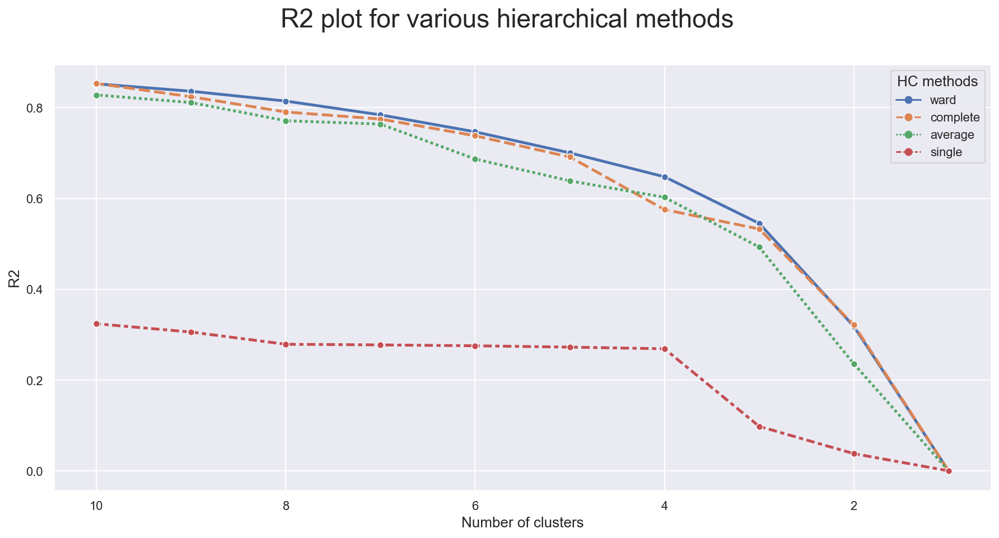

In [420]:
hier_methods = ["ward", "complete", "average", "single"]
# Function defined above to obtain the R2 statistic

r2_hier_methods = pd.DataFrame(data=np.concatenate([np.expand_dims(get_r2_hc(df=somNeigh_clusters, link_method=i, max_nclus=10), 1) for i in hier_methods], axis=1),
                             index=range(1,10+1), columns=hier_methods)

sns.set()
# Plot data
fig = plt.figure(figsize=(15,7))
sns.lineplot(data=r2_hier_methods, linewidth=2.5, markers=["o"]*4)

# Finalize the plot
fig.suptitle("R2 plot for various hierarchical methods", fontsize=23)
plt.gca().invert_xaxis()
plt.legend(title="HC methods", title_fontsize=13)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R2", fontsize=13)

plt.show()

Ward is better

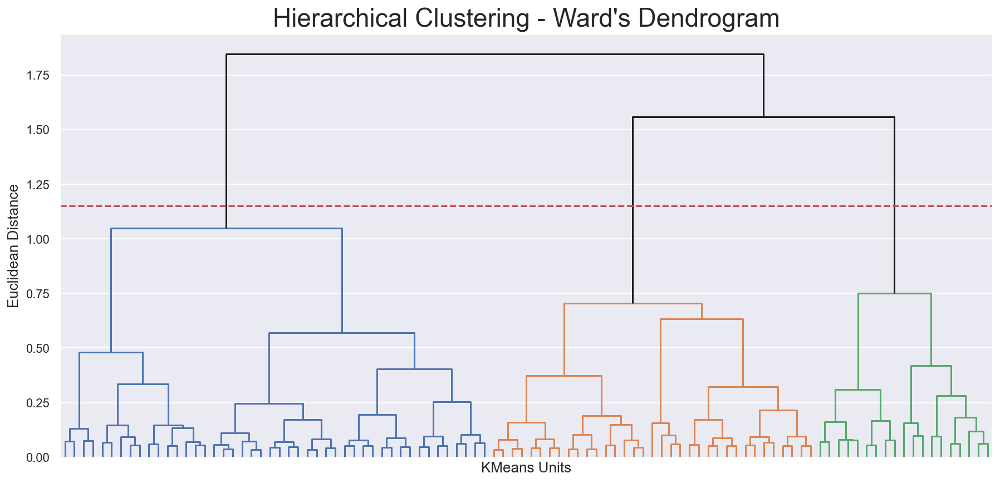

In [421]:
# Hierarchical clustering assessment using scipy
Z = linkage(somNeigh_clusters, method="ward")

sns.set()
fig = plt.figure(figsize=(15,7))

# Dendrogram
set_link_color_palette(list(sns.color_palette().as_hex()))
dendrogram(Z, color_threshold=1.15, orientation='top', no_labels=True, above_threshold_color='k')

plt.hlines(1.15, 0, 1000, colors="r", linestyles="dashed")
plt.title('Hierarchical Clustering - Ward\'s Dendrogram', fontsize=23)
plt.xlabel('KMeans Units', fontsize=13)
plt.ylabel('Euclidean Distance', fontsize=13)
plt.show()

3 clusters based on the dendrogram

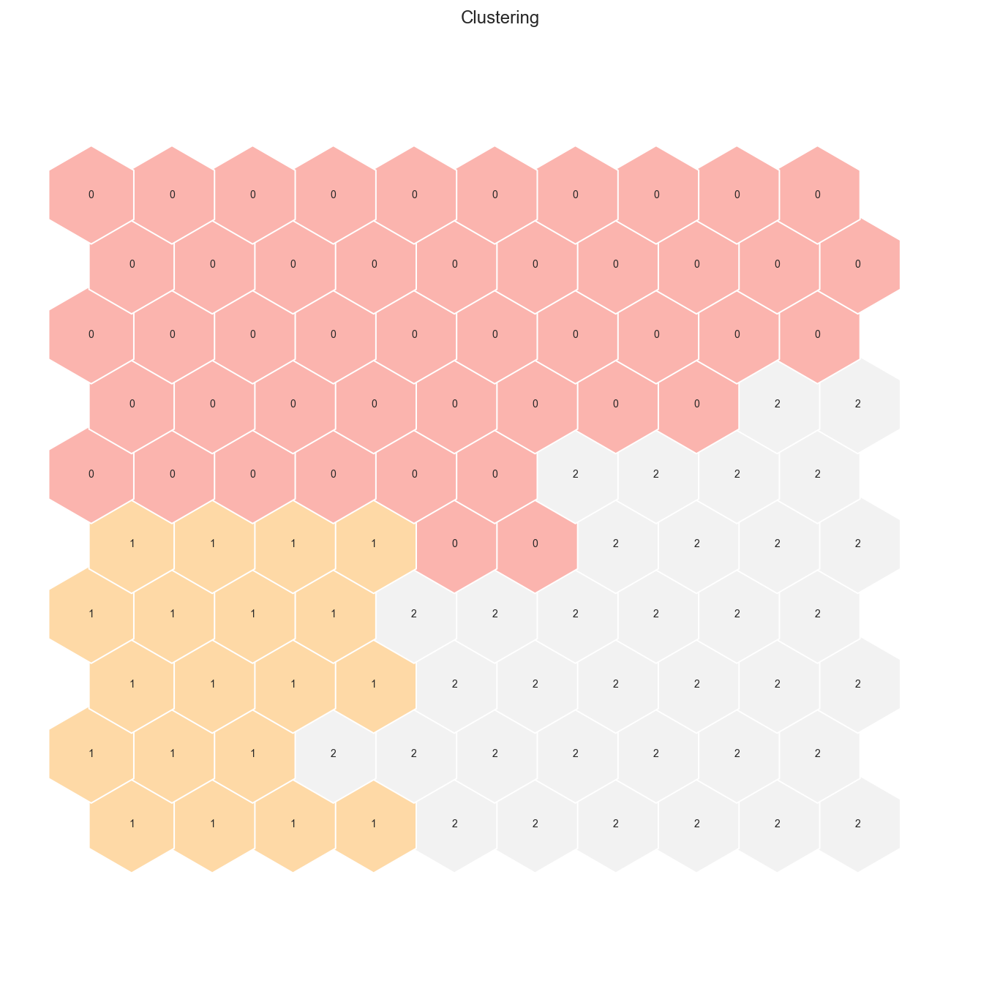

In [422]:
# Same but with 3 clusters
hierclust = AgglomerativeClustering(n_clusters=3, linkage='ward')
somhcNeigh_labels3=som_Neigh.cluster(hierclust)

hits  = HitMapView(12, 12,"Clustering",text_size=10)
hits.show(som_Neigh, anotate=True, onlyzeros=False, labelsize=7, cmap="Pastel1")

plt.show()

Both reveal misclassifications as in SOM + k-means

In [423]:
# Get the units input representation and their label from HC

nodesNeigh = som_Neigh.get_node_vectors()

Neigh_nodes = pd.DataFrame(nodesNeigh, columns=Neigh_view.columns)
Neigh_nodes['label'] = somhcNeigh_labels3
Neigh_nodes

,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families,label
0,0.547506,0.489805,0.332047,0.943040,0.067065,0.239431,0.407414,0.113098,0.112475,0.313257,0.173861,0.590845,2
1,0.468934,0.543537,0.376034,0.932574,0.052628,0.205264,0.411281,0.137419,0.095972,0.318880,0.153263,0.619540,2
2,0.407466,0.570692,0.401986,0.923802,0.040348,0.170541,0.411283,0.160579,0.082103,0.329510,0.129852,0.660997,2
3,0.362761,0.586783,0.418922,0.914404,0.032182,0.142529,0.414166,0.178525,0.072698,0.339884,0.111674,0.701378,2
4,0.325761,0.607853,0.433912,0.895649,0.029727,0.123723,0.406807,0.197269,0.066634,0.342794,0.100394,0.726927,2
5,0.300411,0.637975,0.456901,0.834660,0.038327,0.115540,0.393569,0.207013,0.065381,0.333367,0.103075,0.729878,2
6,0.285442,0.651464,0.477752,0.732624,0.053589,0.113347,0.390745,0.213460,0.065287,0.318072,0.110693,0.729552,1
7,0.274041,0.651493,0.493835,0.604174,0.076376,0.112032,0.378277,0.219622,0.065531,0.301062,0.118249,0.727860,1
8,0.267308,0.632083,0.494600,0.465750,0.098523,0.113383,0.349297,0.238453,0.064111,0.282325,0.121820,0.723056,1
9,0.259995,0.590307,0.455783,0.426977,0.114353,0.120772,0.296497,0.304572,0.055855,0.267531,0.111826,0.702666,1


In [424]:
# Obtaining SOM's BMUs labels
Neigh_bmus_map = som_Neigh.find_bmu(Neigh_view)[0]  # get bmus for each observation in df

Neigh_bmus = pd.DataFrame(
    np.concatenate((Neigh_view, np.expand_dims(Neigh_bmus_map,1)), axis=1),
    index=Neigh_view.index, columns=np.append(Neigh_view.columns,"BMU")
)

In [425]:
# Get cluster labels for each observation
Neigh_final = Neigh_bmus.merge(Neigh_nodes['label'], 'left', left_on="BMU", right_index=True)

In [426]:
# Characterizing the final clusters
Neigh_final.drop(columns='BMU').groupby('label').mean()

,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families
label,,,,,,,,,,,,
0,36.201311,70.479992,53.47599,85.578514,6.684998,7.474595,49.279011,10.821384,15855.854086,28.987279,14.191411,72.172293


Formed only one cluster --> very bad solution, metrics don't apply

In [427]:
# Number of observations in each cluster
Neigh_final.label.value_counts()

0    93939
Name: label, dtype: int64

In [428]:
# print("BD index for this solution: ",davies_bouldin_score(Neigh_view_norm, Neigh_final.label))
# print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Neigh_view_norm, Neigh_final.label))
# print("Silhouette score for this solution: ",metrics.silhouette_score(Neigh_view_norm, Neigh_final.label, metric='euclidean'))

### 5. DBSCAN</font> <a class="anchor" id="dbscan"></a>
[<font color='#E8800A'>5.1. Military View</font>](#mildb) <br>
[<font color='#E8800A'>5.2. Personal View</font>](#perdb)<br>
[<font color='#E8800A'>5.3. Neighbourhood View</font>](#neigdb)<br>

  [Back to Segmentation](#Segmentation)

### 5.1. Military View</font> <a class="anchor" id="mildb"></a>

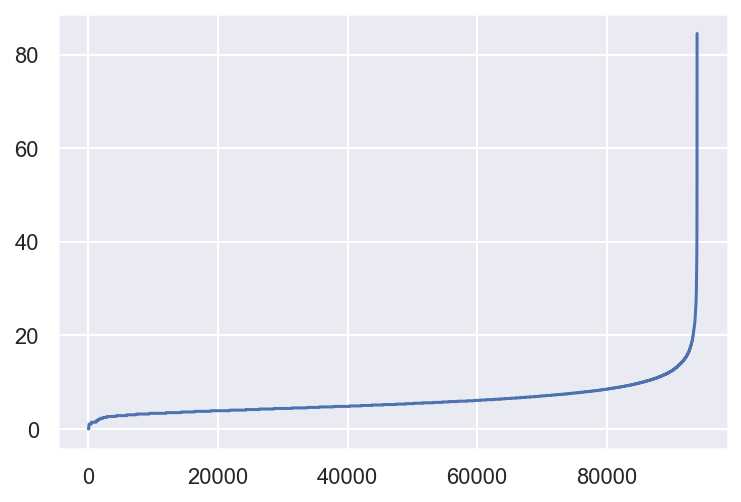

In [429]:
from sklearn.neighbors import NearestNeighbors
# K-distance graph to find out the right eps value
neigh = NearestNeighbors(n_neighbors=20)
neigh.fit(Military_view)
distances, _ = neigh.kneighbors(Military_view)
distances = np.sort(distances[:, -1])
plt.plot(distances)
plt.show()

In [430]:
from sklearn.cluster import MeanShift, DBSCAN, estimate_bandwidth
# Perform DBSCAN clustering
dbscan = DBSCAN(eps=15, min_samples=20, n_jobs=4)
dbscan_labels = dbscan.fit_predict(Military_view)

dbscan_n_clusters = len(np.unique(dbscan_labels))
print("Number of estimated clusters : %d" % dbscan_n_clusters)

Number of estimated clusters : 4


In [431]:
# Concatenating the labels to df
df_concat_mil = pd.concat([Military_view, pd.Series(dbscan_labels, index=Military_view.index, name="dbscan_labels")], axis=1)
df_concat_mil.head()

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4,dbscan_labels
0,0,39,34,18,0,23,16,0
1,0,15,55,11,0,10,0,0
2,0,20,29,33,0,23,8,0
3,0,23,14,31,0,40,16,0
4,1,28,9,53,4,16,20,0


In [432]:
# Detecting noise (potential outliers)
df_concat_mil.loc[df_concat_mil['dbscan_labels'] == -1]

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4,dbscan_labels
73,42,32,53,5,5,35,6,-1
79,0,23,65,9,0,0,67,-1
116,0,27,44,22,11,1,82,-1
158,35,33,54,36,2,19,16,-1
168,0,77,60,59,0,60,0,-1
...,...,...,...,...,...,...,...,...
92758,0,23,67,27,9,0,42,-1
93478,0,68,0,43,0,57,0,-1
93649,16,57,26,5,3,2,41,-1
93681,98,0,60,0,4,0,40,-1


### 5.2. Personal view</font> <a class="anchor" id="perdb"></a>

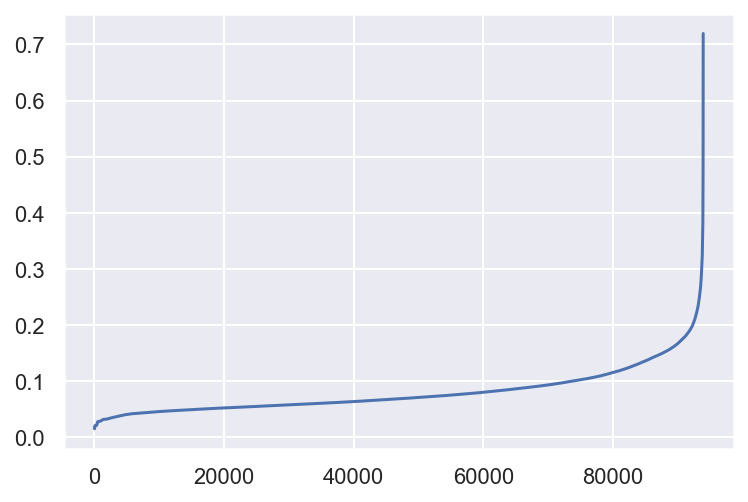

In [433]:
# K-distance graph to find out the right eps value
neigh = NearestNeighbors(n_neighbors=20)
neigh.fit(Personal_view_norm)
distances, _ = neigh.kneighbors(Personal_view_norm)
distances = np.sort(distances[:, -1])
plt.plot(distances)
plt.show()

In [434]:
# Perform DBSCAN clustering
dbscan = DBSCAN(eps=0.2, min_samples=20, n_jobs=-1)
dbscan_labels = dbscan.fit_predict(Personal_view_norm)

dbscan_n_clusters = len(np.unique(dbscan_labels))
print("Number of estimated clusters : %d" % dbscan_n_clusters)

Number of estimated clusters : 2


In [435]:
# Concatenating the labels to df
df_concat_pers = pd.concat([Personal_view_norm, pd.Series(dbscan_labels, index=Personal_view_norm.index, name="dbscan_labels")], axis=1)
df_concat_pers.head()

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,dbscan_labels
0,0.000000,0.375000,0.619718,0.020167,0.319149,0.259523,0.608819,0.257866,0
1,0.142857,0.833333,0.408451,0.044920,0.021277,0.045294,0.608819,0.091838,0
2,0.000000,0.333333,0.661972,0.019353,0.276596,0.265882,0.608819,0.250784,0
3,0.000000,0.000000,0.746479,0.017263,0.159574,0.143244,0.608819,0.374434,0
4,0.142857,0.333333,0.859155,0.017427,0.382979,0.199250,0.564723,0.714037,-1


In [436]:
# Detecting noise (potential outliers)
df_concat_pers.loc[df_concat_pers['dbscan_labels'] == -1]

,NUMCHLD,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,dbscan_labels
4,0.142857,0.333333,0.859155,0.017427,0.382979,0.199250,0.564723,0.714037,-1
436,0.000000,0.666667,0.971831,0.050892,0.744681,0.299587,0.261735,0.392430,-1
615,0.000000,0.166667,0.985915,0.309460,0.138298,0.071373,0.130868,0.201440,-1
765,0.000000,0.666667,0.014085,0.033751,0.106383,0.090104,0.130868,0.176710,-1
889,0.000000,0.000000,0.239437,0.013164,0.180851,0.145979,0.000000,0.166376,-1
...,...,...,...,...,...,...,...,...,...
92796,0.857143,0.833333,0.394366,0.009650,0.074468,0.125978,0.564723,0.095437,-1
93026,0.000000,0.000000,0.802817,0.012470,0.563830,1.000000,0.088193,0.508882,-1
93356,0.000000,0.000000,0.239437,0.018196,0.180851,0.137540,0.000000,0.183908,-1
93593,0.285714,0.000000,0.014085,0.027964,0.212766,0.244573,0.608819,0.395797,-1


### 5.3. Neigh view</font> <a class="anchor" id="neigdb"></a>

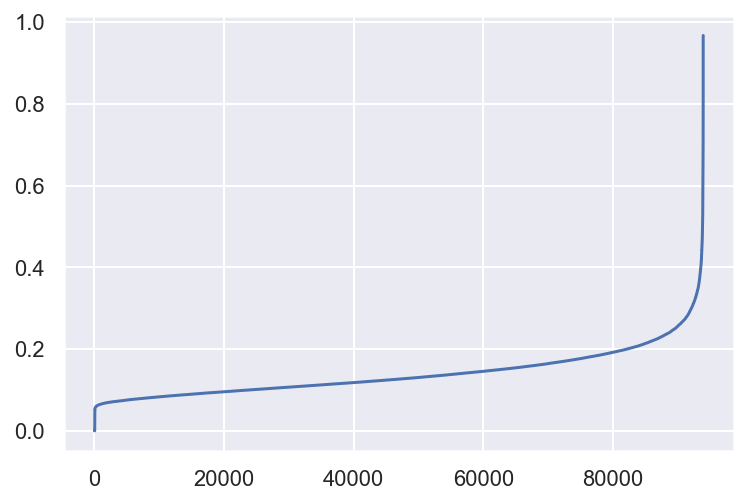

In [437]:
from sklearn.neighbors import NearestNeighbors
# K-distance graph to find out the right eps value
neigh = NearestNeighbors(n_neighbors=20)
neigh.fit(Neigh_view_norm)
distances, _ = neigh.kneighbors(Neigh_view_norm)
distances = np.sort(distances[:, -1])
plt.plot(distances)
plt.show()

In [438]:
# Perform DBSCAN clustering
dbscan = DBSCAN(eps=0.2, min_samples=20, n_jobs=-1)
dbscan_labels = dbscan.fit_predict(Neigh_view_norm)

dbscan_n_clusters = len(np.unique(dbscan_labels))
print("Number of estimated clusters : %d" % dbscan_n_clusters)

Number of estimated clusters : 3


In [439]:
# Concatenating the labels to df
df_concat_neigh = pd.concat([Neigh_view_norm, pd.Series(dbscan_labels, index=Neigh_view_norm.index, name="dbscan_labels")], axis=1)
df_concat_neigh.head()

,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families,dbscan_labels
0,0.377049,0.646465,0.444444,0.929293,0.030303,0.164384,0.535354,0.010101,0.085028,0.393939,0.059701,0.808081,0
1,0.245902,0.818182,0.575758,0.676768,0.424242,0.041096,0.575758,0.030303,0.266538,0.121212,0.447761,0.949495,0
2,0.327869,0.707071,0.565657,0.969697,0.020202,0.123288,0.626263,0.111111,0.074842,0.282828,0.074627,0.767677,0
3,0.278689,0.686869,0.454545,0.616162,0.292929,0.082192,0.313131,0.202020,0.102538,0.141414,0.044776,0.737374,0
4,0.311475,0.656566,0.494949,0.020202,0.010101,0.123288,0.313131,0.141414,0.061283,0.303030,0.179104,0.828283,0


In [440]:
# Detecting noise (potential outliers)
df_concat_neigh.loc[df_concat_neigh['dbscan_labels'] == -1]

,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families,dbscan_labels
11,0.442623,0.898990,0.717172,1.000000,0.060606,0.178082,0.474747,0.111111,0.116557,0.171717,0.328358,0.212121,-1
15,0.393443,0.727273,0.565657,0.343434,0.070707,0.109589,0.414141,0.040404,0.267177,0.161616,0.358209,0.727273,-1
38,0.737705,0.313131,0.232323,1.000000,0.010101,0.589041,0.545455,0.191919,0.074788,0.313131,0.164179,0.171717,-1
40,0.409836,0.747475,0.414141,0.737374,0.020202,0.260274,0.252525,0.050505,0.118334,0.161616,0.358209,0.808081,-1
51,0.196721,0.686869,0.797980,0.111111,0.303030,0.054795,0.303030,0.171717,0.051230,0.363636,0.089552,0.888889,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
93870,0.278689,0.606061,0.646465,0.545455,0.050505,0.054795,0.383838,0.232323,0.095587,0.101010,0.358209,0.505051,-1
93871,0.393443,0.414141,0.353535,0.757576,0.000000,0.219178,0.363636,0.282828,0.196473,0.111111,0.238806,0.424242,-1
93882,0.475410,0.696970,0.343434,0.969697,0.020202,0.219178,0.141414,0.080808,0.424398,0.131313,0.671642,0.464646,-1
93886,0.557377,0.757576,0.303030,0.979798,0.010101,0.315068,0.323232,0.050505,0.420852,0.161616,0.507463,0.323232,-1


## 6. K-Prototypes for Personal View</font> <a class="anchor" id="kproto"></a>
  [Back to Segmentation](#Segmentation)

In [441]:
#pip install kmodes
from kmodes.kprototypes import KPrototypes

In [442]:
Personal_Kproto_norm = pd.concat([Personal_view_norm[['INCOME','AGE', 'AVGGIFT', 'NGIFTALL', 'Response Rate', 'Inactive_time', 'Donation_activity']],data_new[['MAJOR','Lapsed Donor','VETERANS','BIBLE','PETS','CATLG','PCOWNERS','RefusePromo']]],axis=1)
Personal_Kproto = pd.concat([Personal_view[['INCOME','AGE', 'AVGGIFT', 'NGIFTALL', 'Response Rate', 'Inactive_time', 'Donation_activity']],data_new[['MAJOR','Lapsed Donor','VETERANS','BIBLE','PETS','CATLG','PCOWNERS','RefusePromo']]],axis=1)

<function matplotlib.pyplot.show(*args, **kw)>

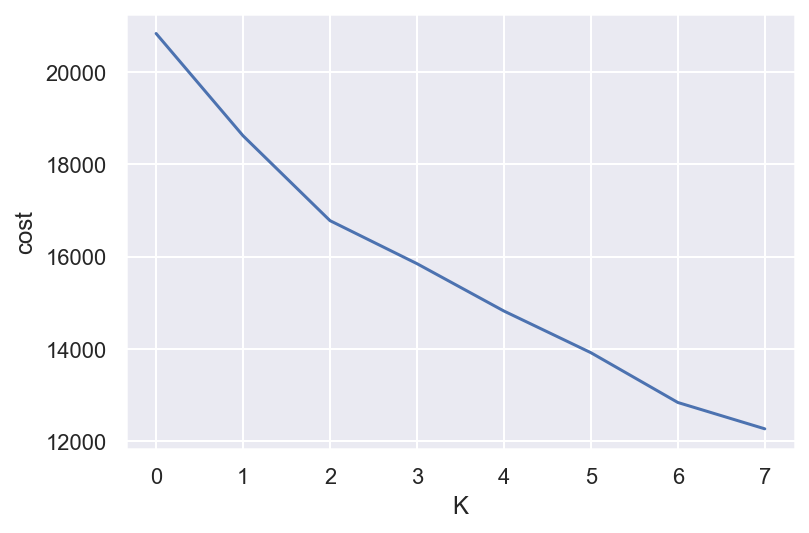

In [430]:
#Choosing optimal K value
cost = []
X = Personal_Kproto_norm
for k in list(range(2,10)):
    kproto = KPrototypes(n_clusters=k, init='Huang', random_state=1,n_jobs=-1) 
    kproto.fit_predict(X, categorical=[7,8,9,10,11,12,13])
    cost.append(kproto.cost_)

plt.plot(cost)
plt.xlabel('K')
plt.ylabel('cost')
plt.show

In [444]:
kproto = KPrototypes(n_clusters= 2, init='Huang', n_jobs =-1)
clusters2 = kproto.fit_predict(Personal_Kproto_norm, categorical=[7,8,9,10,11,12,13])

In [447]:
# Caracterização de clusters
kproto_final2 = pd.concat((Personal_Kproto, pd.Series(clusters2, name='kp_labels')), axis=1)
kproto_final2.groupby('kp_labels').mean()

,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,MAJOR,Lapsed Donor,VETERANS,BIBLE,PETS,CATLG,PCOWNERS,RefusePromo
kp_labels,,,,,,,,,,,,,,,
0,2.335353,66.829000,12.215776,11.071532,0.19606,551.365883,1700.645978,0.002257,0.838811,0.107506,0.100712,0.129638,0.072937,0.060040,0.004468
1,5.230465,59.124847,14.162073,8.293678,0.16517,565.397541,1361.914723,0.003543,0.832812,0.111841,0.087137,0.169722,0.091611,0.153807,0.003068


In [448]:
kproto_final2.kp_labels.value_counts()

1    50518
0    43421
Name: kp_labels, dtype: int64

In [449]:
print("DB index for this solution: ",davies_bouldin_score(Personal_Kproto_norm, kproto_final2.kp_labels))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Personal_Kproto_norm,kproto_final2.kp_labels))
print("Silhouette score for this solution: ",metrics.silhouette_score(Personal_Kproto_norm, kproto_final2.kp_labels, metric='euclidean'))

DB index for this solution:  2.9605658732161273
Calinski-Harabasz score for this solution:  8030.416087773536
Silhouette score for this solution:  0.11643984494295152


In [450]:
kproto = KPrototypes(n_clusters= 3, init='Huang', n_jobs =-1)
clusters3 = kproto.fit_predict(Personal_Kproto_norm, categorical=[7,8,9,10,11,12,13])

In [451]:
# Caracterização de clusters
kproto_final3 = pd.concat((Personal_Kproto, pd.Series(clusters3, name='kp_labels')), axis=1)
kproto_final3 .groupby('kp_labels').mean()

,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,MAJOR,Lapsed Donor,VETERANS,BIBLE,PETS,CATLG,PCOWNERS,RefusePromo
kp_labels,,,,,,,,,,,,,,,
0,2.308486,67.082129,12.021951,11.248765,0.199305,526.368612,1716.219254,0.002300,0.939384,0.107693,0.100975,0.128996,0.073634,0.058212,0.004679
1,5.215976,59.197285,13.984621,8.427872,0.168475,534.420748,1369.892113,0.003856,0.959506,0.111675,0.087955,0.168358,0.091563,0.151673,0.003427
2,4.058364,61.497970,14.624109,8.436011,0.155354,764.668844,1432.489144,0.001589,0.000000,0.109885,0.089232,0.158959,0.080936,0.125596,0.001589


In [452]:
kproto_final3.kp_labels.value_counts()

1    44352
0    38257
2    11330
Name: kp_labels, dtype: int64

In [453]:
print("DB index for this solution: ",davies_bouldin_score(Personal_Kproto_norm, kproto_final3.kp_labels))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Personal_Kproto_norm,kproto_final3.kp_labels))
print("Silhouette score for this solution: ",metrics.silhouette_score(Personal_Kproto_norm, kproto_final3.kp_labels, metric='euclidean'))

DB index for this solution:  2.22988750739416
Calinski-Harabasz score for this solution:  11879.463262171186
Silhouette score for this solution:  0.1548779389996721


In [456]:
kproto = KPrototypes(n_clusters= 4, init='Huang', n_jobs =-1)
clusters4 = kproto.fit_predict(Personal_Kproto_norm, categorical=[7,8,9,10,11,12,13])

In [457]:
# Caracterização de clusters
kproto_final4 = pd.concat((Personal_Kproto, pd.Series(clusters4, name='kp_labels')), axis=1)
kproto_final4 .groupby('kp_labels').mean()

,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,MAJOR,Lapsed Donor,VETERANS,BIBLE,PETS,CATLG,PCOWNERS,RefusePromo
kp_labels,,,,,,,,,,,,,,,
0,4.113973,61.212916,14.651639,8.334931,0.154347,764.832580,1423.333213,0.001538,0.000000,0.111342,0.089273,0.160185,0.081946,0.127713,0.001538
1,4.957686,49.823837,14.856593,5.946656,0.145815,546.988177,943.540239,0.001852,0.981910,0.096183,0.091411,0.190692,0.096254,0.173171,0.001531
2,2.066256,67.431014,11.998249,11.066289,0.198088,529.507202,1697.135336,0.002329,0.934569,0.105363,0.101348,0.126601,0.071958,0.053601,0.004352
3,5.119671,72.728068,12.411106,12.605611,0.207133,514.603762,2031.237292,0.005954,0.921248,0.132966,0.086329,0.132876,0.082901,0.106130,0.006630


In [458]:
kproto_final4.kp_labels.value_counts()

2    32630
1    28082
3    22171
0    11056
Name: kp_labels, dtype: int64

In [459]:
print("DB index for this solution: ",davies_bouldin_score(Personal_Kproto_norm, kproto_final4.kp_labels))
print("Calinski-Harabasz score for this solution: ",metrics.calinski_harabasz_score(Personal_Kproto_norm,kproto_final4.kp_labels))
print("Silhouette score for this solution: ",metrics.silhouette_score(Personal_Kproto_norm, kproto_final4.kp_labels, metric='euclidean'))

DB index for this solution:  2.79355964699154
Calinski-Harabasz score for this solution:  8853.545591054493
Silhouette score for this solution:  0.12878225933603765


## Joining each view's solution</font> <a class="anchor" id="final"></a>
  [Back to Segmentation](#Segmentation)

In [460]:
from collections import Counter
from sklearn.cluster import DBSCAN, KMeans, AgglomerativeClustering
from sklearn.base import clone
from sklearn.metrics import pairwise_distances
from scipy.cluster.hierarchy import dendrogram
from sklearn.manifold import TSNE
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import train_test_split
import graphviz

##### Best solution for the military view is

In [461]:
kmclust = KMeans(n_clusters=3, init='k-means++',n_init=15, random_state=1)
km_labels_Mil = kmclust.fit_predict(Military_view)

# Caracterização de clusters
km_Military = pd.concat((Military_view, pd.Series(km_labels_Mil, name='Mil_labels')), axis=1)
km_Military.groupby('Mil_labels').mean()

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,AFC6,VC2,VC4
Mil_labels,,,,,,,
0,0.353425,34.397271,20.959982,47.966469,1.232849,18.914198,7.816241
1,3.148255,11.319729,10.728007,9.958177,1.602394,16.855350,25.133545
2,1.338058,30.132512,40.317683,23.055801,1.297372,17.565348,12.489321


###### Removing from the analysis constant variables

In [462]:
Military_view.drop(columns=['AFC6'], inplace=True)

In [463]:
min_max_scaler = prep.MinMaxScaler()
Military_view_norm= pd.DataFrame(min_max_scaler.fit_transform(Military_view), index=Military_view.index, columns=Military_view.columns)

In [464]:
def cluster_profiles(df, label_columns, figsize, compar_titles=None):
    if compar_titles == None:
        compar_titles = [""]*len(label_columns)
        
    sns.set()
    fig, axes = plt.subplots(nrows=len(label_columns), ncols=2, figsize=figsize, squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compar_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, label, color=sns.color_palette(), ax=ax[0])
        sns.barplot(x=label, y="counts", data=counts, ax=ax[1])

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(s=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # Adaptable to number of clusters
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=-20)
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
    
    plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.show()

In [611]:
kmclust = KMeans(n_clusters=3, init='k-means++',n_init=15, random_state=1)
km_labels_Mil = kmclust.fit_predict(Military_view)

# Caracterização de clusters
km_Military = pd.concat((Military_view, pd.Series(km_labels_Mil, name='Mil_labels')), axis=1)
km_Military.groupby('Mil_labels').mean()

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,VC2,VC4
Mil_labels,,,,,,
0,0.353940,34.398484,20.960626,47.967537,18.914293,7.816232
1,3.147220,11.330884,10.738548,9.975944,16.858110,25.125180
2,1.337417,30.133214,40.319798,23.055552,17.565035,12.488207


##### Cluster 0: Older veterans
Less men active in the military, more veterans, especially older ones from WWII

##### Cluster 1: Active militars
More men active in the military, less veterans in general, except for more recent ones

##### Cluster 2: Younger veterans
High percentage of veterans, but younger ones, especially serving on the Vietnam war

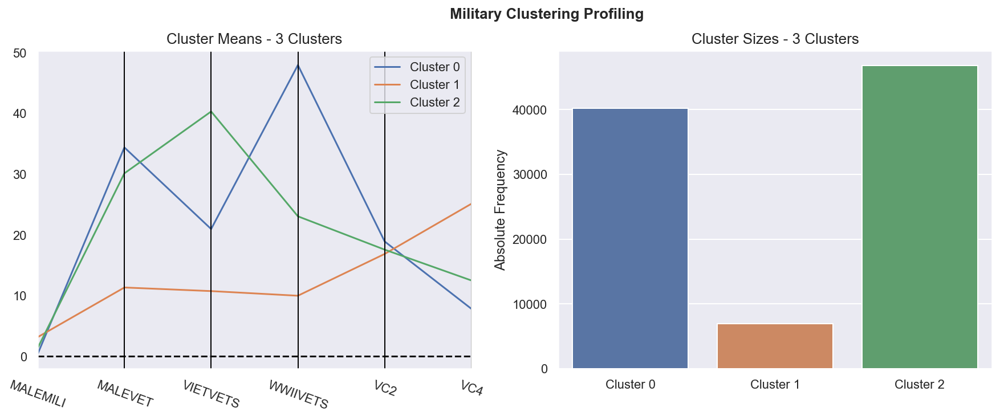

In [612]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(df=km_Military, label_columns = ['Mil_labels'],figsize = (15, 5),compar_titles = ["Military Clustering Profiling"])

In [613]:
km_Military['Mil_labels'].value_counts()
# Although cluster 2 has less observations, we consider them very relevant, so we'll keep them

2    46767
0    40230
1     6942
Name: Mil_labels, dtype: int64

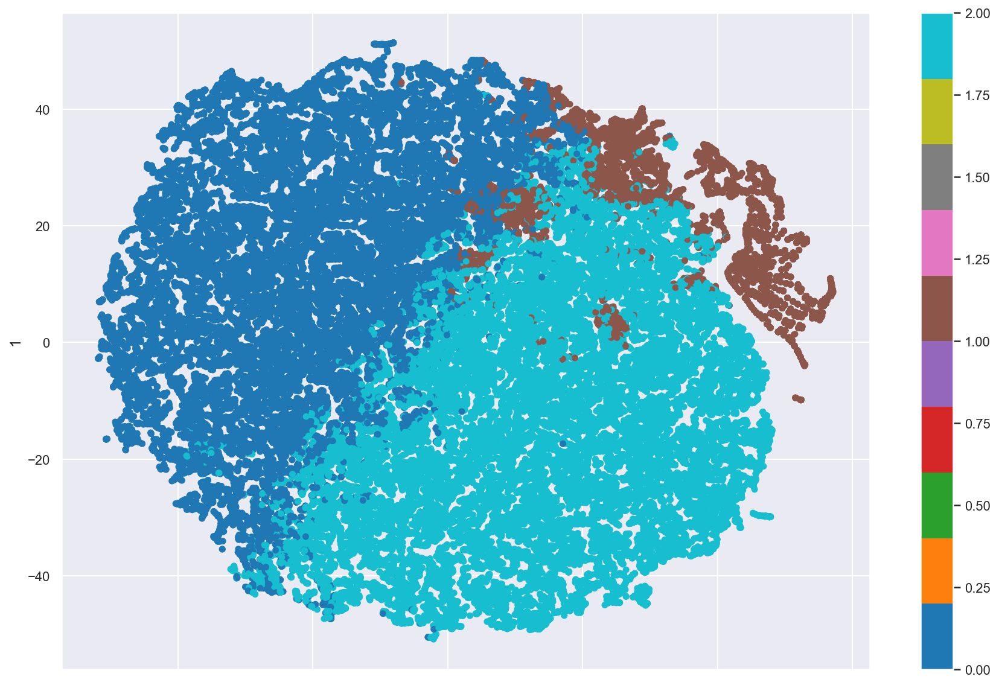

In [614]:
# This is step can be quite time consuming
two_dim = TSNE(random_state=42).fit_transform(km_Military.drop(columns=['Mil_labels']))

# t-SNE visualization
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=km_Military['Mil_labels'], colormap='tab10', figsize=(15,10))
plt.show()

#### Best solution for the personal view with k-means and 2 clusters

###### Dropping constant variables

In [469]:
Personal_view.drop(columns=['NUMCHLD'],inplace=True)
Personal_view_norm.drop(columns=['NUMCHLD'],inplace=True)

In [470]:
Personal_view_cat=pd.concat([Personal_view,pd.get_dummies(data_new['GENDER'])],axis=1)
Personal_view_cat.rename(columns={'F':"Fem",'J':'Joint','M':'Male','U':'Unknown'},inplace=True)

Personal_view_cat=pd.concat([Personal_view_cat,pd.get_dummies(data_new['DOMAIN_1'])],axis=1)
Personal_view_cat.rename(columns={'C':"City",'R':'Rural','S':'Suburb','T':'Town','U':'Urb'},inplace=True)

Personal_view_cat=pd.concat([Personal_view_cat,data_new[['VETERANS','BIBLE','CATLG','MAJOR','RefusePromo','HOMEOWNR','Lapsed Donor','PCOWNERS','PETS','Gadgets','Hobbies']]],axis=1)

In [471]:
kmclust = KMeans(n_clusters=2, init='k-means++',n_init=15, random_state=1)
km_labels_Per = kmclust.fit_predict(Personal_view_norm)

# Caracterizing clusters formed --> using the dataset with the original scales to evaluate better
cluster_concat_all = pd.concat((Personal_view_cat, pd.Series(km_labels_Per, name='Per_labels')), axis=1)
cluster_concat_all.groupby('Per_labels').mean()

,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,Fem,Joint,Male,Unknown,City,Rural,Suburb,Town,Urb,VETERANS,BIBLE,CATLG,MAJOR,RefusePromo,Lapsed Donor,PCOWNERS,PETS,Gadgets,Hobbies
Per_labels,,,,,,,,,,,,,,,,,,,,,,,,,,
0,5.22671,59.124820,14.157743,8.294504,0.165176,565.434332,1362.024111,0.524693,0.003930,0.425781,0.045595,0.187575,0.153275,0.296440,0.212772,0.149938,0.111807,0.087084,0.091527,0.003535,0.003061,0.832764,0.153650,0.169566,0.221382,0.251989
1,2.33152,66.850917,12.215311,11.078456,0.196140,551.282992,1701.480299,0.554090,0.003672,0.390133,0.052104,0.226454,0.288258,0.152386,0.205275,0.127627,0.107534,0.100813,0.072983,0.002263,0.004481,0.838884,0.059957,0.129706,0.167629,0.238741


##### Best solution for personal view was with k-prototypes, with 3 clusters

In [472]:
kpro_norm_t = pd.concat([Personal_view_norm[['INCOME','AGE', 'AVGGIFT', 'NGIFTALL', 'Response Rate', 'Inactive_time', 'Donation_activity']],data_new[['Lapsed Donor','PCOWNERS']]],axis=1)
kpro_t = pd.concat([Personal_view[['INCOME','AGE', 'AVGGIFT', 'NGIFTALL', 'Response Rate', 'Inactive_time', 'Donation_activity']],data_new[['Lapsed Donor','PCOWNERS']]],axis=1)
kpro_all= pd.concat([Personal_view_cat,kpro_t['PCOWNERS']],axis=1)

In [473]:
kproto = KPrototypes(n_clusters= 3, init='Huang', n_jobs =-1)
clusters3_t = kproto.fit_predict(kpro_norm_t, categorical=[7,8])

In [474]:
# Caracterização de clusters
kproto_final3_t = pd.concat((kpro_norm_t, pd.Series(clusters3_t, name='kp_labels')), axis=1)
kproto_final_nn = pd.concat((kpro_t, pd.Series(clusters3_t, name='kp_labels')), axis=1)
kproto_all_lab = pd.concat((kpro_all, pd.Series(clusters3_t, name='kp_labels')), axis=1)
kproto_all_lab.groupby('kp_labels').mean()

,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,Fem,Joint,Male,Unknown,City,Rural,Suburb,Town,Urb,VETERANS,BIBLE,CATLG,MAJOR,RefusePromo,Lapsed Donor,PCOWNERS,PETS,Gadgets,Hobbies,PCOWNERS
kp_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,4.055936,61.513096,14.622861,8.436811,0.155358,764.658435,1432.540965,0.525884,0.004145,0.418644,0.051327,0.206191,0.209454,0.240233,0.207602,0.136520,0.109974,0.089161,0.080871,0.001587,0.001587,0.000000,0.125496,0.158832,0.203898,0.244290,0.125496
1,2.308768,67.077651,12.021560,11.248928,0.199313,526.306813,1716.252379,0.557545,0.003582,0.387497,0.051375,0.226417,0.289453,0.151720,0.204978,0.127431,0.107692,0.100999,0.073651,0.002301,0.004628,0.939579,0.058225,0.129052,0.166806,0.239333,0.058225
2,5.215998,59.198413,13.984749,8.428098,0.168476,534.428346,1369.907873,0.524756,0.003923,0.425821,0.045500,0.187275,0.153251,0.294981,0.213497,0.150997,0.111652,0.087955,0.091563,0.003856,0.003472,0.959528,0.151673,0.168335,0.220441,0.251939,0.151673


By comparing both approaches, we decided to keep the solution with k-prototypes that led to 3 clusters, since with it we were able to identify a whole new cluster that is represented by non-lapsed donors (which should be treated differently). So, although by taking the metrics into consideration, k-means solution is slightly better, we prefer to use the solution that includes other relevant set of information (categorical variables) in the clustering creation.

In [562]:
data_new['MAJOR'].value_counts()

0    93662
1      277
Name: MAJOR, dtype: int64

In [563]:
data_new['RefusePromo'].value_counts()

0    93590
1      349
Name: RefusePromo, dtype: int64

##### Cluster 0: Not lapsed donors
Donate the highest amounts per gift, on average, have the highest inactive times and are completely characterized by non lapsed donors

##### Cluster 1: Poorer, older, donate less money but more times
Lowest income, older donors, with the lowest amounts donated per gift, donated more times (more frequently, based on the donation_activity per number of gifts donated) and more recently and have been donating for the longest time, slightly higher response rate. Less composed by men, living more in rural areas and less in the suburbs and less people with computers at home and interest for gadgets.

##### Cluster 2: Richer, shorter donation activity
Highest income, but not the ones that donate the most, younger, donated for a shorter period, live more in the suburbs and have the highest percentage of interest in hobbies, gadgets and more computers

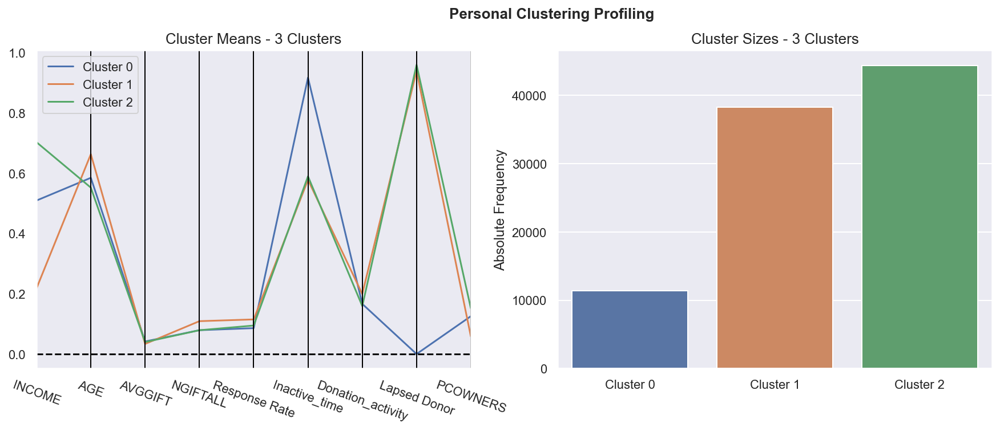

In [476]:
cluster_profiles(df=kproto_final3_t, label_columns = ['kp_labels'],figsize = (15, 5),compar_titles = ["Personal Clustering Profiling"])

In [516]:
# Non-lapsed donors from the cluster identified have all made their last donation more than 2 years previously (using the last day of a promotion received as reference)
kproto_all_lab['Inactive_time'][kproto_all_lab['kp_labels']==0].value_counts()

792.0    4337
731.0    4183
762.0    2332
823.0     487
Name: Inactive_time, dtype: int64

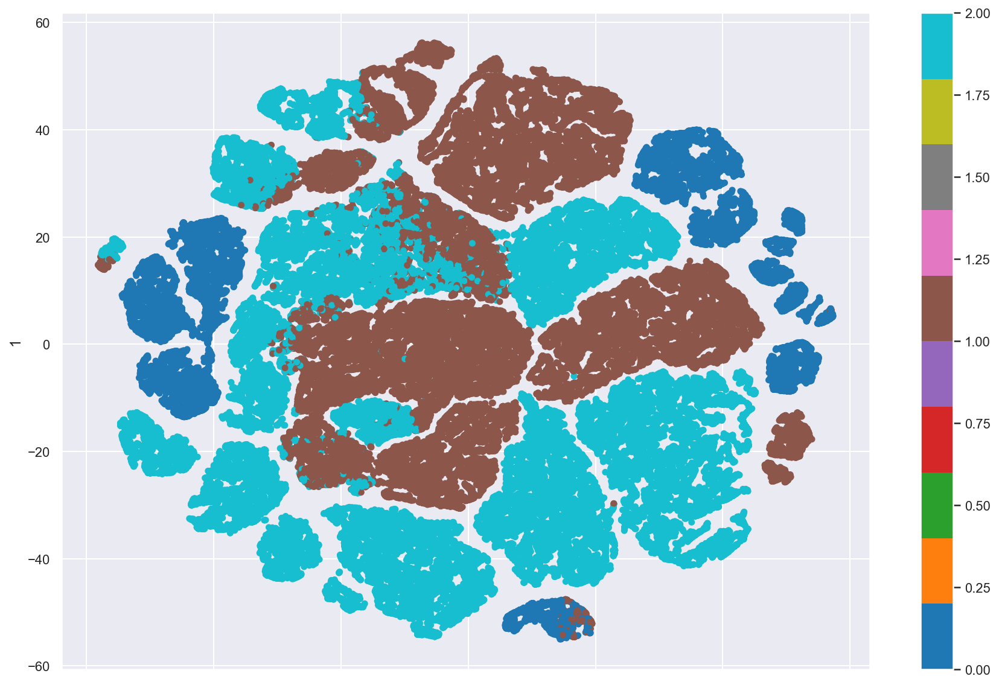

In [478]:
two_dim = TSNE(random_state=42).fit_transform(kproto_final3_t.drop(columns=['kp_labels']))

pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=kproto_final3_t['kp_labels'], colormap='tab10', figsize=(15,10))
plt.show()

#### Best solution for neighbourhood view was with k-means, with 3 clusters

In [479]:
data_new['1st ETH'].value_counts()
# Since the vast majority is white, we know that if they are not white, the majority are either black or hispanic

ETH1    87535
ETH2     3898
ETH5     1672
ETH4      710
ETH3      124
Name: 1st ETH, dtype: int64

In [480]:
ETH=pd.get_dummies(data_new['1st ETH'])
ANC=pd.get_dummies(data_new['1st ANC'])
Role=pd.get_dummies(data_new['1st Role'])
Sect=pd.get_dummies(data_new['1st Sect'])

In [481]:
Neigh_view_cat=pd.concat([Neigh_view,ETH[['ETH2','ETH5']],Sect[['EIC4','EIC8']],Role[['OCC5','OCC1','OCC10','OCC2']],ANC[['ANC4','ANC2','ANC7']],data_new['E_Pub'],data_new['Republicans']],axis=1)
Neigh_view_cat_norm= pd.DataFrame(min_max_scaler.fit_transform(Neigh_view_cat), index=Neigh_view_cat.index, columns=Neigh_view_cat.columns)

In [482]:
kmclust = KMeans(n_clusters=3, init='k-means++',n_init=15, random_state=1)
km_labels3 = kmclust.fit_predict(Neigh_view_norm)

# Caracterização de clusters
cluster_neigh_norm = pd.concat((Neigh_view_norm, pd.Series(km_labels3, name='labels')), axis=1)
neigh_all_norm = pd.concat((Neigh_view_cat_norm, pd.Series(km_labels3, name='labels')),axis=1)
neigh_all = pd.concat((Neigh_view_cat, pd.Series(km_labels3, name='labels')),axis=1)
cluster_neigh = pd.concat((Neigh_view, pd.Series(km_labels3, name='labels')), axis=1)
neigh_all.groupby('labels').mean()

,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families,ETH2,ETH5,EIC4,EIC8,OCC5,OCC1,OCC10,OCC2,ANC4,ANC2,ANC7,E_Pub,Republicans
labels,,,,,,,,,,,,,,,,,,,,,,,,,
0,34.255699,79.229584,61.925298,90.578764,6.694136,5.030317,56.419657,5.413065,19720.102419,25.005687,20.364339,74.885533,0.000348,0.000952,0.409536,0.364246,0.278820,0.331956,0.069107,0.192233,0.632248,0.219834,0.077348,82.122147,0.565695
1,32.868684,63.584606,49.232097,41.376954,15.530262,8.090513,34.319793,23.648855,10413.593602,26.357688,8.806252,70.936114,0.352872,0.139858,0.434751,0.358233,0.341240,0.099964,0.098782,0.026445,0.345874,0.252181,0.163123,88.404568,0.533624
2,39.224252,62.927039,45.515543,92.377650,4.233058,9.946358,45.691347,13.125273,13181.858168,34.016634,9.006398,69.581077,0.000000,0.002308,0.425647,0.404095,0.257069,0.120556,0.206413,0.052964,0.578669,0.196778,0.141581,87.678680,0.699777


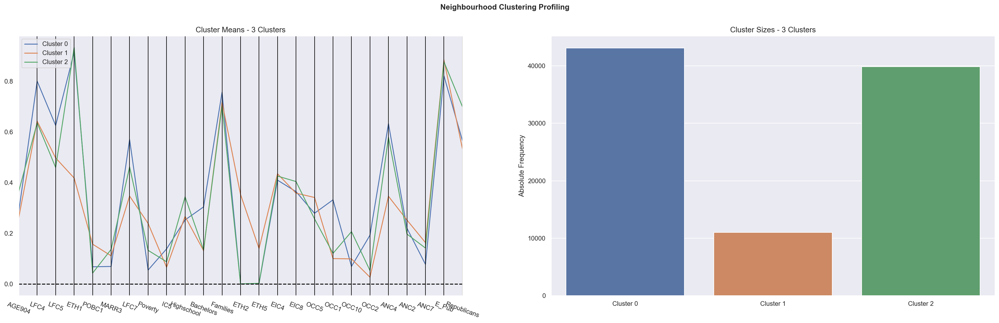

In [484]:
# Profilling Neighbourhood clustering
cluster_profiles(df=neigh_all_norm, label_columns = ['labels'],figsize = (30, 8),compar_titles = ["Neighbourhood Clustering Profiling"])

##### Cluster 0: Richer, more educated and employed
Higher percentage of people employed (men and women), more than half have families where both parents earn money, many white people, smallest percentage of widows, higher income and more educated people (highest percentage of bachelors), highest percentage of families.

##### Cluster 1: Poorer, less educated, foreign and not white
Younger population, neighbourhoods with less white people and more foreign borns, higher percentage of people below poverty level and less income per capita, the least educated neighbourhoods (less high school and less bachelors).

##### Cluster 2: White, older and only high school completed
The average age is slightly higher,less than half of the women are employed, more white people and less foreign born, more people with high school completed.

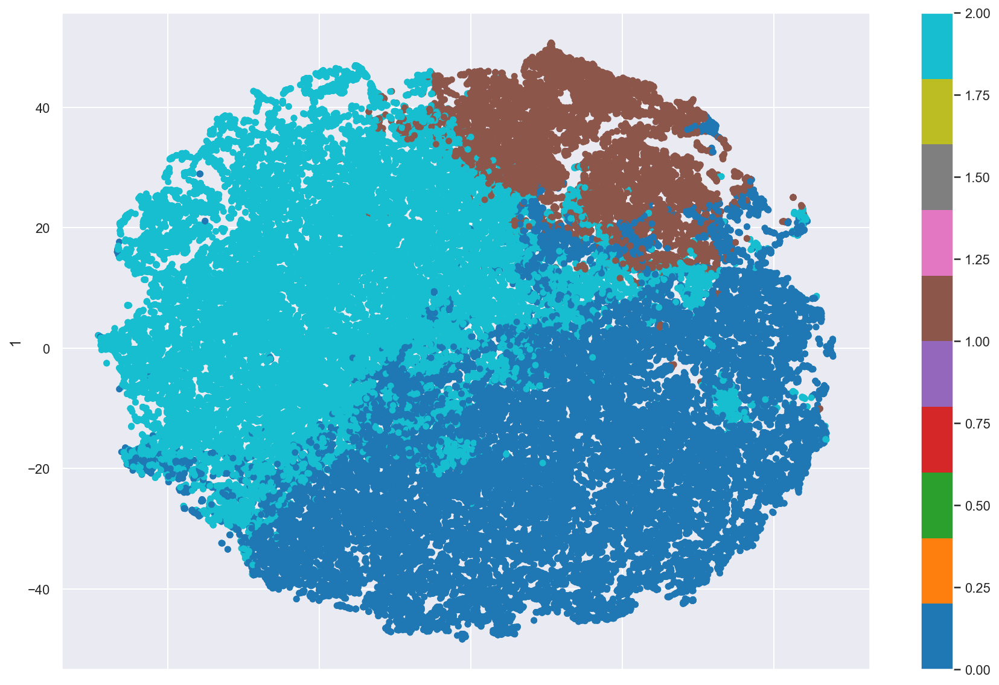

In [485]:
two_dim = TSNE(random_state=42).fit_transform(cluster_neigh_norm.drop(columns=['labels']))

pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=cluster_neigh_norm['labels'], colormap='tab10', figsize=(15,10))
plt.show()

## Joining the clusters solutions

In [547]:
clusters_all=pd.concat([Military_view_norm, Personal_view_norm, Neigh_view_norm], axis=1)
dataset_all=pd.concat([Military_view, Personal_view_cat, Neigh_view_cat, data_new[['CONTROLN','HPHONE_D']]], axis=1)

In [548]:
clusters_all['Military_labels'] = km_labels_Mil
clusters_all['Personal_labels'] = clusters3_t
clusters_all['Neigh_labels'] = km_labels3

dataset_all['Military_labels'] = km_labels_Mil
dataset_all['Personal_labels'] = clusters3_t
dataset_all['Neigh_labels'] = km_labels3

In [549]:
clusters_all.groupby('Personal_labels')['Personal_labels'].count()

Personal_labels
0    11339
1    38248
2    44352
Name: Personal_labels, dtype: int64

First, group all that belong to cluster 0 of personal, because those are the non-lapsing donors -> less relevant, can be handled differently, despite of the following characteristics

In [550]:
clusters_all[clusters_all['Personal_labels']!=0].groupby(['Neigh_labels','Personal_labels', 'Military_labels'])['Personal_labels'].count()

Neigh_labels  Personal_labels  Military_labels
0             1                0                   3581
                               1                   1001
                               2                   6778
              2                0                   8360
                               1                   1691
                               2                  16343
1             1                0                   1954
                               1                    973
                               2                   2538
              2                0                   1373
                               1                    640
                               2                   2158
2             1                0                  12438
                               1                   1120
                               2                   7865
              2                0                   7716
                               1                    690
 

In [551]:
centroids_t = clusters_all[clusters_all['Personal_labels']!=0].groupby(['Neigh_labels','Personal_labels', 'Military_labels']).mean()

In [552]:
hclust = AgglomerativeClustering(linkage='ward', affinity='euclidean', distance_threshold=0, n_clusters=None)

hclust_labels = hclust.fit_predict(centroids_t)

centroids_t['hclust_labels']=hclust_labels

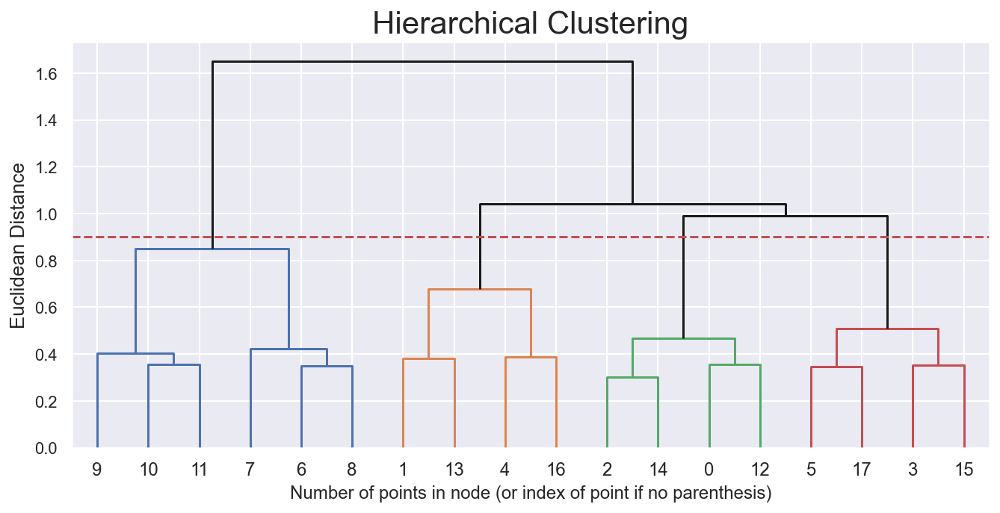

In [553]:
# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together # At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
# track the number of observations in the current cluster being formed 
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            current_count += 1 # leaf node
        else: 
            current_count += counts[child_idx - n_samples]
            counts[i] = current_count

linkage_matrix = np.column_stack([hclust.children_, hclust.distances_, counts]).astype(float)
# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 0.9
dendrogram(linkage_matrix, truncate_mode='level', p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed") 
plt.title('Hierarchical Clustering', fontsize=21)
plt.xlabel('Final clusters') 
plt.ylabel(f'Euclidean Distance', fontsize=13)
plt.show()

### With 3 final clusters

In [554]:
hclust = AgglomerativeClustering(linkage='ward', affinity='euclidean', n_clusters=3)

hclust_labels = hclust.fit_predict(centroids_t)

centroids_t['hclust_labels']=hclust_labels

In [555]:
# Removing observations classified as 0, since they are not lapsed donors, and those are separately

clusters_all_no_lapsed=clusters_all[clusters_all['Personal_labels']==0]
dataset_all_no_lapsed=dataset_all[dataset_all['Personal_labels']==0]


clusters_all=clusters_all[clusters_all['Personal_labels']!=0]
dataset_all=dataset_all[dataset_all['Personal_labels']!=0]

In [556]:
clusters_all

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,VC2,VC4,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families,Military_labels,Personal_labels,Neigh_labels
0,0.000000,0.393939,0.343434,0.181818,0.232323,0.161616,0.375000,0.619718,0.020167,0.319149,0.259523,0.608819,0.257866,0.377049,0.646465,0.444444,0.929293,0.030303,0.164384,0.535354,0.010101,0.085028,0.393939,0.059701,0.808081,2,1,2
1,0.000000,0.151515,0.555556,0.111111,0.101010,0.000000,0.833333,0.408451,0.044920,0.021277,0.045294,0.608819,0.091838,0.245902,0.818182,0.575758,0.676768,0.424242,0.041096,0.575758,0.030303,0.266538,0.121212,0.447761,0.949495,2,2,0
2,0.000000,0.202020,0.292929,0.333333,0.232323,0.080808,0.333333,0.661972,0.019353,0.276596,0.265882,0.608819,0.250784,0.327869,0.707071,0.565657,0.969697,0.020202,0.123288,0.626263,0.111111,0.074842,0.282828,0.074627,0.767677,2,1,2
3,0.000000,0.232323,0.141414,0.313131,0.404040,0.161616,0.000000,0.746479,0.017263,0.159574,0.143244,0.608819,0.374434,0.278689,0.686869,0.454545,0.616162,0.292929,0.082192,0.313131,0.202020,0.102538,0.141414,0.044776,0.737374,0,1,1
4,0.010101,0.282828,0.090909,0.535354,0.161616,0.202020,0.333333,0.859155,0.017427,0.382979,0.199250,0.564723,0.714037,0.311475,0.656566,0.494949,0.020202,0.010101,0.123288,0.313131,0.141414,0.061283,0.303030,0.179104,0.828283,0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93934,0.141414,0.363636,0.474747,0.111111,0.151515,0.252525,0.591667,0.380282,0.074074,0.000000,0.030588,0.520626,0.000000,0.196721,0.838384,0.696970,0.787879,0.040404,0.041096,0.575758,0.060606,0.131192,0.282828,0.223881,0.727273,2,2,0
93935,0.000000,0.313131,0.434343,0.191919,0.050505,0.151515,1.000000,0.436620,0.058456,0.000000,0.049412,0.479374,0.000000,0.180328,0.878788,0.525253,0.919192,0.020202,0.027397,0.434343,0.070707,0.191439,0.121212,0.537313,0.898990,2,2,0
93936,0.000000,0.181818,0.464646,0.202020,0.000000,0.202020,0.305000,0.605634,0.021865,0.063830,0.123280,0.174964,0.084872,0.213115,0.707071,0.696970,0.828283,0.060606,0.068493,0.242424,0.262626,0.079534,0.515152,0.164179,0.646465,2,1,2
93937,0.000000,0.282828,0.353535,0.202020,0.181818,0.080808,1.000000,0.577465,0.033924,0.425532,0.196220,0.044097,0.427726,0.311475,0.858586,0.575758,0.929293,0.141414,0.109589,0.545455,0.030303,0.108913,0.202020,0.223881,0.858586,2,2,0


In [557]:
cluster_mapper = centroids_t['hclust_labels'].to_dict()

dataset_all['merged_labels'] = dataset_all.apply(lambda row: cluster_mapper[(row['Military_labels'], row['Personal_labels'],row['Neigh_labels'])], axis=1)
clusters_all['merged_labels'] = clusters_all.apply(lambda row: cluster_mapper[(row['Military_labels'], row['Personal_labels'],row['Neigh_labels'])], axis=1)

dataset_all.drop(columns=['CONTROLN','Military_labels','Personal_labels','Neigh_labels']).groupby('merged_labels').mean()


,MALEMILI,MALEVET,VIETVETS,WWIIVETS,VC2,VC4,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,Fem,Joint,Male,Unknown,City,Rural,Suburb,Town,Urb,VETERANS,BIBLE,CATLG,MAJOR,RefusePromo,Lapsed Donor,PCOWNERS,PETS,Gadgets,Hobbies,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families,ETH2,ETH5,EIC4,EIC8,OCC5,OCC1,OCC10,OCC2,ANC4,ANC2,ANC7,E_Pub,Republicans,HPHONE_D
merged_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,1.264327,29.377818,39.11936,22.765352,17.602078,12.810501,4.330486,59.957546,13.344954,8.980345,0.175811,534.850344,1420.995339,0.537442,0.003819,0.411849,0.046890,0.172736,0.214460,0.255847,0.236473,0.120483,0.110908,0.094792,0.086537,0.002808,0.003117,0.960494,0.131602,0.166531,0.205531,0.248856,33.813871,73.515373,55.956535,83.368159,6.715008,6.209041,49.081819,10.966222,15056.949179,29.174309,13.882999,74.609210,0.049361,0.020834,0.471908,0.360915,0.289737,0.188881,0.161308,0.121241,0.591155,0.209406,0.119304,86.705824,0.603257,0.488586
1,1.622723,24.085319,27.26287,25.032616,17.227806,15.857513,2.953807,64.125567,12.893435,10.295774,0.188477,523.949384,1565.905465,0.556124,0.004032,0.386925,0.052920,0.187630,0.175967,0.204622,0.197566,0.234214,0.106559,0.100583,0.077183,0.004176,0.004824,0.932753,0.081791,0.138023,0.181295,0.234646,33.716754,72.704082,56.897473,74.694362,8.929225,6.664843,47.766650,13.507884,14070.639499,27.577939,13.915329,71.176903,0.117647,0.050328,0.420333,0.382029,0.327525,0.197206,0.097847,0.095399,0.556196,0.204766,0.116567,86.099408,0.608467,0.484700
2,0.560249,34.562515,20.81738,46.809282,18.936669,8.056351,3.758461,65.419567,12.862424,10.309977,0.187827,528.986010,1632.939479,0.535835,0.003596,0.412890,0.047679,0.248006,0.235255,0.209451,0.185612,0.121676,0.110013,0.090373,0.082306,0.003052,0.004623,0.946670,0.094604,0.137600,0.190929,0.247945,39.883370,66.168147,49.276740,92.675338,5.693075,9.238246,50.226674,9.565053,17387.450538,29.494773,14.540005,69.829375,0.000030,0.001088,0.363156,0.401710,0.243171,0.248671,0.111645,0.111887,0.570371,0.219936,0.109772,83.329381,0.638808,0.526227


###### Cluster 0: 
Highest income, slightly younger, with smallest number of donations and inactive for longer. Living in the suburbs and in towns. Slightly higher interest in pets and gadgets. Highest percentage of families in the neighbourhood  and of veterans of the Vietnam war (relatively young veterans), as well as some men acitve in the military.

###### Cluster 1: 
Lowest income, being characterized by people who have donated most recently and slightly more frequently. This cluster is less composed of men, and more composed by people who live in urban areas and that generally have a smaller interest in "Veterans" and in gadgets. Living in neighbourhoods with more men active in the military and more recent veterans, while generally less veterans in the neighbourhood, less white people (although they're still the majority) and foreign borns, with smallest percentage of two parent earner families and highest poverty rate and lowest income per capita.

###### Cluster 2:
Older donors, with the smallest amounts donated, but one of the highest number of donations, and have been donating for the longest time. Live the most in cities or rural areas, in neighbourhoods with older population, smallest percentage of people employed, one of the lowest interest in gadgets. Mostly composed of whites, and more widows, less active men in the military, but more of veterans (the oldest ones), highest income per capita, but also highest poverty rate one of the most dominated by republicans. 

In [558]:
clusters_all.groupby('merged_labels')['MALEMILI'].count()

merged_labels
0    35615
1    13889
2    33096
Name: MALEMILI, dtype: int64

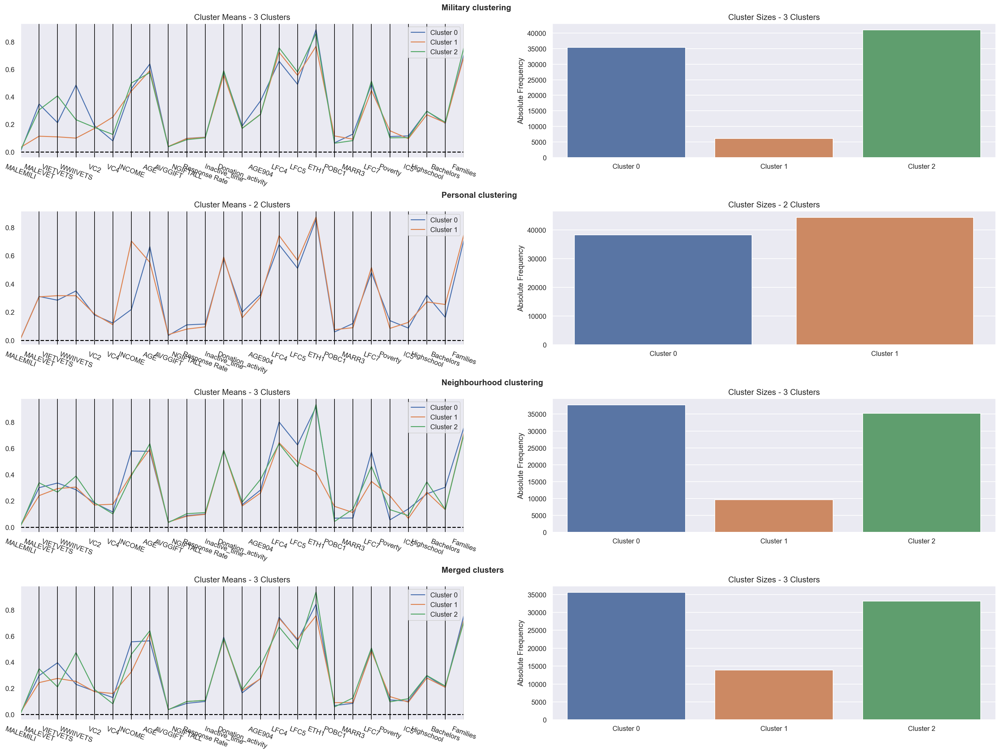

In [559]:
cluster_profiles(df=clusters_all, label_columns = ['Military_labels', 'Personal_labels','Neigh_labels', 'merged_labels'],
                 figsize = (28, 20),compar_titles = ["Military clustering", "Personal clustering","Neighbourhood clustering", "Merged clusters"])

In [560]:
c_all=clusters_all.drop(columns=['Military_labels','Personal_labels','Neigh_labels'])

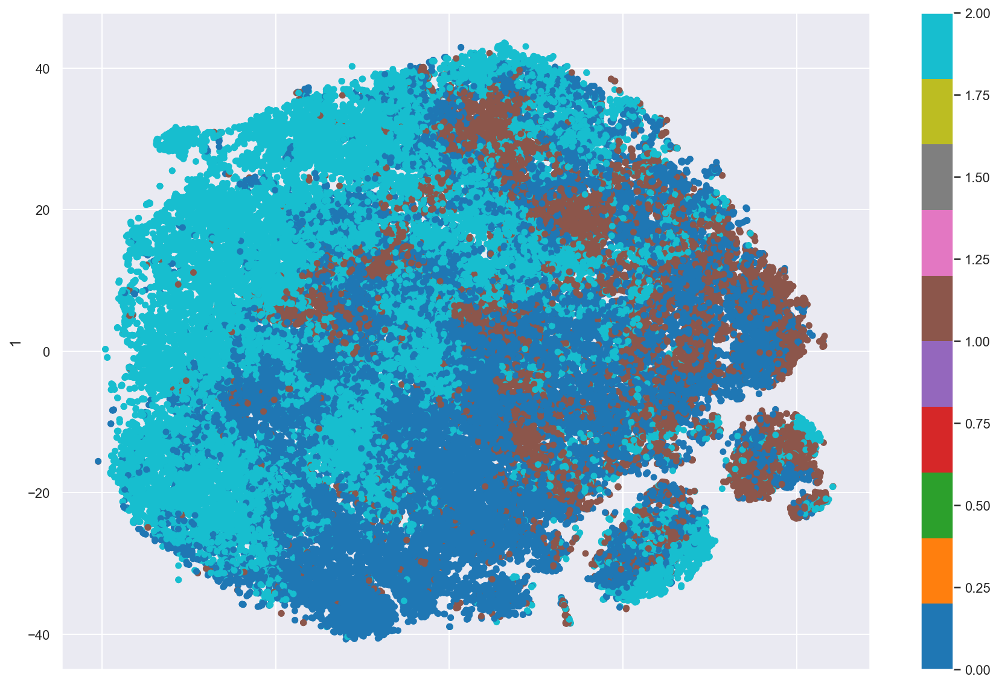

In [561]:
two_dim = TSNE(random_state=42).fit_transform(c_all.drop(columns=['merged_labels']))

pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=c_all['merged_labels'], colormap='tab10', figsize=(15,10))
plt.show()

### With 4 final clusters

In [599]:
hclust = AgglomerativeClustering(linkage='ward', affinity='euclidean', n_clusters=4)

hclust_labels = hclust.fit_predict(centroids_t)

centroids_t['hclust_labels']=hclust_labels

In [600]:
# Removing observations classified as 0, since they are not lapsed donors, and those are separately
clusters_all=clusters_all[clusters_all['Personal_labels']!=0]
dataset_all=dataset_all[dataset_all['Personal_labels']!=0]

In [601]:
cluster_mapper = centroids_t['hclust_labels'].to_dict()

# Mapping the hierarchical clusters on the centroids to the observations
dataset_all['merged_labels'] = dataset_all.apply(lambda row: cluster_mapper[(row['Military_labels'], row['Personal_labels'],row['Neigh_labels'])], axis=1)
clusters_all['merged_labels'] = clusters_all.apply(lambda row: cluster_mapper[(row['Military_labels'], row['Personal_labels'],row['Neigh_labels'])], axis=1)

# Merged cluster centroids
dataset_all.drop(columns=['CONTROLN','Military_labels','Personal_labels','Neigh_labels']).groupby('merged_labels').mean()

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,VC2,VC4,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,Fem,Joint,Male,Unknown,City,Rural,Suburb,Town,Urb,VETERANS,BIBLE,CATLG,MAJOR,RefusePromo,Lapsed Donor,PCOWNERS,PETS,Gadgets,Hobbies,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families,ETH2,ETH5,EIC4,EIC8,OCC5,OCC1,OCC10,OCC2,ANC4,ANC2,ANC7,E_Pub,Republicans,HPHONE_D
merged_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,1.264327,29.377818,39.119360,22.765352,17.602078,12.810501,4.330486,59.957546,13.344954,8.980345,0.175811,534.850344,1420.995339,0.537442,0.003819,0.411849,0.046890,0.172736,0.214460,0.255847,0.236473,0.120483,0.110908,0.094792,0.086537,0.002808,0.003117,0.960494,0.131602,0.166531,0.205531,0.248856,33.813871,73.515373,55.956535,83.368159,6.715008,6.209041,49.081819,10.966222,15056.949179,29.174309,13.882999,74.609210,0.049361,0.020834,0.471908,0.360915,0.289737,0.188881,0.161308,0.121241,0.591155,0.209406,0.119304,86.705824,0.603257,0.488586
1,2.021871,23.502935,29.682162,17.855046,17.194187,17.204696,2.832478,64.160481,12.815332,10.678565,0.192563,521.851827,1604.625544,0.552642,0.004166,0.391308,0.051884,0.183488,0.169475,0.239727,0.223916,0.183393,0.111911,0.099034,0.078300,0.005113,0.005397,0.927665,0.085022,0.145900,0.188601,0.243325,33.292937,76.659724,60.253077,85.415357,7.192293,5.676860,52.379190,10.055482,15150.435050,28.105472,15.542700,71.849366,0.033232,0.026037,0.417345,0.395853,0.335164,0.222780,0.104431,0.116266,0.644196,0.187654,0.093069,85.657826,0.625260,0.500473
2,0.560249,34.562515,20.817380,46.809282,18.936669,8.056351,3.758461,65.419567,12.862424,10.309977,0.187827,528.986010,1632.939479,0.535835,0.003596,0.412890,0.047679,0.248006,0.235255,0.209451,0.185612,0.121676,0.110013,0.090373,0.082306,0.003052,0.004623,0.946670,0.094604,0.137600,0.190929,0.247945,39.883370,66.168147,49.276740,92.675338,5.693075,9.238246,50.226674,9.565053,17387.450538,29.494773,14.540005,69.829375,0.000030,0.001088,0.363156,0.401710,0.243171,0.248671,0.111645,0.111887,0.570371,0.219936,0.109772,83.329381,0.638808,0.526227
3,0.355576,25.934175,19.582507,47.818756,17.334536,11.580703,3.338981,64.014728,13.141386,9.080553,0.175502,530.608356,1442.983469,0.567178,0.003607,0.373009,0.056207,0.200781,0.196573,0.093177,0.113916,0.395552,0.089570,0.105500,0.073640,0.001202,0.003006,0.948903,0.071536,0.113015,0.158100,0.207093,35.062218,60.146378,46.244665,40.659152,14.443342,9.801323,33.123535,24.467989,10642.686204,25.903216,8.749023,69.042080,0.385633,0.127442,0.429817,0.338142,0.303276,0.116020,0.076946,0.029155,0.276826,0.259092,0.191163,87.501268,0.555155,0.434626


##### Cluster 0:
Higher income, younger, highest amounts donated, but less number of donations, have been inactive for longer and donating for a shorter period. Tend to have more computers, live more in the suburbs or towns, higher interest in pets and gadgets. Neighbourhoods most composed of families.
- Richer and younger donors, highest amounts donated but less number of donations and inactive for longer

##### Cluster 1:
Lowest income, most recent and frequent donors, though not the highest amounts donated. Highest response rate, major donors but tend to refuse more promotions.  more presence of men active in the mlitary and less of veterans, except for younger ones. Younger neighbourhoods, with the most people employed, slightly higher education
- Poorer donors donate the smallest amounts, but are more recent and frequent donors, tend to be major donors and respond more (most valuable donors)

##### Cluster 2:
Older, made many donations, but not of the highest amounts given and tend to live more in cities. higher presence of veterans in the neighbourhood (older ones). Older neighbourhood, vast majority white and fewer foreign borns, more widows, highest income per capita and lowest poverty rate. More associated to republican states
- Older donors in whiter and richer neighbourhoods, made many donations, but not of the highest amounts given

##### Cluster 3:
Donate high amounts, tend less to be men and live in urban areas. Less interest in veterans and in gadgets and more in bible. Majorly composed of non-white people (only 40% are white), more foreign borns, more widows, less households where both parents earn money. Are not the poorest but live in neighbourhoods with highest poverty rate and lowest income per capita and lowest education (less bachelors and highschool), with highest percent in public schools. Tend less to be neighbourhoods located in republican states, although it's still the majority.
- Tend to be donate one of the highest amounts, but the least frequently and live in poorer, non-white and less educated neighbourhoods

In [602]:
clusters_all.groupby('merged_labels')['MALEMILI'].count()

merged_labels
0    35615
1    10562
2    33096
3     3327
Name: MALEMILI, dtype: int64

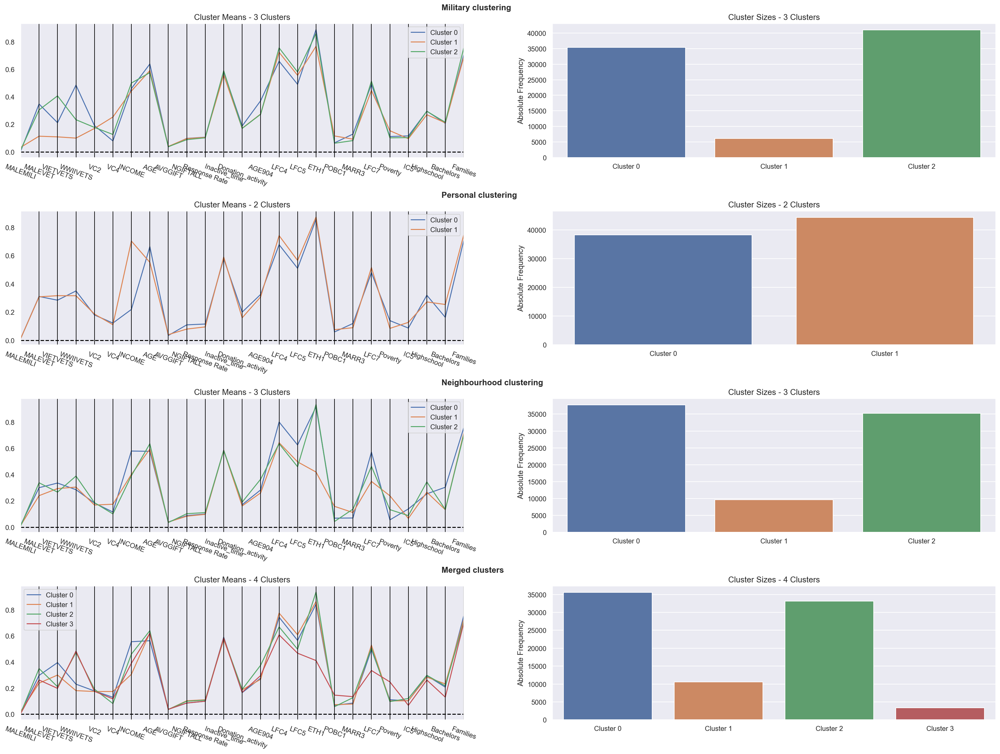

In [537]:
cluster_profiles(df=clusters_all, label_columns = ['Military_labels', 'Personal_labels','Neigh_labels', 'merged_labels'],
                 figsize = (28, 20),compar_titles = ["Military clustering", "Personal clustering","Neighbourhood clustering", "Merged clusters"])

In [538]:
c_all=clusters_all.drop(columns=['Military_labels','Personal_labels','Neigh_labels'])

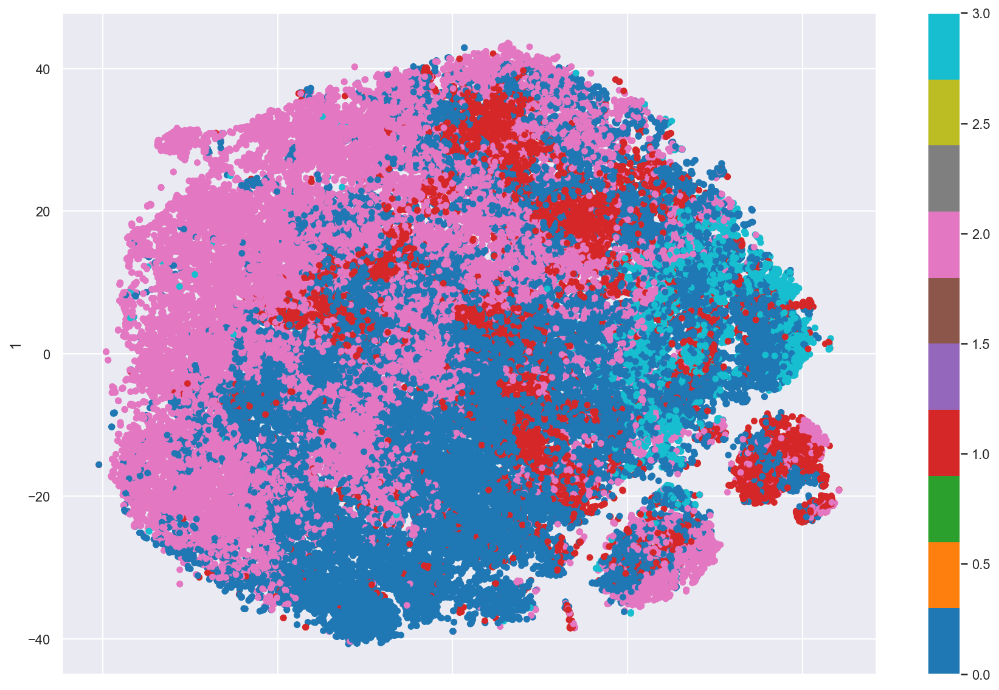

In [539]:
two_dim = TSNE(random_state=42).fit_transform(c_all.drop(columns=['merged_labels']))

pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=c_all['merged_labels'], colormap='tab10', figsize=(15,10))
plt.show()

### With 5 final clusters

In [540]:
# Re-running the Hierarchical clustering based on the correct number of cluste rs
hclust = AgglomerativeClustering(linkage='ward', affinity='euclidean', n_clusters=5)

hclust_labels = hclust.fit_predict(centroids_t)

centroids_t['hclust_labels']=hclust_labels

In [541]:
# Removing observations classified as 2, since they are not lapsed donors, and those are separately
clusters_all=clusters_all[clusters_all['Personal_labels']!=0]
dataset_all=dataset_all[dataset_all['Personal_labels']!=0]

In [542]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = centroids_t['hclust_labels'].to_dict()

# Mapping the hierarchical clusters on the centroids to the observations
dataset_all['merged_labels'] = dataset_all.apply(lambda row: cluster_mapper[(row['Military_labels'], row['Personal_labels'],row['Neigh_labels'])], axis=1)
clusters_all['merged_labels'] = clusters_all.apply(lambda row: cluster_mapper[(row['Military_labels'], row['Personal_labels'],row['Neigh_labels'])], axis=1)

# Merged cluster centroids
dataset_all.drop(columns=['CONTROLN','Military_labels','Personal_labels','Neigh_labels']).groupby('merged_labels').mean()

,MALEMILI,MALEVET,VIETVETS,WWIIVETS,VC2,VC4,INCOME,AGE,AVGGIFT,NGIFTALL,Response Rate,Inactive_time,Donation_activity,Fem,Joint,Male,Unknown,City,Rural,Suburb,Town,Urb,VETERANS,BIBLE,CATLG,MAJOR,RefusePromo,Lapsed Donor,PCOWNERS,PETS,Gadgets,Hobbies,AGE904,LFC4,LFC5,ETH1,POBC1,MARR3,LFC7,Poverty,IC5,Highschool,Bachelors,Families,ETH2,ETH5,EIC4,EIC8,OCC5,OCC1,OCC10,OCC2,ANC4,ANC2,ANC7,E_Pub,Republicans,HPHONE_D
merged_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.560249,34.562515,20.817380,46.809282,18.936669,8.056351,3.758461,65.419567,12.862424,10.309977,0.187827,528.986010,1632.939479,0.535835,0.003596,0.412890,0.047679,0.248006,0.235255,0.209451,0.185612,0.121676,0.110013,0.090373,0.082306,0.003052,0.004623,0.946670,0.094604,0.137600,0.190929,0.247945,39.883370,66.168147,49.276740,92.675338,5.693075,9.238246,50.226674,9.565053,17387.450538,29.494773,14.540005,69.829375,0.000030,0.001088,0.363156,0.401710,0.243171,0.248671,0.111645,0.111887,0.570371,0.219936,0.109772,83.329381,0.638808,0.526227
1,1.255359,30.073852,40.231821,23.238530,17.599242,12.396733,4.306291,59.980983,13.279905,9.000088,0.176114,535.493889,1425.543707,0.538107,0.003821,0.411813,0.046259,0.172320,0.216917,0.261310,0.239405,0.110048,0.111448,0.094648,0.087093,0.002508,0.002888,0.961762,0.132215,0.167624,0.206125,0.250372,33.764912,73.851772,56.233863,83.996704,6.414525,6.148170,49.497419,10.691731,15144.202742,29.206242,14.020155,74.856030,0.045734,0.017909,0.474027,0.358845,0.288727,0.191716,0.161791,0.123844,0.596354,0.208663,0.118623,86.712823,0.604288,0.492723
2,2.021871,23.502935,29.682162,17.855046,17.194187,17.204696,2.832478,64.160481,12.815332,10.678565,0.192563,521.851827,1604.625544,0.552642,0.004166,0.391308,0.051884,0.183488,0.169475,0.239727,0.223916,0.183393,0.111911,0.099034,0.078300,0.005113,0.005397,0.927665,0.085022,0.145900,0.188601,0.243325,33.292937,76.659724,60.253077,85.415357,7.192293,5.676860,52.379190,10.055482,15150.435050,28.105472,15.542700,71.849366,0.033232,0.026037,0.417345,0.395853,0.335164,0.222780,0.104431,0.116266,0.644196,0.187654,0.093069,85.657826,0.625260,0.500473
3,0.355576,25.934175,19.582507,47.818756,17.334536,11.580703,3.338981,64.014728,13.141386,9.080553,0.175502,530.608356,1442.983469,0.567178,0.003607,0.373009,0.056207,0.200781,0.196573,0.093177,0.113916,0.395552,0.089570,0.105500,0.073640,0.001202,0.003006,0.948903,0.071536,0.113015,0.158100,0.207093,35.062218,60.146378,46.244665,40.659152,14.443342,9.801323,33.123535,24.467989,10642.686204,25.903216,8.749023,69.042080,0.385633,0.127442,0.429817,0.338142,0.303276,0.116020,0.076946,0.029155,0.276826,0.259092,0.191163,87.501268,0.555155,0.434626
4,1.495489,11.435338,10.442105,10.567669,17.675188,23.476692,4.954180,59.353383,15.021780,8.471429,0.168003,518.260902,1303.746617,0.520301,0.003759,0.412782,0.063158,0.183459,0.151128,0.115038,0.160902,0.389474,0.096992,0.098496,0.072180,0.010526,0.009023,0.927820,0.115789,0.138346,0.190226,0.209774,35.075940,64.843609,48.807519,67.165414,14.460902,7.778195,38.368421,18.042105,12807.709774,28.351128,10.347368,68.246617,0.142857,0.096241,0.417293,0.414286,0.315789,0.115789,0.148872,0.054135,0.457143,0.228571,0.136842,86.525406,0.576692,0.381955


In [543]:
clusters_all.groupby('merged_labels')['MALEMILI'].count()

merged_labels
0    33096
1    34285
2    10562
3     3327
4     1330
Name: MALEMILI, dtype: int64

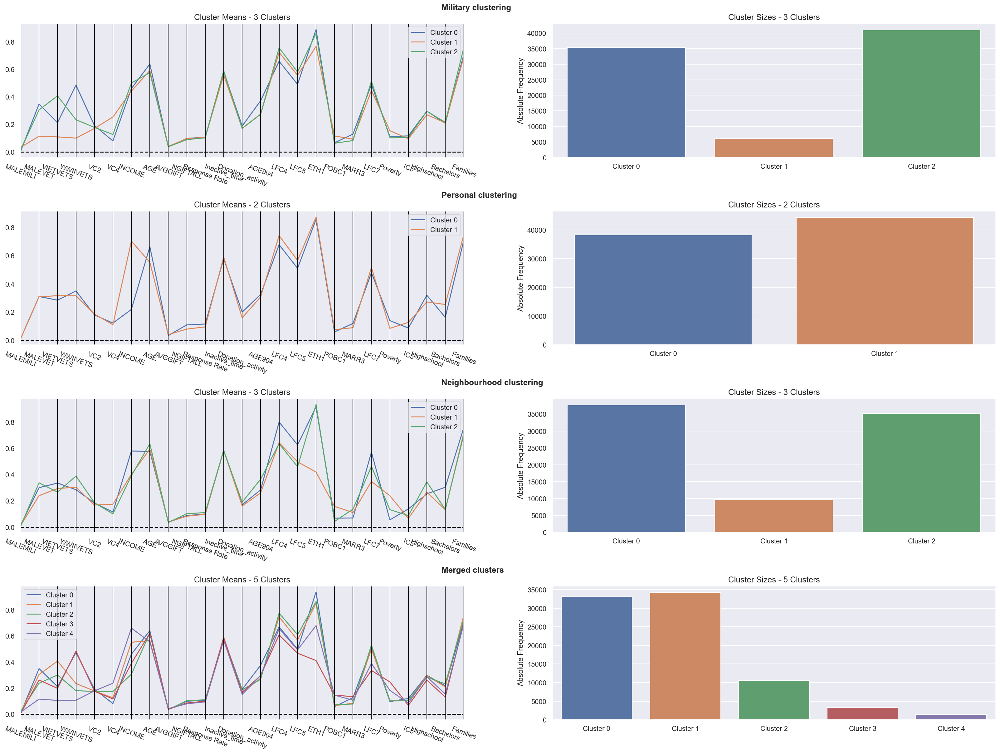

In [544]:
cluster_profiles(df=clusters_all, label_columns = ['Military_labels', 'Personal_labels','Neigh_labels', 'merged_labels'],
                 figsize = (28, 20),compar_titles = ["Military clustering", "Personal clustering","Neighbourhood clustering", "Merged clusters"])

In [545]:
c_all=clusters_all.drop(columns=['Military_labels','Personal_labels','Neigh_labels'])

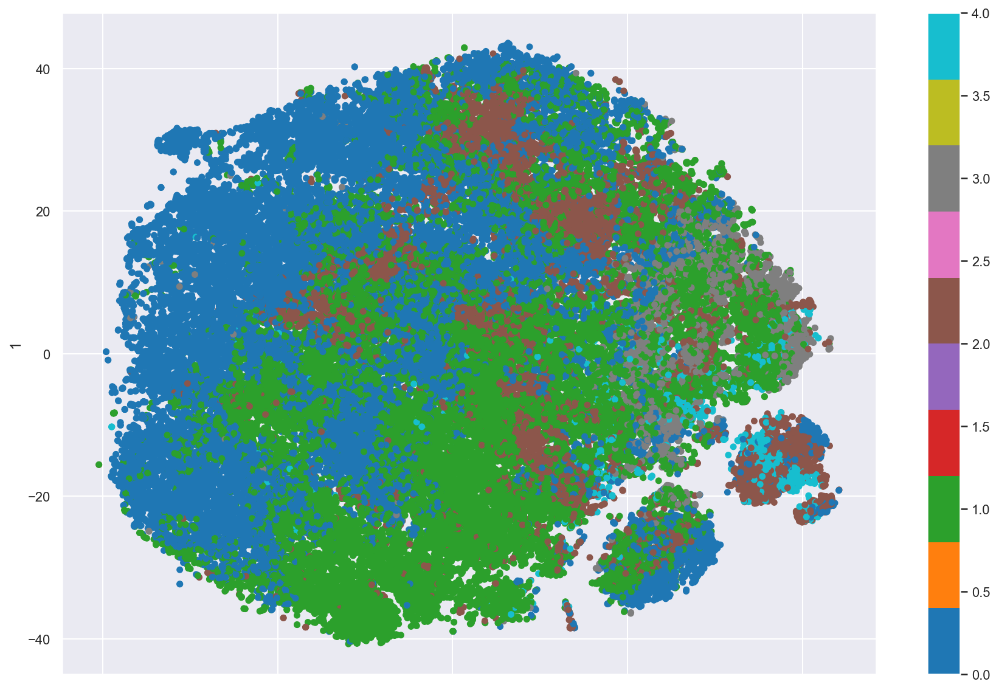

In [546]:
two_dim = TSNE(random_state=42).fit_transform(c_all.drop(columns=['merged_labels']))

pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=c_all['merged_labels'], colormap='tab10', figsize=(15,10))
plt.show()

## Reincluding outliers</font> <a class="anchor" id="out_inc"></a>
  [Back to Segmentation](#Segmentation)

In [595]:
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.model_selection import train_test_split
import graphviz

In [603]:
clusters_all_no_lapsed['Cluster']=4
clusters_all.rename(columns={'merged_labels':'Cluster'},inplace=True)

In [604]:
FINAL=pd.concat([clusters_all_no_lapsed,clusters_all],axis=0)
FINAL.drop(columns=['Military_labels','Personal_labels','Neigh_labels'],inplace=True)

In [605]:
X = FINAL.drop(columns=['Cluster'])
y = FINAL.Cluster

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Fitting the classification tree
dt = DecisionTreeClassifier(random_state=42, max_depth=5) #pq só quero 5 labels
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 88.38% of the customers correctly


In [606]:
out_first['Poverty']=out_first["HHAS4"]
out_first['IC5']=out_first["IC5"]
out_first['Highschool']=out_first["EC4"]
out_first['Bachelors']=out_first["EC7"]
out_first['Families']=out_first["HHD2"]

In [607]:
out_first=out_first[X.columns]

In [608]:
# Normalizing out_first
min_max_scaler = prep.MinMaxScaler()
out_first_norm= pd.DataFrame(min_max_scaler.fit_transform(out_first), index=out_first.index, columns=out_first.columns)

In [609]:
# Predicting the cluster labels of the outliers
out_first['Cluster'] = dt.predict(out_first_norm)

In [610]:
out_first.Cluster.value_counts()

0    361
1    313
3    163
4    141
2     58
Name: Cluster, dtype: int64